In [1]:
#book recommendation system : Hybrid Model : RBM->Collaborative->Content based->Results

In [ ]:
#credits : SHAP library 
#udemy : deep learning for help in implementing RBM from scratch - https://www.udemy.com/course/deeplearning/
#https://towardsdatascience.com/building-and-testing-recommender-systems-with-surprise-step-by-step-d4ba702ef80b
#https://towardsdatascience.com/recommendation-system-series-part-2-the-10-categories-of-deep-recommendation-systems-that-189d60287b58


In [3]:
# import libraries 

from surprise import Dataset
from surprise import Reader
from surprise.model_selection.split import train_test_split
from surprise.model_selection import cross_validate, GridSearchCV
import pandas as pd
import numpy as np
import os, io
from surprise import SlopeOne, NMF,NormalPredictor, CoClustering
from surprise import KNNBasic, KNNWithMeans, KNNWithZScore,KNNBaseline
from surprise import BaselineOnly
from surprise import SVDpp
from surprise import SVD
from surprise import accuracy
import matplotlib.pyplot as plt

In [4]:
#read data from csvs

ratingsdf  = pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/ratings.csv')
#booktagsdf= pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/book_tags.csv')
#toreaddf= pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/to_read.csv')
#booksdf= pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/books.csv')
#tagsdf=pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/tags.csv')

In [5]:
booksdf= pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/books.csv')

In [6]:
ratingsdf.head()

,book_id,user_id,rating
0,1,314,5
1,1,439,3
2,1,588,5
3,1,1169,4
4,1,1185,4


In [7]:
ratingsdf.shape

(981756, 3)

In [8]:
ratingsdf=ratingsdf.drop_duplicates(subset=['book_id','user_id'])
ratingsdf.shape

(979478, 3)

In [7]:
ratingsdf.book_id.nunique()

10000

In [9]:
ratingsdf.book_id.min()

1

In [7]:
ratingsdf.user_id.nunique()

53424

In [8]:
booktagsdf.head()

,goodreads_book_id,tag_id,count
0,1,30574,167697
1,1,11305,37174
2,1,11557,34173
3,1,8717,12986
4,1,33114,12716


In [6]:
toreaddf.head()

,user_id,book_id
0,1,112
1,1,235
2,1,533
3,1,1198
4,1,1874


In [7]:
booksdf.head()

,id,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,...,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url
0,1,2767052,2767052,2792775,272,439023483,9.780439e+12,Suzanne Collins,2008.0,The Hunger Games,...,4780653,4942365,155254,66715,127936,560092,1481305,2706317,https://images.gr-assets.com/books/1447303603m...,https://images.gr-assets.com/books/1447303603s...
1,2,3,3,4640799,491,439554934,9.780440e+12,"J.K. Rowling, Mary GrandPré",1997.0,Harry Potter and the Philosopher's Stone,...,4602479,4800065,75867,75504,101676,455024,1156318,3011543,https://images.gr-assets.com/books/1474154022m...,https://images.gr-assets.com/books/1474154022s...
2,3,41865,41865,3212258,226,316015849,9.780316e+12,Stephenie Meyer,2005.0,Twilight,...,3866839,3916824,95009,456191,436802,793319,875073,1355439,https://images.gr-assets.com/books/1361039443m...,https://images.gr-assets.com/books/1361039443s...
3,4,2657,2657,3275794,487,61120081,9.780061e+12,Harper Lee,1960.0,To Kill a Mockingbird,...,3198671,3340896,72586,60427,117415,446835,1001952,1714267,https://images.gr-assets.com/books/1361975680m...,https://images.gr-assets.com/books/1361975680s...
4,5,4671,4671,245494,1356,743273567,9.780743e+12,F. Scott Fitzgerald,1925.0,The Great Gatsby,...,2683664,2773745,51992,86236,197621,606158,936012,947718,https://images.gr-assets.com/books/1490528560m...,https://images.gr-assets.com/books/1490528560s...


In [8]:
tagsdf.head()

,tag_id,tag_name
0,0,-
1,1,--1-
2,2,--10-
3,3,--12-
4,4,--122-


In [9]:
#lets make a recommendation engine using ratings : svd approach 

In [10]:
ratingsdf.isnull().sum()

book_id    0
user_id    0
rating     0
dtype: int64

In [11]:
ratingsdf.user_id.value_counts().describe()

count    53424.000000
mean        18.376685
std         26.268690
min          2.000000
25%          3.000000
50%          8.000000
75%         22.000000
max        200.000000
Name: user_id, dtype: float64

<BarContainer object of 53424 artists>

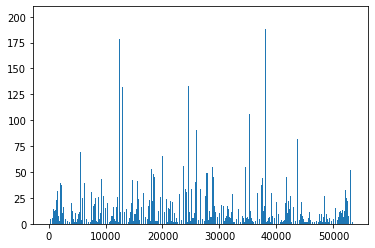

In [12]:
a=ratingsdf.user_id.value_counts().reset_index()
a.columns=['userid','count']
plt.bar(a['userid'],a['count'])

In [13]:
computationuserdf=ratingsdf.copy()
computationuserdf=computationuserdf.groupby(['user_id'])['rating'].mean()
#computationdf.column=['Average Rating : User ']
computationuserdf=computationuserdf.reset_index()

computationuserdf.columns=['User','Avg User Rating']
computationuserdf.head()

,User,Avg User Rating
0,1,3.666667
1,2,4.333333
2,3,1.000000
3,4,4.000000
4,5,4.200000


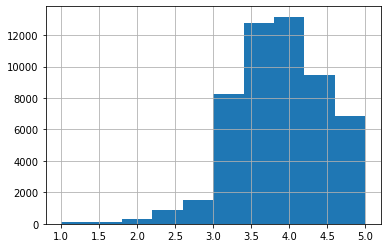

In [14]:
computationuserdf['Avg User Rating'].hist()

In [15]:
#book rating
#lets look at book data 
computationbookdf=ratingsdf.copy()
computationbookdf=computationbookdf.groupby(['book_id'])['rating'].mean()
#computationdf.column=['Average Rating : User ']
computationbookdf=computationbookdf.reset_index()

computationbookdf.columns=['book_id','Avg Book Rating']
computationbookdf.head()

,book_id,Avg Book Rating
0,1,4.24
1,2,4.21
2,3,3.09
3,4,4.46
4,5,3.89


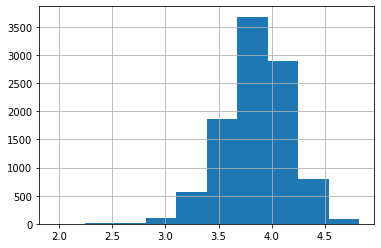

In [16]:
computationbookdf['Avg Book Rating'].hist()

In [13]:
ratingsdf['bookid']=ratingsdf['book_id']
ratingsdf.drop(inplace=True,columns=['book_id'])
ratingsdf.head()

,user_id,rating,bookid
0,314,5,1
1,439,3,1
2,588,5,1
3,1169,4,1
4,1185,4,1


In [14]:
reader = Reader(rating_scale=(0,5)) 
data=Dataset.load_from_df(ratingsdf,reader)


In [ ]:
benchmark = []


# Iterate over all algorithms
for algorithm in [SVD(),KNNBaseline()]:
    # Perform cross validation
    print("algorithm",algorithm)
    results = cross_validate(algorithm, data, measures=['RMSE'], cv=3, verbose=False)
    
    # Get results & append algorithm name
    tmp = pd.DataFrame.from_dict(results).mean(axis=0)
    tmp = tmp.append(pd.Series([str(algorithm).split(' ')[0].split('.')[-1]], index=['Algorithm']))
    benchmark.append(tmp)
    
pd.DataFrame(benchmark).set_index('Algorithm').sort_values('test_rmse') 

#Code Refrence  : 

#https://towardsdatascience.com/building-and-testing-recommender-systems-with-surprise-step-by-step-d4ba702ef80b

algorithm <surprise.prediction_algorithms.matrix_factorization.SVD object at 0x11ec8fdd8>
algorithm <surprise.prediction_algorithms.knns.KNNBaseline object at 0x11f0e76a0>
Estimating biases using als...


kernel dies due to huge data and neighbour based approach

In [11]:
#testdf = data.build_full_trainset().build_anti_testset() 
#create validation set
#trainingSet, validationSet = train_test_split(data, test_size=0.25, train_size=None, random_state=None, shuffle=True)

In [6]:
'''# check with different factors of f : 50 gave the best results
train_set=trainingset
test_set=validationSet
# Using the SVD algorithm
for n_factors in [50]:
    # Fit model to training set
    model = SVD(n_factors=n_factors)
    model.fit(train_set)

    # Measure predictions on train set
    print("Making predictions on training set (showing first 10):")
    tr_pred = model.test(train_set.build_testset())
    tr_mae = accuracy.mae(tr_pred)
    tr_rmse = accuracy.rmse(tr_pred)
    tr_predicted_ratings_N = np.asarray([p.est for p in tr_pred], dtype=np.float64)
    print(tr_predicted_ratings_N[:10])

    # Measure predictions on test set
    print("Making predictions on test set (showing first 10):")
    te_pred = model.test(test_set)
    te_mae = accuracy.mae(te_pred) # should be NaN because no real labels on testset
    te_predicted_ratings_N = np.asarray([p.est for p in te_pred], dtype=np.float64)
    print(te_predicted_ratings_N[:10])
    
    print("n_factors %6d  tr_MAE %7.3f  tr_rmse %7.3f test_MAE %7.3f" % (n_factors, tr_mae,tr_rmse, te_mae))

    print("Making test set predictions in the original order")
    for row in testdf.values[:]:
        userid = row[0]
        itemid = row[1]
        rhat = model.predict(userid, itemid)
        
        print("user %4d  item %4d  predicted rating % 8.3f" % (userid, itemid, rhat.est))
        resultedlist.append(rhat.est)
        resultedlistdetails.append(rhat.details)

    print("global mean:")
    print(model.trainset.global_mean)
    print("shape of bias_per_item: ")
    print(model.bi.shape)
    print("shape of bias_per_user: ")
    print(model.bu.shape)
    print("shape of U (per user vectors): ")
    print(model.pu.shape)
    print("shape of V (per item vectors): ")
    print(model.qi.shape)'''

[(1, 314, 5.0),
 (1, 439, 3.0),
 (1, 588, 5.0),
 (1, 1169, 4.0),
 (1, 1185, 4.0),
 (1, 2077, 4.0),
 (1, 2487, 4.0),
 (1, 2900, 5.0),
 (1, 3662, 4.0),
 (1, 3922, 5.0),
 (1, 5379, 5.0),
 (1, 5461, 3.0),
 (1, 5885, 5.0),
 (1, 6630, 5.0),
 (1, 7563, 3.0),
 (1, 9246, 1.0),
 (1, 10140, 4.0),
 (1, 10146, 5.0),
 (1, 10246, 4.0),
 (1, 10335, 4.0),
 (1, 10610, 5.0),
 (1, 10944, 5.0),
 (1, 11854, 4.0),
 (1, 11927, 4.0),
 (1, 12471, 5.0),
 (1, 13282, 5.0),
 (1, 13544, 5.0),
 (1, 15494, 5.0),
 (1, 16377, 4.0),
 (1, 16913, 5.0),
 (1, 17434, 5.0),
 (1, 17663, 5.0),
 (1, 17984, 5.0),
 (1, 18031, 5.0),
 (1, 18313, 5.0),
 (1, 18361, 4.0),
 (1, 20076, 3.0),
 (1, 20467, 3.0),
 (1, 20848, 5.0),
 (1, 21228, 5.0),
 (1, 21487, 4.0),
 (1, 21713, 5.0),
 (1, 22602, 4.0),
 (1, 23576, 4.0),
 (1, 23612, 4.0),
 (1, 24326, 5.0),
 (1, 24389, 4.0),
 (1, 24499, 5.0),
 (1, 24834, 4.0),
 (1, 24845, 5.0),
 (1, 25164, 4.0),
 (1, 25182, 5.0),
 (1, 25214, 4.0),
 (1, 26145, 4.0),
 (1, 26629, 4.0),
 (1, 26661, 4.0),
 (1, 28158,

In [22]:
import torch 
import torch.nn as nn
import torch.nn.parallel
import torch.optim
import torch.utils.data
from torch.autograd import Variable

In [7]:
ratingsdf.head()


,book_id,user_id,rating
0,1,314,5
1,1,439,3
2,1,588,5
3,1,1169,4
4,1,1185,4


In [7]:
ratingsdf.shape

(979478, 3)

In [8]:
copy=ratingsdf.copy()

In [10]:
print(ratingsdf.user_id.min(),ratingsdf.book_id.min())

1 1


In [11]:
ratingsdf.shape
n_users=ratingsdf.user_id.max()
n_books=ratingsdf.book_id.max()
print(n_users,n_books)

53424 10000


In [16]:
from sklearn.model_selection import train_test_split
traindf,testdf=train_test_split(ratingsdf,test_size=.33,random_state=6)

In [17]:
traindf.shape

(656250, 3)

In [18]:
testdf.shape

(323228, 3)

In [19]:
testdf.head()

,book_id,user_id,rating
422968,4237,1477,4
798363,8055,28070,4
189426,1895,22475,5
737414,7425,7068,5
164456,1645,27585,5


In [17]:
def convertdata(df):
    newdata=[]
    #newindexbooks=np.arange(start=0,stop=n_books+1)
    for user in range(1,n_users+1):
        ratings=np.zeros(n_books)
        userdf=df[df.user_id==user]
        userdf=userdf.reset_index(drop=True)
        print(userdf.head())
        '''idbooks=userdf.iloc[:,0]
        userdf=userdf.set_index('book_id')
        print(userdf.head())
        userdf=userdf.reindex(new_index, fill_value=0)
        userdf_ratings=userdf.iloc[:,2]
        '''
        ubooks=userdf.book_id.unique()
        #print(ubooks)
        for index,bookid in enumerate(ubooks,0):
            #print(index,bookid)
            ratings[bookid-1]=userdf.iloc[index,2]
        print(ratings)
        newdata.append(ratings)
    return newdata


In [18]:
trainset=convertdata(traindf)


   book_id  user_id  rating
0     6285        1       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8034        2       4
1     9762        2       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9014        3       1
1     9049        3       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3273        4       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6703        5       4
1     6646        5       4
2     8072        5       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7904        7       2
1     6701        7       3
2     2189        7       3
3     1620        7       5
4     5332        7       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8312        8       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6777        9       3
1     8676        9       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     9899       71       3
1     9649       71       3
2     8046       71       3
3     8362       71       4
4     9969       71       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8218       72       1
1     8627       72       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6128       73       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8336       74       3
1     5730       74       3
2     8882       74       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1511       75       4
1      668       75       4
2     2192       75       1
3     1009       75       4
4     3775       75       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4068       76       5
1     7651       76       4
2     7806       76       3
3     6604       76       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8882       77       3
1     8336       77       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     5095      146       2
1     6870      146       2
2     7008      146       4
3     4139      146       3
4     4994      146       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8882      147       4
1     6160      147       4
2     7639      147       5
3     9858      147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7664      148       3
1     3345      148       4
2     9188      148       3
3     4426      148       3
4     8679      148       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9790      149       5
1     8103      149       4
2     7886      149       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6937      151       4
1     8992      151       4
2     2686      151       1
3     4366      151       3
4     5831      151       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8925

   book_id  user_id  rating
0     4369      220       3
1     4173      220       4
2     4197      220       4
3     3960      220       3
4     5935      220       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4861      221       3
1     3873      221       3
2     4123      221       5
3     9219      221       4
4     9288      221       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4908      222       3
1     6895      222       3
2     8653      222       4
3     9425      222       4
4     3753      222       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9516      223       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3828      224       5
1     3868      224       5
2     4597      224       5
3     7309      224       5
4     8504      224       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9551      225       5
1     9209      225       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5088      

   book_id  user_id  rating
0     5752      291       3
1     8243      291       4
2     2111      291       4
3     5993      291       4
4     6606      291       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9132      292       3
1     7388      292       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9905      293       4
1     6937      293       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9503      294       2
1     6436      294       4
2     4740      294       4
3     3542      294       2
4     5024      294       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5480      295       2
1     7968      295       3
2     6942      295       3
3     7704      295       3
4     4643      295       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8334      296       4
1     8837      296       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9111      297       4
1     7341      297       4
2     6603      

   book_id  user_id  rating
0     5840      361       3
1     9759      361       4
2     9363      361       1
3     9974      361       5
4     2231      361       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2440      362       4
1      775      362       4
2      931      362       4
3     2441      362       4
4     2027      362       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8090      363       3
1     2393      363       3
2     2270      363       3
3     3025      363       3
4     6391      363       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9080      364       3
1     7881      364       3
2     8238      364       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8277      365       4
1     8230      365       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6695      366       4
1     6447      366       2
2     9714      366       3
3     1624      366       4
4     1239      366       4
[0. 0. 0. ..

   book_id  user_id  rating
0     3882      435       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5702      436       4
1     6487      436       5
2     9083      436       4
3     5280      436       4
4     5483      436       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4211      437       5
1     7376      437       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5675      438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      100      439       4
1     2827      439       3
2      296      439       4
3       23      439       2
4      158      439       4
[3. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6535      440       1
1     6299      440       2
2     5286      440       2
3     6278      440       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7137      441       3
1     8105      441       5
2     9833      441       4
3     8995      441       3
4     4285      441       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9686      511       3
1     9800      511       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2301      512       4
1     1703      512       4
2     1270      512       3
3     2563      512       3
4     2540      512       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2499      513       3
1     9995      513       2
2      403      513       3
3     6267      513       2
4     7611      513       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6984      514       2
1     6363      514       2
2     8846      514       4
3     9939      514       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7063      515       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8697      516       3
1     7026      516       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7670      517       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9601      518       5
1     7405      518 

   book_id  user_id  rating
0     8736      581       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8814      582       4
1     6503      582       2
2     8722      582       5
3     8839      582       3
4     8370      582       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5868      583       4
1     5420      583       4
2     4370      583       3
3     7404      583       4
4     4677      583       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9864      584       5
1     9232      584       2
2     8588      584       4
3     5983      584       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5027      585       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9847      586       5
1     9752      586       4
2     3733      586       5
3     7537      586       5
4     8365      586       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6543      587       4
1     6782      587       5
2     7746      

   book_id  user_id  rating
0     4606      648       5
1     9025      648       2
2     6425      648       2
3     9714      648       4
4     9960      648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9051      649       4
1     8372      649       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9880      650       5
1     6466      650       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9033      651       2
1     5778      651       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5774      652       2
1     6294      652       3
2     9833      652       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4310      653       3
1     1371      653       5
2     7506      653       3
3     8635      653       4
4     8055      653       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8831      654       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5700      655       2
1     5698      655 

   book_id  user_id  rating
0     4664      716       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5508      717       5
1     5041      717       4
2     2418      717       5
3     7995      717       3
4     4983      717       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605      718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7952      719       3
1     8479      719       3
2     9178      719       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7602      720       4
1     9847      720       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8013      722       4
1     8108      722       2
2     7071      722       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9760      723       1
1     9866      723       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2686      724       4
1     8079      72

   book_id  user_id  rating
0     6469      791       2
1     4861      791       4
2     6101      791       2
3     9069      791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9824      792       3
1     8451      792       5
2     6969      792       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1760      793       5
1     5923      793       3
2     6457      793       4
3     5446      793       3
4     8455      793       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6831      794       3
1     6903      794       4
2     8397      794       1
3     6238      794       5
4     5305      794       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3555      795       3
1     3296      795       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7963      796       4
1     8842      796       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9206      797       4
1     3412      797       5
2     1740      

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7074      848       5
1     6417      848       2
2     6968      848       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2494      849       3
1     5280      849       3
2     1807      849       4
3     4331      849       5
4     4178      849       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4509      850       5
1     5146      850       5
2     9632      850       2
3     6892      850       5
4     4202      850       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8654      851       4
1     4201      851       4
2     3208      851       5
3     5587      851       4
4     9936      851       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8045      852       4
1     6535      852       5
2     7737      852       4
3     6327      852       5
4     9083      852       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126      853       5
1     9320      

   book_id  user_id  rating
0     7800      910       3
1     6879      910       3
2     8519      910       2
3     6674      910       4
4     8335      910       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4749      911       5
1     6300      911       1
2     7331      911       4
3     9887      911       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7868      912       5
1     7326      912       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7842      913       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7974      914       4
1     7949      914       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5276      915       5
1     9379      915       3
2     5455      915       2
3     7270      915       4
4     8921      915       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5495      916       3
1     8497      916       4
2     7275      916       4
3     3062      916       5
4     5226      

   book_id  user_id  rating
0     7557      985       3
1     4767      985       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      525      986       4
1     2251      986       4
2     1140      986       4
3     1941      986       4
4     3733      986       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8975      987       4
1     6820      987       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8902      988       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9169      989       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8818      990       5
1     8782      990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9738      991       1
1     6974      991       3
2     9326      991       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4440      992       5
1     3930      992       4
2     4537      992       4
3     9277      992       4
4     9287      992       4
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     4811     1054       5
1     5674     1054       5
2     9285     1054       4
3     9668     1054       4
4     8663     1054       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7977     1055       4
1     5592     1055       4
2     8859     1055       5
3     5325     1055       5
4     5968     1055       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9492     1056       3
1     9775     1056       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5398     1057       4
1     8783     1057       3
2     9642     1057       2
3     1950     1057       3
4     3672     1057       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8703     1058       3
1     7135     1058       3
2     5355     1058       1
3     6909     1058       3
4     8656     1058       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4831     1059       3
1     8241     1059       4
2     9229     1059       4
3     9490  

   book_id  user_id  rating
0     3785     1124       4
1     7874     1124       3
2     8000     1124       3
3     7392     1124       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9537     1125       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4238     1126       3
1     5614     1126       3
2     5739     1126       3
3     6425     1126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5083     1127       3
1     5201     1127       5
2     3829     1127       4
3     4860     1127       5
4     9749     1127       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9809     1128       3
1     8313     1128       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5955     1129       2
1     9944     1129       4
2     6625     1129       2
3     8929     1129       5
4     4397     1129       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9317     1130       2
1     8586     1130       3
2     9206     1

   book_id  user_id  rating
0     7481     1195       5
1     6552     1195       2
2     9503     1195       5
3     2042     1195       3
4     8656     1195       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9837     1196       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3508     1197       4
1     6154     1197       1
2     6935     1197       5
3     6883     1197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5692     1198       3
1     3102     1198       4
2     6694     1198       4
3     4915     1198       3
4     4380     1198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7581     1199       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4260     1200       4
1     9480     1200       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9936     1201       3
1     5663     1201       5
2     8152     1201       3
3     8708     1201       4
4     6804     1201       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9959     1269       5
1     7315     1269       3
2     9029     1269       4
3     6882     1269       3
4     4879     1269       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8455     1270       4
1     9946     1270       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9946     1271       5
1     8454     1271       4
2     5241     1271       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9551     1272       2
1     9229     1272       2
2     8059     1272       2
3     8869     1272       2
4     5516     1272       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9759     1273       3
1     7022     1273       3
2     8390     1273       4
3     7606     1273       4
4     9946     1273       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7484     1274       4
1     5130     1274       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7233     1275       3
1     9189     1

   book_id  user_id  rating
0     3878     1342       4
1     1313     1342       4
2     4938     1342       3
3     4520     1342       5
4     8516     1342       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9265     1343       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3822     1344       4
1     7678     1344       4
2     7399     1344       5
3     8891     1344       4
4     9722     1344       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5753     1345       3
1     8786     1345       4
2     8635     1345       4
3     7281     1345       5
4     7120     1345       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6835     1346       5
1     4231     1346       5
2     2729     1346       5
3     6880     1346       4
4     4822     1346       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3259     1347       3
1     6329     1347       4
2     7199     1347       3
3     2162     1347       2
[0. 0. 0. ..

   book_id  user_id  rating
0     7537     1416       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9620     1417       5
1     6808     1417       4
2     3745     1417       2
3     6999     1417       2
4     3342     1417       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482     1418       4
1     9962     1418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2439     1419       4
1     6714     1419       4
2     4020     1419       3
3     2804     1419       3
4     8079     1419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2320     1420       3
1     6820     1420       3
2     5792     1420       2
3     7496     1420       4
4     5024     1420       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4978     1421       4
1     8243     1421       4
2     5226     1421       3
3     9447     1421       3
4     7378     1421       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9864     1

   book_id  user_id  rating
0     5778     1488       2
1     5130     1488       4
2     7955     1488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8623     1489       5
1     8162     1489       4
2     4976     1489       5
3     7517     1489       4
4     6156     1489       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5617     1490       4
1     8902     1490       3
2     1761     1490       4
3     9028     1490       3
4     4296     1490       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2874     1491       3
1     3865     1491       3
2     3816     1491       2
3     7396     1491       5
4     1516     1491       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7557     1492       4
1     7397     1492       3
2     9207     1492       4
3     7424     1492       3
4     7087     1492       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5181     1493       3
1     4494     1493       3
2     8677  

   book_id  user_id  rating
0     9862     1564       5
1     8233     1564       4
2     6288     1564       4
3     7794     1564       4
4     9885     1564       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      920     1565       4
1     1206     1565       4
2     1965     1565       3
3     3406     1565       5
4     3566     1565       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1708     1566       4
1     2137     1566       4
2     2652     1566       4
3     3294     1566       4
4     2065     1566       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9518     1567       3
1     7610     1567       3
2     5091     1567       4
3     4491     1567       4
4     4453     1567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1494     1568       3
1     3588     1568       4
2     5349     1568       5
3     3835     1568       4
4     4302     1568       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5791  

   book_id  user_id  rating
0     6094     1638       3
1     7034     1638       4
2     6764     1638       3
3     6849     1638       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5987     1639       4
1     5308     1639       3
2     7698     1639       4
3     8024     1639       2
4     7634     1639       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6784     1640       5
1     8972     1640       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4674     1641       5
1     1141     1641       5
2     7602     1641       5
3     4843     1641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7025     1642       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5731     1643       5
1     7763     1643       4
2     5987     1643       5
3     7522     1643       3
4     7077     1643       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9264     1644       2
1     9999     1644       3
2     7559     1

   book_id  user_id  rating
0     9921     1709       5
1     5076     1709       3
2     5482     1709       4
3     9317     1709       5
4     6204     1709       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      934     1710       1
1     4302     1710       4
2      269     1710       4
3     2738     1710       3
4     2820     1710       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3217     1711       3
1     7086     1711       3
2     3871     1711       4
3     2339     1711       4
4     8965     1711       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5182     1712       4
1     4113     1712       3
2     3440     1712       4
3     8618     1712       4
4     7352     1712       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3333     1713       3
1     3867     1713       2
2     3751     1713       2
3      874     1713       4
4     8977     1713       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9743  

   book_id  user_id  rating
0     6125     1782       5
1     7668     1782       3
2     6553     1782       5
3     5425     1782       5
4     5033     1782       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8795     1783       4
1     6402     1783       4
2     4126     1783       5
3     6332     1783       5
4     9038     1783       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3913     1784       5
1     5792     1784       3
2     8456     1784       2
3     7022     1784       2
4     5334     1784       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8973     1785       3
1     7129     1785       4
2     5460     1785       3
3     9514     1785       4
4     6714     1785       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3719     1786       5
1     6195     1786       3
2     4202     1786       5
3     6844     1786       3
4     5244     1786       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5784  

   book_id  user_id  rating
0     7986     1852       4
1     8491     1852       3
2     9216     1852       5
3     7551     1852       3
4     7127     1852       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2647     1853       3
1     1460     1853       3
2     2703     1853       3
3     1736     1853       4
4     8318     1853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9716     1854       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8461     1855       4
1     4547     1855       4
2     4313     1855       4
3     7708     1855       3
4     3173     1855       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4367     1856       3
1     5449     1856       4
2     3446     1856       3
3     3985     1856       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8034     1857       5
1     7873     1857       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9991     1858       4
1     8914     1

   book_id  user_id  rating
0     6754     1921       4
1     5838     1921       3
2     7817     1921       4
3     6887     1921       4
4     6814     1921       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8209     1922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9824     1923       3
1     9524     1923       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8795     1924       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2788     1925       4
1     2872     1925       5
2     4629     1925       3
3     9833     1925       4
4     2772     1925       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9841     1926       3
1     9513     1926       3
2     8189     1926       4
3     9854     1926       4
4     7463     1926       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6496     1927       4
1     8916     1927       1
2     3240     1927       2
3     9084     1927       2
4     3247     1

   book_id  user_id  rating
0     6557     1994       5
1     6039     1994       5
2     7333     1994       2
3     1444     1994       4
4     8746     1994       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4421     1996       3
1     7026     1996       5
2     3923     1996       5
3     7638     1996       5
4     3942     1996       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5916     1997       4
1     9322     1997       3
2     2692     1997       3
3     7478     1997       4
4     9369     1997       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8773     1998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8209     1999       3
1     9512     1999       3
2     9570     1999       3
3     8748     1999       4
4     5647     1999       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3794     2000       2
1     7001

   book_id  user_id  rating
0     5932     2069       3
1     8475     2069       3
2     7091     2069       3
3     8816     2069       3
4     5221     2069       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8545     2070       3
1     6592     2070       4
2     8898     2070       3
3     5480     2070       4
4     5673     2070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7725     2071       2
1     8378     2071       3
2     9075     2071       4
3     8910     2071       5
4     9530     2071       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4457     2072       4
1     9229     2072       4
2     8059     2072       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6069     2074       4
1     6231     2074       3
2     2414     2074       5
3     2442     2074       4
4     8407     2074       5
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     4264     2141       2
1     1647     2141       1
2     2588     2141       2
3     5647     2141       2
4     4376     2141       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5700     2142       4
1     8030     2142       3
2     3228     2142       4
3     6064     2142       5
4     4464     2142       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8742     2143       2
1     8783     2143       2
2     7864     2143       3
3     8535     2143       5
4     9814     2143       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8724     2144       2
1     7986     2144       3
2     7209     2144       3
3     9391     2144       1
4     9206     2144       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8805     2145       4
1     8588     2145       3
2     4763     2145       4
3     9303     2145       3
4     9690     2145       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8232  

   book_id  user_id  rating
0     8393     2207       5
1     6921     2207       4
2     9096     2207       5
3     7918     2207       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9963     2208       2
1     7824     2208       4
2     8931     2208       4
3     9429     2208       2
4     9814     2208       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5657     2209       5
1     8633     2209       4
2     8403     2209       4
3     8891     2209       5
4     9631     2209       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8795     2210       5
1     6391     2210       5
2     8455     2210       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7381     2211       5
1     9728     2211       5
2     9159     2211       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8348     2212       1
1     7584     2212       5
2     8350     2212       4
3     6406     2212       3
4     3475     2212       2
[0. 0. 0. ..

   book_id  user_id  rating
0     9000     2274       5
1     7287     2274       5
2     6528     2274       5
3     9168     2274       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5263     2275       5
1     1206     2275       3
2      708     2275       3
3     4233     2275       4
4     8870     2275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5752     2276       4
1      350     2276       5
2     1019     2276       4
3     2489     2276       3
4     4228     2276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6142     2277       1
1     6435     2277       5
2     8519     2277       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4292     2278       5
1     9694     2278       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7590     2279       4
1     8655     2279       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9859     2280       3
1     7355     2280       3
2     8563     2

   book_id  user_id  rating
0     1078     2348       2
1     2958     2348       4
2     4133     2348       3
3     2650     2348       5
4     2873     2348       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4300     2349       4
1     6000     2349       4
2     9079     2349       5
3     4143     2349       5
4     9241     2349       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8950     2350       3
1     6031     2350       4
2     9276     2350       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9946     2351       4
1     7569     2351       5
2     9766     2351       5
3     6712     2351       5
4     8382     2351       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5900     2352       4
1     3746     2352       4
2     1803     2352       4
3     5520     2352       5
4     3039     2352       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8650     2353       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3501     2421       2
1     2288     2421       4
2      250     2421       4
3      190     2421       3
4     2169     2421       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9114     2422       5
1     9086     2422       5
2     9517     2422       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5040     2423       3
1     8765     2423       3
2     9565     2423       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4285     2424       5
1     8845     2424       4
2     7848     2424       5
3     6446     2424       4
4     2162     2424       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8691     2425       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7231     2426       4
1     2660     2426       4
2     9482     2426       3
3     2505     2426       3
4     6882     2426       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6231     2427       4
1     8576     2

   book_id  user_id  rating
0     8346     2489       5
1     8966     2489       5
2     3980     2489       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8150     2491       5
1     7277     2491       4
2     7293     2491       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6089     2492       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5910     2493       3
1     1406     2493       3
2     2281     2493       3
3     6273     2493       3
4     3388     2493       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9484     2494       3
1     6710     2494       5
2     9350     2494       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8412     2495       3
1     6487     2495       4
2     6883     2495       4
3     9020     2495       3
4     9511     2495       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6767    

   book_id  user_id  rating
0     7103     2560       4
1     6443     2560       4
2     2855     2560       2
3     7774     2560       4
4     5614     2560       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3774     2561       4
1     9542     2561       3
2     5392     2561       2
3     4027     2561       2
4     8840     2561       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6473     2562       3
1     6810     2562       4
2     9181     2562       3
3     8900     2562       5
4     4086     2562       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6935     2563       4
1     5025     2563       3
2     1162     2563       2
3     3038     2563       4
4     4596     2563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9033     2564       3
1     7795     2564       4
2     7567     2564       4
3     8804     2564       2
4     5778     2564       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6772  

   book_id  user_id  rating
0     6278     2633       4
1     6916     2633       5
2     6385     2633       4
3     4566     2633       2
4     7037     2633       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8496     2634       5
1     9382     2634       3
2     9186     2634       4
3     7037     2634       4
4     9331     2634       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5177     2635       5
1     5226     2635       3
2     4047     2635       5
3     2036     2635       5
4     8080     2635       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6114     2636       5
1     6257     2636       5
2     5762     2636       3
3     2946     2636       5
4     9944     2636       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6214     2637       4
1     7541     2637       5
2     7786     2637       3
3     8073     2637       4
4     6088     2637       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1436  

   book_id  user_id  rating
0     7881     2708       4
1     9080     2708       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2419     2709       4
1     2722     2709       4
2     9647     2709       5
3     6959     2709       4
4     3203     2709       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8928     2710       2
1     4968     2710       2
2     8703     2710       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9795     2711       4
1     7346     2711       4
2     5112     2711       3
3     8455     2711       5
4     8922     2711       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9300     2712       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9759     2713       4
1     5318     2713       2
2     8464     2713       4
3     5670     2713       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6829     2714       3
1     9962     2714       3
2     3998     2714       3
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8882     2781       4
1     9858     2781       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9740     2782       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6112     2783       3
1     4763     2783       2
2     3476     2783       4
3     3556     2783       4
4     4960     2783       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8273     2784       4
1     2935     2784       5
2     4720     2784       5
3     5034     2784       3
4     5447     2784       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6771     2785       3
1     9594     2785       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8831     2786       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8316     2787       4
1     6784     2787       4
2     6255     2787       4
3     8647     2787       4
4     9036     2787       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     9858     2846       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5953     2847       5
1     3678     2847       5
2     5477     2847       5
3     5451     2847       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7989     2848       4
1     8153     2848       3
2     8723     2848       3
3     9296     2848       4
4     3039     2848       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4835     2849       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7989     2850       5
1     8367     2850       4
2     5711     2850       4
3     4834     2850       4
4     8517     2850       5
[0. 0. 0. ... 0. 5. 0.]
   book_id  user_id  rating
0     7103     2851       5
1     3604     2851       5
2     5012     2851       4
3     3433     2851       5
4     4370     2851       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4633     2852       3
1     4859     2852       4
2     8681     2

   book_id  user_id  rating
0     6875     2921       3
1     7761     2921       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6589     2922       3
1     8523     2922       5
2     3844     2922       5
3     5201     2922       3
4     5238     2922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8455     2923       5
1     9006     2923       5
2     3401     2923       3
3     4545     2923       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6070     2924       5
1     3678     2924       4
2     9473     2924       3
3     5130     2924       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3479     2925       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5111     2926       4
1     6077     2926       5
2     3589     2926       4
3     5974     2926       5
4     6478     2926       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8823     2927       5
1     8821     2927       5
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9263     2990       4
1     5670     2990       3
2     7950     2990       4
3     6772     2990       4
4     6617     2990       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8167     2991       4
1     7407     2991       3
2     8849     2991       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4394     2992       3
1     3737     2992       2
2     3964     2992       3
3     5138     2992       4
4     4418     2992       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2474     2993       5
1     4071     2993       5
2     8992     2993       5
3     6032     2993       5
4     9919     2993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8593     2994       5
1     5765     2994       4
2     3482     2994       2
3      985     2994       5
4     6195     2994       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5373     2995       4
1     1372     2

   book_id  user_id  rating
0     5699     3057       3
1     6160     3057       3
2     8882     3057       4
3     9540     3057       4
4     8532     3057       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3528     3058       5
1     6491     3058       4
2     4489     3058       3
3     6394     3058       2
4     3867     3058       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5794     3059       4
1     7066     3059       3
2     5448     3059       5
3     9215     3059       4
4     8475     3059       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8121     3060       4
1     9862     3060       3
2     6471     3060       4
3     7894     3060       4
4     6988     3060       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3287     3061       4
1     6502     3061       4
2     5348     3061       1
3     5988     3061       4
4     4475     3061       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6062  

   book_id  user_id  rating
0     4144     3123       3
1     7494     3123       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8717     3124       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9936     3125       5
1     8152     3125       5
2     7868     3125       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7144     3126       4
1     5516     3126       4
2     8950     3126       4
3     9087     3126       3
4     4814     3126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8127     3127       4
1     7602     3127       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5335     3128       4
1     9756     3128       4
2     7148     3128       3
3     8520     3128       4
4     7557     3128       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8504     3129       3
1     6457     3129       5
2     3923     3129       4
3     9698     3129       3
4     3542     3129       1
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8232     3192       5
1     9337     3192       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7970     3193       5
1     8931     3193       4
2     9424     3193       3
3     8893     3193       3
4     6327     3193       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4762     3194       3
1     7922     3194       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9694     3195       3
1     9236     3195       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4080     3197       4
1     8425     3197       4
2     4166     3197       3
3     9163     3197       4
4     8891     3197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5911     3198       5
1     6997     3198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8238     3199       3
1     7590     3199       4
2     9518    

   book_id  user_id  rating
0     5623     3259       5
1     7970     3259       3
2     5180     3259       4
3     8410     3259       4
4     7093     3259       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3817     3260       3
1     5343     3260       3
2     6654     3260       4
3     3764     3260       3
4     9675     3260       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4555     3261       2
1     2645     3261       4
2     2056     3261       4
3     5936     3261       4
4      367     3261       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1936     3262       3
1     1570     3262       5
2     6726     3262       2
3     6768     3262       3
4     2053     3262       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       78     3263       3
1      927     3263       2
2      401     3263       3
3      898     3263       3
4      344     3263       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4525  

   book_id  user_id  rating
0     7555     3311       3
1     9391     3311       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4463     3312       4
1     3784     3312       3
2     7007     3312       4
3     2175     3312       3
4     7246     3312       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6695     3313       4
1     6191     3313       5
2     8654     3313       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3120     3314       4
1     1635     3314       3
2     3492     3314       3
3     1106     3314       5
4     4658     3314       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7646     3315       5
1     4455     3315       1
2     3136     3315       4
3     2781     3315       5
4      392     3315       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3451     3316       5
1     4139     3316       3
2     4597     3316       5
3     7812     3316       4
4     1955     3316       3
[0. 0. 0. ..

   book_id  user_id  rating
0     8857     3375       1
1     9026     3375       3
2     7045     3375       3
3     8745     3375       2
4     8418     3375       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8671     3376       4
1     9178     3376       2
2     8153     3376       4
3     5132     3376       5
4     9064     3376       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9172     3377       4
1     8782     3377       4
2     7755     3377       3
3     9972     3377       4
4     6688     3377       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9833     3378       3
1     4838     3378       4
2     2174     3378       3
3     2717     3378       2
4     3290     3378       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1834     3379       2
1     2362     3379       3
2     1442     3379       2
3     1016     3379       3
4     1044     3379       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6509  

   book_id  user_id  rating
0     2856     3441       4
1     6829     3441       5
2     8326     3441       5
3     8016     3441       4
4     2813     3441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8837     3442       2
1     9077     3442       2
2     9789     3442       3
3     5334     3442       2
4     7927     3442       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5994     3443       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9632     3444       5
1     4780     3444       2
2     7176     3444       5
3     7372     3444       2
4     7500     3444       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1840     3445       5
1     8542     3445       5
2     4556     3445       5
3     7583     3445       5
4     4424     3445       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9809     3446       4
1     8842     3446       4
2     4770     3446       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3938     3508       4
1     4553     3508       4
2     1189     3508       4
3     3399     3508       5
4      568     3508       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9438     3509       4
1     6487     3509       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6363     3510       2
1     6463     3510       4
2     9606     3510       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9997     3511       5
1     7845     3511       4
2     4411     3511       4
3     4536     3511       4
4     8179     3511       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9095     3513       3
1     6328     3513       2
2     9719     3513       3
3     7305     3513       5
4     4068     3513       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7537     3514       5
1     6890     3514       4
2     9783

   book_id  user_id  rating
0     3033     3574       4
1     5627     3574       4
2     4810     3574       5
3     2498     3574       3
4     1969     3574       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9808     3575       2
1     4292     3575       3
2     8964     3575       4
3     8704     3575       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9433     3576       3
1     6189     3576       4
2     5287     3576       4
3     9696     3576       4
4     5113     3576       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8658     3577       3
1     6308     3577       3
2     8330     3577       3
3     9853     3577       4
4     6041     3577       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2897     3578       3
1     3197     3578       3
2     5263     3578       4
3     2379     3578       3
4     4096     3578       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430     3579       4
[0. 0. 0. ..

   book_id  user_id  rating
0     7488     3677       3
1     7025     3677       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7710     3678       4
1     3582     3678       5
2     2667     3678       4
3     5987     3678       3
4     6255     3678       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9143     3679       2
1     8782     3679       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9415     3680       4
1     9332     3680       3
2     8720     3680       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4531     3681       3
1     7257     3681       2
2     8656     3681       4
3     9554     3681       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5675     3683       3
1     8195     3683       3
2     7091     3683       4
3     9456     3683       4
4     5813     3683       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     9084     3741       4
1     4422     3741       4
2     4527     3741       3
3     5157     3741       3
4     3857     3741       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2925     3742       4
1     3315     3742       5
2     5551     3742       5
3     5120     3742       5
4     5723     3742       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7484     3743       4
1     7955     3743       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8778     3744       3
1     8545     3744       3
2     7752     3744       3
3     5822     3744       4
4     5884     3744       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      932     3745       4
1     7382     3745       4
2     6958     3745       3
3     4220     3745       2
4     5595     3745       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9280     3746       5
1     9946     3746       3
2     7656     3746       2
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7255     3807       5
1     8483     3807       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8647     3808       5
1     3520     3808       5
2     4949     3808       3
3     2867     3808       5
4     7756     3808       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9421     3809       4
1     8997     3809       4
2     8387     3809       3
3     8572     3809       5
4     9719     3809       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8943     3810       4
1     9425     3810       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3152     3811       5
1     9827     3811       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9785     3812       3
1     4818     3812       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9811     3813       5
1     8040     3813       5
2     8240     3813       5
3     8909     3813       5
4     9414     3813 

   book_id  user_id  rating
0     5022     3879       3
1     1499     3879       4
2     2943     3879       3
3     8312     3879       2
4     9102     3879       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8127     3880       4
1     6687     3880       4
2     5336     3880       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8071     3881       3
1     1886     3881       3
2     3635     3881       4
3     2843     3881       3
4     2111     3881       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6916     3882       5
1     9750     3882       5
2     9042     3882       4
3     9247     3882       5
4     7302     3882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5727     3883       3
1     8875     3883       2
2     6847     3883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7887     3884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9399     3885       4
1     9025     3

   book_id  user_id  rating
0     2550     3948       4
1     4871     3948       3
2     7631     3948       3
3     2224     3948       4
4     2549     3948       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6437     3949       5
1     9310     3949       4
2     8784     3949       4
3     7489     3949       5
4     5909     3949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7588     3950       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8290     3951       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8021     3952       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8249     3953       4
1     8175     3953       4
2     6156     3953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4875     3954       4
1     4168     3954       4
2     6698     3954       4
3     6710     3954       3
4     3694     3954       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5992     3955 

   book_id  user_id  rating
0     7774     4011       3
1     9443     4011       3
2     7502     4011       4
3     6209     4011       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9333     4012       3
1     3925     4012       4
2     8836     4012       4
3     8656     4012       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912     4013       4
1     8071     4013       5
2     5983     4013       5
3     4516     4013       4
4     6809     4013       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6648     4014       4
1     2729     4014       5
2     4455     4014       4
3     7440     4014       5
4     3451     4014       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6299     4015       3
1     4214     4015       4
2     4258     4015       3
3     7655     4015       2
4     4037     4015       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9421     4016       3
1     9510     4016       3
[0. 0. 0. ..

   book_id  user_id  rating
0     5254     4080       5
1     8016     4080       4
2     9095     4080       4
3     9026     4080       3
4     5470     4080       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7992     4081       2
1     8017     4081       3
2     7091     4081       3
3     7229     4081       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8552     4082       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5256     4083       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3726     4084       4
1     3503     4084       3
2     5242     4084       5
3     1841     4084       3
4     3273     4084       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3393     4085       4
1     4868     4085       5
2     1106     4085       4
3     8448     4085       1
4     7056     4085       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8525     4086       4
1     8429     4086       4
2     9600     4

   book_id  user_id  rating
0     6167     4152       5
1     6999     4152       5
2     9313     4152       5
3     7089     4152       5
4     5369     4152       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8735     4153       3
1     4288     4153       3
2     8571     4153       5
3     2020     4153       4
4     2586     4153       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8532     4154       1
1     8788     4154       2
2     7651     4154       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8676     4155       2
1     9885     4155       4
2     7827     4155       5
3     7770     4155       3
4     8724     4155       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9337     4156       4
1     7844     4156       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7307     4157       4
1     7713     4157       5
2     9782     4157       5
3     7207     4157       3
4     6809     4157       4
[0. 0. 0. ..

   book_id  user_id  rating
0     6952     4218       4
1     8690     4218       4
2     6236     4218       5
3     6985     4218       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8658     4219       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7997     4220       3
1     5860     4220       5
2     8207     4220       4
3     5114     4220       5
4     7833     4220       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7276     4221       3
1     7395     4221       5
2     3026     4221       5
3     4557     4221       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5231     4222       5
1     6216     4222       1
2     3119     4222       5
3     5216     4222       4
4     4227     4222       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5336     4223       4
1     4404     4223       2
2     5675     4223       5
3     9350     4223       5
4     9443     4223       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7292     4283       3
1     8140     4283       4
2     2220     4283       2
3     8160     4283       4
4     7873     4283       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1870     4284       1
1     1081     4284       4
2     2393     4284       2
3      610     4284       3
4     6729     4284       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3285     4285       5
1     6019     4285       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5917     4286       3
1     7087     4286       1
2     9907     4286       3
3     8785     4286       3
4     8228     4286       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9014     4287       4
1     5831     4287       4
2     7866     4287       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7542     4288       3
1     4628     4288       3
2     7709     4288       4
3     6676     4288       3
4     8365     4

   book_id  user_id  rating
0     6901     4355       5
1     3095     4355       3
2     9416     4355       4
3     4207     4355       3
4     8009     4355       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6898     4356       4
1     9220     4356       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5524     4357       5
1     7796     4357       3
2     7060     4357       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2210     4358       3
1     3884     4358       2
2     5203     4358       2
3     4585     4358       3
4     5057     4358       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2564     4359       5
1     2622     4359       5
2     6113     4359       2
3     1338     4359       5
4     1791     4359       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8241     4360       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5712     4361       5
1     7502     4361       5
2     9075     4

   book_id  user_id  rating
0     7901     4427       3
1     1519     4427       2
2      794     4427       3
3     8184     4427       5
4      886     4427       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7452     4428       3
1     8911     4428       4
2     4745     4428       3
3     3228     4428       3
4     7443     4428       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3006     4429       4
1     3573     4429       4
2     2129     4429       4
3     7603     4429       4
4     3000     4429       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1774     4430       3
1     7833     4430       4
2     3014     4430       5
3     1287     4430       5
4     1163     4430       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9601     4431       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5997     4432       4
1     9611     4432       4
2     7220     4432       2
3     7284     4432       3
4     6110  

   book_id  user_id  rating
0     2752     4482       3
1     2036     4482       5
2     7655     4482       3
3     4140     4482       4
4     6062     4482       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9864     4483       5
1     4958     4483       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6820     4484       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6044     4485       4
1      676     4485       3
2     2542     4485       4
3     2551     4485       4
4     8511     4485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8623     4486       5
1     5727     4486       5
2     8688     4486       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7575     4487       4
1     4545     4487       2
2     5955     4487       3
3     1736     4487       4
4     6237     4487       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7754     4488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8192     4545       3
1     9411     4545       5
2     4129     4545       4
3     2243     4545       5
4     5738     4545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6710     4546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9577     4547       5
1     6038     4547       5
2     5877     4547       4
3     8753     4547       4
4     3631     4547       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7023     4548       3
1     7785     4548       4
2     7410     4548       3
3     5436     4548       3
4     6911     4548       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6593     4549       2
1     6709     4549       4
2     4119     4549       4
3     7778     4549       3
4     9894     4549       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9452     4550       4
1     3222     4550       4
2     6401     4550       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3542     4605       4
1     4049     4605       3
2     5664     4605       3
3     4385     4605       4
4     2625     4605       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      196     4606       4
1      109     4606       3
2     2086     4606       3
3     9737     4606       4
4     1042     4606       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9497     4607       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3761     4608       4
1     9077     4608       4
2     9287     4608       3
3     8264     4608       4
4     4451     4608       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9804     4609       3
1     8912     4609       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5076     4610       3
1     7372     4610       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9161     4611       5
1     9906     4611       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9726     4674       5
1     8362     4674       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3746     4675       3
1     6427     4675       4
2     1504     4675       3
3     5447     4675       5
4     4347     4675       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6887     4676       5
1     8858     4676       4
2     9428     4676       3
3     7817     4676       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8229     4677       5
1     7256     4677       4
2     6890     4677       5
3     8639     4677       5
4     9783     4677       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6433     4678       3
1     2563     4678       3
2     3728     4678       3
3     1276     4678       4
4     7452     4678       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4099     4679       4
1     4554     4679       3
2     8916     4679       4
3     6148     4

   book_id  user_id  rating
0     9519     4739       4
1     8779     4739       3
2     2723     4739       3
3     9565     4739       4
4     5741     4739       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8002     4740       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7791     4741       5
1     6255     4741       3
2     4547     4741       3
3     5797     4741       3
4     7570     4741       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5305     4742       2
1     4469     4742       4
2     9077     4742       4
3     5810     4742       1
4     3316     4742       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8355     4743       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9957     4744       3
1     4477     4744       1
2     8891     4744       2
3     8688     4744       4
4     5537     4744       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2130     4745       3
1     9332     4

   book_id  user_id  rating
0     5267     4809       5
1     9994     4809       5
2     8557     4809       5
3     6859     4809       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9960     4810       4
1     3831     4810       3
2     5447     4810       4
3     4868     4810       5
4     8816     4810       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7425     4811       5
1     8828     4811       5
2     5276     4811       5
3     8434     4811       4
4     9001     4811       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8929     4812       3
1     7865     4812       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8953     4813       5
1     6903     4813       5
2     8455     4813       5
3     7306     4813       4
4     5733     4813       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6893     4814       3
1     8232     4814       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5417     4

   book_id  user_id  rating
0     8967     4879       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9516     4880       4
1     4317     4880       4
2     5024     4880       4
3     2650     4880       4
4     3937     4880       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4193     4881       5
1     3755     4881       1
2     6550     4881       5
3     4339     4881       4
4     3318     4881       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8867     4882       3
1     7375     4882       3
2     6447     4882       4
3     7907     4882       5
4     5678     4882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5424     4883       4
1     4894     4883       4
2     9576     4883       5
3     9857     4883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7397     4884       4
1     8709     4884       4
2     8471     4884       2
3     9621     4884       4
4     5687     4884       2
[0. 0. 0. ..

   book_id  user_id  rating
0     7167     4947       3
1     8472     4947       5
2     8440     4947       3
3     7528     4947       3
4     9766     4947       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6316     4948       3
1     9303     4948       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9862     4949       2
1     7979     4949       4
2     4300     4949       3
3     7529     4949       5
4     9250     4949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8264     4950       4
1     5944     4950       3
2     6589     4950       4
3     8131     4950       4
4     9789     4950       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4598     4951       4
1     4388     4951       5
2     2101     4951       5
3     3043     4951       3
4     8138     4951       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6538     4952       4
1     4736     4952       1
2     6358     4952       5
3     6432  

   book_id  user_id  rating
0     7782     5019       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5274     5020       2
1     6712     5020       2
2     5634     5020       5
3     5269     5020       5
4     3123     5020       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9851     5021       2
1     9948     5021       3
2     8599     5021       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4374     5022       5
1     9551     5022       4
2     3610     5022       3
3     7359     5022       4
4     7751     5022       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1972     5023       4
1     4078     5023       3
2     3128     5023       2
3     7904     5023       4
4     6787     5023       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430     5024       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8901     5025       5
1     9185     5025       4
2     8679     5025       3
3     9951     5

   book_id  user_id  rating
0     3898     5093       2
1     5461     5093       3
2     5562     5093       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8676     5094       4
1     5031     5094       5
2     8489     5094       4
3     7579     5094       4
4     8193     5094       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842     5095       4
1     6032     5095       4
2     6988     5095       5
3     9537     5095       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5841     5096       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9419     5097       2
1     5890     5097       3
2     1192     5097       5
3     5338     5097       3
4     6263     5097       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7865     5098       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8937     5099       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1229     5100       4
1      895     5100 

   book_id  user_id  rating
0     8259     5165       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4681     5166       5
1     6851     5166       5
2     7645     5166       4
3     6888     5166       5
4     5894     5166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9399     5167       4
1     6222     5167       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9547     5168       3
1     9365     5168       4
2     5164     5168       3
3     8981     5168       3
4     6912     5168       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4965     5169       5
1     5122     5169       4
2     1955     5169       5
3     3755     5169       3
4     3641     5169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9810     5170       5
1     8229     5170       4
2     7046     5170       4
3     6131     5170       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7040     5171       4
1     3691     5

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2175     5238       4
1     8489     5238       4
2     3598     5238       3
3     3048     5238       1
4     3650     5238       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4202     5239       4
1     4092     5239       5
2     1380     5239       4
3     3127     5239       5
4     5024     5239       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7316     5240       4
1      794     5240       4
2     5240     5240       4
3     5289     5240       4
4      592     5240       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4051     5241       4
1     6104     5241       4
2     7970     5241       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9546     5242       4
1     8126     5242       3
2     8579     5242       3
3     9879     5242       3
4     9640     5242       3
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     6625     5308       2
1     7233     5308       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8327     5309       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093     5310       5
1     7188     5310       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9246     5311       4
1     6801     5311       4
2     6304     5311       4
3     7388     5311       3
4     9143     5311       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8666     5312       3
1     4664     5312       3
2     4356     5312       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7286     5313       3
1     6649     5313       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8815     5314       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9812     5315       5
1     8413     5315       3
2     5288     5315       3
3     3489     5315       4
4     5813     5315       3
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     3841     5380       3
1     4130     5380       2
2     1268     5380       3
3     7309     5380       4
4     3560     5380       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2483     5381       3
1     8019     5381       5
2     7448     5381       4
3     7302     5381       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6453     5382       2
1     9095     5382       4
2     3795     5382       4
3     5804     5382       2
4     2349     5382       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6432     5383       4
1     4144     5383       4
2     9430     5383       4
3     9181     5383       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9337     5384       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9425     5385       3
1     9191     5385       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7386     5386       5
1     6579     5386       3
2     8471     5

   book_id  user_id  rating
0     4670     5451       4
1     5853     5451       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9456     5452       3
1     7828     5452       3
2     9296     5452       4
3     9246     5452       4
4     7998     5452       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9352     5453       3
1     9443     5453       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9059     5454       3
1     7177     5454       3
2     7233     5454       3
3     7099     5454       3
4     9902     5454       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8006     5455       3
1     9005     5455       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1935     5456       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9406     5457       4
1     2635     5457       1
2     4983     5457       3
3     5355     5457       5
4     7599     5457       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     4257     5525       3
1     8489     5525       2
2     3282     5525       4
3     6284     5525       4
4     7030     5525       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9708     5527       5
1     7585     5527       5
2     8871     5527       5
3     8610     5527       5
4     7626     5527       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7493     5528       3
1     9775     5528       3
2     9463     5528       3
3     8175     5528       2
4     7919     5528       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1205     5529       4
1     2814     5529       3
2     6517     5529       4
3     1766     5529       2
4      506     5529       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5833     5530       4
1     8370     5530       4
2     7382     5530       4
3     8118     5530       3
4     

   book_id  user_id  rating
0     9752     5590       4
1     5022     5590       3
2     9763     5590       4
3     9947     5590       4
4     9551     5590       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8222     5591       2
1     9429     5591       1
2     8783     5591       1
3     8903     5591       4
4     6865     5591       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3661     5592       5
1     7547     5592       5
2     3383     5592       4
3     8056     5592       1
4     5779     5592       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6980     5593       3
1     1679     5593       4
2     2763     5593       5
3     3380     5593       4
4     6242     5593       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9861     5594       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4850     5595       4
1     9024     5595       4
2     9874     5595       5
3     9620     5595       5
4     9516  

   book_id  user_id  rating
0     8927     5653       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7912     5654       4
1     6355     5654       4
2     8973     5654       4
3     5958     5654       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9083     5655       3
1     5276     5655       4
2     5603     5655       4
3     9094     5655       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5416     5656       3
1     1052     5656       5
2     9348     5656       4
3     1216     5656       5
4     1017     5656       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3356     5657       4
1     1052     5657       4
2     2431     5657       3
3     2893     5657       4
4     3507     5657       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8153     5658       4
1     7305     5658       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1076     5659       4
1     6125     5659       2
2     2590     5

   book_id  user_id  rating
0     9499     5719       4
1     6037     5719       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9213     5720       4
1     8243     5720       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3493     5721       3
1     3710     5721       5
2     8152     5721       3
3     5629     5721       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8676     5722       2
1     6764     5722       4
2     9896     5722       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6582     5723       4
1     7896     5723       3
2     9386     5723       3
3     8722     5723       2
4     9411     5723       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4770     5724       4
1     3885     5724       4
2     5064     5724       3
3     3345     5724       4
4     8873     5724       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6891     5725       4
1     7031     5725       3
2     7921     5

   book_id  user_id  rating
0     4249     5784       2
1     5526     5784       3
2     7672     5784       4
3     7631     5784       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6408     5785       3
1     5952     5785       5
2     6446     5785       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8206     5786       4
1     8218     5786       4
2     6393     5786       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7980     5788       2
1     7359     5788       4
2     9172     5788       5
3     8255     5788       4
4     8600     5788       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1929     5789       3
1     5968     5789       5
2     9763     5789       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9579     5790       3
1     8361     5790       4
2     7755     5790       3
3     5116     5790       1
4     8532

   book_id  user_id  rating
0     8059     5856       3
1     7305     5856       5
2     9276     5856       4
3     9381     5856       4
4     8521     5856       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7421     5857       4
1     8926     5857       4
2     4706     5857       5
3     4879     5857       3
4     6529     5857       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9835     5858       5
1     8136     5858       5
2     9393     5858       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4106     5859       2
1     7648     5859       2
2     2202     5859       4
3     3629     5859       4
4     6535     5859       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7089     5860       4
1     8837     5860       4
2     7427     5860       4
3     4749     5860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9833     5861       3
1     6288     5861       3
2     6882     5861       4
3     2652  

   book_id  user_id  rating
0     6455     5928       1
1     7681     5928       1
2     5395     5928       4
3     6087     5928       3
4     5994     5928       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8898     5929       4
1     7649     5929       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9830     5930       5
1     5364     5930       5
2     9246     5930       2
3     5910     5930       3
4     9621     5930       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9712     5931       4
1     6260     5931       5
2     9996     5931       4
3     7857     5931       5
4     9582     5931       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5322     5932       3
1     5318     5932       4
2     2680     5932       3
3     4388     5932       5
4     2521     5932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8945     5933       4
1     9155     5933       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5374     6002       4
1     9759     6002       3
2     6320     6002       4
3     8456     6002       4
4     9961     6002       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9237     6003       3
1     6767     6003       4
2     7310     6003       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8040     6004       4
1     6052     6004       4
2     8345     6004       5
3     9982     6004       5
4     7983     6004       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6023     6005       3
1     3710     6005       4
2     7624     6005       4
3     8939     6005       2
4     4281     6005       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1442     6006       3
1      286     6006       3
2     2133     6006       3
3     4469     6006       3
4     5641     6006       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5141     6007       5
1     4874     6007       5
2     7493  

   book_id  user_id  rating
0     5097     6073       2
1     3067     6073       4
2     9206     6073       3
3     4905     6073       5
4     9794     6073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5926     6074       4
1     6808     6074       3
2     7572     6074       1
3     8681     6074       3
4     8457     6074       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7749     6075       4
1     8821     6075       5
2     8801     6075       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8949     6077       2
1     7784     6077       3
2     4064     6077       4
3     9626     6077       4
4     1422     6077       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9350     6078       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8671     6079       4
1     8105     6079       5
2     3624     6079       3
[0. 0. 0. 

   book_id  user_id  rating
0     3620     6150       4
1     9117     6150       4
2     6324     6150       4
3     9801     6150       4
4     7436     6150       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4049     6151       3
1     8705     6151       4
2     9699     6151       3
3     8757     6151       5
4     9643     6151       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7515     6152       3
1     9540     6152       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9637     6153       2
1     5361     6153       3
2     7188     6153       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9754     6154       4
1     9078     6154       4
2     9172     6154       5
3     6846     6154       5
4     9515     6154       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7637     6155       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9815     6156       4
1     5094     6156       3
2     8338     6

   book_id  user_id  rating
0     6804     6223       4
1     6742     6223       4
2     9892     6223       3
3     8615     6223       3
4     5431     6223       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1851     6224       4
1     3197     6224       4
2     5089     6224       5
3     1577     6224       5
4     7646     6224       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8537     6225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2454     6226       4
1     4360     6226       2
2     3561     6226       3
3     2540     6226       5
4     2471     6226       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6581     6227       3
1     3485     6227       3
2     6380     6227       3
3     1333     6227       3
4     9624     6227       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9967     6228       3
1     6324     6228       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5236     6

   book_id  user_id  rating
0      524     6300       4
1     5819     6300       5
2     7154     6300       4
3     4704     6300       4
4     3976     6300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6637     6301       2
1     8816     6301       3
2     5603     6301       3
3     4950     6301       5
4     7356     6301       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5639     6302       3
1     9308     6302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9977     6303       2
1     6727     6303       2
2     8516     6303       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6945     6304       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9508     6305       3
1     6293     6305       4
2     2248     6305       4
3     5508     6305       4
4     7566     6305       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9642     6306       5
1     6341     6306       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9797     6377       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7859     6378       5
1     7523     6378       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5382     6379       3
1     1246     6379       4
2     3252     6379       4
3     2376     6379       4
4     1350     6379       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8079     6380       4
1     8047     6380       3
2     9509     6380       4
3     9304     6380       3
4     9432     6380       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8806     6381       4
1     6862     6381       4
2     5333     6381       4
3     8876     6381       1
4     5955     6381       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7198     6382       4
1     5881     6382       5
2     4449     6382       3
3     8841     6382       4
4     5478     6382       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, 

   book_id  user_id  rating
0     8139     6453       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3102     6455       5
1     9325     6455       3
2     4874     6455       4
3     9266     6455       4
4     8977     6455       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8840     6456       3
1     3711     6456       2
2     8162     6456       2
3     7905     6456       4
4     9999     6456       4
[0. 0. 0. ... 0. 4. 0.]
   book_id  user_id  rating
0     9193     6457       2
1     9018     6457       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1733     6458       3
1     1057     6458       3
2     3398     6458       4
3     1622     6458       3
4     4999     6458       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6323     6459       4
1     6234     6459       4
2     1459     6459       3
3     3455     6459       5
4     5290

   book_id  user_id  rating
0     5471     6515       3
1     8220     6515       4
2     7754     6515       3
3     9766     6515       5
4     5831     6515       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9795     6516       4
1     7046     6516       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9118     6517       4
1     9181     6517       4
2     7752     6517       4
3     8835     6517       3
4     7071     6517       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9909     6518       4
1     9209     6518       4
2     9881     6518       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9862     6519       4
1     9872     6519       4
2     8258     6519       3
3     5557     6519       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5524     6520       2
1     8229     6520       5
2     5809     6520       5
3     9632     6520       3
4     4620     6520       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3735     6590       5
1     3933     6590       5
2     2912     6590       3
3     4238     6590       4
4     5453     6590       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093     6591       5
1     9724     6591       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4327     6592       4
1     5845     6592       3
2     6963     6592       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932     6593       4
1     4987     6593       3
2     9654     6593       3
3     5830     6593       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591     6594       3
1     7114     6594       2
2     6089     6594       5
3     4980     6594       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8455     6595       5
1     8212     6595       5
2     5524     6595       5
3     6988     6595       4
4     6331     6595       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4293     6

   book_id  user_id  rating
0     4233     6665       4
1     1188     6665       4
2     9288     6665       4
3     3517     6665       3
4     6233     6665       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9272     6666       4
1     9490     6666       5
2     6792     6666       5
3     4114     6666       2
4     6133     6666       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7526     6667       4
1     7246     6667       3
2     9698     6667       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7339     6668       3
1     5240     6668       4
2     6935     6668       4
3     4516     6668       4
4     4961     6668       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5124     6669       4
1     4838     6669       3
2     2634     6669       4
3     2502     6669       4
4     6972     6669       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7117     6670       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6478     6739       4
1     8926     6739       5
2     5824     6739       5
3     9926     6739       4
4     2748     6739       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8856     6740       5
1     5723     6740       3
2     8776     6740       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2963     6741       3
1     9095     6741       2
2     8262     6741       4
3     5978     6741       3
4     6575     6741       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9163     6742       4
1     7630     6742       4
2     3706     6742       5
3     9847     6742       4
4     8386     6742       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9666     6743       4
1     8807     6743       4
2     9340     6743       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8417     6744       3
1     6400     6744       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9584     6

   book_id  user_id  rating
0     4548     6814       3
1     5030     6814       3
2     2318     6814       3
3     9195     6814       4
4     4632     6814       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5104     6815       5
1     9509     6815       4
2     8587     6815       3
3     6429     6815       4
4     4142     6815       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2703     6816       5
1     4867     6816       4
2     8418     6816       3
3     9201     6816       4
4     2341     6816       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9256     6817       3
1     8297     6817       3
2     8342     6817       3
3     6584     6817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1517     6818       3
1     1220     6818       4
2      852     6818       4
3     1628     6818       4
4      742     6818       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7352     6819       5
1     7742  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3909     6887       5
1     2381     6887       5
2     6029     6887       5
3     9584     6887       5
4     2785     6887       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9161     6888       5
1     9906     6888       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6956     6889       2
1     4966     6889       3
2     3361     6889       4
3     7028     6889       5
4     6231     6889       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7868     6890       4
1     5952     6890       4
2     9079     6890       3
3     7297     6890       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5490     6891       4
1     9137     6891       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6673     6892       4
1     2258     6892       3
2     5125     6892       5
3     7443     6892       3
4     6428     6892       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6107     6955       4
1     7961     6955       4
2     8750     6955       3
3     7980     6955       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8034     6956       4
1     9517     6956       3
2     3882     6956       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7318     6957       2
1     8666     6957       3
2     8640     6957       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1503     6958       4
1     2031     6958       3
2     3467     6958       3
3     2383     6958       4
4      689     6958       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6315     6959       5
1     5679     6959       5
2     8663     6959       4
3     6419     6959       4
4     8912     6959       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5155     6960       5
1     6546     6960       4
2     8250     6960       4
3     8779     6960       3
4     4974     6960       3
[0. 0. 0. ..

   book_id  user_id  rating
0     4680     7019       3
1     5721     7019       3
2     7675     7019       5
3     9639     7019       3
4     8811     7019       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6439     7020       5
1     6407     7020       5
2     7948     7020       5
3     4731     7020       5
4     7544     7020       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8114     7021       3
1     9951     7021       4
2     7318     7021       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      797     7022       3
1     2963     7022       5
2     5643     7022       4
3     1697     7022       3
4     6886     7022       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7232     7023       2
1     9127     7023       4
2     6316     7023       2
3     9972     7023       3
4     5699     7023       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8966     7024       4
1     5862     7024       5
2     5646  

   book_id  user_id  rating
0     9655     7084       4
1     8131     7084       4
2     7287     7084       5
3     7351     7084       4
4     6943     7084       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1495     7085       5
1     6959     7085       3
2     8276     7085       4
3     3476     7085       3
4     1777     7085       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6482     7086       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6129     7087       3
1     8008     7087       3
2     8730     7087       3
3     4664     7087       3
4     9676     7087       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8703     7088       5
1     8867     7088       5
2     7257     7088       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4744     7089       3
1     8667     7089       5
2     6258     7089       4
3     5782     7089       5
4     5877     7089       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7306     7157       2
1     9841     7157       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9964     7158       3
1     9300     7158       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3321     7159       4
1     3946     7159       4
2     5937     7159       4
3     4605     7159       4
4     3581     7159       2
[0. 0. 0. ... 0. 0. 4.]
   book_id  user_id  rating
0     9757     7160       5
1     7355     7160       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8081     7161       4
1     2560     7161       3
2     8465     7161       2
3     3572     7161       4
4     7768     7161       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5030     7162       3
1     2859     7162       4
2     3797     7162       3
3     5946     7162       4
4     1397     7162       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9917     7163       2
1     8980     7163 

   book_id  user_id  rating
0     8655     7227       5
1     9222     7227       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5945     7228       3
1     2060     7228       4
2     7818     7228       3
3     4178     7228       3
4     7596     7228       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9541     7229       3
1     9029     7229       5
2     4702     7229       4
3     7237     7229       5
4     4911     7229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7455     7230       5
1     7970     7230       3
2     6158     7230       3
3     8885     7230       4
4     6505     7230       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5881     7231       4
1     9437     7231       4
2     8828     7231       5
3     9809     7231       3
4     8453     7231       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5963     7232       5
1     8354     7232       5
2     8575     7232       5
[0. 0. 0. ..

   book_id  user_id  rating
0     3597     7298       4
1     6130     7298       4
2     5766     7298       4
3     2522     7298       4
4     2989     7298       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7365     7299       3
1     8497     7299       4
2     1415     7299       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8410     7300       2
1     7317     7300       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9523     7301       1
1      892     7301       3
2     1758     7301       3
3     1912     7301       3
4     1798     7301       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      874     7302       5
1     2274     7302       4
2     4099     7302       5
3     1326     7302       4
4     8630     7302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8868     7303       5
1     9400     7303       5
2     7609     7303       3
3     9476     7303       5
4     9469     7303       5
[0. 0. 0. ..

   book_id  user_id  rating
0     9961     7368       3
1     6460     7368       2
2     6501     7368       4
3     9550     7368       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1824     7369       3
1     4872     7369       4
2     5117     7369       2
3     2929     7369       3
4     5408     7369       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8488     7370       3
1     6921     7370       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9497     7371       4
1     9430     7371       4
2     8144     7371       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7545     7372       3
1     7665     7372       1
2     6674     7372       3
3     8421     7372       1
4     5881     7372       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7890     7373       5
1     5798     7373       3
2     8141     7373       5
3     8496     7373       5
4     9251     7373       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9934     7439       5
1     6856     7439       3
2     8021     7439       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6170     7440       3
1     8799     7440       4
2     6804     7440       5
3     4826     7440       4
4     5059     7440       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8487     7441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7396     7442       5
1     6612     7442       2
2     9116     7442       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1054     7443       4
1     8968     7443       3
2     5177     7443       4
3     4318     7443       5
4     9907     7443       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7278     7444       4
1     6076     7444       5
2     3361     7444       3
3     5873     7444       5
4     1684     7444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8383     7445       3
1     9044     7

   book_id  user_id  rating
0     4811     7512       5
1     7019     7512       5
2     8969     7512       4
3     3335     7512       3
4     2425     7512       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8635     7513       5
1     6441     7513       2
2      856     7513       5
3      884     7513       5
4     2240     7513       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7131     7514       5
1     9419     7514       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4981     7515       3
1     6575     7515       2
2     9455     7515       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9458     7516       5
1     9136     7516       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7545     7517       2
1     8417     7517       3
2     6443     7517       4
3     5977     7517       4
4     3209     7517       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3659     7518       4
1     2800     7

   book_id  user_id  rating
0     5929     7584       3
1     2247     7584       5
2     5968     7584       5
3     2098     7584       4
4     7471     7584       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      318     7585       4
1     2123     7585       4
2      420     7585       3
3     1406     7585       5
4     3991     7585       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9868     7586       3
1     8667     7586       4
2     3754     7586       4
3     3646     7586       4
4     6484     7586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7314     7587       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5472     7588       4
1     5933     7588       1
2     1295     7588       5
3      796     7588       4
4     6194     7588       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7045     7589       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. 

   book_id  user_id  rating
0     2797     7659       5
1     9667     7659       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7936     7660       3
1     8205     7660       4
2     6730     7660       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8066     7661       3
1     3953     7661       5
2     4066     7661       4
3     1446     7661       4
4     6071     7661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8943     7662       4
1     9735     7662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8290     7663       3
1     8367     7663       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7869     7664       5
1     8907     7664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8872     7665       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6723     7666       2
1     3368     7666       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6978     7667     

   book_id  user_id  rating
0     8888     7732       4
1     7358     7732       4
2     2222     7732       5
3     7502     7732       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9520     7733       4
1     9600     7733       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2468     7734       4
1     1706     7734       5
2     2365     7734       4
3     2834     7734       3
4     4422     7734       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9418     7735       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4835     7736       3
1     3678     7736       4
2     7063     7736       5
3     8940     7736       5
4     5477     7736       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9561     7737       5
1     4263     7737       1
2     6184     7737       5
3     4771     7737       3
4     8334     7737       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2130     7738       2
1     2836     7

   book_id  user_id  rating
0     6610     7808       4
1     8385     7808       4
2     9871     7808       3
3     5365     7808       4
4     3343     7808       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9724     7809       3
1     4495     7809       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8302     7810       3
1     7614     7810       3
2     9575     7810       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6175     7811       4
1     9961     7811       4
2     3699     7811       4
3     5204     7811       5
4     5464     7811       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3393     7812       4
1     3474     7812       5
2     2102     7812       4
3     5332     7812       5
4     8506     7812       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8480     7813       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8292     7814       3
1     9942     7814       3
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8623     7881       4
1     9263     7881       4
2     9004     7881       5
3     9191     7881       5
4     8930     7881       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7018     7882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9551     7883       4
1     9450     7883       3
2     4902     7883       4
3     8522     7883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8751     7884       3
1     9797     7884       4
2     9520     7884       4
3     9879     7884       3
4     4331     7884       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4829     7885       4
1     3778     7885       3
2     6473     7885       3
3     9485     7885       3
4     3012     7885       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8667     7886       5
1     8482     7886       3
2     9868     7886       4
3     7904     7886       4
4     9433     7886       4
[0. 0. 0. ..

   book_id  user_id  rating
0     7651     7958       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3953     7959       5
1     5641     7959       4
2     3442     7959       4
3     7046     7959       4
4     4629     7959       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9096     7960       4
1     5472     7960       3
2     9365     7960       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9701     7961       5
1     9526     7961       5
2     8636     7961       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9599     7962       3
1     7991     7962       2
2     6329     7962       3
3     5980     7962       2
4     7808     7962       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5515     7963       5
1     6234     7963       4
2     2205     7963       5
3     2946     7963       4
4     4620     7963       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5671     7964       3
1     9098     7

   book_id  user_id  rating
0     8095     8033       3
1     7062     8033       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5592     8034       3
1     7009     8034       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5698     8035       2
1     7736     8035       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7592     8036       3
1     8141     8036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9014     8037       3
1     1372     8037       4
2     1647     8037       3
3     3093     8037       3
4     6198     8037       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1228     8038       4
1     2257     8038       5
2     2809     8038       5
3     3700     8038       5
4     6456     8038       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9847     8039       5
1     8187     8039       3
2     1180     8039       1
3     7069     8039       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3903     8107       3
1     6820     8107       4
2     8045     8107       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7629     8108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3866     8109       3
1     3171     8109       4
2     4949     8109       3
3     9995     8109       3
4     1244     8109       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7982     8110       5
1     7583     8110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8321     8111       5
1     8158     8111       5
2     9851     8111       4
3     8599     8111       4
4     7807     8111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1141     8112       4
1     8220     8112       4
2     5364     8112       4
3     3488     8112       5
4     3385     8112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7661     8113       5
1     8589     8113       5
2     7701     8

   book_id  user_id  rating
0     5701     8181       5
1     7281     8181       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8474     8182       4
1     8529     8182       5
2     8143     8182       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7796     8183       3
1     3927     8183       5
2     7101     8183       5
3     6743     8183       5
4     7206     8183       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8926     8184       4
1     6363     8184       3
2     9311     8184       5
3     6988     8184       3
4     6463     8184       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8805     8185       5
1     7921     8185       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7755     8186       3
1     6575     8186       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7846     8187       5
1     9870     8187       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1373     8188 

   book_id  user_id  rating
0     3364     8258       5
1      427     8258       5
2      103     8258       5
3     1252     8258       4
4      546     8258       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9392     8259       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7866     8260       4
1     8736     8260       5
2     7577     8260       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2527     8261       5
1     5367     8261       4
2     2413     8261       5
3     7015     8261       5
4     8359     8261       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7103     8262       4
1     8857     8262       5
2     7960     8262       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8240     8263       5
1     5547     8263       5
2     9817     8263       5
3     8050     8263       5
4     7697     8263       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6913     8264       4
1     7552     8

   book_id  user_id  rating
0     6346     8322       4
1     3983     8322       4
2     9925     8322       3
3     2984     8322       4
4     7393     8322       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5391     8323       3
1     4092     8323       5
2     1542     8323       3
3     3312     8323       4
4     2695     8323       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9341     8324       4
1     8795     8324       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1432     8325       3
1     1235     8325       5
2     3598     8325       4
3     1847     8325       5
4     4455     8325       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9659     8326       2
1     8953     8326       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6868     8327       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7798     8328       3
1     8497     8328       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     1282     8390       4
1     4584     8390       4
2     6196     8390       2
3     4392     8390       4
4     3092     8390       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8636     8391       4
1     9133     8391       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9871     8392       4
1     4152     8392       4
2     8721     8392       4
3     7424     8392       4
4     9902     8392       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7955     8393       4
1     5778     8393       3
2     7795     8393       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5619     8394       4
1     7804     8394       5
2     9288     8394       4
3     8848     8394       5
4     9532     8394       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4664     8395       4
1     5911     8395       2
2     6485     8395       3
3     3062     8395       5
4     4880     8395       3
[0. 0. 0. ..

   book_id  user_id  rating
0     5333     8453       4
1     9224     8453       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      576     8454       5
1      213     8454       2
2      388     8454       2
3     1657     8454       5
4      577     8454       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8579     8455       5
1     9488     8455       5
2     8785     8455       5
3     4601     8455       5
4     9747     8455       5
[0. 0. 0. ... 0. 3. 0.]
   book_id  user_id  rating
0     3729     8456       4
1     7838     8456       4
2     3699     8456       4
3     5790     8456       3
4     5376     8456       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6052     8457       4
1     5810     8457       5
2     2662     8457       5
3     9924     8457       5
4     3522     8457       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3991     8458       4
1      647     8458       2
2     2343     8458       4
3     1007  

   book_id  user_id  rating
0     8649     8524       4
1     9613     8524       4
2     9736     8524       4
3     8421     8524       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6227     8525       3
1     6620     8525       4
2     9064     8525       3
3     3525     8525       1
4     6750     8525       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      304     8526       4
1     2671     8526       5
2     1561     8526       5
3      437     8526       5
4      343     8526       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6983     8527       3
1     9955     8527       3
2     7658     8527       3
3     6303     8527       3
4     4545     8527       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9375     8528       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1302     8529       2
1     2623     8529       5
2     6136     8529       3
3      393     8529       4
4     2377     8529       5
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7873     8588       3
1     8747     8588       5
2     5796     8588       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5215     8589       4
1     5743     8589       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8944     8590       5
1     5388     8590       5
2     3171     8590       4
3     9723     8590       4
4     8448     8590       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6533     8591       5
1     3844     8591       2
2     4194     8591       4
3     9371     8591       4
4     6093     8591       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3118     8592       4
1      837     8592       3
2     6839     8592       3
3     1307     8592       3
4     3476     8592       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8776     8593       5
1     5211     8593       4
2     1755     8593       3
3     3640     8593       4
4     8053     8

   book_id  user_id  rating
0     9136     8644       4
1     9244     8644       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7807     8645       3
1     7217     8645       3
2     8321     8645       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4287     8646       5
1     1830     8646       5
2      585     8646       5
3     8680     8646       5
4     4297     8646       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5637     8647       4
1     3464     8647       4
2     6716     8647       3
3     1676     8647       4
4     1817     8647       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5919     8648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4297     8649       4
1     9828     8649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1939     8650       3
1     4042     8650       3
2     2900     8650       3
3     4868     8650       4
4     1353     8650       4
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9978     8706       3
1     6326     8706       3
2     3836     8706       5
3     3954     8706       4
4     8873     8706       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9637     8707       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7459     8708       5
1     2082     8708       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5258     8709       5
1     1203     8709       5
2     8888     8709       3
3     3229     8709       4
4     5075     8709       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2000     8710       3
1      544     8710       4
2      179     8710       4
3      457     8710       4
4      381     8710       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6853     8711       4
1     3841     8711       1
2     4463     8711       2
3     3470     8711       4
4     4971     8711       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8604     8771       4
1     5377     8771       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1558     8772       5
1     3168     8772       3
2     4279     8772       4
3     4145     8772       5
4     5211     8772       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9522     8773       4
1     9944     8773       4
2     7404     8773       4
3     6583     8773       4
4     9899     8773       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5638     8774       5
1     9616     8774       3
2     4479     8774       5
3     8622     8774       4
4     8852     8774       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7720     8775       4
1     8753     8775       4
2     8978     8775       4
3     9376     8775       4
4     6919     8775       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8361     8776       5
1     8018     8776       3
2     4284     8776       5
3     9642  

   book_id  user_id  rating
0     9126     8834       4
1     8650     8834       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      850     8835       2
1     2184     8835       3
2     1040     8835       4
3      392     8835       3
4     2441     8835       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6032     8836       5
1     8411     8836       4
2     3409     8836       4
3     9688     8836       5
4     7723     8836       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4706     8837       4
1     9392     8837       4
2     8065     8837       3
3     5852     8837       2
4     7980     8837       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8638     8838       5
1     9511     8838       4
2     8417     8838       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9475     8839       5
1     7281     8839       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8850     8840       4
1     8813     8

   book_id  user_id  rating
0     5111     8906       4
1     9558     8906       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4643     8907       5
1     7171     8907       4
2     7468     8907       4
3     5285     8907       4
4     6769     8907       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6628     8908       5
1     4952     8908       5
2     4593     8908       5
3     5963     8908       5
4     4773     8908       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1334     8909       5
1      265     8909       4
2      216     8909       4
3     2268     8909       4
4      270     8909       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4391     8910       4
1     8290     8910       3
2     3746     8910       4
3     6637     8910       3
4     5449     8910       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3224     8911       5
1     9260     8911       4
2     4980     8911       5
3     6089  

   book_id  user_id  rating
0     4341     8979       4
1     9286     8979       5
2     9710     8979       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7798     8980       3
1     8167     8980       3
2     8633     8980       4
3     9549     8980       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8272     8981       5
1     8417     8981       4
2     8020     8981       4
3     9720     8981       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5023     8982       5
1     1414     8982       4
2     5011     8982       5
3     4390     8982       4
4     3979     8982       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2660     8983       5
1     9137     8983       5
2     5575     8983       5
3     9076     8983       5
4     8921     8983       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8499     8984       4
1     7453     8984       3
2     9669     8984       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     2351     9052       4
1     4227     9052       3
2     3830     9052       4
3     5924     9052       4
4     5282     9052       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6822     9053       4
1     8504     9053       3
2     5596     9053       5
3     3139     9053       5
4     3923     9053       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7854     9054       4
1     9925     9054       4
2     8777     9054       5
3     9007     9054       5
4     9544     9054       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7926     9055       4
1     9265     9055       5
2     9338     9055       4
3     9524     9055       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9184     9056       3
1     7780     9056       4
2     6743     9056       4
3     6981     9056       5
4     9362     9056       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1196     9057       4
1     3642  

   book_id  user_id  rating
0     5380     9126       5
1     9088     9126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8862     9127       4
1     8006     9127       5
2     9641     9127       4
3     9285     9127       5
4     6466     9127       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4887     9128       4
1     4321     9128       3
2     8594     9128       5
3     2900     9128       5
4     6701     9128       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7478     9129       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9073     9130       4
1     8583     9130       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      875     9131       4
1     4538     9131       3
2     9636     9131       4
3     1259     9131       5
4     1127     9131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3224     9132       5
1     7955     9132       1
2     5130     9132       3
3     7484     9

   book_id  user_id  rating
0     7882     9203       3
1     5104     9203       3
2     9837     9203       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8298     9204       5
1     5636     9204       5
2     8795     9204       4
3     6402     9204       4
4     6124     9204       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8763     9205       2
1     7241     9205       2
2     6931     9205       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3954     9206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7482     9207       4
1     3209     9207       4
2     5430     9207       4
3     7141     9207       3
4     4888     9207       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5529     9208       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8284     9209       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4335     9210       3
1     6425     9210       5
2     4858     9210 

   book_id  user_id  rating
0     3864     9278       4
1     4230     9278       4
2     9093     9278       2
3     3665     9278       2
4     5390     9278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6911     9279       4
1     6635     9279       3
2     9062     9279       4
3     6489     9279       5
4     3032     9279       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7873     9280       4
1     9249     9280       4
2     7746     9280       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8723     9281       2
1     7189     9281       3
2     7659     9281       5
3     8803     9281       5
4     7867     9281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7831     9282       4
1     5647     9282       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3093     9283       5
1     8441     9283       3
2     8247     9283       4
3     2588     9283       3
4     4980     9283       3
[0. 0. 0. ..

   book_id  user_id  rating
0     8019     9354       3
1     7366     9354       4
2     6594     9354       4
3     7715     9354       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5909     9355       4
1     6945     9355       3
2     5142     9355       4
3     8536     9355       3
4     9484     9355       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9837     9356       5
1     3337     9356       4
2     9185     9356       5
3     3441     9356       4
4     3238     9356       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2367     9357       4
1     8664     9357       5
2      167     9357       3
3     2053     9357       4
4     2736     9357       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4733     9358       2
1     9304     9358       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9459     9359       5
1     9246     9359       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3211     9

   book_id  user_id  rating
0     7613     9429       5
1     9838     9429       5
2     9665     9429       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6346     9430       3
1     5963     9430       3
2     7975     9430       4
3     7846     9430       3
4     5943     9430       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9618     9432       5
1     9603     9432       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5496     9433       5
1     1856     9433       5
2     6156     9433       4
3     2328     9433       5
4     4130     9433       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9756     9434       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8410     9435       3
1     5054     9435       4
2     5648     9435       3
3     4130     9435       3
4     8547     9435       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     9661     9505       4
1     3785     9505       4
2     9300     9505       3
3     7227     9505       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5240     9506       5
1     7439     9506       5
2     7247     9506       3
3     8283     9506       4
4     6589     9506       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7793     9508       4
1     9992     9508       4
2     9696     9508       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      629     9509       5
1      943     9509       1
2     2044     9509       1
3      777     9509       4
4     4237     9509       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6725     9511       4
1     8031     9511       4
2     5445     9511       3
3     9299     9511       3
4   

   book_id  user_id  rating
0     8884     9581       2
1     7638     9581       3
2     7601     9581       5
3     7179     9581       4
4     5359     9581       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7063     9582       2
1     2308     9582       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827     9583       4
1     4086     9583       5
2     9745     9583       5
3     5418     9583       2
4     7356     9583       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8010     9584       3
1     2426     9584       4
2     2766     9584       3
3     3635     9584       5
4     4793     9584       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8521     9585       5
1     3187     9585       3
2     8640     9585       4
3     8367     9585       4
4     6599     9585       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4772     9586       3
1     4427     9586       3
2     5703     9586       3
3     5313  

   book_id  user_id  rating
0     4054     9658       5
1     7368     9658       5
2     8641     9658       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8687     9659       5
1     9998     9659       5
2     9137     9659       3
3     9461     9659       4
4     7501     9659       4
[0. 0. 0. ... 5. 0. 0.]
   book_id  user_id  rating
0     9541     9660       3
1     9969     9660       3
2     6929     9660       4
3     6450     9660       1
4     8628     9660       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6704     9661       5
1     5670     9661       4
2     2255     9661       5
3     2284     9661       5
4     1662     9661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8502     9662       5
1     9474     9662       5
2     4737     9662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6727     9663       2
1     9222     9663       5
2     3187     9663       1
3     5935     9663       3
4     5808  

   book_id  user_id  rating
0     9289     9730       5
1     8419     9730       5
2     6269     9730       5
3     7064     9730       5
4     7718     9730       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0        9     9731       3
1       22     9731       5
2     1384     9731       2
3     1217     9731       3
4      301     9731       2
[0. 0. 2. ... 0. 0. 0.]
   book_id  user_id  rating
0     8362     9732       4
1     8326     9732       5
2     7397     9732       5
3     8628     9732       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1606     9733       4
1     1271     9733       4
2     1390     9733       4
3      912     9733       4
4     1153     9733       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4406     9734       5
1      636     9734       5
2     3967     9734       5
3     3030     9734       5
4     6214     9734       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1848     9735       5
1     9815  

   book_id  user_id  rating
0      328     9804       3
1      908     9804       1
2      201     9804       4
3      851     9804       3
4     2546     9804       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      546     9805       4
1      829     9805       1
2      998     9805       3
3      323     9805       4
4     2190     9805       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      326     9806       3
1     1624     9806       5
2      935     9806       3
3      328     9806       4
4      879     9806       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8898     9807       3
1     6696     9807       3
2     6653     9807       3
3     5599     9807       3
4     8541     9807       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1984     9808       5
1     1957     9808       3
2     2623     9808       4
3     3663     9808       3
4     6417     9808       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1360  

   book_id  user_id  rating
0     8778     9878       2
1     9659     9878       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7489     9879       3
1     2858     9879       4
2     5728     9879       3
3     5889     9879       3
4     5912     9879       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6769     9880       5
1     6879     9880       4
2     3418     9880       4
3     3186     9880       3
4     8617     9880       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5647     9881       4
1     3251     9881       3
2     2588     9881       3
3     6198     9881       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1044     9882       3
1     6768     9882       4
2     3657     9882       4
3     3268     9882       3
4     2061     9882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5762     9883       2
1     9701     9883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7702     9

   book_id  user_id  rating
0     8233     9944       5
1     9720     9944       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8980     9945       3
1     7863     9945       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9545     9946       4
1     8704     9946       4
2     8565     9946       4
3     8360     9946       5
4     9219     9946       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6460     9947       4
1     9791     9947       2
2     9632     9947       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6288     9948       3
1     6181     9948       3
2     3911     9948       1
3     3638     9948       1
4     5798     9948       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3617     9949       4
1     4849     9949       5
2     3326     9949       5
3     2662     9949       5
4     3083     9949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5730     9950       4
1     6298     9

   book_id  user_id  rating
0     8098    10015       1
1     6855    10015       1
2     9257    10015       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3830    10016       5
1     5794    10016       5
2     7520    10016       3
3     6777    10016       4
4     7002    10016       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1046    10017       5
1     6109    10017       2
2     1307    10017       5
3     4093    10017       2
4     5327    10017       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7796    10018       2
1     6587    10018       4
2     6191    10018       3
3     3481    10018       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9241    10019       3
1     3903    10019       3
2     9024    10019       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3942    10020       4
1     5879    10020       5
2     8978    10020       5
3     4197    10020       5
4     6568    10020       5
[0. 0. 0. ..

   book_id  user_id  rating
0      760    10087       5
1     5209    10087       2
2     1305    10087       4
3      330    10087       4
4      868    10087       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9056    10088       3
1     9184    10088       4
2     7387    10088       4
3     6016    10088       3
4     4088    10088       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9648    10089       3
1     5863    10089       3
2     3930    10089       5
3     4330    10089       5
4     6877    10089       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9840    10090       3
1     1045    10090       4
2     2800    10090       3
3     2769    10090       3
4     7096    10090       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7167    10091       2
1     3029    10091       5
2     4924    10091       3
3     5432    10091       3
4     6200    10091       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5380  

   book_id  user_id  rating
0     5690    10160       4
1     8964    10160       5
2     8313    10160       4
3     5702    10160       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7929    10161       3
1     6034    10161       3
2     9196    10161       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4419    10162       4
1     2318    10162       3
2     4214    10162       3
3     7001    10162       4
4     5020    10162       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8150    10163       4
1     9114    10163       4
2     7037    10163       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7663    10164       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8137    10165       5
1     9763    10165       3
2     9771    10165       5
3     4373    10165       5
4     8116    10165       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2896    10166       3
1     8952    10166       4
2     9394    10

   book_id  user_id  rating
0     9432    10234       5
1     3785    10234       5
2     8367    10234       3
3     8025    10234       4
4     5730    10234       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9275    10235       4
1     9762    10235       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      951    10236       4
1     2745    10236       4
2     9995    10236       3
3     3457    10236       5
4     5210    10236       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8157    10237       4
1     8234    10237       5
2     7072    10237       4
3     5679    10237       5
4     6630    10237       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9381    10238       5
1      845    10238       5
2     7989    10238       4
3     3842    10238       3
4     9551    10238       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3314    10239       3
1     7026    10239       4
2     5863    10239       4
3     5187  

   book_id  user_id  rating
0     8139    10306       1
1     6868    10306       2
2     4323    10306       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6712    10307       3
1     6095    10307       4
2     4545    10307       4
3     3695    10307       5
4     7462    10307       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9470    10308       4
1     9909    10308       5
2     6989    10308       4
3     7189    10308       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6460    10309       3
1     1797    10309       2
2      147    10309       2
3     1325    10309       4
4     4290    10309       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890    10310       4
1     9245    10310       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9961    10311       3
1     7115    10311       4
2     7137    10311       3
3     9773    10311       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7738    10

   book_id  user_id  rating
0     6957    10379       3
1     7867    10379       3
2     9736    10379       4
3     8024    10379       2
4     7555    10379       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6827    10380       4
1     5595    10380       3
2     8348    10380       4
3     2916    10380       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8895    10381       3
1     6095    10381       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5441    10382       2
1     8389    10382       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8419    10383       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6068    10384       3
1     7040    10384       3
2     7564    10384       4
3     8772    10384       2
4     3026    10384       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8118    10385       4
1     8572    10385       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5811    10386 

   book_id  user_id  rating
0     7739    10453       3
1     4945    10453       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4388    10454       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4124    10455       4
1     3803    10455       4
2     3175    10455       5
3     4387    10455       4
4     5936    10455       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8622    10456       2
1     9256    10456       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      191    10457       4
1     1000    10457       4
2      307    10457       4
3     3269    10457       5
4     7584    10457       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827    10458       4
1     8689    10458       4
2     8673    10458       4
3     9168    10458       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4364    10459       1
1     4191    10459       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8643    10460 

   book_id  user_id  rating
0     6132    10529       2
1     4345    10529       4
2     9511    10529       3
3     4605    10529       2
4     9291    10529       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5607    10530       4
1     7724    10530       5
2     2400    10530       3
3     6397    10530       5
4     4379    10530       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4953    10531       3
1     5545    10531       5
2     2246    10531       5
3     5012    10531       5
4     5244    10531       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3182    10532       2
1      565    10532       4
2      399    10532       3
3     3286    10532       1
4     1032    10532       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9688    10533       5
1     5453    10533       4
2     8815    10533       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4790    10534       2
1     4993    10534       4
2     4459  

   book_id  user_id  rating
0     9853    10605       4
1     8095    10605       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7214    10606       4
1     4370    10606       5
2     4119    10606       5
3     5329    10606       3
4     4862    10606       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8874    10607       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8130    10608       3
1     4071    10608       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8049    10609       3
1     8460    10609       4
2     6935    10609       5
3     9699    10609       4
4     6590    10609       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1094    10610       4
1      451    10610       3
2       60    10610       5
3      344    10610       5
4      104    10610       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9193    10611       4
1     5613    10611       4
2     4300    10611       4
3     8691    10

   book_id  user_id  rating
0     9895    10681       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7893    10682       3
1     7886    10682       3
2     8098    10682       3
3     8103    10682       3
4     9965    10682       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7771    10683       5
1     9018    10683       4
2     9743    10683       3
3     7333    10683       4
4     7970    10683       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9426    10684       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9421    10685       5
1     9510    10685       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4001    10686       4
1     4282    10686       2
2     7035    10686       4
3     4228    10686       5
4     3269    10686       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7092    10687       2
1     1527    10687       4
2     4018    10687       2
3      910    10687       4
4     4428    10

   book_id  user_id  rating
0     7267    10757       3
1     1725    10757       4
2     4632    10757       2
3     1522    10757       3
4     1937    10757       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9265    10758       5
1     8455    10758       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7969    10759       4
1     9510    10759       4
2     9020    10759       4
3     9364    10759       4
4     7751    10759       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7668    10760       5
1     1713    10760       2
2     5425    10760       5
3     3518    10760       3
4     8508    10760       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9240    10761       2
1     5772    10761       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1577    10762       4
1     1404    10762       3
2     1790    10762       4
3     7034    10762       3
4     4164    10762       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4908    10830       4
1     5531    10830       5
2     3227    10830       3
3     6252    10830       4
4     6251    10830       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7849    10831       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7168    10832       5
1     9196    10832       4
2     5594    10832       5
3     8042    10832       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6067    10833       5
1     6227    10833       4
2     5915    10833       5
3     9224    10833       3
4     7789    10833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2390    10834       3
1     3440    10834       3
2     2688    10834       3
3     9795    10834       5
4     3805    10834       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4980    10835       5
1     7114    10835       5
2     4264    10835       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3370    10

   book_id  user_id  rating
0     6271    10904       5
1     4059    10904       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6027    10905       5
1     9798    10905       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3428    10906       4
1     6337    10906       4
2     9036    10906       5
3     8688    10906       3
4     4242    10906       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      975    10907       5
1      498    10907       5
2      144    10907       2
3     1458    10907       2
4     1881    10907       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5403    10908       3
1     6635    10908       3
2     6239    10908       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6202    10909       5
1     8357    10909       5
2     9978    10909       5
3     5258    10909       5
4     6446    10909       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7921    10910       5
1     8258    10

   book_id  user_id  rating
0     7212    10979       3
1     1623    10979       5
2     2426    10979       2
3     4064    10979       3
4     6196    10979       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7746    10980       4
1     3059    10980       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8079    10981       4
1     4763    10981       3
2     6575    10981       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5695    10982       5
1     3684    10982       4
2     5782    10982       5
3     4955    10982       5
4     4155    10982       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2320    10983       4
1     6331    10983       3
2     7798    10983       5
3     4531    10983       2
4     4019    10983       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9461    10984       3
1     7489    10984       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2466    10985       3
1     3432    10

   book_id  user_id  rating
0     3440    11056       4
1     3496    11056       5
2     8450    11056       5
3     1218    11056       5
4     1169    11056       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6911    11057       3
1     9138    11057       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6876    11058       5
1     5392    11058       5
2     6877    11058       5
3     5448    11058       5
4     8996    11058       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4838    11059       5
1     6870    11059       3
2     4561    11059       4
3     4520    11059       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4495    11060       4
1     5353    11060       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9536    11061       5
1     7966    11061       5
2     9071    11061       5
3     8597    11061       4
4     6680    11061       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9003    11

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6077    11135       5
1     7438    11135       4
2     8314    11135       4
3     9091    11135       4
4     8810    11135       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    11136       2
1     4364    11136       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7591    11137       4
1     6592    11137       3
2     8020    11137       4
3     9037    11137       5
4     6527    11137       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8013    11138       5
1     5631    11138       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8560    11139       5
1     6032    11139       2
2     8747    11139       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9237    11140       4
1     2337    11140       4
2     4152    11140       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8693    11141       3
1     9621    11141       5
2     8836    11141 

   book_id  user_id  rating
0     1883    11208       5
1      668    11208       3
2     3578    11208       4
3     5244    11208       4
4     3529    11208       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1900    11209       4
1     2811    11209       5
2     4524    11209       3
3     6858    11209       3
4     3128    11209       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4908    11210       2
1     9178    11210       5
2     4173    11210       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5318    11211       3
1     9473    11211       3
2     5812    11211       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8424    11212       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1384    11213       3
1     4939    11213       4
2     7151    11213       4
3     3361    11213       5
4     4367    11213       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2976    11214       4
1     7611    11

   book_id  user_id  rating
0     5077    11280       3
1     9429    11280       4
2     6858    11280       4
3     7549    11280       3
4     5176    11280       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9220    11281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8540    11282       3
1     5677    11282       3
2     5200    11282       2
3     6847    11282       3
4     4693    11282       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7897    11283       4
1     2705    11283       2
2     8225    11283       3
3     6794    11283       5
4      810    11283       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4284    11284       5
1     9123    11284       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      476    11285       4
1     2374    11285       2
2     1360    11285       4
3      101    11285       1
4     3818    11285       3
[0. 4. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7024    11

   book_id  user_id  rating
0     3191    11353       4
1     3043    11353       3
2     6236    11353       4
3     3779    11353       4
4     5149    11353       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9037    11354       4
1     7377    11354       5
2     5401    11354       5
3     5420    11354       4
4     7666    11354       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7269    11355       4
1     9378    11355       3
2     5529    11355       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8532    11356       4
1     5395    11356       4
2     4443    11356       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8177    11357       4
1     9739    11357       4
2     8490    11357       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9523    11358       4
1     9312    11358       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3619    11359       5
1     9828    11359       5
2     5408    11

   book_id  user_id  rating
0      978    11428       4
1     9268    11428       5
2     9044    11428       4
3     9409    11428       3
4     9647    11428       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8601    11429       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3549    11430       3
1     7779    11430       3
2     5634    11430       4
3     6950    11430       4
4     7735    11430       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4617    11431       3
1     8352    11431       4
2     7141    11431       3
3     9735    11431       4
4     6929    11431       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6704    11432       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8553    11433       3
1     7457    11433       4
2     6786    11433       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7304    11434       5
1     7514    11434       5
2     4675    11434       5
3     8530    11

   book_id  user_id  rating
0     9419    11503       4
1     7566    11503       4
2     5913    11503       5
3     5397    11503       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7487    11504       5
1     8936    11504       4
2     9276    11504       4
3     8748    11504       3
4     6131    11504       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3780    11505       4
1     3958    11505       4
2      923    11505       3
3     1275    11505       5
4     4854    11505       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7733    11506       3
1     8894    11506       3
2     7825    11506       4
3     8171    11506       3
4     6888    11506       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5273    11507       4
1     6768    11507       5
2     3074    11507       4
3     5155    11507       4
4     2809    11507       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7287    11508       3
1     6771  

   book_id  user_id  rating
0     8917    11579       4
1     5142    11579       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9160    11580       4
1     2511    11580       4
2     5297    11580       2
3     5062    11580       3
4     9113    11580       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7677    11581       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8440    11583       3
1     9642    11583       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6880    11585       3
1     5626    11585       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8453    11586       4
1     9978    11586       3
2     7172    11586       3
3     9561    11586       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1943    11587       3
1     2888  

   book_id  user_id  rating
0     5981    11657       4
1     8351    11657       4
2     8573    11657       4
3     7637    11657       3
4     9377    11657       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9967    11658       5
1     8748    11658       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9137    11659       4
1     4320    11659       3
2     9076    11659       5
3     6972    11659       3
4     6138    11659       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9739    11660       4
1     8614    11660       4
2     5442    11660       5
3     9590    11660       3
4     9546    11660       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7721    11661       4
1     7959    11661       4
2     7698    11661       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4487    11662       3
1     7245    11662       4
2     4332    11662       5
3     2503    11662       5
4     5258    11662       5
[0. 0. 0. ..

   book_id  user_id  rating
0     1551    11727       3
1      811    11727       4
2     1610    11727       3
3     1231    11727       4
4     1524    11727       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5648    11728       4
1     5908    11728       5
2     6607    11728       5
3     4983    11728       5
4     7769    11728       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9066    11729       5
1     9656    11729       5
2     9522    11729       5
3     9817    11729       5
4     9201    11729       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9534    11730       3
1     9459    11730       5
2     7587    11730       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7542    11731       4
1     9786    11731       3
2     6948    11731       3
3     7421    11731       4
4     8434    11731       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3307    11732       4
1     8185    11732       4
2     4885  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8113    11794       3
1     9135    11794       4
2     8887    11794       4
3     9603    11794       2
4     6874    11794       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6682    11795       4
1     8261    11795       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7256    11796       4
1     7798    11796       3
2     9782    11796       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8627    11797       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7598    11798       5
1     5079    11798       4
2     3855    11798       5
3     4193    11798       5
4     4808    11798       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7856    11799       4
1     5133    11799       2
2     7821    11799       4
3     4384    11799       1
4     5061    11799       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9536    11800       5
1     9673    11800 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6008    11861       1
1     7148    11861       4
2     3368    11861       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7872    11862       3
1     8805    11862       4
2     4960    11862       4
3     6787    11862       5
4     9857    11862       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8784    11863       2
1     9885    11863       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8637    11864       4
1     9876    11864       4
2     3301    11864       5
3     8231    11864       5
4     9924    11864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7201    11865       5
1     4314    11865       5
2     8610    11865       5
3     9708    11865       5
4     9341    11865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5477    11866       4
1     4835    11866       5
2     7955    11866       4
3     5130    11866       4
4     5778    11

   book_id  user_id  rating
0     7104    11934       4
1     9490    11934       5
2     9812    11934       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7822    11935       4
1     6888    11935       3
2     9147    11935       4
3     8359    11935       4
4     3029    11935       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8938    11936       4
1     9771    11936       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8079    11938       3
1     9178    11938       3
2     9523    11938       2
3     6639    11938       3
4     8255    11938       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6694    11939       3
1     7218    11939       4
2     6614    11939       4
3     3873    11939       4
4     8070    11939       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4840    11940       2
1     6866    11940       2
2     5603

   book_id  user_id  rating
0     8559    12008       4
1     9489    12008       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6729    12009       4
1     1963    12009       4
2     3560    12009       5
3     1573    12009       3
4     3216    12009       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5533    12010       2
1     6596    12010       3
2     3389    12010       4
3     5645    12010       5
4     9882    12010       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6730    12011       5
1     6058    12011       4
2     7443    12011       5
3     9546    12011       5
4     7523    12011       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6669    12012       5
1     2241    12012       3
2     2682    12012       5
3     5179    12012       2
4     7135    12012       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5078    12013       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1996    12

   book_id  user_id  rating
0     9177    12084       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6649    12085       5
1     8962    12085       4
2     8734    12085       2
3     6239    12085       3
4     1126    12085       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6827    12086       4
1     6892    12086       5
2     6990    12086       4
3     4367    12086       4
4     7273    12086       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8217    12087       4
1     8355    12087       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7651    12088       3
1     2132    12088       3
2     2064    12088       5
3     7155    12088       3
4     7336    12088       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8428    12089       4
1     2181    12089       5
2     2988    12089       4
3     2696    12089       5
4     7899    12089       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7287    12

   book_id  user_id  rating
0     4788    12159       3
1     5876    12159       1
2     6021    12159       3
3     8617    12159       4
4     9222    12159       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5611    12160       5
1     5248    12160       5
2     8458    12160       5
3     9593    12160       4
4     9414    12160       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7266    12161       5
1     2119    12161       3
2     9586    12161       4
3     3117    12161       4
4     6156    12161       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5403    12162       5
1     8266    12162       5
2     6531    12162       5
3     6563    12162       5
4     6635    12162       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3831    12163       4
1     7923    12163       4
2     6985    12163       5
3     4775    12163       4
4     5023    12163       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8157  

   book_id  user_id  rating
0     9585    12235       4
1     9421    12235       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9049    12236       3
1     6438    12236       5
2     4489    12236       4
3     1663    12236       4
4     6704    12236       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5896    12237       4
1     6208    12237       5
2     7624    12237       4
3     8042    12237       4
4     9067    12237       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7635    12238       4
1     5041    12238       3
2     6350    12238       4
3     9503    12238       4
4     6211    12238       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7818    12239       5
1     7786    12239       4
2     8082    12239       4
3     6735    12239       4
4     7596    12239       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8206    12240       3
1     8248    12240       3
2     7704    12240       4
[0. 0. 0. ..

   book_id  user_id  rating
0     8088    12312       3
1     8938    12312       4
2     9346    12312       2
3     9786    12312       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7097    12313       4
1     8145    12313       3
2     7801    12313       3
3     8889    12313       3
4     6370    12313       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    12314       3
1     7953    12314       3
2     6406    12314       3
3     3261    12314       4
4     4462    12314       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9082    12315       5
1     8551    12315       3
2     7724    12315       5
3     9314    12315       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4518    12316       5
1     6799    12316       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7827    12317       4
1     8809    12317       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7942    12318       5
1     9717    12

   book_id  user_id  rating
0     5374    12388       4
1     6572    12388       4
2     8456    12388       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6040    12389       5
1     9876    12389       3
2     6341    12389       3
3     9549    12389       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2173    12390       2
1     4691    12390       4
2     2653    12390       4
3     4607    12390       5
4     8672    12390       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7952    12391       4
1     8588    12391       5
2     8390    12391       5
3     6195    12391       5
4     8079    12391       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9948    12392       5
1     5780    12392       5
2     7361    12392       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5438    12393       5
1     5071    12393       5
2     6724    12393       4
3     3409    12393       3
4     8816    12393       3
[0. 0. 0. ..

   book_id  user_id  rating
0     9531    12463       5
1     9779    12463       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4462    12464       5
1     2660    12464       5
2     5286    12464       4
3     2548    12464       4
4     8917    12464       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9439    12465       4
1     4702    12465       5
2     3423    12465       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1924    12466       5
1     2052    12466       5
2     3820    12466       5
3     2452    12466       3
4      576    12466       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7531    12467       5
1     5502    12467       5
2     5780    12467       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5901    12468       3
1     5113    12468       4
2     2922    12468       4
3     7921    12468       4
4     6720    12468       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8459    12

   book_id  user_id  rating
0     6317    12540       5
1     7623    12540       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9338    12541       3
1     7926    12541       3
2     8443    12541       3
3     8962    12541       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5453    12542       4
1     5663    12542       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7053    12543       4
1     3326    12543       4
2     4456    12543       2
3     9022    12543       5
4     1897    12543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2417    12544       3
1     5193    12544       4
2     1891    12544       5
3     3030    12544       5
4     4470    12544       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7922    12546       4
1     9346    12546       4
2     8266    12546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     7416    12616       3
1     6283    12616       4
2     9191    12616       3
3     5241    12616       3
4     7913    12616       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9393    12617       4
1     8271    12617       4
2     7026    12617       4
3     9922    12617       3
4     9121    12617       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8956    12618       2
1     2902    12618       2
2     1853    12618       5
3     3942    12618       4
4     1835    12618       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7863    12619       4
1     8599    12619       4
2     9948    12619       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7356    12620       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9529    12621       5
1     8490    12621       1
2     6316    12621       5
3     9143    12621       5
4     8177    12621       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8443    12692       4
1     5691    12692       4
2     7654    12692       4
3     5909    12692       1
4     6142    12692       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8497    12693       5
1     9587    12693       4
2     2660    12693       5
3     8524    12693       4
4     5369    12693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2074    12694       4
1     4713    12694       4
2     7924    12694       4
3     2430    12694       4
4     6534    12694       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9316    12695       4
1     9339    12695       4
2     7483    12695       4
3     9318    12695       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7054    12696       5
1     4534    12696       5
2     5681    12696       5
3     5159    12696       5
4     4132    12696       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4785    12697       5
1     7337  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1985    12770       4
1     6781    12770       4
2     9440    12770       3
3     3786    12770       4
4     3277    12770       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2133    12771       5
1     6808    12771       4
2      924    12771       3
3     1317    12771       4
4      379    12771       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8704    12772       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4338    12773       2
1     7874    12773       2
2     9883    12773       4
3     9263    12773       4
4     4382    12773       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3451    12774       2
1     5820    12774       4
2     8716    12774       3
3     5556    12774       2
4     6937    12774       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6310    12775       5
1     4011    12775       5
2     6211    12775       2
3     6865    12

   book_id  user_id  rating
0     7480    12844       4
1     7540    12844       3
2     9766    12844       4
3     7279    12844       4
4     8633    12844       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4770    12845       4
1     4045    12845       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4160    12846       3
1     8312    12846       3
2     8859    12846       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6339    12847       2
1     7447    12847       4
2     9310    12847       3
3     5902    12847       4
4     9346    12847       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3286    12848       3
1     7226    12848       3
2     4955    12848       3
3     2940    12848       5
4     2024    12848       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7279    12849       4
1     2442    12849       4
2     9939    12849       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8551    12

   book_id  user_id  rating
0     7296    12921       5
1     6148    12921       5
2     4452    12921       4
3     7525    12921       5
4     8750    12921       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9365    12922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1661    12923       4
1      708    12923       3
2     4838    12923       4
3     1195    12923       2
4     4473    12923       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3169    12924       4
1     7086    12924       3
2     2544    12924       4
3     6063    12924       1
4     6530    12924       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8235    12925       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8307    12926       2
1     9694    12926       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6529    12927       4
1     9559    12927       4
2     3766    12927       5
3     2882    12927       4
4     8322    12

   book_id  user_id  rating
0     7653    12996       2
1     9809    12996       5
2     9759    12996       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8228    12997       3
1     9305    12997       3
2     9930    12997       3
3     8693    12997       4
4     9490    12997       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8117    12998       5
1     6234    12998       3
2     5399    12998       5
3     9129    12998       4
4     7405    12998       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5716    12999       3
1     5081    12999       5
2     3286    12999       2
3     4506    12999       3
4     3071    12999       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2887    13000       4
1      244    13000       4
2      202    13000       2
3     1335    13000       4
4     1308    13000       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4258    13001       4
1     3273    13001       5
2     6972  

   book_id  user_id  rating
0     9397    13069       3
1     8092    13069       5
2     6846    13069       4
3     5312    13069       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9156    13070       3
1     9137    13070       3
2     6404    13070       4
3     8609    13070       5
4     8287    13070       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7819    13071       4
1     8022    13071       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2690    13072       4
1     8887    13072       5
2     7509    13072       5
3     9963    13072       3
4     7824    13072       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      876    13073       2
1     2960    13073       3
2     1247    13073       3
3     9689    13073       3
4      786    13073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9143    13074       4
1     9973    13074       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7404    13

   book_id  user_id  rating
0     9593    13145       5
1     5712    13145       5
2     7554    13145       1
3     9633    13145       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8597    13146       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3932    13147       4
1     5693    13147       3
2     3679    13147       4
3     6122    13147       3
4     5605    13147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7994    13148       4
1     8575    13148       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7713    13149       3
1     8845    13149       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8286    13150       5
1     9766    13150       2
2     9450    13150       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3564    13151       4
1     7561    13151       4
2     8717    13151       3
3     6449    13151       5
4     8643    13151       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6858    13219       5
1     6163    13219       5
2     3505    13219       4
3     7945    13219       5
4     5934    13219       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9813    13221       2
1     7565    13221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9764    13222       2
1     9852    13222       3
2     9810    13222       3
3     9832    13222       4
4     7219    13222       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5387    13223       3
1     9896    13223       5
2     6000    13223       3
3     7315    13223       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5286    13224       3
1     5233    13224       3
2     9752    13224       4
3     9077    13224       3
4     9054    13224       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8815    13225       3
1     7444

   book_id  user_id  rating
0     6542    13296       4
1     7322    13296       3
2     8534    13296       5
3     8292    13296       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8104    13297       4
1     4587    13297       4
2     3919    13297       3
3     4204    13297       4
4     6565    13297       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8875    13298       2
1     8842    13298       5
2     7246    13298       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2257    13299       2
1     6747    13299       5
2     2021    13299       4
3     4424    13299       4
4     1229    13299       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6586    13300       4
1     5053    13300       5
2     5268    13300       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3271    13301       1
1     3877    13301       2
2     2008    13301       4
3     4076    13301       1
4     1853    13301       3
[0. 0. 0. ..

   book_id  user_id  rating
0     5722    13371       5
1     8573    13371       5
2     9397    13371       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7444    13372       5
1     8819    13372       4
2     4845    13372       2
3     7594    13372       5
4     4119    13372       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5983    13373       4
1     9748    13373       4
2     8781    13373       3
3     9173    13373       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3882    13374       3
1     8551    13374       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6671    13375       3
1     7663    13375       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7046    13376       4
1     4694    13376       2
2     4904    13376       3
3     7826    13376       5
4     5382    13376       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8569    13377       5
1     7819    13377       5
2     9031    13

   book_id  user_id  rating
0     9229    13444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9656    13445       3
1     9491    13445       3
2     9342    13445       3
3     9817    13445       4
4     9201    13445       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8495    13446       4
1     9848    13446       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4919    13447       5
1     8072    13447       3
2     5691    13447       4
3     9301    13447       5
4     7654    13447       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6139    13448       2
1     2857    13448       1
2     3686    13448       4
3     8811    13448       5
4     2651    13448       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9828    13449       4
1     4357    13449       3
2     5041    13449       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2922    13450       3
1     5484    13450       4
2     7901    13

   book_id  user_id  rating
0     6324    13522       2
1     2649    13522       5
2     6030    13522       4
3     3569    13522       2
4     1793    13522       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7477    13523       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9583    13524       3
1     7743    13524       3
2     7235    13524       3
3     5178    13524       4
4     5457    13524       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4887    13525       3
1     9812    13525       4
2     6302    13525       4
3     7796    13525       2
4     8433    13525       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9210    13526       3
1     6708    13526       2
2     9925    13526       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4625    13527       3
1     8228    13527       4
2     9613    13527       3
3     8284    13527       4
4     8885    13527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9536    13598       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1774    13599       4
1      622    13599       4
2     1532    13599       3
3      724    13599       3
4      871    13599       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1439    13600       4
1      687    13600       3
2     7358    13600       4
3     1032    13600       3
4     1290    13600       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9367    13601       4
1     5623    13601       3
2     8914    13601       2
3     7096    13601       4
4     6054    13601       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4569    13602       4
1     6560    13602       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4762    13603       4
1      914    13603       5
2      742    13603       5
3     4275    13603       4
4      477    13603       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9512    13

   book_id  user_id  rating
0     8401    13664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9107    13665       4
1     8310    13665       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7527    13666       3
1     7800    13666       4
2     8489    13666       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8338    13667       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6856    13668       3
1     7499    13668       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6460    13669       4
1     3638    13669       4
2     2037    13669       4
3     1212    13669       5
4      630    13669       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1715    13670       4
1     9226    13670       4
2     1246    13670       5
3     1347    13670       3
4     3166    13670       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9613    13671       5
1     9145    13671       3
2     8024    13671 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9596    13729       3
1     7201    13729       3
2     9831    13729       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5465    13730       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7675    13731       5
1     7213    13731       5
2     9349    13731       3
3     7969    13731       5
4     7825    13731       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5698    13732       3
1     6854    13732       3
2     8828    13732       2
3     3261    13732       3
4     8764    13732       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6714    13733       3
1     8633    13733       5
2     8891    13733       4
3    10000    13733       3
4     1333    13733       3
[0. 0. 0. ... 0. 0. 3.]
   book_id  user_id  rating
0     9998    13734       3
1     8687    13734       4
2     7893    13734       4
3     7501    13734       3
[0. 0. 0. ... 3. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     4099    13795       5
1     7864    13795       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8155    13796       5
1     9173    13796       5
2     9104    13796       3
3     4328    13796       5
4     2576    13796       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9931    13797       4
1     4457    13797       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1782    13798       5
1     1890    13798       4
2     2194    13798       5
3     9708    13798       4
4     6671    13798       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4385    13799       4
1     1734    13799       4
2     5743    13799       3
3     6439    13799       3
4     6768    13799       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7369    13800       1
1     7202    13800       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3300    13801       4
1     9477    13801       3
2     9594    13

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487    13864       3
1     9941    13864       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3929    13865       4
1     9552    13865       4
2     9923    13865       4
3     6760    13865       5
4     9559    13865       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8014    13866       4
1     8390    13866       5
2     9292    13866       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9205    13867       3
1     7129    13867       5
2     8807    13867       4
3     6770    13867       4
4     9419    13867       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9581    13868       4
1     9211    13868       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8883    13870       4
1     4737    13870       4
2     98

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8135    13931       3
1     8614    13931       4
2     9581    13931       3
3     7237    13931       4
4     9560    13931       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9102    13932       5
1     9847    13932       4
2     9759    13932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7880    13933       5
1     2870    13933       2
2     4532    13933       2
3     6245    13933       4
4     4051    13933       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5846    13934       2
1     4927    13934       5
2     5059    13934       2
3     3026    13934       3
4     6164    13934       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6363    13935       2
1     6677    13935       3
2     9903    13935       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8769    13936       5
1     8918    13936       5
2     6930    13936       5
3     9027    13

   book_id  user_id  rating
0     6957    13996       5
1     9422    13996       5
2     6388    13996       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1087    13997       5
1     5539    13997       2
2      517    13997       2
3     2265    13997       2
4      685    13997       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6467    13998       4
1     6215    13998       3
2     9921    13998       5
3     9252    13998       5
4     9373    13998       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7474    13999       4
1     8822    13999       3
2     5065    13999       4
3     8985    13999       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9394    14000       3
1     8330    14000       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2458    14001       3
1     8811    14001       4
2     4509    14001       1
3     4538    14001       4
4     2914    14001       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6527    14069       5
1     8020    14069       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4479    14070       4
1     8085    14070       5
2     8637    14070       5
3     6368    14070       5
4     8597    14070       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7550    14071       5
1     3345    14071       5
2     5259    14071       5
3     9752    14071       4
4     6925    14071       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034    14072       5
1     8151    14072       3
2     8586    14072       3
3     8803    14072       3
4     4819    14072       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7775    14073       3
1     7173    14073       4
2     5739    14073       4
3     3920    14073       4
4     9407    14073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      260    14074       2
1      960    14074       5
2     1075    14074       4
3     4579  

   book_id  user_id  rating
0     7256    14143       4
1     8628    14143       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9527    14144       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4346    14145       5
1     8144    14145       4
2     5762    14145       4
3     2243    14145       3
4     6288    14145       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6911    14146       3
1     6986    14146       4
2     9349    14146       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4075    14147       4
1     8092    14147       5
2     6809    14147       4
3     7300    14147       4
4     8417    14147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6433    14148       3
1     1559    14148       3
2     6423    14148       5
3     5419    14148       3
4     1725    14148       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      611    14149       2
1     5830    14149       5
2     2355    14

   book_id  user_id  rating
0     8759    14215       5
1     6410    14215       4
2     3569    14215       1
3     2256    14215       2
4     9544    14215       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8463    14216       5
1     7518    14216       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6991    14217       5
1     3848    14217       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8992    14218       5
1     8713    14218       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6084    14219       4
1     7753    14219       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126    14220       3
1     6884    14220       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8084    14221       3
1     9286    14221       3
2     5276    14221       3
3     8926    14221       5
4     6764    14221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      231    14222       4
1       97    14222 

   book_id  user_id  rating
0     9528    14288       4
1     8335    14288       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9908    14289       4
1     4262    14289       4
2     2151    14289       4
3     2867    14289       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7434    14290       4
1     7736    14290       3
2     6208    14290       4
3     6339    14290       3
4     5970    14290       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7313    14291       5
1     6669    14291       4
2     3514    14291       2
3     6214    14291       4
4     3894    14291       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8023    14292       3
1     9862    14292       2
2     9178    14292       3
3     8362    14292       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      833    14293       3
1      343    14293       3
2      379    14293       2
3     5481    14293       4
4     1640    14293       3
[0. 0. 0. ..

   book_id  user_id  rating
0     8770    14363       4
1     9174    14363       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6970    14364       3
1     9086    14364       4
2     7894    14364       5
3     5912    14364       3
4     7060    14364       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7000    14365       5
1     8616    14365       4
2     5373    14365       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9951    14366       3
1     9672    14366       5
2     6840    14366       3
3     7433    14366       5
4     8410    14366       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9697    14367       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8292    14368       4
1     6072    14368       3
2     9497    14368       3
3     4732    14368       3
4     8872    14368       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8107    14369       4
1     9392    14369       5
2     8627    14

   book_id  user_id  rating
0     9342    14438       4
1     9656    14438       5
2     9066    14438       4
3     9201    14438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7198    14439       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3385    14440       4
1      809    14440       4
2     1224    14440       4
3     3625    14440       4
4     3005    14440       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7940    14441       5
1     6203    14441       5
2     5112    14441       4
3     7786    14441       5
4     6193    14441       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8155    14442       4
1     7180    14442       4
2     9981    14442       4
3     8541    14442       4
4     4849    14442       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9075    14443       4
1     9751    14443       4
2     8262    14443       4
3     8910    14443       5
4     9002    14443       3
[0. 0. 0. ..

   book_id  user_id  rating
0     6758    14511       5
1     5469    14511       5
2     9965    14511       3
3     7092    14511       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8808    14512       3
1     4558    14512       4
2     8248    14512       4
3     5441    14512       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9682    14513       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8956    14514       2
1     7306    14514       4
2     7465    14514       3
3     8072    14514       3
4     8953    14514       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5484    14515       4
1     8678    14515       5
2     9687    14515       4
3     7369    14515       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8237    14516       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4292    14517       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8807    14518       3
1     9191    14518 

   book_id  user_id  rating
0     7871    14585       2
1      383    14585       2
2     1383    14585       3
3     1232    14585       3
4      147    14585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2493    14586       4
1     7990    14586       3
2     4334    14586       3
3     6418    14586       3
4     5735    14586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7130    14587       5
1     8875    14587       4
2     7792    14587       5
3     9061    14587       5
4     9665    14587       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9649    14588       4
1     9549    14588       5
2     7622    14588       5
3     9988    14588       2
4     6687    14588       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7874    14589       5
1     9579    14589       5
2     8385    14589       4
3     8007    14589       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2368    14590       3
1     1640  

   book_id  user_id  rating
0     8729    14657       3
1     7788    14657       3
2     9653    14657       3
3     9609    14657       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5820    14658       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7823    14659       4
1     9555    14659       3
2     8441    14659       3
3     2033    14659       4
4     8247    14659       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9381    14660       5
1     5691    14660       5
2     9411    14660       4
3     9294    14660       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8406    14661       4
1     9609    14661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8788    14662       2
1     4332    14662       4
2     7429    14662       4
3     3903    14662       5
4     4441    14662       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9981    14663       5
1     9484    14663       5
2     6028    14

   book_id  user_id  rating
0     8821    14734       5
1     8748    14734       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6017    14735       3
1     4578    14735       4
2     2554    14735       3
3     3562    14735       5
4     4460    14735       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6247    14736       5
1     7740    14736       5
2     5859    14736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4659    14737       3
1     5697    14737       4
2     4021    14737       2
3     3263    14737       3
4     6674    14737       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2113    14738       4
1     4358    14738       3
2     2413    14738       5
3     4437    14738       5
4     3061    14738       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9380    14739       4
1     9729    14739       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    14740       4
1     9829    14

   book_id  user_id  rating
0     9124    14807       4
1     5856    14807       5
2     1754    14807       5
3     9332    14807       5
4     4267    14807       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7319    14808       4
1     7391    14808       4
2     5788    14808       3
3     9976    14808       3
4     5318    14808       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7151    14809       3
1     6743    14809       3
2     5748    14809       3
3     6517    14809       3
4     7940    14809       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6323    14810       5
1     8806    14810       5
2     3584    14810       5
3     5568    14810       3
4     8973    14810       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2685    14811       3
1      656    14811       2
2      585    14811       5
3     1824    14811       3
4     9092    14811       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8459  

   book_id  user_id  rating
0     9864    14882       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7348    14883       4
1     3140    14883       4
2     2971    14883       4
3     6174    14883       4
4     9996    14883       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4912    14884       4
1     8307    14884       3
2     8427    14884       5
3      717    14884       5
4     5619    14884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8696    14885       3
1     5704    14885       5
2     9024    14885       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9647    14886       5
1     1318    14886       4
2     3139    14886       4
3     8018    14886       2
4     6530    14886       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9501    14887       4
1     3854    14887       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6937    14888       4
1     6487    14888       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4752    14956       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3032    14957       3
1     8820    14957       5
2     4946    14957       4
3     5000    14957       4
4     6540    14957       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8993    14958       2
1     7801    14958       5
2     7835    14958       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9295    14959       5
1     9354    14959       4
2     8708    14959       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8558    14960       3
1     7293    14960       4
2     6130    14960       3
3     5930    14960       3
4     7667    14960       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8499    14961       4
1     7033    14961       4
2     9954    14961       4
3     8671    14961       4
4     8985    14961       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9611    14962       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9241    15030       5
1     9980    15030       4
2     7721    15030       4
3     8593    15030       4
4     8847    15030       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4207    15031       4
1     3624    15031       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7342    15032       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9775    15033       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2280    15034       1
1     3350    15034       4
2     3563    15034       4
3     7490    15034       3
4     2358    15034       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9001    15035       4
1     9073    15035       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9914    15036       4
1     9047    15036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2025    15037       3
1      466    15037       5
2     5804    15037       4
3      964    15037 

   book_id  user_id  rating
0     1761    15106       5
1     3751    15106       5
2     3597    15106       5
3     5625    15106       4
4     3502    15106       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8359    15107       5
1     3429    15107       4
2     7077    15107       1
3     5954    15107       3
4     7455    15107       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7772    15108       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8786    15109       2
1     7859    15109       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3854    15110       2
1     8546    15110       3
2     7189    15110       5
3     9567    15110       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8867    15111       4
1     4115    15111       4
2     5747    15111       3
3     2205    15111       4
4     8294    15111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4866    15112       4
1     5322    15

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8315    15182       4
1     8713    15182       3
2     9226    15182       4
3     2273    15182       3
4     3759    15182       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8065    15183       4
1     8772    15183       4
2     8992    15183       3
3     9193    15183       4
4     5640    15183       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3785    15184       4
1     8175    15184       1
2     4924    15184       1
3     7142    15184       4
4     8127    15184       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7066    15185       3
1     4570    15185       4
2     1522    15185       3
3     3141    15185       3
4     4237    15185       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      972    15186       3
1     5978    15186       3
2     2000    15186       4
3     9761    15186       3
4     

   book_id  user_id  rating
0     8740    15255       4
1     6595    15255       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9562    15256       4
1     9975    15256       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6250    15257       4
1     9492    15257       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4527    15258       5
1     1552    15258       4
2     3232    15258       4
3     1447    15258       5
4      366    15258       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1372    15259       4
1     9720    15259       5
2     2292    15259       4
3     1647    15259       4
4     4235    15259       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8340    15260       5
1     5915    15260       5
2     6695    15260       5
3     6261    15260       5
4     5348    15260       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4127    15261       3
1     3750    15261       4
2     3780    15

   book_id  user_id  rating
0     5151    15327       5
1     6531    15327       5
2     7465    15327       3
3     4514    15327       4
4     7697    15327       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9815    15328       5
1     8338    15328       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9159    15329       3
1     8040    15329       3
2     6979    15329       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9013    15330       4
1     9920    15330       4
2     9259    15330       4
3     8980    15330       1
4     4954    15330       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9642    15331       3
1     5679    15331       5
2     4477    15331       4
3     9664    15331       5
4     8528    15331       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7402    15332       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9673    15333       5
1     8890    15333       5
2     9536    15

   book_id  user_id  rating
0     2816    15403       4
1     3241    15403       4
2     7431    15403       4
3     2104    15403       4
4     2161    15403       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9209    15404       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8519    15405       4
1     9475    15405       4
2     5846    15405       4
3     9485    15405       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6033    15406       4
1     5550    15406       4
2     9205    15406       3
3     4326    15406       4
4     7137    15406       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7380    15407       4
1     6553    15407       2
2     4704    15407       5
3     7311    15407       5
4     8813    15407       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5409    15408       4
1     8122    15408       3
2     7087    15408       4
3     4252    15408       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5531    15479       5
1     7103    15479       5
2     6234    15479       5
3     4493    15479       4
4     8433    15479       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5446    15480       3
1     6580    15480       4
2     7611    15480       3
3     3084    15480       4
4     4847    15480       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1429    15481       5
1     3295    15481       3
2     1412    15481       5
3     5848    15481       3
4     7507    15481       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3164    15482       5
1     2455    15482       4
2     4643    15482       3
3     8586    15482       4
4     2771    15482       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9642    15483       2
1     9645    15483       4
2     8840    15483       4
3     9630    15483       2
4     4115    15483       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8678  

   book_id  user_id  rating
0     7294    15555       5
1     8447    15555       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2709    15556       3
1     8039    15556       2
2     8838    15556       4
3     4820    15556       3
4     4893    15556       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4866    15557       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9645    15558       3
1     4509    15558       5
2     9232    15558       4
3     4055    15558       4
4     5076    15558       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9843    15559       4
1     9832    15559       4
2     9576    15559       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5094    15560       4
1     4535    15560       5
2     3509    15560       5
3     4588    15560       3
4     2744    15560       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8083    15561       4
1     6787    15561       4
2     4981    15

   book_id  user_id  rating
0     8529    15633       5
1     9233    15633       4
2     6315    15633       4
3     8912    15633       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8169    15634       3
1     7365    15634       5
2     8886    15634       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8045    15635       4
1     8084    15635       4
2     9771    15635       4
3     6916    15635       5
4     8938    15635       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8054    15636       5
1     5029    15636       5
2     8203    15636       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9489    15637       3
1     9547    15637       5
2     3008    15637       5
3     7697    15637       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      776    15638       3
1     3219    15638       3
2     3322    15638       3
3     9690    15638       3
4     2062    15638       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8334    15709       4
1     8864    15709       4
2     8837    15709       4
3     7427    15709       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7472    15710       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9791    15711       3
1     8566    15711       3
2     9150    15711       3
3     7944    15711       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1661    15712       4
1     9970    15712       4
2     8464    15712       5
3     2856    15712       4
4     8983    15712       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8683    15713       3
1     7467    15713       5
2     6028    15713       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7661    15714       4
1     9223    15714       3
2     9720    15714       4
3     8589    15714       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5452    15715       5
1     7142    15715       4
2     5353    15

   book_id  user_id  rating
0     7480    15785       5
1     6095    15785       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9940    15786       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9801    15787       5
1     6379    15787       5
2     6376    15787       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4580    15788       1
1      254    15788       5
2     5962    15788       5
3     1523    15788       5
4     1549    15788       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8002    15789       4
1     8113    15789       4
2     8473    15789       4
3     8968    15789       4
4     8526    15789       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2764    15790       5
1     1828    15790       5
2     3132    15790       4
3     8460    15790       5
4      810    15790       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2089    15791       5
1     1021    15791       3
2     5561    15

   book_id  user_id  rating
0     4702    15862       5
1     8245    15862       5
2     1992    15862       5
3     4699    15862       5
4     4465    15862       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5799    15863       5
1     8418    15863       5
2     2373    15863       5
3     9832    15863       5
4     5771    15863       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      913    15864       5
1     4254    15864       5
2     3646    15864       4
3     1111    15864       4
4     2459    15864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4770    15865       4
1     9831    15865       4
2     7801    15865       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6125    15866       4
1     7771    15866       4
2     8818    15866       4
3     6128    15866       3
4     6704    15866       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7102    15867       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5690    15937       3
1     4477    15937       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8060    15938       4
1     8453    15938       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8218    15939       3
1     3415    15939       4
2     5005    15939       5
3     7362    15939       4
4     8549    15939       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8326    15940       4
1     6798    15940       3
2     7397    15940       3
3     9004    15940       4
4     8721    15940       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6852    15941       3
1     8498    15941       4
2     8353    15941       3
3     6245    15941       3
4     7273    15941       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9673    15942       5
1     8890    15942       5
2     9245    15942       5
3     9536    15942       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3802    15

   book_id  user_id  rating
0     8052    16013       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6316    16014       4
1     8655    16014       4
2     6545    16014       4
3     9518    16014       3
4     6884    16014       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7864    16015       4
1     8406    16015       4
2     4161    16015       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7158    16016       4
1     9266    16016       5
2     7225    16016       4
3     6699    16016       2
4     5242    16016       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430    16017       5
1     6943    16017       5
2     9405    16017       5
3     9117    16017       5
4     8848    16017       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4860    16018       5
1     4002    16018       2
2     9664    16018       5
3     1822    16018       1
4     5423    16018       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8597    16090       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7392    16091       5
1     9311    16091       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9725    16092       4
1     9352    16092       3
2     6616    16092       5
3     2778    16092       1
4     7530    16092       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3181    16093       3
1     7039    16093       5
2     8937    16093       4
3     7524    16093       5
4     6898    16093       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5324    16094       5
1     5721    16094       5
2     7324    16094       4
3     3673    16094       5
4     3514    16094       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3299    16095       3
1     1595    16095       4
2     3257    16095       3
3     9896    16095       5
4     6866    16095       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6516    16

   book_id  user_id  rating
0     2648    16166       4
1     1572    16166       4
2      491    16166       2
3      875    16166       2
4     1010    16166       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7421    16168       3
1     8564    16168       4
2     6625    16168       3
3     7559    16168       3
4     8226    16168       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4620    16169       5
1     9910    16169       4
2     6471    16169       4
3     6131    16169       5
4     3104    16169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5873    16170       4
1     4364    16170       4
2     5228    16170       5
3     7577    16170       4
4     5786    16170       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5707    16171       5
1     5306    16171       5
2     2763    16171       2
3     2210    16171       4
4     

   book_id  user_id  rating
0     7785    16244       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1758    16245       5
1     3450    16245       3
2     3973    16245       5
3     7227    16245       5
4     2441    16245       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6595    16246       4
1     6179    16246       4
2     9607    16246       4
3     7307    16246       4
4     8503    16246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5616    16247       2
1     7247    16247       3
2     5189    16247       4
3     9717    16247       5
4     3659    16247       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9627    16248       4
1     9106    16248       3
2     6232    16248       2
3     7763    16248       4
4     7762    16248       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9727    16249       4
1     9992    16249       5
2     9998    16249       5
[0. 0. 0. ... 5. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5783    16320       2
1     8460    16320       5
2     8103    16320       5
3     6375    16320       4
4     3941    16320       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8671    16321       3
1     7209    16321       5
2     7856    16321       4
3     8658    16321       4
4     9205    16321       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9611    16322       3
1     6010    16322       2
2     6051    16322       3
3     7849    16322       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8052    16323       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7031    16324       4
1     6791    16324       4
2     9871    16324       5
3     6693    16324       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8490    16325       3
1     8177    16325       4
2     9739    16325       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8836    16326       4
1     9694    16

   book_id  user_id  rating
0     8029    16395       2
1     9658    16395       4
2     7121    16395       4
3     9504    16395       3
4     6966    16395       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9397    16396       5
1     8339    16396       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7683    16397       5
1     7075    16397       5
2     6409    16397       5
3     8260    16397       5
4     7083    16397       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4011    16398       3
1     7694    16398       5
2     4805    16398       5
3     9108    16398       3
4     8284    16398       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9229    16399       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5014    16400       3
1     6927    16400       4
2     6223    16400       4
3     6590    16400       5
4     7226    16400       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6567    16

   book_id  user_id  rating
0     8995    16469       5
1     7917    16469       5
2     8850    16469       5
3     9588    16469       4
4     5745    16469       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5640    16471       5
1     6288    16471       5
2     6071    16471       3
3     5869    16471       5
4     4723    16471       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6519    16472       4
1     4416    16472       3
2     7972    16472       3
3     7659    16472       2
4     6619    16472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5357    16473       4
1     7170    16473       4
2     8531    16473       3
3     4933    16473       4
4     5247    16473       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4369    16474       3
1     9237    16474       4
2     3485    16474       5
3     4282    16474       1
4     

   book_id  user_id  rating
0     7424    16546       3
1     6831    16546       4
2     6698    16546       4
3     6107    16546       5
4     7552    16546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4188    16547       3
1     4345    16547       4
2     7295    16547       3
3     2851    16547       4
4     4357    16547       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5059    16548       2
1     4453    16548       4
2     6884    16548       5
3     7548    16548       4
4     7947    16548       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2855    16549       3
1     1744    16549       4
2     2653    16549       4
3     7161    16549       3
4     3647    16549       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6314    16550       3
1     7006    16550       3
2     6087    16550       3
3     6501    16550       3
4     6153    16550       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5815  

   book_id  user_id  rating
0     7780    16622       4
1     9098    16622       5
2     9184    16622       4
3     8496    16622       3
4     7987    16622       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    16623       1
1     9445    16623       1
2     8447    16623       4
3     9829    16623       3
4     9770    16623       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4816    16624       4
1     9643    16624       4
2     4049    16624       4
3     8594    16624       4
4     9723    16624       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9916    16625       3
1     5650    16625       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4746    16626       4
1     4475    16626       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5552    16627       4
1     9069    16627       5
2     3487    16627       4
3     6391    16627       4
4     5452    16627       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8685    16697       3
1     5820    16697       4
2     6962    16697       5
3     9250    16697       3
4     9899    16697       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3839    16698       5
1     6048    16698       5
2     6459    16698       4
3     3926    16698       5
4     2949    16698       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6121    16699       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7381    16700       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4981    16701       4
1     5754    16701       4
2     3689    16701       5
3     2765    16701       3
4     9532    16701       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7168    16702       4
1     8148    16702       3
2     5048    16702       4
3     5632    16702       4
4     5517    16702       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1840    16703       4
1     4897    16

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8807    16775       5
1     5531    16775       3
2     8736    16775       4
3     9173    16775       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6403    16776       5
1     9066    16776       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7626    16777       5
1     9081    16777       5
2     8104    16777       5
3     5078    16777       3
4     9341    16777       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8193    16778       5
1     9519    16778       4
2     4462    16778       4
3     9688    16778       5
4     9036    16778       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6360    16779       3
1     8421    16779       4
2     4377    16779       3
3     5692    16779       4
4     1786    16779       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3056    16780       3
1     4244    16780       3
2     7333    16780       3
3     2097    16

   book_id  user_id  rating
0     6230    16847       3
1     8575    16847       2
2     4522    16847       4
3     6527    16847       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2715    16848       3
1      571    16848       4
2      418    16848       4
3     2282    16848       3
4     1696    16848       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2978    16849       4
1     7660    16849       4
2     8766    16849       2
3     2646    16849       3
4     5047    16849       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5611    16851       2
1     6203    16851       3
2     8450    16851       5
3     7453    16851       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2166    16852       4
1     6639    16852       5
2     3305    16852       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7359    16853       3
[0. 0. 0. 

   book_id  user_id  rating
0     7322    16922       2
1     6286    16922       3
2     7877    16922       4
3     3107    16922       5
4     3863    16922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8103    16923       4
1     8154    16923       5
2     5897    16923       5
3     8177    16923       3
4     5575    16923       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8599    16924       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9465    16925       5
1     9081    16925       3
2     9355    16925       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6676    16926       2
1     4017    16926       5
2     5696    16926       3
3     7497    16926       5
4     5448    16926       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4172    16927       4
1     5397    16927       4
2     5818    16927       4
3     5158    16927       4
4     5748    16927       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8151    16997       4
1     9438    16997       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9716    16998       4
1     8639    16998       4
2     6567    16998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7984    16999       5
1     9383    16999       3
2     6011    16999       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2935    17000       4
1     7650    17000       5
2     2499    17000       4
3     2026    17000       4
4     3323    17000       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7677    17001       3
1     9934    17001       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5815    17002       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4405    17003       5
1     7358    17003       5
2     5883    17003       3
3     7539    17003       5
4     9484    17003       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rati

   book_id  user_id  rating
0     9900    17074       3
1     5531    17074       4
2     8956    17074       3
3     6093    17074       3
4     5733    17074       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8765    17075       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7541    17076       5
1     7577    17076       5
2     4746    17076       5
3     9113    17076       5
4     9888    17076       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3244    17077       2
1     3536    17077       3
2     1948    17077       4
3     2783    17077       4
4     6901    17077       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9184    17078       4
1     4305    17078       4
2     6488    17078       3
3     4920    17078       3
4     6534    17078       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7922    17079       2
1     4717    17079       3
2     9980    17079       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9017    17148       4
1     6730    17148       3
2     6461    17148       5
3     6249    17148       4
4     4012    17148       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9992    17149       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2672    17150       4
1     5308    17150       4
2     5663    17150       5
3     9233    17150       5
4     5944    17150       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9554    17151       4
1     5625    17151       5
2     6863    17151       4
3     1941    17151       5
4     6907    17151       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3064    17152       3
1     1688    17152       5
2     3560    17152       3
3     1190    17152       5
4     2114    17152       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4459    17153       4
1     2164    17153       3
2     3291    17153       3
3     2780    17153       3
4     6571  

   book_id  user_id  rating
0     9992    17223       3
1     8685    17223       2
2     7967    17223       2
3     8707    17223       4
4     7793    17223       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3741    17224       4
1     6780    17224       4
2     6138    17224       4
3     7351    17224       3
4     6448    17224       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7640    17225       5
1     7592    17225       2
2     9070    17225       3
3     2036    17225       4
4     3146    17225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7130    17226       3
1     7018    17226       1
2     4668    17226       4
3     6093    17226       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4728    17227       4
1     6604    17227       3
2     5263    17227       4
3     1726    17227       4
4     6078    17227       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4739    17228       5
1      442  

   book_id  user_id  rating
0     2794    17300       5
1     2957    17300       5
2     6229    17300       3
3     7737    17300       3
4     7714    17300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9168    17301       5
1     7240    17301       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6025    17302       3
1     8805    17302       4
2     7575    17302       5
3     9452    17302       3
4     3995    17302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9278    17303       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7392    17304       4
1     5475    17304       5
2     7657    17304       5
3     5377    17304       5
4     7963    17304       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4907    17305       3
1     6093    17305       3
2     9665    17305       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6659    17306       5
1     4200    17306       3
2     5726    17

   book_id  user_id  rating
0     2236    17376       5
1     1623    17376       4
2     1560    17376       3
3     2526    17376       5
4     4653    17376       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7297    17377       5
1     8836    17377       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9745    17378       4
1     6494    17378       4
2     9957    17378       3
3     9795    17378       5
4     8342    17378       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1901    17379       5
1     5924    17379       4
2     5912    17379       5
3     6203    17379       5
4     3971    17379       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9732    17380       2
1     6804    17380       4
2     6065    17380       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5553    17381       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5264    17382       5
1     7691    17382       5
2     7890    17

   book_id  user_id  rating
0     6991    17451       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7117    17452       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3709    17453       4
1     3099    17453       4
2     6908    17453       5
3     8482    17453       4
4     3403    17453       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4566    17454       4
1     1176    17454       5
2     4845    17454       4
3     1292    17454       5
4     1091    17454       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8170    17455       1
1     9571    17455       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4170    17456       5
1     6409    17456       4
2     6652    17456       5
3     6373    17456       5
4     6332    17456       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9908    17457       3
1     8538    17457       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      997    17458 

   book_id  user_id  rating
0     4606    17527       4
1     5932    17527       5
2     8295    17527       5
3     7462    17527       5
4     9991    17527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1096    17528       3
1      718    17528       5
2     2115    17528       3
3     2199    17528       4
4      398    17528       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7715    17529       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8423    17530       3
1     5958    17530       2
2     5574    17530       5
3     5939    17530       3
4     8620    17530       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7518    17531       4
1     7540    17531       5
2     3564    17531       5
3     6518    17531       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5780    17532       5
1     3506    17532       5
2     7272    17532       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5432    17

   book_id  user_id  rating
0     6557    17603       5
1     5299    17603       3
2     5510    17603       5
3     7015    17603       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7709    17604       4
1     9244    17604       3
2     5465    17604       5
3     9179    17604       3
4     3389    17604       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8891    17605       5
1     5051    17605       5
2     8492    17605       5
3     3535    17605       5
4     4301    17605       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    17606       5
1     6408    17606       1
2     8559    17606       4
3     8253    17606       5
4     5339    17606       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8521    17607       5
1     8438    17607       4
2     4208    17607       4
3     5462    17607       3
4     6655    17607       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8759    17608       5
1     7582  

   book_id  user_id  rating
0     1587    17679       4
1     4288    17679       4
2      647    17679       5
3     1579    17679       5
4     5434    17679       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5646    17680       3
1     3531    17680       4
2     6941    17680       4
3     6519    17680       2
4     4693    17680       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8953    17681       4
1     8926    17681       4
2     9664    17681       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7633    17682       4
1     7150    17682       4
2     7911    17682       4
3     7164    17682       5
4     6585    17682       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1173    17683       5
1     1740    17683       5
2     3269    17683       4
3     4217    17683       5
4     1851    17683       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6885    17684       3
1     3651    17684       4
2     5212  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9986    17754       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8224    17755       4
1     8901    17755       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9292    17756       5
1     8013    17756       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7929    17757       5
1     9547    17757       4
2     8981    17757       5
3     9187    17757       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9204    17758       3
1     8179    17758       2
2     3695    17758       3
3     8903    17758       3
4     5996    17758       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8056    17759       5
1     6070    17759       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7027    17760       3
1     7014  

   book_id  user_id  rating
0     6060    17827       4
1     8972    17827       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9618    17828       2
1     8129    17828       3
2     9261    17828       2
3     9351    17828       5
4     8827    17828       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3260    17829       3
1     9010    17829       5
2     9843    17829       5
3     3885    17829       5
4     8139    17829       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4063    17830       3
1     9922    17830       5
2     3474    17830       4
3     4200    17830       1
4     4128    17830       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5647    17831       1
1     1475    17831       3
2     2292    17831       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6219    17832       4
1      317    17832       5
2      106    17832       4
3     4755    17832       2
4      266    17832       4
[0. 0. 0. ..

   book_id  user_id  rating
0     4573    17903       5
1     9527    17903       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2136    17904       2
1     1064    17904       2
2     3516    17904       2
3     5427    17904       2
4     1072    17904       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7136    17905       3
1     6205    17905       5
2     8204    17905       3
3     6424    17905       4
4     8991    17905       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9022    17906       4
1     8936    17906       3
2     7806    17906       4
3     4024    17906       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9442    17907       5
1     8593    17907       5
2     8619    17907       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2478    17908       5
1     3387    17908       4
2     1864    17908       5
3     2601    17908       2
4     3688    17908       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8989    17975       4
1     7317    17975       5
2     8119    17975       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8931    17976       4
1     6249    17976       4
2     5464    17976       4
3     8109    17976       5
4     9441    17976       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6605    17977       4
1     3479    17977       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8457    17979       3
1     7382    17979       3
2     9206    17979       2
3     8019    17979       1
4     5711    17979       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7045    17980       4
1     7879    17980       4
2     8745    17980       4
3     8477    17980       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4436    17981       4
1     4911    17981       5
2     7846    17981       4
3     8031

   book_id  user_id  rating
0     4223    18051       4
1     6679    18051       4
2     2715    18051       2
3     2685    18051       3
4     6624    18051       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1095    18053       3
1     3323    18053       5
2     1108    18053       5
3      153    18053       4
4     1454    18053       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8283    18054       5
1     9804    18054       4
2     7307    18054       4
3     9764    18054       4
4     8237    18054       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7849    18055       3
1     8839    18055       4
2     6969    18055       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2300    18057       4
1     8352    18057       4
2     8077    18057       4
3   

   book_id  user_id  rating
0     8228    18128       4
1     6019    18128       4
2     8803    18128       5
3     9786    18128       4
4     6700    18128       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5156    18129       4
1     5989    18129       3
2     5660    18129       4
3     6162    18129       3
4     6009    18129       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8203    18130       4
1     6122    18130       4
2     9152    18130       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6193    18131       4
1     9128    18131       4
2     8240    18131       3
3     5547    18131       4
4     5000    18131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7537    18132       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482    18133       5
1     9018    18133       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9307    18134       5
1     4907    18134       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4976    18204       3
1     2309    18204       3
2     4131    18204       4
3     6980    18204       3
4     4220    18204       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4918    18205       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6081    18206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2521    18207       1
1     8393    18207       4
2     8556    18207       2
3     6501    18207       3
4     6076    18207       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7703    18208       4
1     1558    18208       4
2     3599    18208       4
3     4115    18208       3
4     4697    18208       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9606    18209       4
1     3377    18209       4
2     3913    18209       5
3     4015    18209       3
4     7755    18209       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8271    18210       4
1     4072    18

   book_id  user_id  rating
0     2565    18280       4
1     7234    18280       4
2     5260    18280       4
3     5020    18280       4
4     1401    18280       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1851    18281       4
1     1682    18281       4
2     3957    18281       2
3     8965    18281       5
4     5407    18281       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7001    18282       3
1     5325    18282       4
2     8250    18282       3
3     8486    18282       4
4     6453    18282       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6537    18283       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4331    18284       5
1     8167    18284       4
2     7039    18284       5
3     6856    18284       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4522    18285       5
1     9100    18285       5
2     7038    18285       3
3     8207    18285       3
4     7537    18285       5
[0. 0. 0. ..

   book_id  user_id  rating
0     2067    18355       4
1     1328    18355       3
2     7914    18355       3
3     5938    18355       4
4     9386    18355       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2200    18356       5
1     4113    18356       4
2     4794    18356       4
3     4675    18356       5
4     2891    18356       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8327    18357       5
1     5822    18357       3
2     3370    18357       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7930    18358       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8430    18359       4
1     6852    18359       4
2     6840    18359       4
3     5108    18359       4
4     5808    18359       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8390    18360       3
1     5009    18360       5
2     9985    18360       3
3     9058    18360       3
4     9612    18360       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9392    18432       3
1     8741    18432       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4211    18433       4
1      482    18433       5
2      244    18433       4
3     1471    18433       4
4      352    18433       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6630    18434       2
1     7022    18434       3
2     6316    18434       4
3     5374    18434       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7744    18435       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7071    18436       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8374    18438       5
1     6992    18438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8634    18439       3
1     3438    18439       2
2     9039    18439       5
3     8748    18439       5
4     7823    18439       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     4966    18509       4
1     9033    18509       4
2     9494    18509       3
3     7484    18509       4
4     5451    18509       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5154    18510       4
1     9001    18510       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6155    18511       5
1     7075    18511       3
2     8438    18511       4
3     4820    18511       3
4     2082    18511       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8935    18512       4
1     7013    18512       3
2     5887    18512       2
3     9451    18512       4
4     4763    18512       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8060    18513       3
1     9760    18513       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6535    18514       4
1     3913    18514       3
2     6018    18514       3
3     8598    18514       3
4     1926    18514       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     1485    18587       3
1     1665    18587       3
2     9914    18587       3
3     3790    18587       3
4     3309    18587       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3413    18588       2
1     7587    18588       3
2     8710    18588       5
3     3674    18588       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3785    18589       5
1     3840    18589       3
2     2022    18589       4
3     5377    18589       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5778    18590       1
1     7567    18590       5
2     3678    18590       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7819    18591       5
1     9050    18591       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6077    18592       5
1     9962    18592       3
2     8410    18592       3
3     4664    18592       4
4     4225    18592       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3421    18

   book_id  user_id  rating
0     8634    18664       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9505    18665       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8913    18666       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4501    18667       5
1     8845    18667       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6779    18668       3
1     3626    18668       4
2     5209    18668       4
3     2872    18668       4
4     4547    18668       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9915    18669       3
1     4818    18669       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      505    18670       3
1     1184    18670       3
2     4789    18670       4
3     3853    18670       3
4     9456    18670       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5164    18671       4
1     8180    18671       4
2     9694    18671       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     4225    18740       5
1     7199    18740       4
2     9150    18740       5
3     8982    18740       5
4     8473    18740       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7356    18741       4
1     8828    18741       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6024    18742       3
1     8881    18742       4
2     7240    18742       4
3     7141    18742       2
4     7673    18742       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8503    18743       5
1     7779    18743       3
2     9114    18743       4
3     4099    18743       5
4     5386    18743       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3920    18744       3
1     5559    18744       3
2     6254    18744       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7475    18745       4
1     4907    18745       4
2     9307    18745       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5670    18

   book_id  user_id  rating
0     8420    18815       5
1     7608    18815       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6943    18816       5
1     7566    18816       3
2     7721    18816       5
3     9168    18816       3
4     8909    18816       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7723    18817       5
1     9988    18817       5
2     6825    18817       5
3     2934    18817       5
4     4684    18817       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5418    18818       4
1     5059    18818       3
2     4723    18818       3
3     7283    18818       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5046    18819       5
1     2588    18819       2
2     8247    18819       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5390    18820       3
1     6183    18820       3
2     7117    18820       4
3     8250    18820       5
4     9643    18820       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3704    18889       3
1     5567    18889       3
2     4525    18889       2
3     5455    18889       4
4     2734    18889       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9291    18890       3
1     4163    18890       5
2     5059    18890       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6441    18891       4
1     6463    18891       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9744    18892       4
1     1243    18892       4
2     5140    18892       4
3     4014    18892       3
4     5395    18892       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7754    18893       3
1     7979    18893       3
2     9899    18893       3
3     8933    18893       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8273    18894       5
1     9309    18894       4
2     5087    18894       3
3     7699    18894       3
4     9437    18894       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8648    18967       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      554    18968       4
1     2478    18968       3
2     2074    18968       4
3      699    18968       3
4     3364    18968       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8239    18969       5
1     6240    18969       3
2     5978    18969       5
3     7946    18969       4
4     6453    18969       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7905    18970       3
1     6890    18970       4
2     7988    18970       4
3     9837    18970       3
4     5205    18970       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9369    18971       5
1     9547    18971       3
2     9005    18971       2
3     9278    18971       5
4     6940    18971       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6126    18972       3
1     7814    18972       3
2     7003    18972       3
3     6578    18972       3
4     6318  

   book_id  user_id  rating
0     8897    19039       5
1     9125    19039       5
2     4884    19039       5
3     6632    19039       5
4     6123    19039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6900    19040       4
1     9332    19040       3
2     8720    19040       3
3     7530    19040       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4088    19041       3
1     8765    19041       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8992    19042       3
1     8957    19042       4
2     9629    19042       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1839    19043       4
1     1532    19043       3
2     2938    19043       3
3     4031    19043       3
4     4819    19043       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9350    19044       5
1     5919    19044       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9812    19045       3
1     7343    19045       3
2     7934    19

   book_id  user_id  rating
0     8768    19106       5
1     8057    19106       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4765    19107       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8289    19108       1
1     6147    19108       5
2     6615    19108       2
3     6333    19108       3
4     8631    19108       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4749    19109       5
1     7416    19109       5
2     7429    19109       5
3     9766    19109       3
4     7239    19109       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7054    19110       2
1     7272    19110       4
2     6652    19110       3
3     6977    19110       4
4     6040    19110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4258    19111       5
1     2105    19111       4
2      735    19111       3
3     6896    19111       4
4     4881    19111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7516    19

   book_id  user_id  rating
0     9466    19175       4
1     5197    19175       3
2     6759    19175       5
3     8511    19175       4
4     7743    19175       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4443    19176       4
1     8819    19176       5
2     3457    19176       4
3     4584    19176       1
4     3929    19176       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7630    19177       5
1     8187    19177       5
2     8907    19177       3
3     6781    19177       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7869    19178       4
1     8390    19178       5
2     8940    19178       5
3     6832    19178       3
4     9323    19178       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4515    19179       3
1     6326    19179       4
2     6123    19179       3
3     7021    19179       3
4     4828    19179       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1967    19180       3
1     9559  

   book_id  user_id  rating
0     1832    19250       4
1     2925    19250       3
2     1105    19250       3
3     1117    19250       3
4     6799    19250       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8033    19251       2
1     3186    19251       4
2     3811    19251       2
3     9808    19251       5
4     8470    19251       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9094    19252       3
1     9565    19252       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7959    19253       4
1     5397    19253       3
2     7610    19253       4
3     5918    19253       3
4     4732    19253       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7796    19254       2
1     8525    19254       3
2     9163    19254       4
3     9065    19254       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4174    19255       2
1     3880    19255       2
2     8843    19255       4
3     3549    19255       2
4     4962  

   book_id  user_id  rating
0     8932    19324       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6563    19325       5
1     6674    19325       5
2     9138    19325       5
3     9471    19325       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2161    19326       3
1     2152    19326       2
2     9347    19326       3
3     2402    19326       3
4     1189    19326       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8623    19327       5
1     9344    19327       5
2     6567    19327       4
3     5784    19327       4
4     5983    19327       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4699    19328       5
1     8685    19328       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2845    19329       5
1     7588    19329       4
2     4710    19329       5
3     4288    19329       4
4     3746    19329       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4323    19330       4
1     8367    19

   book_id  user_id  rating
0     5831    19399       3
1     5701    19399       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9442    19400       4
1     9497    19400       3
2     7984    19400       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8490    19401       3
1     8907    19401       5
2     4958    19401       4
3     5713    19401       5
4     9739    19401       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7111    19402       4
1     6149    19402       4
2     6037    19402       4
3     8403    19402       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8559    19403       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2362    19404       4
1     7340    19404       5
2     2864    19404       5
3     8186    19404       4
4     3743    19404       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827    19405       4
1     8689    19405       4
2     9168    19405       4
3     6943    19

   book_id  user_id  rating
0     7945    19474       5
1     6846    19474       5
2     9129    19474       5
3     5238    19474       5
4     4661    19474       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4829    19475       1
1     7591    19475       1
2     6753    19475       3
3     9736    19475       3
4     6041    19475       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5106    19476       2
1     9704    19476       4
2     4114    19476       3
3     9724    19476       4
4     6093    19476       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7199    19478       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7741    19479       4
1     3280    19479       4
2     5507    19479       5
3     2673    19479       3
4     8275    19479       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7250    19480       5
1     5798

   book_id  user_id  rating
0     8719    19543       5
1     6848    19543       5
2     8710    19543       4
3     9335    19543       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1943    19544       3
1     7034    19544       4
2     7356    19544       3
3     4058    19544       3
4     7898    19544       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7898    19545       4
1     8417    19545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9585    19546       5
1     9421    19546       4
2     6760    19546       4
3     9104    19546       3
4     6872    19546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8612    19547       3
1     9441    19547       3
2     4958    19547       4
3     8497    19547       5
4     7666    19547       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2480    19548       4
1     5880    19548       3
2     8154    19548       3
3     3418    19548       4
4     5221  

   book_id  user_id  rating
0     8190    19615       3
1     6977    19615       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9156    19616       5
1     7016    19616       4
2     9070    19616       3
3     5056    19616       5
4     5028    19616       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2146    19617       5
1     8807    19617       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4694    19618       4
1     3891    19618       3
2     9399    19618       3
3     9094    19618       5
4     9416    19618       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6953    19619       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7624    19620       3
1     4754    19620       5
2     4481    19620       3
3     7562    19620       4
4     5728    19620       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4672    19621       4
1     4075    19621       4
2     7377    19621       4
3     5210    19

   book_id  user_id  rating
0     2248    19689       3
1     2617    19689       4
2     6288    19689       3
3     2216    19689       4
4     5807    19689       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9811    19690       5
1     8458    19690       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4824    19691       5
1     9599    19691       3
2     7310    19691       3
3     4601    19691       3
4     4734    19691       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9629    19692       5
1     3499    19692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3331    19693       4
1     2473    19693       5
2     9784    19693       5
3     2681    19693       4
4     8221    19693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5626    19694       5
1     7661    19694       5
2     7543    19694       1
3     8233    19694       5
4     6316    19694       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     1689    19760       5
1     4400    19760       3
2     1943    19760       4
3     1353    19760       5
4     7138    19760       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2017    19761       3
1     3677    19761       5
2     3934    19761       5
3     4782    19761       1
4     6389    19761       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6480    19762       5
1     4884    19762       4
2     9119    19762       5
3     5086    19762       4
4     6629    19762       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7507    19763       3
1     8083    19763       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    19764       4
1     9183    19764       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7893    19765       3
1     7483    19765       5
2     9625    19765       4
3     5830    19765       4
4     4482    19765       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4927    19833       5
1     5102    19833       5
2     8784    19833       4
3     9310    19833       5
4     7739    19833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7711    19834       4
1     8013    19834       4
2     5657    19834       3
3     3555    19834       3
4      774    19834       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890    19835       4
1     5183    19835       4
2     8178    19835       4
3     9673    19835       4
4     7705    19835       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5647    19836       5
1     4676    19836       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6372    19837       4
1     9805    19837       5
2     6979    19837       4
3     8872    19837       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9680    19838       4
1     1395    19838       4
2     7564    19838       2
3     3703    19838       3
4     6675  

   book_id  user_id  rating
0     5054    19908       5
1     5932    19908       3
2     4475    19908       4
3     7844    19908       5
4     2171    19908       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9804    19910       5
1     8283    19910       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5121    19911       3
1     7668    19911       2
2     6025    19911       3
3     6523    19911       2
4     7808    19911       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9126    19912       2
1     8650    19912       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8673    19913       4
1     9794    19913       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6880    19914       3
1     7784    19914       4
2     8084    19914       3
3     4733    19914       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8266    

   book_id  user_id  rating
0     6119    19981       4
1     4338    19981       3
2     6889    19981       3
3     8504    19981       5
4     9707    19981       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8913    19982       3
1     8438    19982       3
2     9383    19982       4
3     9933    19982       5
4     9919    19982       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7000    19983       5
1     8466    19983       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      223    19984       5
1     2289    19984       5
2     1717    19984       5
3     4406    19984       5
4     4271    19984       5
[0. 0. 2. ... 0. 0. 0.]
   book_id  user_id  rating
0     5696    19985       1
1     9672    19985       4
2     9010    19985       4
3     5227    19985       3
4     6189    19985       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2681    19986       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8370    19

   book_id  user_id  rating
0     5843    20055       3
1     4213    20055       4
2     8302    20055       4
3     8705    20055       4
4     6013    20055       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8355    20056       4
1     9637    20056       4
2     9247    20056       3
3     8997    20056       4
4     3939    20056       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5081    20057       5
1     8688    20057       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3694    20058       5
1     5682    20058       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7599    20059       4
1      322    20059       5
2      612    20059       5
3      134    20059       3
4     1142    20059       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6497    20060       3
1     4072    20060       4
2     6234    20060       4
3     8627    20060       4
4     7748    20060       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4088    20124       5
1     4456    20124       5
2     7617    20124       5
3     9218    20124       5
4     6115    20124       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7950    20125       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5887    20126       3
1     6421    20126       3
2     6466    20126       3
3     6904    20126       4
4     3895    20126       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7754    20127       3
1     9411    20127       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8338    20128       5
1     9002    20128       4
2     4404    20128       5
3     9001    20128       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9113    20129       4
1     9643    20129       3
2     5086    20129       4
3     9888    20129       4
4     9119    20129       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9617    20130       4
1     6943    20

   book_id  user_id  rating
0     7403    20192       3
1     4843    20192       5
2     3432    20192       5
3     2855    20192       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5532    20193       2
1     6245    20193       4
2     6479    20193       3
3     8166    20193       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3719    20194       5
1     3459    20194       4
2     4317    20194       5
3     1229    20194       5
4      448    20194       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1551    20195       3
1     7240    20195       4
2     3561    20195       5
3     1712    20195       4
4     2752    20195       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7711    20196       3
1     6880    20196       4
2     7850    20196       4
3     8213    20196       5
4     7910    20196       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8954    20197       4
1     7761    20197       3
2     7885  

   book_id  user_id  rating
0     5711    20265       4
1     8153    20265       3
2     8709    20265       5
3     7828    20265       2
4     7634    20265       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9980    20266       4
1     5212    20266       5
2     4785    20266       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3850    20267       4
1     6736    20267       5
2     6648    20267       4
3     9623    20267       3
4     4221    20267       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6356    20268       4
1     9327    20268       4
2     8115    20268       4
3     8926    20268       4
4     1125    20268       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8670    20269       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6772    20270       5
1     7327    20270       4
2     5730    20270       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2096    20271       3
1     4129    20

   book_id  user_id  rating
0     9555    20338       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855    20339       4
1     4991    20339       4
2     2749    20339       5
3     4045    20339       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8972    20340       4
1     8418    20340       4
2     6285    20340       4
3     9981    20340       5
4     7265    20340       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6805    20341       3
1     5476    20341       5
2     7901    20341       4
3     8100    20341       4
4     7451    20341       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3992    20342       3
1     4303    20342       3
2     5890    20342       3
3     4593    20342       3
4     4125    20342       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4181    20343       5
1     3951    20343       4
2     7711    20343       3
3     8081    20343       4
4     7662    20343       1
[0. 0. 0. ..

   book_id  user_id  rating
0     9953    20412       4
1     8958    20412       3
2     4479    20412       4
3     7786    20412       4
4     6118    20412       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3989    20413       5
1     3278    20413       5
2     3408    20413       3
3     5655    20413       3
4     5179    20413       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1148    20414       3
1     1972    20414       4
2       73    20414       5
3     3716    20414       4
4     1005    20414       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9129    20415       3
1     8782    20415       3
2     6265    20415       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7327    20416       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5611    20417       5
1     5000    20417       5
2     6203    20417       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6356    20418       4
1     6497    20

   book_id  user_id  rating
0     7081    20489       5
1     4552    20489       5
2     9643    20489       4
3     7350    20489       5
4     4928    20489       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7294    20490       2
1     7472    20490       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9955    20491       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3876    20492       3
1     5417    20492       3
2     6422    20492       3
3     6934    20492       3
4     6153    20492       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9179    20493       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9234    20494       2
1     8750    20494       2
2     4562    20494       4
3     5810    20494       5
4      875    20494       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7819    20495       4
1     7312    20495       4
2     9811    20495       4
3     9201    20495       2
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9377    20564       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4774    20565       5
1     6373    20565       5
2     2689    20565       5
3     4261    20565       5
4     6860    20565       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5194    20566       4
1     8148    20566       4
2     7558    20566       5
3     6840    20566       2
4     7759    20566       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3142    20567       3
1     4811    20567       4
2     9629    20567       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7862    20568       5
1     2526    20568       5
2     4762    20568       5
3     4715    20568       4
4     8286    20568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    20569       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2456    20570       5
1     3943    20570       3
2     4705    20570       4
3     2858    20

   book_id  user_id  rating
0     6090    20639       4
1     4072    20639       5
2     7954    20639       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8619    20640       5
1     8960    20640       4
2     2865    20640       5
3     8908    20640       5
4     7720    20640       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9474    20642       5
1     9918    20642       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9785    20643       5
1     7929    20643       4
2     7913    20643       5
3     5699    20643       4
4     6316    20643       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9235    20644       4
1     3013    20644       5
2     9029    20644       4
3     5356    20644       2
4     9520    20644       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7762    20645       5
1     9685    20645       4
2     9215

   book_id  user_id  rating
0     7594    20713       5
1     6401    20713       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6332    20714       3
1     8962    20714       3
2     6584    20714       4
3     8646    20714       5
4     5281    20714       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8914    20715       5
1     8120    20715       5
2     2765    20715       5
3     7907    20715       5
4     8016    20715       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9039    20716       4
1     4935    20716       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5937    20717       4
1     2686    20717       2
2     6363    20717       1
3     7783    20717       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4692    20718       4
1     8261    20718       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    20719       5
1     8157    20719       3
2     7884    20719       5
3     7608    20

   book_id  user_id  rating
0     3005    20787       4
1     4111    20787       4
2     8683    20787       3
3     5166    20787       3
4     5416    20787       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8089    20788       3
1     7962    20788       3
2     8392    20788       3
3     8942    20788       2
4     9099    20788       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4364    20789       4
1     3582    20789       5
2     8217    20789       5
3     1929    20789       5
4     3669    20789       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9697    20790       4
1     8770    20790       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6328    20791       4
1     5910    20791       3
2     9096    20791       4
3     7828    20791       3
4     6288    20791       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6979    20792       3
1     5862    20792       2
2     6029    20792       4
3     9719  

   book_id  user_id  rating
0     6315    20863       4
1     6896    20863       3
2     4688    20863       4
3     8961    20863       5
4     9428    20863       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    20864       4
1     9017    20864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9321    20865       2
1     9598    20865       3
2     7799    20865       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6032    20866       5
1     6384    20866       5
2     6157    20866       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7767    20867       5
1     8537    20867       3
2     9343    20867       4
3     7946    20867       4
4     7848    20867       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5413    20868       5
1     8738    20868       5
2     4054    20868       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4735    20869       3
1     8226    20869       3
2     4272    20

   book_id  user_id  rating
0     9226    20939       4
1     5987    20939       3
2     4738    20939       4
3     5246    20939       2
4     7694    20939       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4907    20940       2
1     9307    20940       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4003    20941       4
1     7055    20941       5
2      781    20941       4
3     3056    20941       5
4     5069    20941       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5640    20942       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    20943       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5783    20944       4
1     2400    20944       3
2     3926    20944       2
3     1746    20944       3
4     5566    20944       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912    20945       5
1     8501    20945       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4926    20946 

   book_id  user_id  rating
0     9831    21015       3
1     3835    21015       4
2     5385    21015       2
3     5614    21015       4
4     3993    21015       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5275    21016       4
1     9502    21016       4
2     3939    21016       3
3     3881    21016       4
4     3181    21016       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5268    21017       5
1     6367    21017       5
2     9690    21017       5
3     4792    21017       5
4     8927    21017       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5133    21018       4
1     9113    21018       3
2     8971    21018       3
3     3604    21018       4
4     3905    21018       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3495    21019       2
1     9286    21019       5
2     9182    21019       5
3     9483    21019       4
4     5851    21019       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6508  

   book_id  user_id  rating
0     9522    21091       3
1     9721    21091       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8639    21092       5
1     8833    21092       5
2     5841    21092       5
3     4840    21092       2
4     1865    21092       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      933    21093       2
1     2381    21093       3
2     2549    21093       3
3     8008    21093       4
4     6129    21093       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6965    21094       3
1     8291    21094       4
2     7985    21094       3
3     8118    21094       2
4     6431    21094       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5537    21095       5
1     2503    21095       5
2     2421    21095       5
3     5258    21095       5
4     7910    21095       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    21096       5
1     9313    21096       5
2     7670    21096       4
3     9485  

   book_id  user_id  rating
0      663    21166       5
1     1329    21166       5
2     2474    21166       5
3     1572    21166       5
4     8078    21166       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5883    21167       5
1     6477    21167       5
2     6765    21167       3
3     6952    21167       5
4     6218    21167       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8871    21168       4
1     8932    21168       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9251    21169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7138    21170       4
1     4320    21170       4
2     7789    21170       5
3     1894    21170       3
4     2507    21170       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1369    21171       4
1     1555    21171       4
2     5155    21171       4
3     2117    21171       4
4     4772    21171       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7594    21

   book_id  user_id  rating
0     9746    21240       5
1     9496    21240       5
2     9372    21240       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3170    21241       5
1     2865    21241       5
2     2228    21241       4
3     2866    21241       4
4     5113    21241       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6997    21242       4
1     9735    21242       2
2     6219    21242       3
3     9777    21242       3
4     9859    21242       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9152    21243       3
1     7625    21243       3
2     6377    21243       3
3     6533    21243       3
4     9290    21243       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      990    21244       4
1     8549    21244       3
2     8496    21244       3
3     1749    21244       3
4     2318    21244       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093    21245       3
1     9724    21245       3
2     7130  

   book_id  user_id  rating
0     3468    21316       5
1     1211    21316       5
2     4265    21316       3
3     2005    21316       4
4     2128    21316       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6963    21317       5
1     2902    21317       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6488    21318       4
1     3824    21318       4
2     5858    21318       4
3     4728    21318       4
4     3229    21318       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6882    21319       3
1     9248    21319       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6506    21320       1
1     9985    21320       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430    21322       2
1     9801    21322       3
2     7684    21322       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6677    21323       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     2276    21393       5
1     6098    21393       4
2     1846    21393       2
3     3649    21393       4
4     2443    21393       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6721    21394       2
1     4291    21394       5
2     8206    21394       2
3     7346    21394       5
4     8096    21394       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6443    21395       4
1     5349    21395       5
2     3722    21395       5
3     8296    21395       3
4     3349    21395       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9118    21396       3
1     2139    21396       5
2     9666    21396       4
3     9561    21396       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9587    21397       4
1     6593    21397       5
2     5369    21397       5
3     7503    21397       4
4     9767    21397       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7831    21398       5
1     9929  

   book_id  user_id  rating
0     8086    21467       4
1     9258    21467       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9369    21468       4
1     9419    21468       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2147    21469       4
1     2695    21469       3
2     4188    21469       3
3     2476    21469       4
4     6604    21469       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8576    21470       4
1     9659    21470       3
2     7432    21470       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5434    21471       5
1     9251    21471       2
2     7410    21471       3
3     3381    21471       5
4     6066    21471       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5189    21472       4
1     7172    21472       4
2     9561    21472       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6819    21473       3
1     4991    21473       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     7110    21541       5
1     5523    21541       5
2     6217    21541       4
3     8415    21541       5
4     6362    21541       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9110    21542       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      162    21543       3
1     1530    21543       3
2     1675    21543       3
3      168    21543       4
4       39    21543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8125    21544       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7737    21545       4
1     3835    21545       5
2     9773    21545       4
3     4847    21545       4
4     4730    21545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8801    21546       4
1     6928    21546       4
2     5529    21546       3
3     9299    21546       3
4     7765    21546       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7465    21547       4
1     3301    21

   book_id  user_id  rating
0     6060    21616       4
1      990    21616       3
2     6046    21616       5
3     8707    21616       5
4     4748    21616       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9936    21617       4
1     7457    21617       5
2     7033    21617       4
3     2171    21617       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6697    21618       5
1     7858    21618       5
2     5056    21618       5
3     4690    21618       5
4     6498    21618       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6613    21619       5
1     9231    21619       2
2     7412    21619       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8568    21620       2
1     6192    21620       3
2     7411    21620       4
3     4624    21620       5
4     8317    21620       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2264    21621       4
1      280    21621       4
2     2054    21621       4
3     1226  

   book_id  user_id  rating
0     8925    21691       3
1     8105    21691       4
2     9551    21691       3
3     5820    21691       5
4     8936    21691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9184    21692       5
1     7780    21692       5
2     6052    21692       5
3     3473    21692       5
4     7596    21692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5742    21693       4
1     3816    21693       5
2     7121    21693       3
3     7960    21693       4
4     8035    21693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7220    21694       5
1     5887    21694       5
2     9328    21694       5
3     9394    21694       4
4     4910    21694       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9791    21695       4
1     8473    21695       4
2     6479    21695       3
3     8434    21695       5
4     9087    21695       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9080  

   book_id  user_id  rating
0     9223    21763       3
1     8980    21763       3
2     9127    21763       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9421    21764       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9806    21765       5
1     6217    21765       5
2     6622    21765       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9804    21766       4
1     2952    21766       3
2     4271    21766       1
3     3742    21766       3
4     6746    21766       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6687    21767       5
1     9129    21767       5
2     7032    21767       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4186    21768       4
1     9313    21768       4
2     5606    21768       3
3     3499    21768       5
4     8738    21768       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5990    21769       3
1     4935    21769       3
2     9770    21769       2
3     6089    21

   book_id  user_id  rating
0     4808    21836       3
1     8951    21836       2
2     8031    21836       3
3     9925    21836       2
4     4712    21836       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4489    21837       3
1     9448    21837       3
2     6748    21837       5
3     9718    21837       4
4     7980    21837       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4404    21838       5
1     9707    21838       4
2     6393    21838       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6082    21839       2
1     5688    21839       5
2     4001    21839       4
3     4770    21839       5
4     6054    21839       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5053    21840       5
1     6367    21840       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2290    21842       1
1     6394    21842       3
2     2102

   book_id  user_id  rating
0     8605    21902       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9102    21903       5
1     7623    21903       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5935    21904       5
1     6917    21904       3
2     4510    21904       3
3     4055    21904       4
4     5327    21904       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4265    21905       4
1     1833    21905       5
2     1929    21905       2
3     1635    21905       5
4     2820    21905       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9507    21906       2
1     8146    21906       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9931    21907       2
1     9293    21907       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3522    21908       3
1     3921    21908       4
2     2009    21908       3
3     6048    21908       2
4     2627    21908       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3493    21973       5
1     3980    21973       3
2     3987    21973       4
3     5098    21973       4
4     4109    21973       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9537    21974       5
1     7640    21974       4
2     8464    21974       3
3     6971    21974       4
4     5787    21974       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5563    21975       5
1      355    21975       5
2     1208    21975       3
3     1050    21975       5
4     4993    21975       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3810    21976       5
1     7060    21976       3
2     8052    21976       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9016    21977       4
1     9678    21977       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2572    21978       4
1     3499    21978       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4183    21979       3
1     4097    21

   book_id  user_id  rating
0     9086    22045       4
1     8970    22045       3
2     9277    22045       4
3     7035    22045       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3009    22046       3
1     7967    22046       3
2     9082    22046       3
3     6149    22046       4
4     6441    22046       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9252    22048       4
1     9464    22048       5
2     8966    22048       5
3     5252    22048       4
4     6372    22048       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1081    22049       5
1     2327    22049       5
2      683    22049       1
3     3894    22049       2
4     1925    22049       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9459    22050       5
1     2749    22050       2
2     1409    22050       2
3     1180    22050       4
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     6572    22119       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9208    22120       5
1     1777    22120       5
2     8141    22120       5
3      580    22120       5
4     8497    22120       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7544    22121       4
1     7851    22121       3
2     7155    22121       4
3     4892    22121       3
4     5839    22121       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3476    22122       3
1     3385    22122       3
2     3574    22122       2
3     2248    22122       3
4      952    22122       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5690    22123       4
1     9979    22123       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8640    22124       2
1     4969    22124       4
2     8957    22124       3
3     9812    22124       4
4     7557    22124       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9011    22

   book_id  user_id  rating
0     5983    22193       2
1     6485    22193       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9835    22194       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6161    22195       4
1     2613    22195       4
2     8840    22195       5
3     5399    22195       4
4     3885    22195       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7682    22196       1
1     8274    22196       2
2     9644    22196       2
3     8718    22196       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4543    22197       4
1     6669    22197       1
2     4827    22197       3
3     8093    22197       5
4     6807    22197       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8540    22198       3
1     8682    22198       5
2     3852    22198       5
3     3283    22198       3
4     1387    22198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1599    22199       5
1     1832    22

   book_id  user_id  rating
0     7419    22266       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4552    22267       4
1     5302    22267       4
2     5895    22267       4
3     4970    22267       4
4     5422    22267       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5364    22268       4
1     6158    22268       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3952    22269       4
1     7240    22269       4
2     4502    22269       3
3     2833    22269       4
4     4631    22269       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2938    22270       5
1     5297    22270       5
2     4390    22270       4
3     7678    22270       3
4     4360    22270       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8640    22272       5
1     6684    22272       4
2     8207    22272       3
3     7991    22272       4
4     9476

   book_id  user_id  rating
0     3272    22340       3
1     5373    22340       4
2     4591    22340       5
3     5002    22340       3
4     4264    22340       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7802    22341       2
1     7703    22341       3
2     8300    22341       3
3     9348    22341       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6213    22342       4
1     7545    22342       3
2     8803    22342       4
3     8693    22342       3
4     9237    22342       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8840    22343       4
1     7495    22343       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093    22344       2
1     8232    22344       3
2     9842    22344       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7472    22345       3
1     4980    22345       4
2     9221    22345       2
3     8263    22345       3
4     7937    22345       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4712    22416       3
1     7307    22416       4
2     7598    22416       4
3     7614    22416       4
4     3712    22416       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9772    22417       4
1     9287    22417       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6603    22418       5
1     3719    22418       4
2     6085    22418       3
3     8239    22418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7362    22419       3
1     5741    22419       4
2     6028    22419       4
3     8844    22419       3
4     6394    22419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4514    22420       3
1     4956    22420       2
2     5224    22420       2
3     6503    22420       4
4     4916    22420       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9517    22421       5
1     9680    22421       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9355    22

   book_id  user_id  rating
0     8374    22493       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3822    22494       5
1     3500    22494       4
2     5168    22494       4
3     6077    22494       5
4     8098    22494       5
[0. 0. 0. ... 0. 4. 0.]
   book_id  user_id  rating
0     3683    22495       4
1     1422    22495       4
2     9660    22495       3
3     7660    22495       5
4     4361    22495       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2557    22496       5
1     3094    22496       4
2     5767    22496       4
3     9124    22496       4
4     1274    22496       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3439    22497       3
1     7241    22497       3
2     6185    22497       4
3     1821    22497       4
4      780    22497       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7251    22498       4
1     2036    22498       5
2     4174    22498       2
3     4900    22498       4
4     7363  

   book_id  user_id  rating
0     9690    22567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7467    22568       3
1     7713    22568       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8877    22569       2
1     9219    22569       5
2     6949    22569       5
3     6414    22569       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8074    22570       4
1     6411    22570       5
2     6846    22570       5
3     6508    22570       4
4     6568    22570       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6102    22571       4
1     6184    22571       1
2     5379    22571       3
3     9627    22571       3
4     6302    22571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      234    22572       3
1     1069    22572       3
2      249    22572       3
3     1879    22572       2
4      379    22572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7531    22573       5
1     7361    22

   book_id  user_id  rating
0     8371    22642       4
1     9654    22642       3
2     7796    22642       3
3     9723    22642       3
4     3212    22642       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9080    22643       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1998    22644       4
1     2963    22644       4
2     9919    22644       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9576    22645       5
1     4780    22645       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4367    22646       4
1     1943    22646       4
2     3788    22646       5
3     7980    22646       3
4     3194    22646       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5841    22647       5
1     8067    22647       5
2     5509    22647       5
3     5657    22647       5
4     5115    22647       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4539    22648       4
1     8820    22648       4
2     5912    22

   book_id  user_id  rating
0     5861    22717       2
1     8868    22717       3
2     4240    22717       3
3     2745    22717       3
4     2002    22717       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5218    22718       4
1     3990    22718       5
2     7600    22718       3
3     4997    22718       4
4     8820    22718       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9514    22719       4
1     3977    22719       4
2     1813    22719       5
3      435    22719       5
4     2289    22719       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7889    22720       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9300    22721       5
1     6617    22721       5
2     9865    22721       4
3     4526    22721       5
4     7933    22721       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8283    22722       4
1     9717    22722       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4963    22

   book_id  user_id  rating
0     3206    22789       5
1     4337    22789       2
2     2474    22789       4
3     6225    22789       4
4     1967    22789       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8497    22790       3
1     8891    22790       3
2     8846    22790       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9030    22791       3
1     8344    22791       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7605    22792       5
1     6790    22792       4
2     6672    22792       5
3     6698    22792       5
4     9789    22792       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5690    22793       4
1     1124    22793       3
2     3037    22793       4
3     2199    22793       5
4     1572    22793       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3792    22794       3
1     2848    22794       5
2     2910    22794       3
3     2137    22794       4
4     1814    22794       3
[0. 0. 0. ..

   book_id  user_id  rating
0     2417    22859       4
1     7460    22859       3
2     4898    22859       4
3     8661    22859       4
4     6783    22859       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7618    22860       5
1     7230    22860       4
2     8562    22860       5
3     9662    22860       4
4     9192    22860       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9327    22861       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6839    22862       2
1     6764    22862       5
2     8739    22862       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7629    22863       5
1     6824    22863       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8888    22864       5
1     4879    22864       3
2     7117    22864       5
3     8083    22864       4
4     7828    22864       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5693    22865       3
1     5434    22865       4
2     8724    22

   book_id  user_id  rating
0     8463    22928       4
1     5520    22928       5
2     7894    22928       4
3     4389    22928       4
4     6110    22928       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7753    22929       5
1     8669    22929       5
2     7853    22929       5
3     7364    22929       5
4     9767    22929       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9113    22930       2
1     2191    22930       5
2     7786    22930       5
3     6681    22930       5
4     4017    22930       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3107    22931       3
1     7686    22931       3
2     7998    22931       3
3     5812    22931       3
4     2548    22931       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7339    22932       4
1     5241    22932       5
2     8479    22932       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6677    22933       5
1     6567    22933       3
2     8915  

   book_id  user_id  rating
0     7831    23001       4
1     2292    23001       3
2     4235    23001       2
3     1933    23001       3
4     5002    23001       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1415    23002       3
1     4804    23002       3
2     9596    23002       3
3     8485    23002       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5657    23003       4
1     6524    23003       4
2     8037    23003       3
3     5716    23003       5
4     2753    23003       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      764    23004       5
1     6535    23004       3
2     2468    23004       5
3     8031    23004       5
4     1944    23004       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7712    23005       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6065    23006       4
1     5784    23006       4
2     9775    23006       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2445    23

   book_id  user_id  rating
0     5535    23073       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3496    23074       5
1     1535    23074       3
2     2987    23074       5
3     1696    23074       4
4     4889    23074       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9254    23075       5
1     6170    23075       5
2     9274    23075       5
3     7627    23075       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5374    23076       4
1     7963    23076       3
2     8805    23076       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8246    23077       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4071    23078       4
1     6320    23078       5
2     7963    23078       4
3     5008    23078       2
4     4796    23078       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4045    23079       1
1     8903    23079       5
2     6786    23079       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3506    23146       5
1     8262    23146       5
2     4303    23146       5
3     5526    23146       5
4     6362    23146       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8918    23147       4
1     7936    23147       3
2     5850    23147       2
3     8775    23147       3
4     9742    23147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4113    23148       4
1     9849    23148       5
2     7735    23148       4
3     7647    23148       4
4     7439    23148       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8384    23149       5
1     6958    23149       4
2     9392    23149       4
3     7482    23149       4
4     4178    23149       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9778    23150       5
1     8360    23150       3
2     9629    23150       3
3     6662    23150       4
4     6495    23150       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5724  

   book_id  user_id  rating
0     6814    23221       4
1     3013    23221       4
2     8077    23221       5
3     2922    23221       5
4     6769    23221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7286    23222       3
1     7271    23222       5
2     2743    23222       4
3     5249    23222       4
4     6207    23222       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9506    23223       1
1     9684    23223       2
2     7422    23223       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6586    23224       5
1     9690    23224       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1307    23225       5
1     6321    23225       3
2     8387    23225       3
3     6936    23225       4
4     6752    23225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8942    23226       5
1     8662    23226       5
2     6660    23226       5
3     6674    23226       4
4     2725    23226       5
[0. 0. 0. ..

   book_id  user_id  rating
0     6543    23297       4
1     9374    23297       5
2     6868    23297       3
3     7628    23297       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1589    23298       3
1     2668    23298       3
2     1900    23298       3
3     3374    23298       3
4     1987    23298       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9993    23299       4
1     7557    23299       2
2     9756    23299       4
3     8901    23299       4
4     4011    23299       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2726    23300       3
1     8261    23300       4
2     5812    23300       5
3     8195    23300       3
4     8741    23300       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5119    23301       3
1     8281    23301       3
2     4924    23301       2
3     9601    23301       4
4     7538    23301       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8247    23302       4
1     4264  

   book_id  user_id  rating
0     9327    23372       4
1     4911    23372       5
2     7613    23372       5
3     8113    23372       4
4     9053    23372       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8387    23373       3
1     7380    23373       4
2     8150    23373       4
3     7039    23373       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7702    23374       4
1     7252    23374       2
2     8941    23374       4
3     6803    23374       5
4     4662    23374       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6798    23375       2
1     4906    23375       3
2     3512    23375       2
3     7375    23375       5
4     6126    23375       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1313    23376       3
1      522    23376       5
2     4004    23376       4
3     2481    23376       4
4      705    23376       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7839    23377       2
[0. 0. 0. ..

   book_id  user_id  rating
0     9111    23445       5
1     6030    23445       4
2     2749    23445       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8999    23446       4
1     9576    23446       5
2     4054    23446       4
3     4785    23446       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9739    23447       3
1     8177    23447       4
2     9449    23447       5
3     8490    23447       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9636    23448       3
1     6232    23448       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4999    23449       3
1     2985    23449       4
2     7771    23449       5
3     7262    23449       4
4     8760    23449       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4064    23450       3
1     8078    23450       4
2     6141    23450       5
3     3897    23450       5
4     2202    23450       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8745    23

   book_id  user_id  rating
0     9576    23519       4
1     5435    23519       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9441    23520       5
1     9008    23520       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7353    23521       4
1     8760    23521       3
2     8867    23521       3
3     9612    23521       3
4     7416    23521       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6640    23522       4
1     4985    23522       5
2     5732    23522       3
3     7298    23522       5
4     1422    23522       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9854    23523       5
1     6112    23523       4
2     5273    23523       3
3     7108    23523       5
4     9960    23523       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7292    23524       4
1     9432    23524       5
2     8416    23524       3
3     9857    23524       4
4     9554    23524       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6360    23591       2
1     4839    23591       2
2     3475    23591       3
3     3823    23591       1
4     8505    23591       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9318    23592       3
1     8552    23592       5
2     9301    23592       5
3     9617    23592       5
4     8680    23592       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2483    23593       4
1     3556    23593       4
2     4604    23593       1
3     4437    23593       4
4     5472    23593       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1046    23594       3
1     2314    23594       4
2     3356    23594       4
3      698    23594       3
4     8843    23594       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9399    23595       5
1     9716    23595       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5325

   book_id  user_id  rating
0     8279    23661       4
1     9880    23661       3
2     7087    23661       4
3     6565    23661       5
4     8780    23661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9798    23662       5
1     5046    23662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7018    23663       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3487    23664       2
1     5066    23664       3
2     2812    23664       4
3     3991    23664       3
4     1575    23664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9940    23665       4
1     8206    23665       3
2     6175    23665       3
3     6813    23665       4
4     5681    23665       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9027    23666       2
1     6957    23666       3
2     5178    23666       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3785    23667       5
1     4704    23667       2
2     5709    23

   book_id  user_id  rating
0     5100    23735       4
1     4538    23735       3
2     2775    23735       4
3     6917    23735       4
4     4856    23735       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8960    23736       5
1     3101    23736       5
2     3091    23736       5
3     2247    23736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9571    23737       4
1     4811    23737       5
2     8908    23737       4
3     5992    23737       5
4     2638    23737       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2221    23738       3
1      262    23738       3
2      504    23738       4
3     5726    23738       3
4     8884    23738       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6619    23739       4
1     7280    23739       5
2     8909    23739       5
3     5784    23739       5
4     5710    23739       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8451    23740       5
1     8179  

   book_id  user_id  rating
0     3318    23805       4
1     9723    23805       3
2     6550    23805       4
3     9937    23805       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3283    23806       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4956    23807       3
1     5414    23807       5
2     4052    23807       4
3     9532    23807       3
4     7737    23807       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2572    23808       5
1     8891    23808       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9910    23810       2
1     9624    23810       5
2     9439    23810       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3881    23811       5
1     8738    23811       5
2     6964    23811       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3543    23812       4
1     5010    23812       3
2     2912    

   book_id  user_id  rating
0     7547    23878       5
1     4855    23878       5
2     6485    23878       3
3     5312    23878       5
4     7866    23878       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7406    23879       5
1     8871    23879       5
2     5291    23879       3
3     4179    23879       3
4     2434    23879       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3499    23880       3
1     5268    23880       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5285    23881       5
1     3631    23881       5
2     9557    23881       3
3     7395    23881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8814    23882       5
1     2668    23882       5
2     6186    23882       5
3     6131    23882       5
4     4310    23882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4072    23883       4
1     9460    23883       5
2     4516    23883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3902    23954       4
1     3637    23954       4
2     3571    23954       4
3     3201    23954       4
4     9166    23954       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8187    23955       5
1     5022    23955       3
2     5792    23955       4
3     7022    23955       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1306    23956       3
1     3144    23956       3
2     5726    23956       3
3     5139    23956       3
4     1201    23956       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1029    23957       4
1      532    23957       4
2     6171    23957       4
3     2143    23957       5
4     1077    23957       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8489    23958       4
1     4331    23958       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8288    23959       5
1     6091    23959       5
2     4604    23959       5
3     7585    23959       5
4     7922  

   book_id  user_id  rating
0     7616    24032       5
1     3645    24032       4
2     3485    24032       5
3     9834    24032       3
4     5531    24032       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4270    24033       3
1     4477    24033       3
2     8011    24033       3
3     8930    24033       4
4     6101    24033       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9432    24034       2
1     9721    24034       4
2     8355    24034       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7810    24035       4
1     9991    24035       4
2     6031    24035       4
3     5792    24035       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8507    24036       5
1     7957    24036       5
2     5857    24036       4
3     9976    24036       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7197    24037       5
1     2828    24037       5
2     3725    24037       5
3     1504    24037       3
4     4543  

   book_id  user_id  rating
0     5534    24108       3
1     9828    24108       3
2     8983    24108       3
3     5910    24108       3
4     8464    24108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3695    24109       5
1     9334    24109       5
2     6713    24109       5
3     8633    24109       4
4     4072    24109       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8174    24110       4
1     6567    24110       4
2     8929    24110       3
3     8964    24110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4453    24111       5
1     8322    24111       4
2     9134    24111       5
3     1934    24111       4
4     5215    24111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7153    24112       4
1     5205    24112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5094    24113       4
1     8870    24113       4
2     6995    24113       5
3     3674    24113       3
4     6902  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9226    24185       4
1     3371    24185       3
2     8427    24185       4
3     5349    24185       5
4     5368    24185       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6379    24186       4
1     8078    24186       5
2     8112    24186       5
3     6508    24186       4
4     6691    24186       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9871    24187       5
1     5065    24187       4
2     9764    24187       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3874    24188       5
1     2614    24188       5
2     2126    24188       5
3     5412    24188       3
4     7780    24188       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7403    24189       4
1     7972    24189       2
2     8505    24189       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1345    24190       4
1     3401    24190       4
2      942    24190       5
3     9266    24

   book_id  user_id  rating
0     9782    24258       2
1     5851    24258       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5624    24259       4
1     6842    24259       4
2     5041    24259       3
3     4876    24259       3
4     5797    24259       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2234    24260       3
1     7946    24260       5
2     6453    24260       4
3     4810    24260       2
4     7771    24260       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5384    24261       5
1     6817    24261       5
2     8124    24261       5
3     9058    24261       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5693    24262       3
1     6438    24262       5
2     6481    24262       1
3     7266    24262       5
4     9018    24262       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9589    24263       4
1     4184    24263       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6730    24

   book_id  user_id  rating
0     8291    24334       3
1     9571    24334       4
2     9203    24334       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1330    24335       5
1     3382    24335       5
2     6779    24335       4
3     5741    24335       5
4     4820    24335       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8717    24336       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9985    24338       5
1     7851    24338       4
2     4229    24338       5
3     8984    24338       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1749    24339       2
1     2630    24339       5
2     3704    24339       5
3     8525    24339       4
4     2136    24339       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3807    24340       5
1     7735    24340       3
2     9521    24340       2
3     4811    24340       3
[0. 0. 0. 

   book_id  user_id  rating
0     8481    24411       3
1     4054    24411       5
2     9482    24411       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3034    24412       4
1     3433    24412       1
2     3507    24412       5
3     2989    24412       4
4     7316    24412       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1777    24413       4
1     4829    24413       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5192    24414       5
1     3541    24414       3
2     4461    24414       3
3     4332    24414       4
4     6074    24414       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9323    24415       5
1     8226    24415       5
2     8207    24415       4
3     6291    24415       5
4     9819    24415       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5240    24416       3
1     4688    24416       4
2     4797    24416       3
3     3844    24416       3
4     7707    24416       4
[0. 0. 0. ..

   book_id  user_id  rating
0     4387    24488       5
1     1019    24488       5
2     1388    24488       5
3     1301    24488       4
4     2478    24488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6954    24489       5
1     9977    24489       4
2     6447    24489       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9931    24490       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9466    24491       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9603    24492       4
1     9016    24492       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8978    24493       5
1     9566    24493       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    24494       3
1     9512    24494       3
2     7790    24494       4
3     4676    24494       4
4     4235    24494       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6072    24495       3
1     8745    24495       4
2     4249    24495 

   book_id  user_id  rating
0     1451    24565       5
1     7865    24565       5
2     9982    24565       3
3     2555    24565       4
4     4539    24565       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7866    24566       3
1     5713    24566       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2041    24567       4
1     6534    24567       3
2      111    24567       4
3     2155    24567       3
4     5044    24567       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7829    24568       5
1     5270    24568       3
2     5399    24568       4
3     6337    24568       4
4     3736    24568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8112    24569       4
1     7687    24569       4
2     6379    24569       5
3     8138    24569       3
4     6077    24569       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8442    24570       5
1     7303    24570       4
2     7073    24570       4
3     4625  

   book_id  user_id  rating
0     7439    24641       5
1     7380    24641       5
2     8798    24641       5
3     9710    24641       4
4     9804    24641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4068    24642       5
1      920    24642       4
2      564    24642       5
3     1562    24642       4
4     1921    24642       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3181    24643       5
1     7418    24643       5
2     6572    24643       5
3     8738    24643       5
4     2797    24643       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4262    24644       4
1     4518    24644       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9629    24645       2
1     6693    24645       5
2     8716    24645       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4366    24646       5
1     9375    24646       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1291    24647       5
1     2803    24

   book_id  user_id  rating
0     2947    24715       3
1     4418    24715       5
2     2828    24715       4
3     5482    24715       4
4     2413    24715       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7450    24716       3
1     6198    24716       3
2     3251    24716       1
3     7294    24716       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1834    24717       3
1     5890    24717       2
2      334    24717       4
3     5866    24717       3
4     9293    24717       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5361    24718       3
1     3894    24718       3
2     5680    24718       3
3     6163    24718       3
4     6519    24718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6372    24719       4
1     2878    24719       4
2     4134    24719       4
3     4630    24719       4
4     2349    24719       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7237    24720       4
1     7687  

   book_id  user_id  rating
0     6245    24788       4
1     7305    24788       3
2     8521    24788       2
3     5476    24788       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7187    24789       4
1     7988    24789       2
2     4572    24789       2
3     8891    24789       5
4     7140    24789       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6898    24790       4
1     3225    24790       4
2     6399    24790       2
3     9764    24790       5
4     1189    24790       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      403    24791       3
1     4582    24791       5
2     4270    24791       4
3     7070    24791       3
4     3120    24791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7688    24792       3
1     7680    24792       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      796    24793       5
1     1542    24793       5
2     5584    24793       4
3     2183    24793       4
4     4833  

   book_id  user_id  rating
0     9171    24863       5
1     4990    24863       5
2     7890    24863       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6328    24864       2
1     5251    24864       1
2     8122    24864       3
3     4497    24864       5
4     8425    24864       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9736    24865       5
1     7527    24865       4
2     5955    24865       3
3     9286    24865       5
4     6583    24865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7445    24866       5
1     5821    24866       5
2     5608    24866       3
3     3554    24866       5
4     6641    24866       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9507    24868       5
1     7571    24868       5
2     9227    24868       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9528    24869       4
1     8785

   book_id  user_id  rating
0     9102    24938       3
1     7129    24938       2
2     6939    24938       3
3     9613    24938       4
4     9820    24938       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7872    24939       2
1     9129    24939       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4075    24940       4
1     6887    24940       4
2     4542    24940       4
3     4632    24940       4
4     7817    24940       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4594    24941       5
1     7640    24941       3
2     4852    24941       2
3     8516    24941       4
4     3993    24941       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6978    24942       4
1     6957    24942       3
2     4936    24942       5
3     4945    24942       4
4     6410    24942       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    24943       5
1     7237    24943       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7129    25015       3
1     3217    25015       3
2     9150    25015       3
3     5617    25015       5
4     7988    25015       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9322    25016       3
1     9419    25016       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5392    25017       5
1     8617    25017       5
2     3250    25017       5
3     1774    25017       5
4     3077    25017       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8881    25018       4
1     6355    25018       3
2     5702    25018       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5261    25019       4
1     2713    25019       5
2     3616    25019       4
3     6987    25019       4
4     8418    25019       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5424    25020       4
1     4823    25020       2
2     6740    25020       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5550    25

   book_id  user_id  rating
0     6072    25090       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9001    25091       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8584    25092       4
1     7222    25092       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3769    25093       3
1     5436    25093       5
2     7298    25093       4
3     7149    25093       4
4     8373    25093       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6656    25094       4
1     7829    25094       4
2     9124    25094       4
3     5614    25094       3
4     6395    25094       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9571    25095       5
1     6431    25095       5
2     8291    25095       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4121    25096       5
1     8397    25096       5
2     4825    25096       5
3     7122    25096       5
4     6690    25096       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     2814    25167       4
1     4505    25167       4
2     2364    25167       2
3     2340    25167       2
4     1994    25167       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4864    25168       5
1     8874    25168       2
2     7765    25168       5
3     9900    25168       5
4     5605    25168       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8825    25169       4
1     5779    25169       5
2     8936    25169       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7398    25170       3
1     5515    25170       5
2     6822    25170       4
3     3959    25170       2
4     8097    25170       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6500    25171       4
1     8235    25171       5
2     3118    25171       4
3     8385    25171       4
4     5263    25171       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4653    25172       5
1      537    25172       5
2      968  

   book_id  user_id  rating
0     8300    25244       3
1     7989    25244       3
2     3012    25244       4
3     6793    25244       4
4     9621    25244       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3753    25245       5
1     3275    25245       5
2     6115    25245       4
3     4603    25245       4
4     7672    25245       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8842    25246       5
1     6434    25246       5
2     6749    25246       5
3     6801    25246       2
4     7748    25246       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6468    25247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6543    25248       4
1     9374    25248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9512    25249       2
1     9221    25249       4
2     3438    25249       3
3     8447    25249       4
4     9610    25249       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9134    25

   book_id  user_id  rating
0     1972    25320       5
1     3927    25320       2
2      294    25320       5
3     1095    25320       5
4      628    25320       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2143    25321       5
1     5283    25321       5
2     2426    25321       5
3     7521    25321       4
4     8037    25321       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6148    25322       5
1     5750    25322       5
2     5836    25322       5
3     8397    25322       5
4     6858    25322       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4388    25323       4
1     3594    25323       4
2     8850    25323       3
3     3645    25323       3
4      524    25323       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5523    25324       4
1     2258    25324       5
2     3419    25324       4
3     2910    25324       4
4     9798    25324       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7921  

   book_id  user_id  rating
0     9852    25397       4
1     6264    25397       4
2     4696    25397       4
3     5011    25397       5
4     5421    25397       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5260    25398       3
1     2783    25398       3
2     2160    25398       4
3     1335    25398       3
4     1456    25398       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3053    25399       3
1     2472    25399       3
2     8320    25399       5
3     3391    25399       3
4     6938    25399       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7794    25400       4
1     6251    25400       2
2     5634    25400       4
3     8492    25400       5
4     8143    25400       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3331    25401       2
1     6046    25401       4
2     9910    25401       4
3     8961    25401       3
4     6011    25401       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9408  

   book_id  user_id  rating
0     1299    25472       5
1     8581    25472       3
2     1756    25472       4
3     7734    25472       3
4     1555    25472       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3669    25473       4
1     6158    25473       5
2     8537    25473       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1612    25474       3
1     1335    25474       3
2     2159    25474       4
3     4730    25474       3
4      910    25474       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4655    25475       4
1     7663    25475       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9218    25476       5
1     9338    25476       5
2     7190    25476       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9671    25477       5
1     9071    25477       5
2     7449    25477       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9803    25478       5
1     8585    25478       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9525    25549       4
1     7225    25549       3
2     7660    25549       4
3     5398    25549       4
4     9213    25549       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8464    25550       5
1     4931    25550       5
2     6139    25550       5
3     5924    25550       2
4     8186    25550       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1438    25551       1
1     6284    25551       5
2     2266    25551       4
3     1507    25551       4
4     7723    25551       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4494    25552       4
1     3450    25552       3
2     6449    25552       3
3     5331    25552       4
4     6419    25552       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5073    25553       5
1     4100    25553       3
2     7026    25553       5
3     8306    25553       5
4     7086    25553       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7749  

   book_id  user_id  rating
0     7305    25624       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5763    25625       3
1     3469    25625       5
2     2713    25625       3
3     2815    25625       4
4     5188    25625       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9190    25627       4
1     9050    25627       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7072    25628       5
1     9126    25628       5
2     9660    25628       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8773    25629       4
1     3972    25629       5
2     6782    25629       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8636    25630       4
1     8826    25630       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4331    25631       4
1     7249    25631       4
2     7967    25631       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     6693    25701       5
1     6802    25701       5
2     5619    25701       4
3     5528    25701       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5862    25702       5
1     3087    25702       3
2     1505    25702       3
3     3147    25702       5
4     7933    25702       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    25703       5
1     8701    25703       5
2     8863    25703       5
3     9441    25703       5
4     8598    25703       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9518    25704       4
1     5234    25704       4
2     3041    25704       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1260    25705       4
1     4986    25705       5
2     2740    25705       3
3     2960    25705       5
4     3799    25705       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6057    25706       4
1     6287    25706       5
2     4544    25706       4
3     5587  

   book_id  user_id  rating
0     9451    25779       5
1     8417    25779       4
2     8333    25779       5
3     6543    25779       5
4     6712    25779       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9919    25780       5
1     7468    25780       5
2     9818    25780       4
3     9399    25780       5
4     9372    25780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3887    25781       2
1     5062    25781       2
2     4457    25781       4
3     7058    25781       2
4     9028    25781       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7385    25782       3
1     5846    25782       2
2     9753    25782       5
3     9912    25782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3520    25783       5
1     7575    25783       5
2     8166    25783       4
3     8306    25783       4
4     8582    25783       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482    25784       2
1     3423  

   book_id  user_id  rating
0     5377    25851       4
1     3881    25851       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      787    25852       4
1     1554    25852       5
2     1384    25852       4
3     5601    25852       3
4     1298    25852       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7078    25853       5
1     4244    25853       3
2     6483    25853       3
3     7234    25853       3
4     5823    25853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7356    25854       3
1     5806    25854       4
2     7261    25854       3
3     7591    25854       3
4     3867    25854       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4455    25855       5
1     2938    25855       4
2     5182    25855       5
3     8475    25855       3
4     6835    25855       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7024    25856       2
1     9829    25856       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7058    25928       3
1     7679    25928       4
2     8110    25928       3
3     8918    25928       3
4     6904    25928       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      524    25929       3
1     5384    25929       5
2     7604    25929       4
3     2300    25929       4
4     4800    25929       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5172    25930       3
1     9346    25930       4
2     8494    25930       4
3     8603    25930       1
4     6268    25930       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      906    25931       3
1     4856    25931       5
2     4685    25931       4
3     2368    25931       4
4      551    25931       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7192    25932       3
1     1942    25932       3
2     2945    25932       3
3     9596    25932       5
4     7403    25932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4975  

   book_id  user_id  rating
0     9298    26003       5
1     7037    26003       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8308    26004       4
1     4721    26004       4
2     4151    26004       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4404    26005       4
1     8675    26005       5
2     2108    26005       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9277    26006       4
1     7149    26006       3
2     4708    26006       3
3     5676    26006       3
4     9376    26006       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8926    26007       5
1     8021    26007       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7368    26008       5
1     9531    26008       5
2     8641    26008       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9303    26009       3
1     6215    26009       3
2     6879    26009       3
3     6559    26009       3
4     7859    26009       2
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9620    26069       5
1     6022    26069       5
2     2921    26069       4
3     2286    26069       1
4     4645    26069       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5268    26070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4072    26071       5
1     9107    26071       4
2     8515    26071       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3853    26072       4
1     5872    26072       4
2     7129    26072       1
3     7563    26072       5
4     2988    26072       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8976    26073       5
1     7260    26073       5
2     6425    26073       5
3     8096    26073       5
4     2120    26073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5420    26074       5
1     6575    26074       5
2     8047    26074       5
3     5992    26074       3
4     3222    26074       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8806    26143       4
1     8535    26143       3
2     7436    26143       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5882    26144       3
1     8079    26144       4
2     6704    26144       3
3     7009    26144       4
4     9793    26144       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1094    26145       3
1     3504    26145       3
2     5257    26145       4
3     4027    26145       3
4      132    26145       2
[4. 4. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      262    26146       5
1      527    26146       5
2      712    26146       5
3     8136    26146       5
4     1900    26146       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7444    26147       4
1     8011    26147       5
2     7778    26147       3
3     8233    26147       3
4     5637    26147       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3647    26148       3
1     4280    26148       4
2     4285  

   book_id  user_id  rating
0     6790    26210       2
1     3010    26210       4
2     8529    26210       5
3     5420    26210       2
4     2223    26210       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591    26211       3
1     9929    26211       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6142    26212       3
1     9430    26212       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2635    26213       2
1     4497    26213       5
2     4471    26213       4
3     6158    26213       4
4     5479    26213       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5981    26214       4
1     6710    26214       4
2     6918    26214       4
3     8674    26214       4
4     8031    26214       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8593    26215       5
1     8583    26215       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9933    26216       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8977    26280       4
1     8108    26280       1
2     8045    26280       4
3     8801    26280       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3624    26281       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2757    26282       5
1     2374    26282       5
2     1675    26282       4
3     4793    26282       3
4     1386    26282       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5081    26283       4
1     9276    26283       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8136    26284       5
1     9835    26284       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7537    26285       5
1     8821    26285       5
2     9710    26285       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5063    26286       3
1      852    26286       5
2     1268    26286       4
3     3649    26286       4
4     1072    26286       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9949    26349       3
1     6285    26349       5
2     8976    26349       5
3     9748    26349       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9196    26350       3
1     2139    26350       3
2     7448    26350       3
3     5296    26350       3
4     2649    26350       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1778    26351       5
1     6147    26351       3
2     4865    26351       3
3     3643    26351       4
4     3465    26351       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9771    26352       5
1     7686    26352       3
2     3972    26352       4
3     7590    26352       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7661    26353       3
1     7653    26353       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6223    26354       2
1     7931    26354       5
2     7427    26354       2
3     8334    26354       5
4     8097    26354       2
[0. 0. 0. ..

   book_id  user_id  rating
0     8964    26417       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6124    26419       4
1     8914    26419       4
2     8377    26419       4
3     9373    26419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8552    26420       4
1     7654    26420       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8367    26421       5
1     6124    26421       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8536    26422       4
1     5633    26422       5
2     5622    26422       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5514    26423       3
1     7865    26423       3
2     7605    26423       2
3     6693    26423       4
4     8163    26423       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2257    26424       4
1      203    26424       4
2     5121    26424       3
3     1664    

   book_id  user_id  rating
0     6073    26489       4
1     7047    26489       4
2     8068    26489       3
3     9195    26489       4
4     3375    26489       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9041    26490       2
1     8086    26490       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8431    26491       4
1     8898    26491       4
2     7053    26491       4
3     4481    26491       4
4     7733    26491       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8888    26492       3
1     9718    26492       3
2     9453    26492       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8465    26493       5
1     7935    26493       4
2     9262    26493       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6237    26495       4
1     1104    26495       2
2     8777    26495       3
3     4837    26495       4
4     5393

   book_id  user_id  rating
0     9985    26557       4
1     5424    26557       5
2     9648    26557       3
3     7964    26557       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9015    26558       5
1     8820    26558       5
2     4737    26558       5
3     7700    26558       3
4     6974    26558       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4652    26559       3
1     5866    26559       3
2     8086    26559       3
3     6700    26559       2
4     7163    26559       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2388    26560       5
1     9700    26560       4
2     7480    26560       4
3     1415    26560       5
4     3951    26560       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4132    26561       5
1     3967    26561       4
2     2929    26561       4
3     5403    26561       4
4     6563    26561       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0.

   book_id  user_id  rating
0     4181    26625       3
1     3682    26625       3
2     9894    26625       5
3     4266    26625       5
4     9277    26625       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5891    26626       4
1     3952    26626       1
2     6682    26626       4
3     7557    26626       4
4     3466    26626       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8988    26627       3
1     9121    26627       3
2     8412    26627       3
3     6888    26627       4
4     6835    26627       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8981    26628       2
1     3914    26628       3
2     2966    26628       5
3     3866    26628       4
4     7463    26628       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       52    26629       4
1     3515    26629       3
2        4    26629       4
3      138    26629       3
4      257    26629       5
[4. 4. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_

   book_id  user_id  rating
0     6648    26687       5
1     8396    26687       3
2     7500    26687       5
3     9784    26687       5
4     5995    26687       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8202    26688       5
1     3854    26688       5
2     7531    26688       3
3     3301    26688       5
4     7406    26688       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5731    26689       5
1     9417    26689       4
2     6618    26689       5
3     9933    26689       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2521    26690       2
1     3397    26690       4
2     9408    26690       5
3     9711    26690       4
4     5648    26690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9751    26691       5
1     6613    26691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7198    26692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9818    26693       5
1     5291    26

   book_id  user_id  rating
0     9299    26758       5
1     6431    26758       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7422    26759       4
1     7608    26759       4
2     8369    26759       4
3     8932    26759       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4308    26760       3
1     3097    26760       4
2     4259    26760       3
3     7289    26760       3
4     7633    26760       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6567    26762       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2292    26763       4
1     5990    26763       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9459    26764       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1037    26765       5
1      367    26765       5
2      768    26765       5
3     7428    26765       5
4      665    26765       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     7507    26827       5
1     7151    26827       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3084    26828       1
1     2608    26828       3
2     7546    26828       4
3     4087    26828       1
4     2130    26828       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4952    26829       2
1     8554    26829       5
2     8749    26829       4
3     7975    26829       3
4     8622    26829       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3757    26830       3
1     5486    26830       4
2     5164    26830       3
3     4380    26830       4
4     7033    26830       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9672    26831       3
1     7609    26831       3
2     6915    26831       3
3     9843    26831       3
4     9627    26831       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6030    26832       4
1     8253    26832       3
2     6867    26832       5
3     9111  

   book_id  user_id  rating
0     3763    26898       4
1     1192    26898       4
2     1205    26898       4
3     2346    26898       5
4      765    26898       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9528    26899       5
1     6950    26899       1
2     7857    26899       5
3     8579    26899       4
4     8402    26899       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6795    26900       4
1     6943    26900       3
2     3582    26900       4
3     7959    26900       4
4     6482    26900       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2919    26901       5
1     5461    26901       5
2     5391    26901       5
3     9999    26901       5
4     9444    26901       5
[0. 0. 0. ... 0. 5. 0.]
   book_id  user_id  rating
0     6018    26902       4
1     4546    26902       3
2     9832    26902       4
3     3557    26902       5
4     1446    26902       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2562  

   book_id  user_id  rating
0     1929    26973       4
1     7500    26973       5
2     3413    26973       3
3     2928    26973       5
4     2414    26973       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5780    26974       3
1     6452    26974       4
2     6408    26974       3
3     6378    26974       3
4     6362    26974       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9210    26975       5
1     8876    26975       5
2     9515    26975       5
3     7806    26975       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9656    26976       4
1     9066    26976       4
2     9817    26976       5
3     9201    26976       4
4     9325    26976       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7588    26977       4
1     7792    26977       4
2     6655    26977       4
3     9093    26977       3
4     4975    26977       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9811    26978       5
1     9597  

   book_id  user_id  rating
0     8233    27046       5
1     5897    27046       3
2     6769    27046       5
3     5125    27046       5
4     6245    27046       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9925    27047       4
1     8320    27047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1421    27048       4
1     9406    27048       4
2     9300    27048       5
3     1010    27048       5
4     1005    27048       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8510    27049       5
1     7304    27049       5
2     7514    27049       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5744    27050       5
1     7957    27050       5
2     5771    27050       5
3     6878    27050       5
4     6344    27050       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8176    27051       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5083    27052       4
1     8171    27052       4
2     8048    27

   book_id  user_id  rating
0     9784    27122       4
1     5907    27122       5
2     4219    27122       5
3     8916    27122       5
4     6022    27122       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6205    27123       5
1     9041    27123       5
2     9351    27123       4
3     8952    27123       5
4     6365    27123       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9530    27124       2
1     7979    27124       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1640    27125       4
1     1237    27125       5
2     2510    27125       4
3     1013    27125       5
4     1079    27125       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8146    27126       4
1     5548    27126       4
2     9104    27126       4
3     8790    27126       3
4     8863    27126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3170    27127       3
1     3534    27127       4
2     2632    27127       4
3      603  

   book_id  user_id  rating
0     8952    27192       3
1     8442    27192       3
2     8834    27192       4
3     6711    27192       3
4     8511    27192       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5339    27193       4
1     7516    27193       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8749    27194       2
1     7595    27194       3
2     5689    27194       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9020    27195       4
1     8083    27195       5
2     6524    27195       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8832    27196       5
1     7516    27196       5
2     6860    27196       5
3     8099    27196       3
4     7110    27196       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9705    27197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8472    27198       3
1     4551    27198       4
2     8878    27198       4
3     1384    27198       4
4     3600    27

   book_id  user_id  rating
0     3362    27262       4
1     3521    27262       4
2     3547    27262       4
3     3133    27262       3
4     3036    27262       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8691    27263       3
1     9888    27263       3
2     9629    27263       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6796    27264       5
1     6311    27264       5
2     5365    27264       4
3     3035    27264       5
4     7126    27264       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8325    27265       2
1     9208    27265       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7988    27266       4
1     8690    27266       3
2     4516    27266       3
3     9506    27266       4
4     4644    27266       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      183    27267       5
1     2568    27267       5
2     7463    27267       5
3     1388    27267       5
4     9057    27267       5
[0. 0. 0. ..

   book_id  user_id  rating
0     2320    27338       4
1     8757    27338       3
2     6401    27338       5
3     4873    27338       3
4     5076    27338       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    27339       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8203    27340       4
1     6466    27340       3
2     5320    27340       5
3     3345    27340       5
4     2273    27340       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9356    27341       3
1     4119    27341       4
2     9331    27341       3
3     7793    27341       3
4     9885    27341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9321    27342       2
1     9709    27342       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7984    27343       3
1     7403    27343       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9940    27344       3
1     6965    27344       3
2     8835    27344       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     7967    27409       5
1     6718    27409       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9915    27410       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2932    27411       4
1     8530    27411       4
2     8875    27411       5
3     9409    27411       2
4     7774    27411       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8853    27412       5
1     2249    27412       3
2     7033    27412       3
3     6577    27412       5
4     5717    27412       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6547    27413       4
1     6357    27413       5
2     7732    27413       4
3     7456    27413       5
4     9756    27413       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3872    27414       3
1     7135    27414       3
2     8276    27414       5
3     4244    27414       4
4     6119    27414       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142    27

   book_id  user_id  rating
0     9490    27479       4
1     8827    27479       4
2     9130    27479       5
3     8500    27479       4
4     9893    27479       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3099    27480       4
1     4776    27480       5
2     9735    27480       3
3     3474    27480       4
4     7961    27480       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9143    27481       3
1     8519    27481       3
2     2725    27481       4
3     9094    27481       4
4     3835    27481       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1777    27482       3
1     6548    27482       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6408    27483       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7771    27484       5
1     9255    27484       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9475    27485       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4464    27486 

   book_id  user_id  rating
0     9419    27545       5
1     4750    27545       5
2     2256    27545       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1612    27546       4
1     6176    27546       5
2     6739    27546       5
3     6339    27546       3
4     6343    27546       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7259    27547       5
1     4168    27547       3
2     7572    27547       4
3     6028    27547       2
4     3742    27547       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4917    27548       4
1     5573    27548       4
2     1826    27548       5
3     1872    27548       5
4     5624    27548       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4725    27549       3
1     3294    27549       4
2     1888    27549       3
3     5087    27549       2
4     1874    27549       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5471    27550       3
1     2686    27550       2
2     4778  

   book_id  user_id  rating
0     8937    27613       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6703    27614       2
1     7315    27614       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8741    27615       3
1     7994    27615       4
2     6432    27615       3
3     8534    27615       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3802    27616       1
1     6227    27616       4
2     9719    27616       2
3     8803    27616       3
4     3327    27616       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6220    27617       4
1     9549    27617       4
2     8726    27617       3
3     2990    27617       3
4     8873    27617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1100    27618       4
1     2515    27618       5
2     7597    27618       4
3     1735    27618       5
4     2823    27618       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2170    27619       4
1     4568    27

   book_id  user_id  rating
0     7913    27686       5
1     6160    27686       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8049    27687       5
1     1704    27687       5
2     3602    27687       3
3     1629    27687       5
4     2386    27687       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7067    27688       4
1     8691    27688       4
2     7126    27688       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9558    27689       3
1     9099    27689       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2243    27690       4
1     6753    27690       2
2     5240    27690       5
3     6907    27690       4
4     7399    27690       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1475    27691       3
1     1787    27691       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9029    27692       4
1     5259    27692       3
2     5974    27692       5
3     9438    27692       4
4     7443    27

   book_id  user_id  rating
0     8407    27755       5
1     8180    27755       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8519    27756       4
1     9675    27756       1
2     7622    27756       5
3     5901    27756       5
4     2325    27756       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9826    27757       5
1     6290    27757       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9174    27758       1
1     8959    27758       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6804    27759       5
1     3356    27759       5
2     8000    27759       3
3     2237    27759       1
4     5482    27759       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9625    27760       5
1     9374    27760       3
2     7233    27760       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7237    27761       5
1     9003    27761       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5824    27762 

   book_id  user_id  rating
0     4570    27822       4
1     5448    27822       5
2     5468    27822       2
3     4609    27822       5
4     6591    27822       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6942    27823       3
1     1443    27823       5
2     7442    27823       5
3     3640    27823       5
4     4924    27823       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7926    27824       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2670    27825       5
1     3658    27825       5
2     6139    27825       4
3     8863    27825       5
4     4247    27825       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5502    27826       5
1     3110    27826       5
2     8202    27826       5
3     6576    27826       5
4     7966    27826       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7524    27827       5
1     6070    27827       4
2     8857    27827       4
3     8653    27827       5
4     7880  

   book_id  user_id  rating
0     9067    27896       5
1     8918    27896       5
2     9027    27896       5
3     9950    27896       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9490    27897       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      656    27898       3
1      526    27898       4
2     1901    27898       4
3     1257    27898       3
4     3546    27898       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3790    27900       3
1     1650    27900       3
2      865    27900       5
3     1360    27900       5
4      243    27900       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9973    27901       5
1     5968    27901       3
2     2266    27901       4
3     4663    27901       4
4     7902    27901       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4581    27902       4
1     4299    27902       2
2     1668

   book_id  user_id  rating
0     7577    27963       5
1     4366    27963       2
2     8736    27963       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482    27964       3
1     3674    27964       4
2     8533    27964       3
3     4744    27964       3
4     8033    27964       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2956    27965       5
1     8476    27965       5
2     3030    27965       5
3     6635    27965       5
4     8266    27965       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1913    27966       3
1     9049    27966       4
2     6633    27966       5
3     4091    27966       4
4     6119    27966       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4836    27967       3
1     6435    27967       4
2     9834    27967       2
3     2357    27967       4
4     5051    27967       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9610    27968       3
1     9221    27968       3
2     7024  

   book_id  user_id  rating
0     6663    28031       5
1     9336    28031       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      957    28032       2
1     4663    28032       2
2     1579    28032       4
3     4602    28032       2
4      539    28032       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5250    28033       3
1     4442    28033       5
2     6365    28033       5
3     6001    28033       4
4     5530    28033       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9825    28034       4
1     9467    28034       3
2     9105    28034       2
3     8775    28034       3
4     8744    28034       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6902    28035       5
1     6167    28035       3
2     4746    28035       4
3     4945    28035       4
4     6457    28035       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4229    28036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5278    28

   book_id  user_id  rating
0     7616    28104       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9035    28105       3
1     7532    28105       4
2     8089    28105       4
3     7163    28105       3
4     9535    28105       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8470    28106       5
1     8688    28106       1
2     7409    28106       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7369    28107       3
1     9505    28107       4
2     9420    28107       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9803    28108       5
1     6829    28108       5
2     6006    28108       5
3     6409    28108       5
4     9767    28108       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6832    28109       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9349    28110       5
1     7786    28110       3
2     9996    28110       3
3     8134    28110       3
4     7230    28110       3
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4968    28171       4
1     5478    28171       5
2     9251    28171       4
3     2595    28171       4
4     6889    28171       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6925    28172       3
1     8580    28172       2
2     7362    28172       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4131    28173       4
1     7044    28173       4
2     1749    28173       4
3     1831    28173       4
4     3277    28173       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9990    28175       3
1     2790    28175       4
2     2436    28175       3
3     7620    28175       3
4     4719    28175       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6972    28176       3
1     3769    28176       4
2     3244    28176       5
3     7951    28176       3
4     3063    28176       5
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     3645    28236       4
1     6220    28236       5
2     5432    28236       4
3     4498    28236       5
4     9389    28236       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1891    28237       5
1     3608    28237       4
2     5271    28237       5
3     3617    28237       4
4     4425    28237       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7271    28238       3
1     6713    28238       4
2     2700    28238       4
3     6234    28238       4
4     8598    28238       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7967    28239       4
1     7113    28239       4
2     4554    28239       4
3     6650    28239       4
4     7037    28239       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6753    28240       5
1     7470    28240       5
2     2752    28240       4
3     8947    28240       4
4     8652    28240       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6257  

   book_id  user_id  rating
0     8894    28308       4
1     6690    28308       4
2     6192    28308       5
3     7139    28308       4
4     1732    28308       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6464    28309       2
1     9035    28309       4
2     8511    28309       5
3     3863    28309       4
4     4102    28309       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4046    28310       4
1     4010    28310       4
2     2696    28310       5
3     8705    28310       5
4     3547    28310       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3035    28311       2
1     9141    28311       5
2     4566    28311       5
3     9164    28311       5
4     4802    28311       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6764    28312       3
1     6232    28312       4
2     8462    28312       2
3     8414    28312       3
4     8943    28312       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2049  

   book_id  user_id  rating
0     4457    28374       5
1     5468    28374       5
2     8586    28374       4
3      950    28374       4
4     9919    28374       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2102    28375       3
1     2299    28375       4
2     2470    28375       5
3     4282    28375       3
4     2172    28375       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8963    28376       4
1     8047    28376       4
2     9861    28376       4
3     7681    28376       3
4     7901    28376       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5429    28377       5
1     2445    28377       5
2     2241    28377       4
3     3247    28377       4
4     2397    28377       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2099    28378       3
1     3651    28378       3
2     4179    28378       3
3     9730    28378       3
4     6734    28378       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8126  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9413    28439       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8276    28440       5
1     8018    28440       5
2     1855    28440       3
3     4872    28440       4
4     6820    28440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6444    28441       4
1     3849    28441       5
2     4729    28441       4
3     6461    28441       4
4     5312    28441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6939    28442       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2976    28443       4
1     1067    28443       3
2     3580    28443       3
3     2648    28443       5
4      555    28443       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9749    28444       4
1     9019    28444       5
2     8432    28444       5
3     2817    28444       5
4     4182    28444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9403    28445 

   book_id  user_id  rating
0     8411    28508       5
1     8034    28508       4
2     4417    28508       3
3     5471    28508       3
4     6220    28508       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2681    28509       4
1     5222    28509       4
2     7348    28509       4
3     3152    28509       4
4     8422    28509       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6176    28510       4
1     9466    28510       3
2     5888    28510       4
3     9713    28510       5
4     5856    28510       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8207    28511       4
1     6186    28511       5
2     7883    28511       5
3     4845    28511       1
4     7667    28511       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9070    28512       3
1     9841    28512       3
2     3146    28512       4
3     9236    28512       3
4     5487    28512       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7051  

   book_id  user_id  rating
0     6855    28575       2
1     7967    28575       4
2     9847    28575       2
3     7786    28575       4
4     6292    28575       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5740    28576       5
1     1227    28576       5
2      541    28576       4
3      286    28576       5
4     3042    28576       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5312    28577       4
1     6013    28577       5
2     3959    28577       4
3     9581    28577       5
4     8701    28577       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5786    28578       4
1     9296    28578       5
2     9246    28578       5
3     7727    28578       5
4     7998    28578       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5523    28579       5
1     9798    28579       5
2     8202    28579       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6591    28580       4
1     5616    28580       3
2     9499  

   book_id  user_id  rating
0     9519    28643       3
1     6242    28643       4
2     1569    28643       3
3     1234    28643       3
4     9787    28643       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4411    28644       3
1     5228    28644       4
2     8179    28644       3
3     5424    28644       4
4     1992    28644       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6217    28645       3
1     6574    28645       4
2     8202    28645       4
3     9598    28645       3
4     9578    28645       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1822    28646       1
1     2171    28646       3
2     4809    28646       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5426    28647       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2750    28648       4
1     2446    28648       5
2     1639    28648       3
3     6334    28648       4
4     2756    28648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9203    28705       3
1     8650    28705       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5169    28706       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9703    28707       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3854    28708       3
1     9093    28708       5
2     3281    28708       4
3     9740    28708       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9067    28709       5
1     9346    28709       4
2     7203    28709       4
3     9713    28709       4
4     6494    28709       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4599    28710       4
1     3729    28710       4
2     7825    28710       3
3     2687    28710       4
4     7675    28710       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7612    28711       5
1     8121    28711       5
2     6471    28711       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8689    28712 

   book_id  user_id  rating
0     8198    28772       5
1     7318    28772       2
2     7978    28772       3
3     7049    28772       4
4     6706    28772       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7713    28773       3
1     3296    28773       4
2     7187    28773       3
3     9398    28773       4
4     5191    28773       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6755    28774       3
1     9812    28774       4
2     8888    28774       3
3     7287    28774       3
4     9462    28774       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    28775       2
1     7668    28775       5
2     3139    28775       2
3     4015    28775       3
4     6449    28775       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9196    28776       4
1     3119    28776       1
2     2080    28776       4
3     9787    28776       4
4     6661    28776       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5402  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2975    28842       4
1     5657    28842       5
2     5312    28842       5
3     9375    28842       4
4     4326    28842       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9257    28843       5
1     6356    28843       5
2     9668    28843       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2001    28844       3
1     4570    28844       3
2     3270    28844       4
3     6057    28844       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7073    28845       2
1     9345    28845       4
2     8137    28845       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7690    28846       4
1     9045    28846       4
2     6663    28846       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6819    28847       5
1     9347    28847       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5302    28848       3
1     6940    28848       3
2     9278    28848 

   book_id  user_id  rating
0     9269    28907       3
1     7760    28907       5
2     9258    28907       4
3     8483    28907       3
4     7255    28907       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8001    28909       4
1     9007    28909       3
2     9597    28909       4
3     9618    28909       4
4     7387    28909       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7910    28910       5
1     6384    28910       3
2     9629    28910       4
3     9344    28910       4
4     5592    28910       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6674    28911       4
1     4126    28911       4
2     9361    28911       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932    28912       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6572    28913       5
1     8052    28913       4
2     7861    28913       5
3     5275

   book_id  user_id  rating
0     4419    28978       5
1     3861    28978       2
2     8960    28978       2
3     9514    28978       2
4     5341    28978       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7577    28979       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5872    28980       4
1     6875    28980       3
2     4157    28980       3
3     6785    28980       3
4     5438    28980       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7754    28981       5
1     7852    28981       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7430    28982       5
1     6877    28982       5
2     4367    28982       5
3     6119    28982       5
4     6147    28982       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3660    28983       5
1     3182    28983       5
2     2811    28983       4
3     4445    28983       5
4     5134    28983       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3033    28

   book_id  user_id  rating
0     6623    29052       3
1     7085    29052       3
2     3766    29052       4
3     7467    29052       3
4     7678    29052       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3435    29053       3
1     3471    29053       4
2     5935    29053       4
3     6814    29053       4
4     4049    29053       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7276    29054       5
1     6839    29054       5
2     6532    29054       5
3     8610    29054       5
4     8481    29054       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7111    29055       4
1     3661    29055       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6346    29056       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3148    29057       4
1     8213    29057       3
2     4868    29057       5
3     6995    29057       4
4     4447    29057       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7685    29

   book_id  user_id  rating
0     9421    29121       4
1     9510    29121       4
2     9585    29121       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2292    29122       5
1     7294    29122       3
2     7472    29122       4
3     2588    29122       4
4     4376    29122       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2320    29123       3
1      251    29123       2
2      371    29123       3
3      300    29123       3
4      743    29123       4
[3. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7902    29124       5
1     6206    29124       3
2     2497    29124       4
3     2144    29124       4
4     2596    29124       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7256    29125       2
1     9520    29125       3
2     6213    29125       2
3     7942    29125       5
4     4545    29125       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    29126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     2961    29189       5
1     1813    29189       4
2     1634    29189       5
3     1919    29189       4
4     9322    29189       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8549    29190       5
1     7845    29190       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4866    29191       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7391    29192       4
1     9744    29192       3
2     6034    29192       3
3     8668    29192       4
4     8363    29192       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3864    29193       3
1     3796    29193       5
2     4126    29193       5
3     7324    29193       5
4     6977    29193       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8652    29194       5
1     6915    29194       5
2     4659    29194       4
3     7598    29194       4
4     8637    29194       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4702    29

   book_id  user_id  rating
0     4649    29256       3
1     9511    29256       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6532    29257       2
1     9953    29257       5
2     7306    29257       2
3     8953    29257       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9627    29258       1
1     8690    29258       5
2     9302    29258       5
3     9964    29258       5
4     8508    29258       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6387    29259       4
1     5322    29259       4
2     7720    29259       4
3     9803    29259       4
4     8530    29259       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8381    29260       3
1     3226    29260       3
2     6115    29260       2
3     9192    29260       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7651    29261       4
1     4790    29261       4
2     6082    29261       4
3     6207    29261       4
4     1915    29261       4
[0. 0. 0. ..

   book_id  user_id  rating
0     3795    29329       2
1     1484    29329       4
2      914    29329       5
3     2312    29329       3
4     2977    29329       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6024    29330       5
1     6074    29330       4
2     7987    29330       3
3     5666    29330       5
4     4519    29330       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1813    29331       4
1     9348    29331       4
2     5850    29331       3
3     8518    29331       5
4      796    29331       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5674    29332       4
1     5837    29332       3
2     6228    29332       3
3     6720    29332       4
4     8725    29332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5192    29333       4
1     2709    29333       4
2     5840    29333       3
3     2419    29333       4
4     3085    29333       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3272  

   book_id  user_id  rating
0     2844    29393       5
1     2067    29393       3
2     7454    29393       2
3     1672    29393       3
4     2204    29393       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3948    29394       5
1     5049    29394       2
2     2177    29394       5
3     8593    29394       4
4     7106    29394       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8769    29395       5
1     9816    29395       3
2     7782    29395       4
3     9950    29395       5
4     7764    29395       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7851    29396       5
1     8861    29396       4
2     6821    29396       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9737    29397       3
1     8701    29397       1
2     7647    29397       4
3     8495    29397       4
4     9037    29397       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5272    29398       4
1     8394    29398       4
2     9041  

   book_id  user_id  rating
0     6759    29460       4
1     6178    29460       4
2     8511    29460       4
3     7933    29460       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8124    29461       4
1     3672    29461       5
2     7405    29461       3
3     9441    29461       5
4     4046    29461       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6631    29462       3
1     6679    29462       3
2     2882    29462       2
3     9453    29462       4
4     3606    29462       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6255    29463       3
1     5792    29463       4
2      299    29463       2
3     2358    29463       3
4     1689    29463       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9359    29464       3
1     9112    29464       3
2     1609    29464       3
3     9746    29464       4
4     6708    29464       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2908    29465       4
1     2151  

   book_id  user_id  rating
0     9426    29527       3
1     3479    29527       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3337    29528       5
1     4659    29528       4
2     4166    29528       4
3     3332    29528       5
4     4830    29528       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9704    29529       4
1     9708    29529       4
2     8734    29529       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7665    29530       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9592    29531       4
1     7487    29531       4
2     7676    29531       4
3     9155    29531       4
4     8710    29531       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7242    29532       4
1     7063    29532       3
2     5812    29532       4
3     5132    29532       4
4     5788    29532       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3368    29533       5
1     4260    29533       5
2     9798    29

   book_id  user_id  rating
0     3765    29597       5
1     5049    29597       5
2     3398    29597       5
3     6973    29597       4
4     9048    29597       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9512    29598       3
1     2292    29598       5
2     6198    29598       5
3     6089    29598       5
4     9555    29598       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7845    29599       3
1     7693    29599       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    29600       4
1     7082    29600       1
2     5386    29600       2
3     6650    29600       2
4     7551    29600       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884    29601       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7364    29602       5
1     9753    29602       5
2     9757    29602       5
3     8455    29602       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3802    29603       3
1     7856    29

   book_id  user_id  rating
0     4840    29663       2
1     8582    29663       4
2     9547    29663       3
3     8273    29663       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9820    29664       2
1     8656    29664       3
2     4475    29664       3
3     7579    29664       3
4     8471    29664       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9347    29665       4
1     4991    29665       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6086    29666       4
1     5542    29666       4
2     5403    29666       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1404    29667       3
1     3373    29667       1
2     1499    29667       4
3     2618    29667       4
4     1187    29667       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8485    29668       5
1     8692    29668       4
2     8010    29668       5
3     5198    29668       4
4     6808    29668       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6570    29733       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7430    29734       4
1     4417    29734       5
2     8544    29734       5
3     9650    29734       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4649    29735       5
1     2864    29735       5
2     4439    29735       5
3     2731    29735       5
4     8257    29735       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9980    29736       5
1     9986    29736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4769    29737       3
1     8936    29737       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9189    29738       4
1     7526    29738       5
2     8888    29738       5
3     7363    29738       5
4     4751    29738       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7856    29739       5
1     4274    29739       5
2     6637    29739       1
3     7193    29739       3
4     8828    29

   book_id  user_id  rating
0     6960    29809       5
1     9950    29809       5
2     5638    29809       4
3     8110    29809       5
4     8058    29809       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9591    29810       4
1     3241    29810       4
2     3332    29810       5
3     7743    29810       4
4     2410    29810       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4851    29811       5
1     9321    29811       5
2     7712    29811       5
3     5502    29811       5
4     6408    29811       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5980    29812       5
1     2843    29812       3
2     7027    29812       5
3     7014    29812       5
4     8097    29812       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6081    29813       4
1     8942    29813       4
2     8293    29813       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5130    29814       3
1     8480    29814       4
2     7567  

   book_id  user_id  rating
0     5745    29883       5
1     4940    29883       5
2     5698    29883       3
3     7942    29883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8508    29884       4
1     5146    29884       3
2     8923    29884       3
3     2649    29884       2
4     3954    29884       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4406    29885       2
1     7896    29885       3
2     4787    29885       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5485    29886       5
1     9154    29886       5
2     5868    29886       3
3     7527    29886       5
4     4674    29886       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8789    29887       4
1     2638    29887       2
2     1998    29887       4
3     6645    29887       5
4     6748    29887       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8413    29888       4
1     2514    29888       4
2     2873    29888       5
3     2977  

   book_id  user_id  rating
0     6761    29958       4
1     7704    29958       4
2     5277    29958       4
3     8514    29958       3
4     5135    29958       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8551    29959       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4792    29960       4
1     5761    29960       3
2     7677    29960       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7061    29961       4
1     3863    29961       4
2     5546    29961       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6542    29962       4
1     8342    29962       4
2     9256    29962       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3230    29963       4
1     9698    29963       4
2     8272    29963       5
3     6170    29963       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3309    29964       5
1     2852    29964       5
2     3641    29964       5
3     1631    29964       4
4     2148    29

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6717    30030       5
1     6403    30030       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7635    30031       5
1     7607    30031       5
2     9691    30031       3
3     6187    30031       5
4     6314    30031       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4818    30032       3
1     7451    30032       2
2     6494    30032       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9173    30033       4
1     7442    30033       2
2     9583    30033       4
3     9584    30033       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5501    30034       3
1     7775    30034       4
2     9154    30034       3
3     5534    30034       3
4     7610    30034       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6913    30035       4
1     9454    30035       4
2     7841    30035       4
[0. 0. 0. 

   book_id  user_id  rating
0     9245    30102       4
1     8202    30102       3
2     9092    30102       5
3     9906    30102       4
4     9457    30102       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4737    30103       4
1     9159    30103       4
2     9474    30103       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3725    30104       5
1     9147    30104       5
2     8371    30104       5
3     9139    30104       5
4     3798    30104       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9388    30105       4
1     9155    30105       5
2     5619    30105       4
3     8133    30105       4
4     7571    30105       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8639    30107       5
1     9246    30107       4
2     8290    30107       5
3     8643    30107       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8084

   book_id  user_id  rating
0     8749    30178       3
1     9692    30178       5
2     8622    30178       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2897    30179       4
1     1156    30179       3
2     8272    30179       4
3     3628    30179       5
4     6411    30179       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1347    30180       2
1     1239    30180       4
2     6895    30180       3
3     1517    30180       3
4      533    30180       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7484    30181       3
1     8480    30181       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8572    30182       3
1     9832    30182       4
2     7527    30182       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7483    30183       3
1     8193    30183       5
2     9318    30183       3
3     8784    30183       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7922    30184       5
1      152    30

   book_id  user_id  rating
0     7046    30247       5
1     9182    30247       4
2     9797    30247       4
3     4783    30247       3
4     5031    30247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9844    30248       3
1     8487    30248       3
2     6477    30248       2
3     7776    30248       2
4     5262    30248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3757    30249       3
1     9188    30249       4
2     6467    30249       3
3     8289    30249       4
4     5095    30249       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8862    30250       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5435    30251       5
1     6367    30251       3
2     1777    30251       5
3     5275    30251       5
4     3939    30251       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9242    30252       4
1     5651    30252       4
2     6365    30252       4
3     5546    30252       5
4     9572  

   book_id  user_id  rating
0     4454    30320       4
1     3711    30320       3
2     4791    30320       4
3     6558    30320       4
4     3629    30320       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5246    30321       3
1     6205    30321       1
2     4008    30321       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8914    30322       4
1     5698    30322       4
2     7318    30322       3
3     8828    30322       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7884    30323       3
1     8535    30323       4
2     6549    30323       4
3     7675    30323       3
4     4869    30323       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1077    30324       4
1     2783    30324       5
2     3244    30324       3
3     7895    30324       3
4     7505    30324       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8182    30325       5
1     9592    30325       3
2     9908    30325       4
3     9888  

   book_id  user_id  rating
0     5690    30392       5
1     2797    30392       5
2     5831    30392       4
3     9344    30392       4
4     8544    30392       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7607    30394       4
1     8146    30394       4
2     9547    30394       5
3     9336    30394       4
4     6200    30394       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8032    30395       5
1     9919    30395       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2981    30396       4
1     4048    30396       5
2     2890    30396       4
3     6059    30396       4
4     2924    30396       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8748    30397       3
1     8247    30397       4
2     8466    30397       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6372    30398       4
1     7686    30398       4
[0. 0. 0. 

   book_id  user_id  rating
0     2240    30467       4
1     4153    30467       4
2     1976    30467       4
3     1768    30467       4
4     1307    30467       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9775    30468       4
1     8229    30468       3
2     9060    30468       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7548    30469       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2715    30470       5
1      845    30470       5
2     3919    30470       5
3     6112    30470       3
4     4934    30470       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6977    30471       5
1     9953    30471       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2803    30472       4
1     3378    30472       4
2     2802    30472       3
3     5814    30472       3
4     8970    30472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8039    30473       4
1     6440    30473       5
2     3505    30

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4407    30541       3
1     5731    30541       4
2     8257    30541       4
3     8606    30541       4
4     7792    30541       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5994    30542       5
1     5690    30542       5
2     5531    30542       5
3     8375    30542       5
4     6316    30542       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6061    30543       4
1     2298    30543       3
2     3820    30543       3
3     2210    30543       4
4     6863    30543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7465    30544       4
1     6532    30544       5
2     5733    30544       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6511    30545       5
1     9283    30545       5
2     6663    30545       5
3     9002    30545       5
4     6110    30545       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9987    30546       5
1     9721    30

   book_id  user_id  rating
0     9283    30613       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8326    30614       4
1     2688    30614       2
2     1661    30614       4
3     5737    30614       5
4     2496    30614       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6882    30615       4
1     9939    30615       5
2     8544    30615       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9159    30616       2
1     4569    30616       5
2     9258    30616       5
3     8918    30616       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7654    30617       3
1     9617    30617       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7503    30618       4
1     6132    30618       5
2     8090    30618       3
3     8136    30618       5
4     8763    30618       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3404    30619       4
1     9766    30619       4
2     6919    30619       4
3     8097    30

   book_id  user_id  rating
0     7616    30683       4
1     9047    30683       3
2     7287    30683       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4936    30684       1
1     6962    30684       1
2     6410    30684       2
3     8465    30684       1
4     8847    30684       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6089    30685       4
1     4676    30685       5
2     5373    30685       3
3     1787    30685       4
4     5647    30685       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7617    30686       3
1     2956    30686       5
2     5542    30686       3
3     5403    30686       5
4     9325    30686       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3758    30687       5
1     9195    30687       5
2     5540    30687       4
3     7737    30687       4
4     4992    30687       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8941    30688       3
1     7190    30688       4
2     9328  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9042    30758       4
1     2837    30758       4
2     6878    30758       4
3     9181    30758       1
4     9113    30758       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3556    30759       4
1     6556    30759       3
2     6712    30759       4
3     3059    30759       4
4     5592    30759       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3708    30760       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3664    30761       4
1     2212    30761       5
2      711    30761       5
3      605    30761       5
4     1122    30761       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6945    30762       4
1     5234    30762       4
2     6469    30762       5
3     8451    30762       5
4     6875    30762       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8407    30763       5
1     7094    30763       4
2     8627    30763       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9109    30832       4
1     9420    30832       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4129    30833       3
1      408    30833       4
2     2117    30833       3
3     8618    30833       2
4      657    30833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5604    30834       5
1     6648    30834       5
2     7060    30834       4
3     4080    30834       3
4     1495    30834       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8370    30835       3
1     9600    30835       4
2     4055    30835       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2974    30836       3
1     3713    30836       4
2     3042    30836       4
3     1897    30836       4
4     1852    30836       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6831    30837       4
1     9574    30837       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9881    30838       3
1     7879    30

   book_id  user_id  rating
0     7815    30906       3
1     8293    30906       4
2     7801    30906       4
3     9693    30906       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9069    30907       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9220    30909       5
1     3140    30909       4
2     5102    30909       2
3     5909    30909       2
4     9107    30909       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7947    30910       5
1     7548    30910       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9318    30911       4
1     9115    30911       5
2     3681    30911       5
3     4342    30911       3
4     4327    30911       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9953    30912       5
1     8125    30912       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8238    30913       5
1     4723    

   book_id  user_id  rating
0     7845    30979       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4735    30980       5
1     8048    30980       3
2     6592    30980       1
3     5634    30980       5
4     7275    30980       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2367    30981       4
1     6307    30981       3
2     7789    30981       4
3     3406    30981       3
4     2688    30981       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3840    30982       4
1     9620    30982       5
2     4054    30982       5
3     2797    30982       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8253    30983       4
1     6055    30983       4
2     4399    30983       5
3     8181    30983       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7212    30984       4
1     6736    30984       4
2     6595    30984       4
3     2431    30984       1
4     5988    30984       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8212    31055       3
1     4104    31055       4
2     5747    31055       3
3     7859    31055       3
4     5009    31055       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8740    31056       2
1     9225    31056       4
2     8262    31056       3
3     8226    31056       3
4     6595    31056       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5113    31057       5
1     6883    31057       5
2     8412    31057       4
3     7199    31057       4
4     8663    31057       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6422    31058       4
1     5796    31058       5
2     4247    31058       4
3     1865    31058       3
4     5610    31058       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9558    31059       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8135    31061       3
1     6929

   book_id  user_id  rating
0     8533    31129       5
1     7942    31129       4
2     4161    31129       5
3     8338    31129       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7483    31130       5
1     9316    31130       5
2     9318    31130       5
3     8144    31130       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2990    31131       5
1     8665    31131       5
2     8726    31131       4
3     3698    31131       5
4     5864    31131       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3771    31132       4
1     6353    31132       3
2     3697    31132       4
3     5506    31132       4
4     3111    31132       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5786    31133       4
1     9529    31133       3
2     4702    31133       4
3     8179    31133       2
4     7920    31133       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4870    31134       3
1     1917    31134       4
2     7997  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9664    31203       4
1     8555    31203       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8311    31204       3
1     7233    31204       4
2     4496    31204       4
3     7040    31204       3
4     7678    31204       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5135    31205       3
1     5870    31205       4
2     3569    31205       4
3     5046    31205       4
4     6324    31205       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2444    31206       4
1     5723    31206       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3455    31207       3
1     5103    31207       5
2     3175    31207       3
3     9797    31207       4
4     6357    31207       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9522    31208       3
1     8709    31208       4
2     8772    31208       2
3    10000

   book_id  user_id  rating
0     1148    31273       4
1     8541    31273       3
2     5042    31273       4
3     6096    31273       2
4     9049    31273       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9706    31274       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9865    31275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      252    31276       4
1     6136    31276       4
2      254    31276       5
3     1652    31276       4
4     3453    31276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7295    31277       1
1     8106    31277       5
2     6571    31277       5
3     7218    31277       5
4     7308    31277       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6834    31278       4
1     9326    31278       4
2     6067    31278       1
3     3199    31278       4
4     4918    31278       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8597    31279       3
1     6415    31

   book_id  user_id  rating
0     8804    31345       4
1     8372    31345       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2122    31346       4
1     3333    31346       5
2      667    31346       5
3     5436    31346       4
4     7953    31346       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1728    31347       5
1     7693    31347       4
2     4188    31347       5
3     1239    31347       4
4     2535    31347       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6308    31348       5
1     8018    31348       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9283    31349       4
1     8932    31349       4
2     7018    31349       4
3     3736    31349       5
4     8069    31349       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6198    31350       3
1     5990    31350       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6867    31351       5
1     7844    31351       3
2     6030    31

   book_id  user_id  rating
0     6316    31416       2
1     7639    31416       4
2     3977    31416       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8270    31417       4
1     5178    31417       5
2     9740    31417       3
3     7815    31417       5
4     8935    31417       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9601    31418       5
1     6598    31418       5
2     8826    31418       5
3     9126    31418       5
4     9058    31418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9688    31419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1863    31420       5
1     5732    31420       5
2     2278    31420       4
3     4476    31420       3
4     4213    31420       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2762    31421       4
1     4479    31421       4
2     4539    31421       4
3     3498    31421       5
4     8753    31421       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4675    31490       5
1     4667    31490       5
2     7804    31490       4
3     6053    31490       5
4     8761    31490       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7839    31491       5
1     7063    31491       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5245    31492       1
1     9624    31492       5
2     6102    31492       5
3     6584    31492       3
4     3736    31492       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    31493       5
1     9798    31493       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6801    31494       4
1     7246    31494       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9435    31495       4
1     4958    31495       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9261    31496       5
1     9269    31496       3
2     9535    31496       4
3     9099    31496       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     4514    31563       4
1     7054    31563       4
2     5147    31563       4
3     7221    31563       5
4     2373    31563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4670    31564       5
1     4188    31564       4
2     1494    31564       5
3     3177    31564       4
4     6547    31564       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7684    31565       4
1     9405    31565       3
2     8848    31565       4
3     5740    31565       3
4     9801    31565       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8981    31566       5
1     9547    31566       5
2     8453    31566       5
3     6899    31566       3
4     9920    31566       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4388    31567       5
1     2847    31567       3
2     6844    31567       4
3     8056    31567       5
4     8305    31567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6142  

   book_id  user_id  rating
0     4186    31637       4
1     7317    31637       4
2     8682    31637       5
3     9925    31637       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      813    31638       3
1      470    31638       5
2     3255    31638       3
3     1903    31638       4
4     5862    31638       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9687    31639       5
1     8749    31639       5
2     2656    31639       4
3     8443    31639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4119    31640       5
1     9197    31640       5
2     9228    31640       5
3     6445    31640       5
4     8846    31640       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9124    31641       5
1     9496    31641       3
2     9125    31641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9336    31642       4
1     9826    31642       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8727    31

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9328    31712       4
1     9394    31712       4
2     5555    31712       5
3     6343    31712       4
4     9769    31712       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4753    31713       4
1     3239    31713       3
2     2904    31713       3
3     5090    31713       4
4     9072    31713       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7043    31714       1
1     9967    31714       4
2     7823    31714       3
3     9039    31714       3
4     5373    31714       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6688    31715       3
1     9834    31715       5
2     8382    31715       4
3     5269    31715       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7129    31716       3
1     8138    31716       4
2     6591    31716       3
3     9872    31716       4
4     6840    31716       3
[0. 0.

   book_id  user_id  rating
0      420    31782       4
1      851    31782       4
2     1020    31782       4
3     5781    31782       3
4     3550    31782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7577    31783       5
1     7866    31783       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9115    31784       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5396    31785       3
1     6598    31785       5
2     8768    31785       4
3     8921    31785       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9572    31786       4
1     7437    31786       4
2     6930    31786       4
3     9041    31786       3
4     7782    31786       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3931    31787       5
1     6545    31787       5
2     9262    31787       5
3     6945    31787       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9970    31788       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3337    31858       4
1     6322    31858       4
2     2799    31858       3
3     3039    31858       4
4     9639    31858       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1720    31859       5
1     2050    31859       3
2     1284    31859       5
3     4223    31859       2
4     4076    31859       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2711    31860       3
1     4705    31860       5
2     2567    31860       5
3     2488    31860       2
4     6009    31860       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2048    31861       3
1      327    31861       5
2      676    31861       5
3     1414    31861       3
4     1390    31861       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9148    31862       5
1     9733    31862       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9090    31863       4
1     8804    31863       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7000    31931       5
1     8616    31931       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6065    31932       5
1     5482    31932       5
2     8845    31932       5
3     8400    31932       5
4     6750    31932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2586    31933       5
1     4554    31933       4
2     7883    31933       5
3     3207    31933       3
4     2498    31933       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    31934       5
1     9762    31934       5
2     7866    31934       5
3     4191    31934       3
4     7337    31934       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7040    31935       4
1     4594    31935       4
2     7044    31935       3
3     4643    31935       4
4     7582    31935       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7236    31936       5
1     2361    31936       4
2     4162    31936       5
3     4310  

   book_id  user_id  rating
0     4151    32005       5
1     3448    32005       5
2     2473    32005       5
3     1747    32005       3
4     9262    32005       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2572    32006       5
1     9499    32006       3
2     7120    32006       3
3     7862    32006       5
4     8365    32006       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6945    32007       5
1     5234    32007       5
2     3890    32007       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1409    32008       2
1     1125    32008       5
2     6030    32008       4
3     4756    32008       4
4     6399    32008       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7126    32010       4
1     7884    32010       3
2     7288    32010       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9074    32011       4
1     8106

   book_id  user_id  rating
0     3140    32080       4
1     5643    32080       5
2     8308    32080       4
3     9980    32080       3
4     9220    32080       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6309    32081       4
1     6517    32081       4
2     7811    32081       3
3     7710    32081       5
4     7120    32081       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9777    32082       2
1     9859    32082       5
2     9669    32082       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6143    32083       4
1     4031    32083       5
2     2470    32083       5
3     4694    32083       3
4      834    32083       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884    32084       2
1     2797    32084       3
2     4974    32084       3
3     4015    32084       5
4     8564    32084       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4841    32085       2
1     4662    32085       3
2     7870  

   book_id  user_id  rating
0     7772    32154       5
1     9416    32154       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8774    32155       5
1     8969    32155       5
2     7616    32155       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7499    32156       4
1     5116    32156       4
2     7715    32156       4
3     8926    32156       5
4     8588    32156       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9389    32157       4
1     8719    32157       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8358    32158       4
1     6591    32158       3
2     6031    32158       4
3     8349    32158       4
4     9672    32158       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6712    32159       3
1     8947    32159       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2048    32160       2
1     1831    32160       3
2     1361    32160       4
3     1832    32160       4
4      823    32

   book_id  user_id  rating
0     6612    32228       5
1     9100    32228       5
2     7917    32228       5
3     8081    32228       5
4     6453    32228       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9347    32229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    32230       5
1     3736    32230       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6852    32231       3
1     8692    32231       3
2     6283    32231       4
3     8814    32231       5
4     8508    32231       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8817    32232       4
1     3301    32232       5
2     8004    32232       3
3     3944    32232       4
4     1126    32232       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9697    32233       4
1     8770    32233       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9459    32234       5
1     7332    32234       5
2     8445    32234       5
3     7503    32

   book_id  user_id  rating
0     9441    32303       5
1     9238    32303       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7962    32304       4
1     9945    32304       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6181    32305       3
1       16    32305       1
2      142    32305       5
3     1088    32305       2
4      547    32305       2
[5. 5. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1409    32306       2
1     5061    32306       3
2     1793    32306       2
3     8199    32306       3
4     9628    32306       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9901    32307       5
1     6764    32307       5
2     7609    32307       4
3     5119    32307       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3706    32308       3
1     4109    32308       5
2     6027    32308       2
3     5653    32308       4
4     2185    32308       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9856    32

   book_id  user_id  rating
0     9543    32378       5
1     6943    32378       5
2     5245    32378       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6631    32379       5
1     7489    32379       5
2     6848    32379       5
3     8279    32379       5
4     5142    32379       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8673    32380       3
1     4115    32380       3
2     7431    32380       4
3     8036    32380       4
4     9722    32380       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4851    32381       3
1     8415    32381       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8333    32382       5
1     9229    32382       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9757    32383       5
1     9069    32383       5
2     7364    32383       5
3     7019    32383       5
4     6124    32383       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9535    32384       5
1     9913    32

   book_id  user_id  rating
0     9906    32445       4
1     8004    32445       5
2     7406    32445       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7509    32446       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8698    32447       3
1     6799    32447       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8540    32448       2
1     7912    32448       4
2     8926    32448       5
3     7703    32448       5
4     7467    32448       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9061    32449       5
1     9125    32449       5
2     9496    32449       5
3     6708    32449       5
4     9746    32449       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5727    32450       2
1     4904    32450       4
2     4945    32450       4
3     6886    32450       5
4     1998    32450       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9108    32451       5
1     9603    32451       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9028    32513       5
1     6537    32513       5
2     8059    32513       5
3     9867    32513       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4389    32514       5
1     8201    32514       5
2     8602    32514       5
3     7720    32514       5
4     2744    32514       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8168    32515       5
1     8221    32515       5
2     3203    32515       5
3     6298    32515       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7952    32516       5
1     5626    32516       4
2     8633    32516       4
3     9649    32516       4
4     8570    32516       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5780    32517       3
1     7725    32517       4
2     3977    32517       3
3     2460    32517       3
4     7314    32517       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3107    32518       4
1     7304    32518       4
2     4738  

   book_id  user_id  rating
0     3485    32581       4
1     8995    32581       5
2     4945    32581       1
3     4396    32581       5
4     4775    32581       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8004    32582       5
1     5780    32582       5
2     7406    32582       5
3     6651    32582       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7470    32583       4
1     7841    32583       3
2     6450    32583       3
3     7767    32583       5
4     7824    32583       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9336    32584       3
1     9915    32584       4
2     7477    32584       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8666    32585       3
1     9991    32585       4
2     9324    32585       3
3     7327    32585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8519    32586       1
1     1563    32586       3
2      324    32586       5
3      991    32586       5
4     2799  

   book_id  user_id  rating
0     8320    32648       4
1     5520    32648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      262    32649       3
1     2234    32649       3
2     5587    32649       3
3     5518    32649       3
4     2114    32649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8569    32650       5
1     5850    32650       3
2     6193    32650       5
3     8820    32650       5
4     8645    32650       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6217    32651       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7705    32652       4
1     9467    32652       5
2     8993    32652       4
3     9351    32652       3
4     8394    32652       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7019    32653       4
1     5731    32653       4
2     9757    32653       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7706    32654       5
1     4174    32654       2
2     5829    32

   book_id  user_id  rating
0     8589    32713       3
1     6913    32713       5
2     8369    32713       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6786    32714       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7191    32715       3
1     7388    32715       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9881    32716       4
1     7879    32716       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7883    32717       5
1     4727    32717       2
2     9605    32717       2
3     6438    32717       5
4     1828    32717       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6117    32718       4
1     9278    32718       5
2     5379    32718       5
3     4853    32718       3
4     4613    32718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4888    32719       3
1     6014    32719       3
2     9690    32719       3
3     3939    32719       5
4     1778    32719       3
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4726    32783       3
1     8416    32783       5
2     4638    32783       5
3     3923    32783       4
4     7118    32783       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8072    32784       5
1     8956    32784       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5266    32785       4
1     7962    32785       5
2     8967    32785       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3953    32786       5
1     7950    32786       4
2     1985    32786       4
3     3885    32786       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6824    32787       5
1     9291    32787       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7188    32788       5
1     9912    32788       5
2     8548    32788       5
3     8331    32788       4
4     8913    32788       5
[0. 0. 0. ... 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4187    32850       4
1     7098    32850       3
2     4909    32850       3
3     6172    32850       4
4     6869    32850       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8601    32851       4
1     2548    32851       4
2     8549    32851       4
3     1992    32851       4
4     6804    32851       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8569    32852       5
1     5473    32852       5
2     6731    32852       5
3     9996    32852       5
4     7857    32852       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7346    32853       4
1     6761    32853       4
2     5659    32853       4
3     7704    32853       4
4     5323    32853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9212    32854       5
1     8380    32854       4
2     5718    32854       5
3     9372    32854       5
4     4968    32854       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3541    32919       3
1     4217    32919       5
2     6386    32919       1
3     6169    32919       4
4     7573    32919       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2531    32920       2
1     3060    32920       2
2     2756    32920       2
3     2909    32920       2
4     2200    32920       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6144    32921       4
1     1496    32921       5
2     5110    32921       5
3     3317    32921       5
4     3418    32921       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9423    32922       3
1     8148    32922       4
2     4911    32922       4
3     8292    32922       5
4     5597    32922       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      146    32923       3
1      261    32923       5
2        4    32923       5
3       15    32923       5
4      141    32923       4
[5. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7110  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4747    32990       4
1     3363    32990       4
2     3279    32990       4
3     7344    32990       5
4     6168    32990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8164    32991       4
1     8345    32991       5
2     6459    32991       4
3     7447    32991       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8675    32992       4
1     8870    32992       5
2     7623    32992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9323    32993       2
1     9639    32993       1
2     8295    32993       3
3     6149    32993       4
4     8414    32993       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2368    32994       3
1     4100    32994       4
2     2004    32994       2
3     9629    32994       4
4     2578    32994       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6449    32995       5
1     9713    32995       4
2     9041    32

   book_id  user_id  rating
0     3204    33057       3
1     6337    33057       4
2     6028    33057       3
3     8877    33057       3
4     5802    33057       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5116    33058       3
1     8577    33058       4
2     9986    33058       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6107    33059       3
1     5421    33059       2
2     8594    33059       2
3     5835    33059       3
4     5233    33059       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9944    33060       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5159    33061       4
1     6115    33061       3
2     6597    33061       3
3     7617    33061       3
4     6574    33061       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4708    33062       4
1     6480    33062       3
2     3780    33062       3
3     8571    33062       5
4     7360    33062       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5685    33128       5
1     6869    33128       3
2     8700    33128       5
3     6139    33128       4
4     3159    33128       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9641    33129       3
1     9000    33129       4
2     9507    33129       3
3     7732    33129       4
4     8012    33129       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2797    33130       3
1     3181    33130       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6197    33131       4
1     4773    33131       4
2     5963    33131       4
3     4952    33131       4
4     7846    33131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9638    33132       4
1     7376    33132       5
2     8407    33132       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    33133       1
1     9141    33133       4
2     4661    33133       4
3     7960    33133       4
4     7598    33133       5
[0. 0. 0. ..

   book_id  user_id  rating
0     3110    33203       4
1     3977    33203       3
2     1510    33203       3
3     5653    33203       5
4     5523    33203       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7132    33204       3
1     7283    33204       5
2     4389    33204       5
3     9186    33204       3
4     4406    33204       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6379    33205       4
1     8929    33205       4
2     8588    33205       4
3     5592    33205       4
4     8160    33205       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9063    33206       3
1     8924    33206       4
2     7753    33206       3
3     8257    33206       3
4     7850    33206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3021    33207       3
1      320    33207       4
2      283    33207       3
3     4047    33207       3
4     8232    33207       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9923  

   book_id  user_id  rating
0     3432    33278       4
1     7640    33278       4
2     7169    33278       3
3     6868    33278       3
4     3481    33278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6520    33279       4
1     7099    33279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8064    33280       4
1     7965    33280       3
2     7985    33280       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5742    33281       4
1     9685    33281       5
2     6520    33281       5
3     6798    33281       4
4     7378    33281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9049    33282       4
1     9080    33282       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8761    33283       5
1     8098    33283       5
2     7793    33283       4
3     6506    33283       5
4     9331    33283       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5064    33284       4
1     8720    33

   book_id  user_id  rating
0     6598    33349       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8365    33350       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7782    33351       5
1     9261    33351       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9011    33352       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9546    33353       4
1     8805    33353       4
2     4916    33353       4
3     4132    33353       4
4     3577    33353       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6875    33354       3
1     8296    33354       5
2     3734    33354       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8532    33355       3
1     3412    33355       4
2     5556    33355       3
3     6273    33355       4
4     3156    33355       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9702    33356       5
1     1058    33356       5
2     8906    33356       5
3     1610    33356 

   book_id  user_id  rating
0     9730    33423       5
1     6217    33423       5
2     6027    33423       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8758    33424       5
1     4569    33424       3
2     9109    33424       4
3     7764    33424       3
4     7532    33424       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4518    33425       4
1     5937    33425       5
2     6278    33425       4
3     5935    33425       4
4     5448    33425       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5377    33426       3
1     7072    33426       4
2     9660    33426       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6480    33427       4
1     9506    33427       4
2     6678    33427       4
3     6835    33427       3
4     6425    33427       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3451    33428       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8383    33429       4
1     7199    33

   book_id  user_id  rating
0     5728    33497       4
1     5889    33497       4
2     5668    33497       5
3     2439    33497       5
4     5522    33497       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9098    33498       4
1     6887    33498       5
2     7817    33498       5
3     5830    33498       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8559    33499       3
1     3917    33499       3
2     6331    33499       3
3     5291    33499       2
4     9550    33499       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4941    33500       4
1     2226    33500       4
2     6558    33500       2
3     3476    33500       5
4     4369    33500       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7207    33501       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3189    33502       4
1     2986    33502       2
2     3527    33502       5
3     1971    33502       4
4     3859    33502       4
[0. 0. 0. ..

   book_id  user_id  rating
0     7407    33571       4
1     3383    33571       2
2     7273    33571       4
3     4824    33571       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3856    33572       1
1     3501    33572       2
2     2601    33572       4
3     8262    33572       5
4     7352    33572       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6864    33573       3
1     3629    33573       5
2     5742    33573       5
3     5323    33573       5
4     3215    33573       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7693    33574       4
1     7876    33574       4
2     9952    33574       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7782    33575       3
1     9089    33575       3
2     8483    33575       4
3     8089    33575       4
4     9535    33575       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8459    33576       3
1     6132    33576       3
2     5364    33576       3
3     3391  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7058    33639       2
1     9507    33639       3
2     9603    33639       4
3     6372    33639       3
4     5646    33639       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1930    33640       3
1     2393    33640       3
2     4084    33640       3
3     3681    33640       3
4     2302    33640       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4102    33641       5
1     9681    33641       5
2     6464    33641       2
3     8436    33641       5
4     5566    33641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      750    33642       5
1     2941    33642       4
2     4644    33642       5
3      813    33642       3
4      423    33642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5883    33643       5
1     4687    33643       5
2     3275    33643       5
3     4484    33643       5
4     5986    33643       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9677    33707       4
1     9996    33707       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4484    33708       3
1     3977    33708       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7999    33709       4
1     5821    33709       4
2     7674    33709       5
3     3422    33709       3
4     6961    33709       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7863    33710       2
1     6576    33710       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9829    33711       4
1     9445    33711       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3650    33712       2
1     6058    33712       3
2     3103    33712       4
3     3996    33712       4
4     6830    33712       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1023    33713       4
1     1630    33713       4
2      929    33713       4
3     1766    33713       4
4     1223    33713       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     6568    33777       4
1     4426    33777       4
2     7749    33777       3
3     5948    33777       3
4     5982    33777       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7146    33778       4
1     9939    33778       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9344    33779       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4900    33780       5
1     6107    33780       3
2     9964    33780       2
3     7183    33780       3
4     8938    33780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3586    33781       4
1     6465    33781       3
2     7950    33781       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5291    33782       4
1     4179    33782       5
2     7314    33782       3
3     4484    33782       3
4     6108    33782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7440    33783       3
1     9921    33783       3
2     8754    33

   book_id  user_id  rating
0     4492    33848       4
1     5764    33848       3
2     5940    33848       4
3     5652    33848       4
4     8949    33848       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8061    33849       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8793    33850       2
1     9497    33850       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9100    33851       5
1     7302    33851       3
2     6928    33851       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6817    33852       2
1     5986    33852       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5255    33853       4
1     8895    33853       5
2     9842    33853       5
3     7190    33853       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9741    33854       4
1     5464    33854       5
2     8214    33854       5
3     7931    33854       4
4     5773    33854       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     4249    33916       4
1     5105    33916       3
2     9505    33916       4
3     6478    33916       3
4     8739    33916       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8000    33917       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9736    33918       3
1     5484    33918       3
2     5884    33918       4
3     5955    33918       4
4     9086    33918       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9539    33919       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9105    33920       4
1     8770    33920       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7555    33921       4
1     8385    33921       4
2     4831    33921       5
3     7305    33921       5
4     3520    33921       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2483    33922       5
1     6415    33922       3
2     1169    33922       5
3     5866    33922       5
4     1608    33

   book_id  user_id  rating
0     2628    33992       3
1     1899    33992       4
2     1595    33992       4
3     4161    33992       3
4     4160    33992       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7528    33993       1
1      598    33993       1
2     7511    33993       3
3     2817    33993       5
4     1042    33993       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9991    33994       3
1     6877    33994       4
2     9993    33994       4
3     9455    33994       3
4     9392    33994       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5679    33995       4
1     9465    33995       4
2     4951    33995       5
3     8420    33995       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2712    33996       3
1     5148    33996       2
2     3781    33996       4
3     2283    33996       3
4     2405    33996       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9829    33997       3
1     9610  

   book_id  user_id  rating
0     9127    34056       4
1     9891    34056       5
2     7756    34056       4
3     9606    34056       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4787    34057       4
1     6116    34057       3
2     8835    34057       5
3     3976    34057       4
4     9181    34057       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4569    34058       3
1     5824    34058       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8430    34059       4
1     7909    34059       2
2     5802    34059       2
3     8619    34059       4
4     5520    34059       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6569    34061       5
1     9574    34061       3
2     8329    34061       3
3     6627    34061       5
4     7978    34061       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2280    34062       2
1     6748

   book_id  user_id  rating
0     7588    34130       4
1     9912    34130       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9273    34131       5
1     4803    34131       4
2     7528    34131       4
3     6637    34131       5
4     9076    34131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9168    34132       4
1     6943    34132       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7385    34133       4
1     6663    34133       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9385    34134       3
1     9601    34134       3
2     7072    34134       5
3     9956    34134       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5611    34135       5
1     7618    34135       5
2     3527    34135       5
3     8918    34135       5
4     3706    34135       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3373    34136       5
1     1909    34136       5
2     2233    34136       4
3     6425    34

   book_id  user_id  rating
0     4859    34200       5
1     4001    34200       3
2     5586    34200       4
3     5331    34200       4
4     2752    34200       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7763    34201       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7181    34202       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8562    34203       4
1     7637    34203       3
2     8351    34203       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4186    34204       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7095    34205       4
1     6380    34205       4
2     6407    34205       5
3     5789    34205       1
4     5735    34205       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9278    34206       5
1     8058    34206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9906    34207       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142    34208     

   book_id  user_id  rating
0     6658    34272       4
1     6977    34272       5
2     1387    34272       4
3     6141    34272       5
4     5759    34272       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5063    34273       4
1     3145    34273       5
2     8304    34273       3
3     4403    34273       5
4     5746    34273       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7744    34274       4
1     6939    34274       4
2     9708    34274       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2696    34275       4
1     6580    34275       5
2     3300    34275       3
3     5348    34275       3
4     2991    34275       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5660    34276       5
1     8951    34276       3
2     7001    34276       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6027    34277       5
1     8202    34277       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9080    34

   book_id  user_id  rating
0     9426    34346       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2846    34347       4
1     1768    34347       4
2     7892    34347       3
3     2501    34347       4
4     1801    34347       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9447    34348       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8583    34349       4
1     4840    34349       5
2     5944    34349       5
3     7719    34349       4
4     7871    34349       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9567    34351       3
1     7694    34351       3
2     6605    34351       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8240    34352       2
1     2576    34352       5
2     2106    34352       4
3     1470    34352       4
4     3017    34352       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5502    

   book_id  user_id  rating
0     3558    34420       4
1     5085    34420       2
2     2345    34420       5
3     9571    34420       5
4     2876    34420       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842    34421       5
1     8759    34421       1
2     7979    34421       2
3     9118    34421       5
4     6737    34421       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9687    34422       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2216    34423       5
1     2174    34423       4
2     3667    34423       3
3     8576    34423       4
4     3104    34423       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7903    34424       3
1     9269    34424       3
2     8955    34424       4
3     7682    34424       4
4     8204    34424       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3637    34425       4
1     8265    34425       4
2     8436    34425       4
3     6906    34425       3
4     6489  

   book_id  user_id  rating
0     8573    34492       4
1     9940    34492       5
2     9438    34492       3
3     9692    34492       3
4     7926    34492       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6653    34493       5
1     7349    34493       4
2     8096    34493       4
3     9768    34493       5
4     9363    34493       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5960    34494       5
1     9668    34494       4
2     8396    34494       5
3     6830    34494       5
4     4074    34494       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8075    34495       5
1     7419    34495       2
2     5044    34495       5
3     6436    34495       5
4     6261    34495       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2651    34496       4
1     3572    34496       4
2     6727    34496       4
3     3737    34496       4
4     4796    34496       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6608  

   book_id  user_id  rating
0     7145    34563       4
1     8757    34563       4
2     8961    34563       3
3     9863    34563       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7099    34564       5
1     8237    34564       5
2     7908    34564       5
3     9468    34564       5
4     7017    34564       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9969    34565       4
1     5994    34565       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1610    34566       4
1     3584    34566       4
2     2757    34566       4
3     5231    34566       4
4     3729    34566       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7235    34567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3859    34568       5
1     1840    34568       5
2     2090    34568       5
3     8398    34568       5
4     9180    34568       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4288    34569       5
1     4497    34

   book_id  user_id  rating
0     7255    34632       4
1     5272    34632       4
2     8918    34632       5
3     6493    34632       5
4     9950    34632       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7571    34633       4
1     7388    34633       3
2     7637    34633       3
3     8856    34633       3
4     3891    34633       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9143    34634       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9456    34635       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1125    34636       1
1     1443    34636       4
2     4143    34636       4
3     3760    34636       4
4     7326    34636       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    34637       5
1     8202    34637       5
2     6027    34637       5
3     7930    34637       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2781    34638       2
1     9178    34638       2
2     3809    34

   book_id  user_id  rating
0     8691    34705       4
1     6748    34705       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7565    34706       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8661    34707       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7602    34708       3
1     7022    34708       3
2     7444    34708       4
3     9304    34708       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8234    34709       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7798    34710       3
1     9667    34710       4
2     3320    34710       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5111    34712       4
1     9889    34712       3
2     9467    34712       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2957    34713       3
1     4502    34713       3
2     4211    34713       3
3     5931    3471

   book_id  user_id  rating
0     9109    34778       3
1     8204    34778       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8404    34780       5
1     7151    34780       4
2     8272    34780       4
3     8899    34780       5
4     8915    34780       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7679    34781       4
1     4224    34781       4
2     7203    34781       4
3     3666    34781       3
4     8702    34781       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9775    34782       5
1     9126    34782       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8162    34783       3
1     6215    34783       2
2     7783    34783       3
3     9549    34783       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9895    34784       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6092    34785       4
1     3658    

   book_id  user_id  rating
0     4733    34852       3
1     7428    34852       3
2     2082    34852       2
3     5752    34852       3
4     6204    34852       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9658    34853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    34854       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8287    34855       5
1     9994    34855       5
2     9272    34855       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7369    34856       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9665    34857       2
1     4495    34857       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      636    34858       4
1     7714    34858       4
2     5270    34858       5
3     3746    34858       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7944    34859       4
1     2393    34859       4
2     4720    34859       4
3      807    34859       2
4     2066    34859 

   book_id  user_id  rating
0     5569    34927       3
1     2370    34927       3
2     1732    34927       2
3     1497    34927       2
4     2412    34927       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9879    34928       4
1     4908    34928       5
2     9431    34928       3
3     6598    34928       3
4     6776    34928       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7823    34929       5
1     7294    34929       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6198    34930       5
1     7114    34930       3
2     9683    34930       2
3     3288    34930       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5483    34931       3
1     4823    34931       4
2     8179    34931       5
3     5424    34931       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9556    34932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8174    34933       5
1     9778    34933       5
2     7360    34

   book_id  user_id  rating
0     5264    35000       4
1     9584    35000       4
2     7301    35000       4
3     4511    35000       2
4     6162    35000       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1743    35001       3
1      393    35001       5
2     2587    35001       4
3     6470    35001       5
4      827    35001       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7133    35002       3
1     6980    35002       5
2     5648    35002       5
3     8235    35002       4
4     1395    35002       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6232    35003       4
1     2966    35003       4
2     4814    35003       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7143    35005       4
1     5081    35005       3
2     6822    35005       3
3     6186    35005       3
4     5374    35005       3
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     8959    35073       4
1     8270    35073       2
2     8958    35073       2
3     9740    35073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9919    35074       5
1     7072    35074       3
2     4415    35074       5
3     8872    35074       4
4     9442    35074       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6091    35075       5
1     9330    35075       5
2     6504    35075       5
3     8569    35075       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8722    35076       4
1     6925    35076       4
2     4438    35076       4
3     3024    35076       5
4     4029    35076       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4771    35077       4
1     8171    35077       3
2     5521    35077       3
3     4263    35077       4
4     6257    35077       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6896    35078       3
1     9448    35078       4
2     9988  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7691    35149       4
1     3899    35149       3
2     8087    35149       4
3     2382    35149       4
4     5960    35149       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4706    35150       4
1     3243    35150       4
2     3239    35150       3
3     2834    35150       4
4     2471    35150       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7013    35151       4
1     6515    35151       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5606    35152       4
1     7861    35152       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9704    35153       3
1     8734    35153       3
2     8298    35153       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8974    35154       4
1     3847    35154       3
2     7708    35154       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2874    35155       5
1     6762    35155       5
2     4159    35155 

   book_id  user_id  rating
0     7746    35223       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8864    35224       5
1     9317    35224       2
2     7270    35224       3
3     8420    35224       3
4     7608    35224       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    35225       5
1     8650    35225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9798    35226       3
1     6576    35226       4
2     6217    35226       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4179    35227       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5137    35228       4
1     4450    35228       4
2     5223    35228       4
3     4267    35228       4
4     5503    35228       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7989    35229       4
1     3385    35229       4
2     8861    35229       4
3     6213    35229       4
4     7746    35229       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     2939    35296       3
1      327    35296       4
2      691    35296       5
3     4375    35296       3
4      601    35296       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9518    35297       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6048    35299       3
1     7102    35299       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2479    35301       5
1     2900    35301       5
2     2425    35301       4
3      843    35301       3
4     1328    35301       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9793    35302       5
1     9197    35302       5
2     8850    35302       5
3     7958    35302       5
4     6809    35302       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8719    35303       4
1     72

   book_id  user_id  rating
0     7920    35367       3
1     9529    35367       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7693    35368       3
1     4837    35368       2
2     9930    35368       2
3     8981    35368       3
4     3789    35368       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5858    35369       4
1     3298    35369       4
2     4728    35369       4
3     2973    35369       3
4     2258    35369       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9284    35370       5
1     7477    35370       4
2     7252    35370       5
3     8351    35370       5
4     9047    35370       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8980    35371       3
1     7412    35371       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5877    35372       4
1     5282    35372       4
2     6484    35372       4
3     9308    35372       4
4     6887    35372       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     2101    35439       5
1     5839    35439       5
2     2234    35439       4
3     7675    35439       4
4     3088    35439       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7397    35440       4
1     9274    35440       5
2     4953    35440       3
3      990    35440       2
4     1992    35440       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2305    35441       4
1     6868    35441       3
2     9514    35441       1
3     5843    35441       2
4     8764    35441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3438    35442       5
1     4591    35442       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8963    35443       3
1     8798    35443       3
2     9217    35443       5
3     9139    35443       5
4     7884    35443       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8792    35444       4
1     4866    35444       5
2     8704    35444       5
[0. 0. 0. ..

   book_id  user_id  rating
0     5724    35513       5
1     6794    35513       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8947    35514       3
1     8675    35514       4
2     7770    35514       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      971    35515       5
1     1917    35515       5
2     1152    35515       5
3     5242    35515       2
4      302    35515       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3831    35516       2
1     9951    35516       4
2     5270    35516       5
3     3604    35516       5
4     8814    35516       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5085    35517       4
1     4710    35517       5
2     2726    35517       4
3     4306    35517       5
4     2908    35517       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6651    35518       3
1     8172    35518       5
2     9695    35518       3
3     9319    35518       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3994    35585       4
1     7079    35585       2
2     9044    35585       3
3     5577    35585       5
4     8396    35585       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4389    35586       5
1     4748    35586       5
2     4035    35586       5
3     8201    35586       5
4     6305    35586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5662    35587       3
1     8113    35587       5
2     5597    35587       4
3     7062    35587       5
4     8151    35587       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6962    35588       5
1     6646    35588       3
2     9946    35588       5
3     7240    35588       5
4     8778    35588       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    35590       4
1     9607    35590       2
2     8961    35590       3
3     9612    35590       5
4     

   book_id  user_id  rating
0     9875    35659       2
1     7665    35659       3
2     8828    35659       4
3     8032    35659       3
4     8356    35659       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7303    35660       4
1     6464    35660       5
2     9572    35660       5
3     6286    35660       5
4     8394    35660       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9944    35661       4
1     7920    35661       4
2     7866    35661       5
3     7547    35661       4
4     9375    35661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8200    35662       3
1     5424    35662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4597    35663       3
1     5569    35663       5
2     2555    35663       5
3     4777    35663       5
4     1800    35663       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3183    35664       5
1     2083    35664       5
2     3201    35664       5
3     3984  

   book_id  user_id  rating
0     4252    35731       3
1     2912    35731       3
2      744    35731       4
3     3049    35731       3
4     2644    35731       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8499    35732       4
1     5422    35732       5
2     9914    35732       2
3     6107    35732       3
4     9882    35732       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1889    35733       4
1     6736    35733       5
2     5716    35733       4
3     8899    35733       4
4     5528    35733       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8717    35734       5
1     3661    35734       5
2     8232    35734       4
3     7953    35734       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6661    35735       5
1     8228    35735       3
2     9252    35735       5
3     1839    35735       4
4     9065    35735       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142    35736       4
[0. 0. 0. ..

   book_id  user_id  rating
0     6894    35803       4
1     7839    35803       5
2     7332    35803       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8187    35804       5
1     4205    35804       4
2     9891    35804       5
3     5994    35804       3
4     9561    35804       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9030    35805       4
1     8204    35805       4
2     9108    35805       4
3     9971    35805       3
4     8342    35805       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9839    35806       5
1     8504    35806       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2880    35807       5
1     5597    35807       3
2     5640    35807       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8809    35808       3
1     1141    35808       4
2     4674    35808       5
3     7107    35808       4
4     3867    35808       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3251    35

   book_id  user_id  rating
0     7606    35876       5
1     9303    35876       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5183    35877       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2641    35878       3
1     2180    35878       4
2     2791    35878       4
3     3569    35878       4
4     3023    35878       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9117    35879       5
1     1409    35879       4
2     9405    35879       5
3     2749    35879       3
4     8015    35879       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6022    35880       5
1     3172    35880       5
2     3669    35880       5
3      744    35880       5
4     1574    35880       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    35881       5
1     6872    35881       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8766    35882       5
1     9749    35882       5
2     8049    35882       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9570    35951       4
1     9683    35951       3
2     9555    35951       5
3     7294    35951       3
4     8447    35951       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    35952       5
1     5610    35952       3
2     9275    35952       5
3     9765    35952       4
4     4364    35952       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7529    35953       4
1     5051    35953       4
2     9240    35953       4
3     9384    35953       5
4     6165    35953       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7368    35954       3
1     9844    35954       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5554    35955       5
1     2093    35955       5
2     3705    35955       4
3     8590    35955       5
4     2020    35955       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9385    35956       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9556    35

   book_id  user_id  rating
0     4450    36024       5
1     5935    36024       3
2     9907    36024       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7521    36025       4
1     3827    36025       4
2     2143    36025       5
3     9126    36025       5
4     4855    36025       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6986    36026       2
1     9813    36026       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6572    36027       4
1     2797    36027       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2482    36028       4
1     7586    36028       3
2     4837    36028       4
3     9888    36028       4
4     3159    36028       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6790    36029       2
1     7476    36029       3
2     9398    36029       3
3     5428    36029       5
4     8768    36029       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6247    36030       4
1     2966    36

   book_id  user_id  rating
0     8168    36097       4
1     8916    36097       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8844    36098       5
1     5899    36098       5
2     7301    36098       5
3     7442    36098       5
4     7072    36098       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      181    36099       5
1      157    36099       5
2      154    36099       5
3       83    36099       5
4      325    36099       5
[0. 5. 4. ... 0. 0. 0.]
   book_id  user_id  rating
0     8628    36100       4
1     6713    36100       3
2     7762    36100       4
3     4748    36100       5
4     9800    36100       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4743    36101       5
1     7763    36101       5
2     6224    36101       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7419    36102       5
1     6393    36102       4
2     8865    36102       3
3     4404    36102       3
4     8560    36102       4
[0. 0. 0. ..

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6290    36171       5
1     7091    36171       5
2     3864    36171       4
3     8383    36171       4
4     7853    36171       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9808    36172       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6231    36173       4
1     7599    36173       3
2     7141    36173       3
3     7286    36173       1
4     8024    36173       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    36174       3
1     7614    36174       5
2     7616    36174       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9611    36175       3
1     5854    36175       3
2     9670    36175       3
3     8895    36175       4
4     8980    36175       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7235    36176       5
1     9089    36176       5
2     8178    36176       4
[0. 0. 0. 

   book_id  user_id  rating
0     5460    36246       2
1     9714    36246       5
2     4640    36246       3
3     2334    36246       3
4     4231    36246       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9341    36247       3
1     6031    36247       5
2     6964    36247       3
3     6503    36247       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3377    36248       5
1     5783    36248       5
2     8792    36248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5268    36249       4
1     8343    36249       5
2     8913    36249       1
3     3203    36249       2
4     3499    36249       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5950    36250       3
1     8485    36250       4
2     8813    36250       3
3     4759    36250       4
4     3903    36250       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8667    36251       5
1     7081    36251       4
2     3849    36251       4
3     5094  

   book_id  user_id  rating
0     9986    36320       5
1     6437    36320       3
2     9952    36320       5
3     7165    36320       5
4     9318    36320       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9452    36321       4
1     8149    36321       3
2     6187    36321       4
3     4225    36321       3
4     9302    36321       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6215    36322       2
1     9236    36322       3
2     9178    36322       2
3     5792    36322       3
4     4160    36322       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6854    36323       5
1     7724    36323       4
2     9312    36323       5
3     8237    36323       5
4     7553    36323       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7606    36324       4
1     8940    36324       4
2     9197    36324       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8164    36325       3
1     4761    36325       3
2     6115  

   book_id  user_id  rating
0     8040    36392       4
1     2662    36392       3
2     5060    36392       2
3     2126    36392       5
4     4424    36392       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8419    36393       4
1     9066    36393       5
2     9656    36393       4
3     9491    36393       5
4     6974    36393       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8670    36394       5
1     7436    36394       5
2     8806    36394       2
3     9979    36394       5
4     5870    36394       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    36395       5
1     6663    36395       5
2     7629    36395       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8585    36396       5
1     7730    36396       5
2     8606    36396       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7725    36397       2
1     5153    36397       3
2     6657    36397       2
3     4312    36397       2
4     6950  

   book_id  user_id  rating
0     7489    36467       5
1     7768    36467       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9864    36469       5
1     6160    36469       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4668    36470       4
1     5971    36470       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7910    36471       5
1     8940    36471       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3331    36472       2
1     3981    36472       5
2     9401    36472       5
3     8743    36472       5
4     4981    36472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9197    36473       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6102    36474       4
1     8015    36474       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9328    36475       2
1     9016    36475       3
[0. 0. 0. ... 0. 0

   book_id  user_id  rating
0     9666    36541       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6586    36543       5
1     5268    36543       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9543    36544       3
1     9256    36544       3
2     5021    36544       5
3     8086    36544       3
4     6208    36544       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9465    36545       5
1     6922    36545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4841    36546       4
1     7780    36546       3
2     1036    36546       3
3     3746    36546       5
4     5617    36546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2795    36547       4
1     5555    36547       2
2     6930    36547       4
3     9558    36547       4
4     6476    36547       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8246    

   book_id  user_id  rating
0     5787    36614       3
1     6600    36614       4
2     9860    36614       3
3     8577    36614       5
4     4412    36614       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9601    36615       3
1     7405    36615       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3864    36616       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8781    36617       4
1     3789    36617       4
2     9748    36617       4
3     7471    36617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3576    36618       3
1     4203    36618       5
2     3004    36618       3
3     5153    36618       3
4     6266    36618       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4792    36619       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8437    36620       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8356    36621       3
1     6193    36621       5
2     8820    36621 

   book_id  user_id  rating
0     9362    36690       5
1     9615    36690       4
2     8966    36690       5
3     9171    36690       5
4     7890    36690       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    36691       3
1     2308    36691       4
2     9563    36691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9344    36692       5
1     4191    36692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9734    36693       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5872    36694       5
1     4169    36694       3
2     5571    36694       4
3     7397    36694       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1133    36695       3
1      432    36695       4
2       98    36695       5
3      375    36695       3
4      160    36695       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8589    36696       5
1     7661    36696       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     7277    36762       2
1     7365    36762       4
2     3377    36762       2
3     3928    36762       2
4     9523    36762       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7412    36763       5
1     7076    36763       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8282    36764       2
1     4489    36764       3
2     8501    36764       3
3     7141    36764       2
4     9719    36764       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9487    36766       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6394    36767       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6670    36768       5
1     6240    36768       3
2     6305    36768       2
3     8798    36768       3
4     3969    36768       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7988    36769       5
1     5023    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8321    36839       4
1     6312    36839       4
2     9092    36839       4
3     9783    36839       3
4     6622    36839       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7346    36840       3
1     6497    36840       4
2     6879    36840       3
3     6865    36840       4
4     6754    36840       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4772    36841       4
1     6779    36841       1
2     5558    36841       2
3     3440    36841       3
4     5949    36841       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2736    36842       3
1     1814    36842       4
2     4032    36842       4
3     2348    36842       1
4     3012    36842       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9654    36843       2
1     5882    36843       3
2     7449    36843       3
3     9642    36843       3
4     

   book_id  user_id  rating
0     7050    36914       5
1     7374    36914       5
2     8104    36914       4
3     7502    36914       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5406    36915       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4142    36916       5
1     5501    36916       4
2     2428    36916       5
3     6051    36916       5
4     3445    36916       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9027    36917       1
1     5631    36917       3
2     9988    36917       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7982    36918       3
1     2180    36918       3
2     5833    36918       4
3     9805    36918       3
4     3097    36918       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1889    36919       5
1      507    36919       5
2     2993    36919       5
3     3282    36919       5
4     6492    36919       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5362    36

   book_id  user_id  rating
0     2474    36989       4
1     2560    36989       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4529    36991       4
1     8598    36991       5
2     8757    36991       5
3     8686    36991       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5180    36992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9060    36993       4
1     7063    36993       5
2     9978    36993       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5931    36994       2
1     6844    36994       5
2     8664    36994       3
3     6604    36994       2
4     9240    36994       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5044    36995       5
1      525    36995       3
2      280    36995       3
3     1959    36995       5
4     4528    36995       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9774    

   book_id  user_id  rating
0     2021    37065       5
1     2512    37065       5
2     4245    37065       5
3     5864    37065       5
4     6110    37065       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5445    37066       3
1     5488    37066       2
2     2983    37066       4
3     3879    37066       2
4     2161    37066       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    37067       4
1     8285    37067       3
2     9601    37067       4
3     8234    37067       3
4     6630    37067       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9993    37068       3
1     8498    37068       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4919    37069       2
1     4990    37069       3
2     2001    37069       5
3     7483    37069       3
4     1998    37069       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5268    37070       5
1     8605    37070       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7220    37134       3
1     7362    37134       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      797    37135       5
1     1025    37135       4
2     5036    37135       4
3      852    37135       4
4     2859    37135       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2585    37136       5
1     4505    37136       3
2     8889    37136       5
3     7531    37136       5
4     6416    37136       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9687    37137       5
1     9757    37137       5
2     8530    37137       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8769    37138       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9522    37139       4
1     9210    37139       2
2     9176    37139       2
3     9861    37139       4
4     2681    37139       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2913    37140       5
1     5824    37140       5
2     9062    37

   book_id  user_id  rating
0     3637    37209       2
1     4559    37209       5
2     5248    37209       5
3     6923    37209       4
4     3165    37209       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8341    37210       4
1     9933    37210       3
2     9853    37210       3
3     6991    37210       4
4     9354    37210       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842    37211       5
1     4024    37211       2
2     7273    37211       2
3     9916    37211       3
4     5025    37211       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6101    37212       3
1     4826    37212       3
2     6064    37212       4
3     5809    37212       4
4     3930    37212       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6663    37213       5
1     9002    37213       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6782    37214       5
1     9219    37214       5
2     6142    37214       5
3     4919  

   book_id  user_id  rating
0     1061    37284       4
1     1368    37284       4
2      196    37284       5
3       72    37284       4
4       35    37284       4
[5. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8962    37285       5
1     8761    37285       5
2     6635    37285       5
3     6052    37285       5
4     5281    37285       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4466    37286       2
1     3426    37286       5
2     6773    37286       4
3     3145    37286       4
4     5530    37286       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8292    37287       5
1     7203    37287       5
2     7679    37287       4
3     9597    37287       5
4     8058    37287       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5647    37289       3
1     5046    37289       4
2     3538    37289       3
3     4676    37289       4
4     

   book_id  user_id  rating
0     6942    37361       3
1     6761    37361       3
2     6267    37361       3
3     7982    37361       4
4     8860    37361       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7724    37362       3
1     8101    37362       3
2     8410    37362       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6359    37363       4
1     7993    37363       4
2     1629    37363       3
3     4961    37363       5
4     1055    37363       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4420    37364       4
1      303    37364       3
2     2107    37364       4
3     2948    37364       4
4     2927    37364       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4797    37365       2
1     6534    37365       4
2     3411    37365       5
3     4127    37365       4
4     6878    37365       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5780    37366       3
1     9531    37366       5
[0. 0. 0. ..

   book_id  user_id  rating
0     5196    37436       5
1     6774    37436       3
2     9149    37436       5
3     7166    37436       4
4     6072    37436       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6658    37437       4
1     5322    37437       4
2     6743    37437       4
3     3486    37437       4
4     3687    37437       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9735    37438       4
1     8614    37438       3
2     9560    37438       3
3     9581    37438       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8242    37439       3
1     4785    37439       5
2     8605    37439       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8170    37440       5
1     8714    37440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6682    37441       3
1     1909    37441       4
2     6806    37441       3
3     5615    37441       3
4     8016    37441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8174    37511       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8501    37512       2
1     9544    37512       3
2     7792    37512       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9880    37513       3
1     9009    37513       5
2     7815    37513       5
3     9769    37513       5
4     7936    37513       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6241    37514       4
1     8823    37514       3
2     9680    37514       4
3     9094    37514       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9269    37515       4
1     9535    37515       4
2     7936    37515       5
3     7877    37515       4
4     7999    37515       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2601    37516       4
1      706    37516       4
2     8360    37516       4
3     6704    37516       5
4      295    37516       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1827    37

   book_id  user_id  rating
0     7219    37584       3
1     6611    37584       4
2     4090    37584       4
3     8711    37584       3
4     6827    37584       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1862    37585       3
1     4571    37585       4
2     6431    37585       2
3     7056    37585       3
4     9480    37585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9582    37586       3
1     8216    37586       2
2     7268    37586       3
3     7077    37586       2
4     2431    37586       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7526    37587       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7773    37588       4
1     5081    37588       3
2     4737    37588       3
3     6494    37588       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7958    37589       4
1     8796    37589       4
2     6997    37589       5
3     8861    37589       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7799    37660       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3506    37661       4
1     7854    37661       2
2     3981    37661       5
3     8668    37661       5
4     9149    37661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4080    37662       3
1     7641    37662       4
2     5341    37662       4
3     9848    37662       4
4     7538    37662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7827    37663       4
1     4940    37663       5
2     8138    37663       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    37664       5
1     2635    37664       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6153    37665       3
1     3459    37665       5
2     4978    37665       5
3     6595    37665       5
4     1270    37665       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1865    37666       3
1     2694    37666       5
2     4252    37

   book_id  user_id  rating
0     3206    37735       4
1     2439    37735       3
2     6495    37735       3
3     4529    37735       4
4     7858    37735       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5900    37736       4
1     6705    37736       5
2     7975    37736       4
3     3389    37736       2
4     8044    37736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3172    37737       1
1      532    37737       4
2     2137    37737       4
3     5159    37737       5
4     1203    37737       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7273    37738       4
1     6852    37738       4
2     8786    37738       3
3     7511    37738       3
4     5663    37738       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6454    37739       5
1     6615    37739       2
2     6078    37739       5
3     8188    37739       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7467    37740       4
1     8377  

   book_id  user_id  rating
0     9415    37812       5
1     9865    37812       4
2     6176    37812       5
3     6099    37812       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8968    37813       4
1     8797    37813       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8412    37814       3
1     7317    37814       5
2     4214    37814       4
3     3160    37814       5
4     3444    37814       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7297    37815       4
1     7802    37815       2
2     7141    37815       5
3     7768    37815       5
4     8409    37815       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8804    37816       4
1     9090    37816       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7515    37817       4
1     5483    37817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1929    37818       3
1     6110    37818       5
2     6663    37818       4
3     6545    37

   book_id  user_id  rating
0     8135    37887       5
1     7456    37887       5
2     9581    37887       5
3     9560    37887       5
4     8302    37887       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7130    37888       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1420    37889       4
1      913    37889       4
2     1775    37889       4
3     2689    37889       5
4     1143    37889       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5806    37890       3
1     9034    37890       4
2     9183    37890       3
3     9554    37890       4
4     9359    37890       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8287    37891       4
1     8173    37891       4
2     4453    37891       4
3     8557    37891       4
4     9702    37891       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9108    37892       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2416    37893       4
1     3393    37

   book_id  user_id  rating
0     9339    37961       4
1     9824    37961       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9060    37962       4
1     7869    37962       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7413    37963       3
1     4391    37963       3
2     1104    37963       2
3     8078    37963       5
4     3401    37963       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1308    37964       4
1     1798    37964       3
2     1264    37964       4
3      752    37964       4
4     7373    37964       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8752    37965       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9806    37966       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2599    37967       4
1     2447    37967       5
2      517    37967       4
3     8487    37967       4
4     3968    37967       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5375    37968 

   book_id  user_id  rating
0     9093    38037       3
1     7526    38037       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3193    38038       5
1     3113    38038       5
2     9390    38038       3
3     5139    38038       4
4     8446    38038       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8495    38039       5
1     6855    38039       5
2     4456    38039       5
3     9141    38039       5
4     9586    38039       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7198    38040       4
1     4147    38040       3
2     3840    38040       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5585    38041       4
1     9187    38041       3
2     7886    38041       4
3     6912    38041       4
4     8459    38041       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1929    38042       4
1     5727    38042       4
2     6426    38042       1
3     7686    38042       1
4     7028    38042       5
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9350    38109       3
1     6062    38109       2
2     8335    38109       1
3     7929    38109       4
4     8807    38109       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    38110       4
1     9127    38110       4
2     8821    38110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3981    38111       5
1     5986    38111       5
2     4415    38111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6756    38112       5
1     5287    38112       5
2     3116    38112       5
3     5158    38112       3
4     4158    38112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8772    38113       2
1     8438    38113       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7179    38114       3
1     4428    38114       4
2     3525    38114       5
3     7731    38114       4
4     3782    38114       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     2123    38184       5
1     6934    38184       5
2     3210    38184       4
3     3298    38184       5
4     3533    38184       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3846    38185       2
1     1717    38185       5
2     3317    38185       5
3     6083    38185       3
4     1620    38185       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034    38186       3
1     8716    38186       4
2     7673    38186       4
3     8973    38186       5
4     7979    38186       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9671    38187       4
1     8804    38187       3
2     6991    38187       3
3     5339    38187       5
4     9438    38187       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    38188       4
1     9529    38188       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8954    38189       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4785    38

   book_id  user_id  rating
0     8848    38264       3
1     6306    38264       4
2     6088    38264       5
3     9430    38264       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3860    38265       5
1     9194    38265       1
2     8262    38265       4
3     3444    38265       3
4     7513    38265       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7182    38266       3
1     9219    38266       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6518    38267       4
1     4071    38267       3
2     1761    38267       4
3     4247    38267       3
4     8654    38267       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5769    38268       5
1     8113    38268       4
2     6815    38268       3
3     7121    38268       5
4     7793    38268       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9930    38269       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9961    38270       4
1     7073    38

   book_id  user_id  rating
0     3362    38337       3
1     3249    38337       3
2     4451    38337       3
3     1729    38337       5
4     2160    38337       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      392    38338       4
1     3498    38338       5
2     1965    38338       4
3     1631    38338       5
4     7210    38338       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9215    38339       3
1     8659    38339       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2834    38340       5
1     6908    38340       4
2     4629    38340       3
3     6264    38340       4
4     3779    38340       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6461    38341       4
1     6817    38341       2
2     8701    38341       3
3     7604    38341       3
4     9376    38341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8510    38342       5
1     4279    38342       4
2     2389    38342       4
3     5582  

   book_id  user_id  rating
0     9816    38411       3
1     9326    38411       3
2     9889    38411       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8714    38412       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7076    38413       4
1     2537    38413       4
2     3266    38413       5
3     5847    38413       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8755    38414       3
1     9257    38414       3
2     5335    38414       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5731    38415       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5618    38416       4
1     7097    38416       4
2     7523    38416       5
3     6245    38416       4
4     7773    38416       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4375    38417       5
1     6006    38417       5
2     4214    38417       4
3     2959    38417       5
4     3255    38417       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8181    38485       3
1     6265    38485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4511    38486       3
1     9093    38486       3
2     8606    38486       5
3     8548    38486       4
4     8270    38486       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5416    38487       3
1     1485    38487       2
2     2967    38487       4
3     1495    38487       4
4     4759    38487       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9955    38488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8854    38489       5
1     8917    38489       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8772    38490       4
1     7732    38490       5
2     9987    38490       5
3     8983    38490       5
4     9914    38490       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7955    38491       4
1     3678    38491       5
2     8202    38491       5
3     5130    38

   book_id  user_id  rating
0     8344    38563       5
1     9099    38563       4
2     8089    38563       5
3     9535    38563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1733    38564       2
1     1937    38564       3
2     4138    38564       3
3     8944    38564       1
4     2471    38564       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6270    38565       2
1     2537    38565       2
2     6136    38565       3
3     6666    38565       3
4     1321    38565       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9573    38566       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6829    38567       5
1     7254    38567       5
2     6125    38567       5
3     8347    38567       4
4     5207    38567       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9011    38569       5
1     7837    38569       5
[0. 0. 0. 

   book_id  user_id  rating
0     4686    38639       3
1     2611    38639       4
2     5341    38639       5
3     4150    38639       5
4     2163    38639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5417    38640       3
1     6788    38640       3
2     5934    38640       3
3     5176    38640       3
4     9773    38640       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7418    38641       4
1     2566    38641       3
2     3674    38641       4
3     9054    38641       3
4     6426    38641       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3288    38642       3
1     4235    38642       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9757    38643       5
1     9933    38643       5
2     4984    38643       4
3     5452    38643       5
4     7626    38643       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7596    38644       4
1     7064    38644       4
2     9289    38644       4
3     3265  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6117    38710       4
1     5649    38710       5
2     6843    38710       3
3     8314    38710       3
4     7179    38710       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7193    38711       5
1     5753    38711       5
2     6473    38711       2
3     5784    38711       5
4     8250    38711       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5493    38712       4
1     8480    38712       2
2     5778    38712       1
3     7063    38712       4
4     5477    38712       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7364    38713       5
1     9757    38713       5
2     9189    38713       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8815    38714       4
1     9487    38714       5
2     8752    38714       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7106    38715       5
1     5073

   book_id  user_id  rating
0     8205    38783       3
1     4045    38783       3
2     9889    38783       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6891    38784       4
1     8103    38784       5
2     7893    38784       5
3     7806    38784       3
4     7886    38784       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4155    38785       3
1     4511    38785       2
2     7227    38785       4
3     7500    38785       3
4     8109    38785       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4496    38786       1
1     5974    38786       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8732    38787       5
1     4945    38787       5
2     7590    38787       5
3     6945    38787       5
4     2638    38787       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6029    38788       3
1     2949    38788       4
2     2609    38788       3
3     6020    38788       3
4     9132    38788       4
[0. 0. 0. ..

   book_id  user_id  rating
0     6678    38855       5
1     8519    38855       5
2     4012    38855       4
3     9141    38855       5
4     7225    38855       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8993    38856       4
1     9328    38856       3
2     9573    38856       4
3     7565    38856       3
4     9262    38856       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2441    38857       4
1     1515    38857       5
2     2368    38857       3
3     1040    38857       5
4     1011    38857       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9890    38858       5
1     4011    38858       4
2     8863    38858       4
3     7761    38858       4
4     6693    38858       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5439    38859       5
1     9441    38859       5
2     7662    38859       5
3     8420    38859       5
4     5980    38859       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142  

   book_id  user_id  rating
0     9888    38927       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2940    38928       4
1     8552    38928       4
2     4287    38928       4
3     2599    38928       4
4     3140    38928       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8027    38929       5
1     4364    38929       5
2     8308    38929       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6713    38930       4
1     5364    38930       4
2     6351    38930       3
3     8486    38930       4
4     8939    38930       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9278    38931       5
1     8954    38931       5
2     9674    38931       4
3     8129    38931       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3172    38932       2
1     5395    38932       5
2     5401    38932       2
3     3267    38932       3
4     5207    38932       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1499    38

   book_id  user_id  rating
0     7643    38990       3
1     9422    38990       3
2     7492    38990       2
3     9040    38990       3
4     9052    38990       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9333    38991       5
1     5992    38991       4
2     6668    38991       4
3     8863    38991       4
4     3930    38991       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8861    38992       5
1     6933    38992       4
2     8397    38992       3
3     6693    38992       4
4     6593    38992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9013    38993       4
1     7342    38993       2
2     7674    38993       3
3     6771    38993       3
4     9067    38993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5516    38994       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9228    38995       5
1     6859    38995       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1322    38

   book_id  user_id  rating
0     7499    39059       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8609    39060       3
1     9281    39060       5
2     7650    39060       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8464    39061       2
1     5088    39061       4
2     8186    39061       4
3     1855    39061       4
4     4462    39061       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9706    39062       2
1     9269    39062       2
2     9412    39062       5
3     7903    39062       4
4     8344    39062       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7521    39063       3
1     3629    39063       5
2     9441    39063       4
3     6846    39063       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9978    39064       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6062    39065       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8641    39066       4
1     7069    39066 

   book_id  user_id  rating
0     9331    39134       5
1     4843    39134       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6688    39135       3
1     6135    39135       4
2     6601    39135       3
3     9979    39135       4
4     6386    39135       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9919    39136       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6552    39137       3
1     3161    39137       3
2     7352    39137       4
3     5121    39137       4
4     4636    39137       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6936    39138       5
1     7787    39138       5
2     7161    39138       5
3     6523    39138       5
4     5284    39138       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5302    39139       4
1     4684    39139       5
2     4724    39139       3
3     4380    39139       4
4     5485    39139       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7070    39

   book_id  user_id  rating
0     8580    39209       5
1     6419    39209       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6596    39210       4
1     7994    39210       4
2     3347    39210       5
3     9355    39210       1
4     7124    39210       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8869    39211       5
1     1002    39211       4
2     7776    39211       5
3     2390    39211       5
4     1045    39211       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9980    39212       5
1     8451    39212       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8425    39213       4
1     5969    39213       4
2     2583    39213       4
3     8435    39213       4
4     5361    39213       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9476    39214       4
1     9642    39214       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4180    39215       4
1     3035    39215       4
2     3698    39

   book_id  user_id  rating
0     6572    39281       3
1     9649    39281       4
2     6567    39281       2
3     9191    39281       3
4     7602    39281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8560    39282       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9829    39283       4
1     7790    39283       4
2     9445    39283       4
3     8466    39283       2
4     9610    39283       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9934    39284       5
1     7878    39284       4
2     2284    39284       4
3     2279    39284       3
4     6902    39284       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2648    39285       5
1     1361    39285       5
2     3833    39285       5
3     9139    39285       4
4     5351    39285       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7612    39286       4
1     4971    39286       4
2     6868    39286       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5898    39352       5
1     9120    39352       5
2     8700    39352       5
3     6779    39352       2
4     5733    39352       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9951    39353       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8583    39354       3
1     8933    39354       4
2     8943    39354       4
3     9396    39354       2
4     9942    39354       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9283    39355       5
1     4743    39355       5
2     9011    39355       5
3     7837    39355       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9479    39356       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6214    39357       5
1     7875    39357       4
2     8206    39357       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7474    39358       3
1     6109    

   book_id  user_id  rating
0     6803    39428       5
1     5555    39428       4
2     4241    39428       4
3     6303    39428       3
4     9046    39428       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9815    39429       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3928    39430       5
1     5853    39430       4
2     4421    39430       5
3     2434    39430       5
4     5865    39430       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8199    39431       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3882    39432       3
1     7810    39432       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1772    39433       3
1     1476    39433       4
2     2032    39433       3
3     1823    39433       3
4     2007    39433       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9581    39434       5
1     9739    39434       5
2     8135    39434       5
3     8177    39434       4
4     9560    39

   book_id  user_id  rating
0     7403    39504       5
1     9994    39504       4
2     6562    39504       4
3     9704    39504       4
4     9708    39504       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7190    39505       5
1     9136    39505       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8009    39506       5
1     2482    39506       5
2     5719    39506       5
3     5823    39506       5
4      797    39506       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5985    39507       5
1     8393    39507       5
2     5570    39507       4
3     5316    39507       4
4     9140    39507       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      896    39508       1
1     7458    39508       5
2       88    39508       3
3     3905    39508       4
4     1487    39508       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7130    39509       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5311    39

   book_id  user_id  rating
0     8678    39579       4
1     5535    39579       3
2     7588    39579       4
3     4975    39579       5
4     6562    39579       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7013    39580       2
1     5579    39580       3
2     7160    39580       4
3     6489    39580       3
4     7460    39580       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8589    39581       5
1     7877    39581       5
2     9351    39581       3
3     8344    39581       3
4     9558    39581       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2300    39582       5
1     4613    39582       5
2     4425    39582       5
3     4124    39582       5
4     7021    39582       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1395    39583       3
1     2123    39583       4
2     9991    39583       4
3     2486    39583       5
4     4318    39583       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7190  

   book_id  user_id  rating
0     9378    39652       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7339    39653       3
1     3685    39653       3
2     7529    39653       3
3     6837    39653       2
4     5772    39653       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6278    39654       3
1     5928    39654       5
2     9920    39654       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8161    39655       5
1     5637    39655       5
2     1781    39655       4
3     4722    39655       4
4     6567    39655       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9540    39656       4
1     8303    39656       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8616    39657       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8378    39658       1
1     9354    39658       1
2     6647    39658       1
3     9110    39658       1
4     8260    39658       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     1356    39727       5
1     1716    39727       4
2     1450    39727       5
3     1528    39727       5
4     6275    39727       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3413    39728       3
1     9085    39728       4
2     6712    39728       5
3     7351    39728       2
4     7198    39728       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8715    39729       2
1     8990    39729       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9010    39730       5
1     8358    39730       5
2     5267    39730       5
3     7542    39730       4
4     9897    39730       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7335    39731       4
1     8700    39731       5
2     7344    39731       4
3     9912    39731       5
4     8055    39731       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8607    39732       5
1     6977    39732       5
2     7374    39732       5
3     9774  

   book_id  user_id  rating
0     6868    39804       4
1     3764    39804       4
2      987    39804       3
3     3135    39804       4
4     4527    39804       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8441    39805       2
1     7790    39805       4
2     4235    39805       2
3     9610    39805       4
4     4760    39805       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7547    39806       5
1     9529    39806       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8967    39807       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8209    39809       5
1     5990    39809       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8186    39810       4
1     7199    39810       4
2     7455    39810       5
3     7209    39810       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8647    39811       4
1     9452    

   book_id  user_id  rating
0     4020    39880       4
1     7285    39880       4
2     4438    39880       4
3     3491    39880       4
4     9588    39880       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8933    39881       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8861    39882       3
1     6344    39882       3
2     7099    39882       3
3     7941    39882       3
4     7707    39882       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9117    39883       3
1     9405    39883       3
2     9430    39883       3
3     9801    39883       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5187    39884       4
1     3782    39884       4
2     2084    39884       4
3     3946    39884       5
4     2102    39884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7381    39885       4
1     9420    39885       4
2     7051    39885       4
3     7999    39885       4
4     8955    39885       4
[0. 0. 0. ..

   book_id  user_id  rating
0     9976    39957       4
1     7288    39957       4
2     6596    39957       4
3     9062    39957       5
4     7391    39957       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3341    39958       3
1     7681    39958       4
2     9077    39958       4
3     5870    39958       3
4     9093    39958       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6984    39959       2
1     8084    39959       3
2     9470    39959       3
3     9425    39959       3
4     7602    39959       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3116    39960       3
1     4656    39960       3
2     4329    39960       3
3     3781    39960       3
4     5489    39960       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6214    39961       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3810    39962       4
1     6392    39962       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5909    39

   book_id  user_id  rating
0     5024    40034       5
1     8856    40034       5
2     6704    40034       4
3     3261    40034       4
4     7366    40034       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7161    40035       4
1     7441    40035       4
2     9759    40035       4
3     4035    40035       5
4     8992    40035       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7628    40036       4
1     5996    40036       5
2     3495    40036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7777    40037       1
1     2436    40037       4
2     3737    40037       3
3     6932    40037       2
4     1868    40037       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3694    40038       5
1     8976    40038       4
2     6251    40038       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7018    40039       5
1     5699    40039       2
2     4963    40039       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9477    40111       5
1     7467    40111       5
2     7964    40111       5
3     9847    40111       5
4     6232    40111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8982    40112       4
1     6889    40112       4
2     9919    40112       5
3     9803    40112       4
4     8168    40112       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7852    40113       5
1     9932    40113       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7456    40114       4
1     6293    40114       4
2     3315    40114       3
3     7698    40114       4
4     7544    40114       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1018    40115       4
1     2299    40115       4
2     2034    40115       3
3      603    40115       4
4      484    40115       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      985    40116       5
1     2953    40116       3
2     1792    40116       5
3     1711  

   book_id  user_id  rating
0     5428    40189       3
1     6598    40189       4
2     8135    40189       3
3     6776    40189       4
4     7038    40189       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6230    40190       3
1     5960    40190       4
2     4017    40190       4
3     3777    40190       4
4     2305    40190       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9637    40191       3
1     7529    40191       5
2     6500    40191       4
3     5241    40191       5
4     6840    40191       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8063    40192       4
1     6031    40192       1
2     7882    40192       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9553    40193       3
1     9578    40193       5
2     5653    40193       5
3     7688    40193       5
4     5074    40193       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2942    40194       4
1     4070    40194       3
2     2144  

   book_id  user_id  rating
0     3604    40263       4
1     9719    40263       4
2     6414    40263       5
3     8765    40263       2
4     3847    40263       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9125    40264       3
1     6006    40264       3
2     8746    40264       3
3     3939    40264       4
4     6647    40264       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1998    40265       5
1     9800    40265       5
2     7315    40265       5
3     3260    40265       5
4     5064    40265       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2180    40266       4
1     2232    40266       3
2     4789    40266       3
3     6172    40266       3
4     6878    40266       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3770    40267       4
1     3347    40267       4
2     7642    40267       5
3     3706    40267       4
4     5644    40267       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4186  

   book_id  user_id  rating
0     9189    40335       4
1     9276    40335       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4414    40336       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7316    40337       4
1     9810    40337       3
2     7463    40337       4
3     8631    40337       5
4     1835    40337       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7948    40338       4
1     8459    40338       2
2     5393    40338       4
3     9725    40338       5
4     7672    40338       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9097    40339       4
1     6723    40339       3
2     3320    40339       5
3     9214    40339       4
4     8104    40339       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8836    40340       5
1     7949    40340       4
2     8912    40340       4
3     8238    40340       4
4     7264    40340       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5153    40

   book_id  user_id  rating
0     7723    40411       3
1     7517    40411       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8130    40412       3
1     9931    40412       4
2     6713    40412       4
3     8485    40412       4
4     9324    40412       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5887    40413       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6591    40414       5
1     6308    40414       3
2     5946    40414       3
3     1616    40414       2
4     1043    40414       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7207    40415       4
1     9287    40415       4
2     6714    40415       4
3     9276    40415       4
4     9392    40415       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1779    40416       5
1     1227    40416       4
2     1764    40416       3
3     9438    40416       4
4     4901    40416       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9949    40

   book_id  user_id  rating
0     7142    40485       3
1     9737    40485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8100    40486       4
1     8374    40486       5
2     9245    40486       2
3     6217    40486       4
4     6312    40486       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4088    40487       3
1     9596    40487       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3813    40488       4
1     4931    40488       5
2     6113    40488       3
3     8782    40488       5
4     3903    40488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4198    40489       3
1     6099    40489       4
2     5917    40489       4
3     4737    40489       5
4     5740    40489       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      424    40490       5
1      540    40490       5
2     1266    40490       4
3       77    40490       5
4      213    40490       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame


   book_id  user_id  rating
0     9943    40562       5
1     9952    40562       5
2     8343    40562       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9030    40563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2616    40564       4
1     3776    40564       4
2     3817    40564       4
3     4978    40564       4
4     4701    40564       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9336    40565       3
1     8719    40565       4
2     9237    40565       3
3     9197    40565       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      177    40566       5
1      882    40566       5
2     5855    40566       5
3     6908    40566       5
4      498    40566       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5255    40567       4
1     5241    40567       4
2     8815    40567       3
3     8072    40567       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3384    40568       3
1     9016    40

   book_id  user_id  rating
0     9762    40639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9718    40640       3
1     6969    40640       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8653    40641       5
1     5515    40641       3
2     7070    40641       3
3     6450    40641       1
4     8979    40641       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9655    40642       3
1     6912    40642       4
2     3113    40642       2
3     1764    40642       3
4     2132    40642       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8344    40643       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9680    40644       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5110    40645       3
1     9789    40645       4
2     9043    40645       4
3     7446    40645       4
4     8921    40645       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7339    40646       4
1     5683    40646 

   book_id  user_id  rating
0     6605    40715       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9518    40716       5
1     8707    40716       4
2     9475    40716       3
3     6978    40716       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7982    40717       4
1     6893    40717       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6839    40718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3942    40719       5
1     2865    40719       4
2     2526    40719       3
3     8961    40719       3
4     6123    40719       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7718    40720       3
1     8569    40720       4
2     9016    40720       5
3     7536    40720       3
4     9414    40720       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5719    40721       4
1      554    40721       5
2     8213    40721       5
3     2657    40721       4
4     1231    40721       2
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     3836    40791       3
1     6497    40791       5
2     9976    40791       5
3     7957    40791       5
4     8989    40791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9758    40792       4
1     9463    40792       4
2     9684    40792       5
3     9539    40792       5
4     7038    40792       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      535    40793       4
1      519    40793       4
2      591    40793       2
3     4659    40793       5
4      909    40793       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6421    40794       2
1     5126    40794       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9706    40795       4
1     9041    40795       4
2     7705    40795       1
3     5272    40795       3
4     9256    40795       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8294    40796       4
1     3797    40796       1
2     6113    40796       4
3     1586  

   book_id  user_id  rating
0     3721    40866       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6391    40867       3
1     6800    40867       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7519    40868       3
1     1809    40868       3
2     1979    40868       1
3     4034    40868       3
4     5747    40868       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9735    40869       4
1     9745    40869       4
2     8129    40869       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9560    40870       4
1     8670    40870       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2372    40871       5
1     7164    40871       5
2     3097    40871       5
3     5625    40871       5
4     4423    40871       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3549    40872       4
1     5533    40872       5
2     9041    40872       5
3     4433    40872       5
4     3926    40872       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9329    40944       4
1     9832    40944       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8880    40945       5
1     5460    40945       5
2     5634    40945       5
3      524    40945       4
4     6611    40945       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8599    40946       5
1     9948    40946       5
2     9851    40946       5
3     9319    40946       5
4     7799    40946       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7715    40947       4
1     9014    40947       2
2     4958    40947       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6847    40948       5
1     5535    40948       3
2     8139    40948       5
3     2886    40948       2
4     9752    40948       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7083    40949       5
1     7323    40949       4
2     4690    40949       5
3     5143    40949       5
4     9933    40949       5
[0. 0. 0. ..

   book_id  user_id  rating
0     5733    41016       3
1     7684    41016       3
2     8953    41016       2
3     7992    41016       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7269    41017       2
1     9169    41017       5
2     9320    41017       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3032    41018       3
1     4623    41018       3
2     3218    41018       3
3     1850    41018       3
4     1531    41018       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6283    41019       4
1     3898    41019       3
2     5983    41019       3
3     7656    41019       5
4     6041    41019       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6862    41020       4
1     8789    41020       3
2     5765    41020       3
3     7623    41020       3
4     8192    41020       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2218    41021       5
1     3243    41021       5
2     8864    41021       3
3     8837  

   book_id  user_id  rating
0     8027    41086       4
1     9986    41086       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8991    41087       5
1     9652    41087       5
2     7705    41087       5
3     9413    41087       5
4     8621    41087       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8621    41088       3
1     8762    41088       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8622    41089       5
1     9466    41089       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9629    41090       5
1     5727    41090       5
2     3890    41090       5
3     8865    41090       5
4     2414    41090       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2680    41091       3
1     6243    41091       5
2     3012    41091       3
3     4059    41091       3
4     7052    41091       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6127    41092       3
1     6635    41092       1
2     8749    41

   book_id  user_id  rating
0     5725    41164       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3487    41165       3
1     9366    41165       4
2     6372    41165       5
3     7680    41165       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8948    41166       5
1     7580    41166       5
2     5971    41166       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3848    41167       3
1     6164    41167       3
2     3285    41167       5
3     9867    41167       5
4     6794    41167       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6881    41168       5
1     8342    41168       5
2     5994    41168       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7578    41169       3
1     4486    41169       4
2     5168    41169       3
3     2258    41169       4
4     1883    41169       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5873    41170       4
1     5228    41170       4
2     7291    41

   book_id  user_id  rating
0     9346    41239       4
1     9792    41239       4
2     8966    41239       4
3     5649    41239       4
4     7159    41239       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      266    41240       5
1     4598    41240       4
2      272    41240       4
3     6479    41240       5
4      935    41240       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5724    41241       3
1     3589    41241       4
2     6983    41241       4
3     3706    41241       4
4     4807    41241       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8983    41242       4
1     7949    41242       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6560    41243       5
1     9703    41243       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9955    41244       3
1     9351    41244       4
2     9106    41244       4
3     5850    41244       4
4     7903    41244       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7506    41312       3
1     1199    41312       3
2     7225    41312       3
3     8087    41312       5
4     3086    41312       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9730    41313       3
1     6574    41313       3
2     7420    41313       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884    41314       5
1     7028    41314       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6269    41315       3
1     7718    41315       3
2     7064    41315       3
3     7536    41315       3
4     8419    41315       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6201    41316       3
1     7759    41316       3
2     5194    41316       5
3     6162    41316       4
4     7442    41316       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5524    41317       5
1     5119    41317       5
2     9317    41317       4
3     9857    41317       4
4     9452    41317       5
[0. 0. 0. ..

   book_id  user_id  rating
0     6620    41387       5
1     8061    41387       3
2     6485    41387       3
3     4661    41387       5
4     9718    41387       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8573    41389       5
1     8095    41389       1
2     9293    41389       2
3     6209    41389       4
4     9340    41389       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7181    41390       5
1     7685    41390       4
2     7827    41390       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9983    41391       5
1     9536    41391       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9857    41392       5
1     8688    41392       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1651    41393       4
1      830    41393       4
2     1297    41393       3
3     3592    41393       4
4     1066    41393       3
[0. 0. 0. 

   book_id  user_id  rating
0     9086    41462       3
1     9653    41462       4
2     8302    41462       4
3     7614    41462       4
4     9526    41462       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4282    41463       3
1     9590    41463       4
2     4727    41463       3
3     5605    41463       4
4     5024    41463       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6598    41464       5
1     3704    41464       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8845    41466       4
1     9721    41466       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6115    41468       1
1     9924    41468       4
2     6531    41468       2
3     9285    41468       1
4     8637    41468       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     86

   book_id  user_id  rating
0     7939    41537       5
1     8363    41537       5
2     6911    41537       1
3     4223    41537       2
4     6248    41537       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9967    41538       4
1     6198    41538       4
2     9512    41538       4
3     7450    41538       3
4     8441    41538       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5390    41539       4
1     4665    41539       4
2     5582    41539       3
3     5439    41539       3
4     4125    41539       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7154    41540       2
1     9624    41540       4
2     7425    41540       5
3     7550    41540       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7795    41541       5
1     6993    41541       5
2     6359    41541       4
3     5451    41541       5
4     9671    41541       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7405    41542       5
1     4951  

   book_id  user_id  rating
0     1835    41614       4
1     3482    41614       3
2     8448    41614       3
3     6857    41614       5
4     2977    41614       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8006    41615       3
1     8200    41615       2
2     7306    41615       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      313    41616       4
1     1011    41616       3
2      839    41616       4
3      658    41616       5
4     2076    41616       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7498    41617       4
1     3417    41617       5
2     2931    41617       4
3     6215    41617       4
4     2636    41617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8015    41618       3
1     9042    41618       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5680    41619       5
1     2863    41619       5
2     7007    41619       5
3     5669    41619       5
4     3653    41619       4
[0. 0. 0. ..

   book_id  user_id  rating
0     7315    41692       1
1     9953    41692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5336    41693       5
1     2388    41693       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2843    41694       2
1     6788    41694       3
2     5569    41694       3
3     9737    41694       3
4     8733    41694       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5712    41696       4
1     7181    41696       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6008    41697       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9412    41698       1
1     7293    41698       5
2     7136    41698       4
3     8869    41698       4
4     5131    41698       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6221    41699       4
1     7036    41699       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     9377    41764       5
1     9031    41764       4
2     9845    41764       5
3     8288    41764       5
4     9652    41764       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9945    41765       4
1     6424    41765       4
2     7870    41765       4
3     4077    41765       5
4     5896    41765       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8055    41766       5
1     7281    41766       3
2     9943    41766       4
3     5853    41766       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9146    41767       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8180    41768       5
1     3283    41768       4
2     8509    41768       3
3     6651    41768       4
4     3721    41768       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7563    41769       2
1     4348    41769       1
2     4765    41769       2
3     4735    41769       2
4     2709    41769       4
[0. 0. 0. ..

   book_id  user_id  rating
0     6478    41841       5
1     7013    41841       4
2     9703    41841       4
3     6266    41841       5
4     4088    41841       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6234    41842       3
1     5551    41842       5
2     8382    41842       4
3     9451    41842       4
4     9628    41842       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9352    41843       5
1     8968    41843       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9240    41844       4
1     9519    41844       5
2     9714    41844       5
3     8768    41844       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9078    41845       5
1     9934    41845       4
2     9688    41845       4
3     8160    41845       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9999    41846       2
1     5418    41846       4
2      721    41846       5
3     1851    41846       4
4     1683    41846       3
[0. 0. 0. ..

   book_id  user_id  rating
0     9721    41917       4
1     9222    41917       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6036    41918       2
1     5462    41918       4
2     3675    41918       3
3     8504    41918       3
4     4887    41918       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2810    41919       4
1     7622    41919       3
2     2168    41919       3
3     2732    41919       3
4     1041    41919       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3961    41920       4
1     3726    41920       4
2     5161    41920       3
3     8255    41920       4
4     3193    41920       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8907    41921       5
1     8305    41921       5
2     6586    41921       5
3     5208    41921       5
4     5792    41921       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7023    41922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9203    41

   book_id  user_id  rating
0     4837    41992       3
1     4956    41992       4
2     6301    41992       4
3     5844    41992       3
4     7286    41992       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8561    41993       2
1     6202    41993       3
2     9541    41993       4
3     7670    41993       4
4     7511    41993       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4785    41994       5
1     6586    41994       5
2     5377    41994       5
3     3939    41994       4
4     9502    41994       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5670    41995       5
1     6620    41995       3
2     5765    41995       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7534    41996       4
1     6562    41996       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      304    41997       4
1      550    41997       5
2     8541    41997       5
3     7552    41997       5
4      137    41997       5
[0. 0. 0. ..

   book_id  user_id  rating
0     6547    42068       3
1     5978    42068       5
2     8965    42068       4
3     7648    42068       4
4     6919    42068       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6974    42069       5
1     7764    42069       5
2     6412    42069       4
3     5546    42069       4
4     9412    42069       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5787    42070       5
1     5820    42070       5
2     2739    42070       5
3     5604    42070       4
4     6491    42070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6805    42071       4
1     5219    42071       5
2     7992    42071       5
3     7192    42071       5
4     4436    42071       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9205    42072       4
1     6544    42072       4
2     6030    42072       5
3     6458    42072       5
4     9794    42072       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7761  

   book_id  user_id  rating
0     8170    42145       5
1     7565    42145       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9862    42146       3
1     4496    42146       5
2     7543    42146       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9084    42147       5
1     8894    42147       5
2     7948    42147       4
3     4829    42147       4
4     9521    42147       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6787    42148       4
1     9972    42148       4
2     7232    42148       5
3     7814    42148       4
4     8319    42148       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7852    42149       5
1     9751    42149       5
2     4945    42149       5
3     9629    42149       3
4     4453    42149       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7844    42151       5
1     8147    42151       4
2     9347

   book_id  user_id  rating
0     1777    42220       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8130    42221       2
1     8048    42221       2
2     9517    42221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8964    42222       5
1     8147    42222       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2228    42223       5
1     8424    42223       4
2      987    42223       4
3     5956    42223       5
4     1941    42223       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7243    42224       4
1     6931    42224       4
2     8237    42224       3
3     7082    42224       3
4     7265    42224       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6856    42225       2
1     9642    42225       4
2     6879    42225       4
3     6400    42225       4
4     6559    42225       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8628    42226       3
1     7559    42226       4
2     9627    42

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7590    42298       5
1     6222    42298       3
2     6142    42298       4
3     5691    42298       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8878    42299       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9978    42300       4
1     8788    42300       3
2     8224    42300       2
3     9991    42300       2
4     6200    42300       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7012    42301       5
1     8826    42301       5
2     5765    42301       3
3     2922    42301       5
4     6857    42301       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9252    42302       5
1     4632    42302       5
2     4911    42302       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9448    42303       5
1     9572    42303       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5234    42304       5
1     8451    42304       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     1861    42372       4
1     2488    42372       1
2     2301    42372       5
3     6270    42372       5
4     1850    42372       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8222    42373       5
1     2416    42373       4
2     6155    42373       3
3     2975    42373       3
4     6190    42373       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8854    42374       5
1     9231    42374       5
2     9751    42374       3
3     4890    42374       4
4     8308    42374       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1452    42375       4
1     2620    42375       5
2     2387    42375       5
3     1902    42375       4
4      458    42375       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3842    42376       4
1     3473    42376       4
2     5542    42376       4
3     7780    42376       5
4     3777    42376       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2358  

   book_id  user_id  rating
0     9057    42449       5
1     7328    42449       4
2     7371    42449       5
3     8301    42449       4
4     9468    42449       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8144    42450       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      503    42451       5
1     5873    42451       3
2     5564    42451       3
3     6668    42451       4
4     2954    42451       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7605    42452       4
1     6690    42452       4
2     5486    42452       5
3     7733    42452       4
4     3327    42452       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3407    42453       4
1     1748    42453       4
2     1879    42453       4
3     1268    42453       3
4     2724    42453       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    42454       4
1     8159    42454       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8629    42

   book_id  user_id  rating
0     9797    42527       3
1     8782    42527       3
2     9127    42527       3
3     7913    42527       2
4     6584    42527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9449    42528       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7839    42529       4
1     6871    42529       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8968    42530       4
1     8780    42530       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7343    42531       3
1     6547    42531       5
2     9661    42531       4
3     7690    42531       4
4     6788    42531       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9845    42532       4
1     5234    42532       5
2     9380    42532       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4038    42533       5
1     6977    42533       5
2     6731    42533       5
3     7576    42533       5
4     6689    42533       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     6191    42605       4
1     2676    42605       4
2     9439    42605       3
3     5399    42605       4
4     6064    42605       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2151    42606       5
1     4511    42606       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7081    42607       5
1     3632    42607       4
2     6971    42607       5
3     4026    42607       4
4     8031    42607       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8926    42608       5
1     4774    42608       4
2     6057    42608       4
3     5924    42608       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8904    42609       5
1     9277    42609       4
2     8970    42609       3
3     7765    42609       4
4     9894    42609       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8350    42610       4
1     9857    42610       4
2     7401    42610       3
3     9689    42610       3
4     5315  

   book_id  user_id  rating
0     3502    42683       3
1     2708    42683       3
2     5253    42683       5
3     3206    42683       4
4     5400    42683       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9768    42684       3
1     9810    42684       3
2     7069    42684       4
3     9992    42684       4
4     8757    42684       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9121    42685       4
1     8117    42685       5
2     7026    42685       3
3     8880    42685       5
4     7603    42685       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7562    42686       4
1     9047    42686       3
2     6638    42686       3
3     5235    42686       4
4     7572    42686       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7949    42687       4
1     4742    42687       1
2     9035    42687       1
3     7906    42687       4
4     6974    42687       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6621  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9523    42761       3
1     6527    42761       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8678    42762       4
1     9920    42762       3
2     9382    42762       4
3     6085    42762       4
4     3281    42762       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4782    42763       4
1     2291    42763       5
2     4000    42763       4
3     3309    42763       5
4     6244    42763       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8071    42764       4
1     5531    42764       4
2     6475    42764       3
3     3911    42764       3
4     7337    42764       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7658    42765       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9018    42766       3
1     7333    42766       5
2     8056    42766       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     5597    42836       5
1     5279    42836       5
2     9207    42836       5
3     6136    42836       4
4     7657    42836       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5142    42837       3
1     6957    42837       2
2     6031    42837       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5468    42838       5
1     7640    42838       5
2     3958    42838       5
3     4609    42838       5
4     4848    42838       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8991    42839       5
1     3436    42839       4
2     7222    42839       3
3     6468    42839       4
4     4442    42839       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8612    42840       4
1     8899    42840       4
2     9197    42840       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2767    42841       3
1     4522    42841       3
2     2111    42841       2
3     8420    42841       3
4     2766  

   book_id  user_id  rating
0     1926    42913       4
1     4117    42913       3
2     4411    42913       5
3     7408    42913       5
4     5235    42913       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6365    42914       5
1     4918    42914       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9832    42915       5
1     8588    42915       3
2     9179    42915       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6971    42916       4
1     6988    42916       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6821    42917       5
1     5413    42917       4
2     9819    42917       5
3     4056    42917       4
4     9587    42917       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8863    42918       5
1     3789    42918       5
2     8553    42918       5
3     7398    42918       4
4     8963    42918       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9888    42919       3
1     6047    42

   book_id  user_id  rating
0     9775    42988       4
1     7666    42988       5
2     8937    42988       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4327    42989       4
1     8779    42989       5
2     7410    42989       5
3     7525    42989       3
4     6422    42989       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5210    42990       4
1     9398    42990       3
2     6798    42990       5
3     9667    42990       4
4     9393    42990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5075    42991       2
1     3655    42991       3
2     4572    42991       3
3     6925    42991       4
4     2001    42991       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8686    42992       4
1     9546    42992       3
2     8838    42992       4
3     4217    42992       4
4     9018    42992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8000    42993       4
1     5772    42993       4
2     5027  

   book_id  user_id  rating
0     7701    43060       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7389    43061       4
1     8967    43061       5
2     7744    43061       1
3     6718    43061       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6209    43062       3
1     6680    43062       4
2     7084    43062       4
3     3701    43062       3
4     3389    43062       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7915    43063       3
1     7653    43063       4
2     4323    43063       3
3     9209    43063       3
4     2896    43063       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4202    43064       4
1     9604    43064       4
2     2931    43064       3
3     5947    43064       4
4     4454    43064       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2875    43065       3
1     1650    43065       3
2     4535    43065       2
3     7459    43065       3
4      817    43065       5
[0. 0. 0. ..

   book_id  user_id  rating
0     9846    43133       4
1     8130    43133       5
2     8330    43133       4
3     6740    43133       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9680    43134       4
1     7920    43134       5
2     9899    43134       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4067    43135       4
1     5999    43135       5
2     4310    43135       5
3     5627    43135       5
4     7234    43135       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7913    43136       3
1     3719    43136       3
2     9127    43136       3
3     9839    43136       4
4     4763    43136       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6694    43137       3
1     5309    43137       3
2     5891    43137       3
3     6903    43137       4
4     7804    43137       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4295    43138       5
1     3621    43138       5
2     3155    43138       4
3     3873  

   book_id  user_id  rating
0     8946    43206       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8861    43207       4
1     7958    43207       4
2     8147    43207       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5525    43208       4
1     9104    43208       4
2     5596    43208       4
3     7165    43208       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9749    43209       4
1     5523    43209       4
2     6611    43209       4
3     7507    43209       4
4     3977    43209       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6657    43210       5
1     7494    43210       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8894    43211       3
1     7851    43211       3
2     9614    43211       3
3     9879    43211       2
4     7569    43211       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6643    43212       5
1     9886    43212       4
2     3114    43212       5
3     2896    43

   book_id  user_id  rating
0     9973    43283       4
1     9537    43283       5
2     3928    43283       3
3     5831    43283       4
4     8865    43283       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8073    43284       3
1     6352    43284       4
2     6660    43284       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8159    43285       5
1     9943    43285       5
2     7219    43285       4
3     5870    43285       4
4     4875    43285       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9815    43286       5
1     8522    43286       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9942    43287       5
1     5426    43287       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8190    43288       4
1     9272    43288       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7819    43289       5
1     8862    43289       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7255    43290 

   book_id  user_id  rating
0     7627    43359       3
1     9525    43359       3
2     9274    43359       3
3     9992    43359       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2963    43360       4
1     3689    43360       4
2     2667    43360       5
3     3392    43360       4
4     7182    43360       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8047    43361       5
1     5537    43361       5
2     8923    43361       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4411    43362       4
1     8343    43362       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6007    43363       3
1     5311    43363       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4693    43364       5
1     7445    43364       4
2     5137    43364       4
3     5021    43364       3
4     9950    43364       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6193    43365       3
1     8820    43365       3
2     4741    43

   book_id  user_id  rating
0     8390    43436       3
1     9667    43436       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7051    43437       5
1     7760    43437       5
2     9825    43437       5
3     9256    43437       5
4     9089    43437       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5070    43438       4
1     4099    43438       5
2     8333    43438       5
3     3761    43438       5
4     4748    43438       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8357    43439       3
1     3377    43439       4
2     8226    43439       4
3     6575    43439       4
4     8207    43439       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6306    43440       3
1     6537    43440       4
2     9272    43440       4
3     9028    43440       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7657    43441       3
1     7939    43441       5
2     8595    43441       4
3     8810    43441       5
4     5689  

   book_id  user_id  rating
0     9415    43512       3
1     7101    43512       3
2     8288    43512       2
3     6292    43512       3
4     6260    43512       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9277    43513       4
1     9217    43513       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7569    43514       3
1     6305    43514       3
2     2784    43514       4
3     8048    43514       5
4     3667    43514       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8082    43515       3
1     4021    43515       2
2     3487    43515       3
3     5943    43515       4
4     6388    43515       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3730    43516       4
1     6443    43516       4
2     9237    43516       3
3     3828    43516       5
4     8975    43516       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7837    43517       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    43

   book_id  user_id  rating
0     4735    43586       4
1     7333    43586       5
2     1855    43586       5
3     8564    43586       5
4     6909    43586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6962    43587       5
1     7177    43587       4
2     6821    43587       5
3     7908    43587       5
4     7948    43587       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7457    43588       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7194    43589       5
1     9030    43589       5
2     8292    43589       5
3     9467    43589       5
4     9693    43589       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9555    43590       3
1     7790    43590       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8187    43591       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8820    43592       4
1     7957    43592       2
2     8502    43592       5
3     8402    43592       5
4     8208    43

   book_id  user_id  rating
0     7325    43662       4
1     8035    43662       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9838    43663       5
1     6112    43663       5
2     9297    43663       5
3     9685    43663       5
4     9372    43663       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6758    43664       4
1     8169    43664       4
2     8281    43664       4
3     7681    43664       3
4     6509    43664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9179    43665       3
1     9705    43665       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6481    43666       2
1     9024    43666       4
2     9741    43666       4
3     7257    43666       5
4     3827    43666       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5208    43667       3
1     8927    43667       2
2     6586    43667       4
3     6824    43667       3
4     4792    43667       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6886    43736       5
1     9751    43736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8114    43737       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6868    43738       5
1     8296    43738       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7769    43739       4
1     9323    43739       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4540    43740       5
1     6189    43740       4
2     2836    43740       5
3     9843    43740       4
4     3783    43740       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9950    43741       4
1     8852    43741       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7172    43742       5
1     8792    43742       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1225    43743       4
1     4647    43743       4
2     2030    43743       5
3     5757    43743       5
4     3398    43743       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     8003    43810       5
1     8123    43810       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3081    43811       5
1     8153    43811       5
2     4564    43811       5
3     3095    43811       5
4     3984    43811       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4702    43812       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2896    43813       5
1     1376    43813       3
2     4984    43813       4
3     6287    43813       5
4      845    43813       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6450    43814       3
1     8535    43814       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7897    43815       5
1     7632    43815       4
2     8695    43815       5
3     6969    43815       3
4     3285    43815       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9529    43816       5
1     7200    43816       5
2     7920    43816       5
3     5713    43

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9569    43889       5
1     9193    43889       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4480    43890       4
1     7452    43890       4
2     4500    43890       5
3     4299    43890       4
4     6705    43890       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6291    43891       5
1     9139    43891       4
2     7302    43891       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5485    43892       4
1     5612    43892       4
2     6256    43892       4
3     4700    43892       5
4     6520    43892       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5083    43893       4
1     5161    43893       5
2     6377    43893       4
3     3371    43893       4
4     4595    43893       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7335    43894       5
1     8700    43894       5
2     8260

   book_id  user_id  rating
0     7817    43964       4
1     6423    43964       4
2     3139    43964       2
3     6259    43964       3
4     7179    43964       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1216    43965       5
1     2633    43965       4
2     8829    43965       4
3     2844    43965       4
4      886    43965       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7103    43966       4
1     9288    43966       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7661    43967       5
1     6567    43967       4
2     8754    43967       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4366    43968       5
1     6441    43968       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8460    43969       4
1     7893    43969       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9622    43970       3
1     4798    43970       5
2     5515    43970       5
3     9498    43970       5
4     6058    43

   book_id  user_id  rating
0     6559    44038       3
1     6258    44038       5
2     2521    44038       3
3     8857    44038       4
4     7409    44038       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8732    44039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3840    44040       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5353    44041       3
1     5725    44041       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7852    44042       5
1     7947    44042       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9886    44043       3
1     7174    44043       3
2     4975    44043       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7701    44044       5
1     8589    44044       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6303    44045       5
1     9678    44045       3
2     9955    44045       4
3     7936    44045       4
4     7303    44045       4
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     2638    44115       1
1     1998    44115       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4157    44116       5
1     6376    44116       5
2     5228    44116       5
3     4252    44116       5
4     5483    44116       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9765    44117       5
1     8855    44117       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8770    44118       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9610    44119       3
1     8263    44119       2
2     9770    44119       3
3     9683    44119       4
4     8466    44119       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4012    44120       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1514    44121       4
1     3419    44121       4
2     2295    44121       5
3     1240    44121       4
4     2963    44121       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1727    44122 

   book_id  user_id  rating
0     3802    44192       5
1     3757    44192       4
2     9257    44192       4
3     1529    44192       4
4     1835    44192       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6749    44193       5
1     3233    44193       4
2     5962    44193       5
3     3848    44193       4
4     3114    44193       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4514    44194       3
1     5497    44194       4
2     4132    44194       2
3     4916    44194       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9445    44195       3
1     8634    44195       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5184    44196       4
1     5085    44196       5
2     9207    44196       5
3     9947    44196       5
4     4318    44196       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8463    44197       5
1     7552    44197       5
2     3606    44197       5
3     3674    44197       4
4     4157  

   book_id  user_id  rating
0     2061    44266       4
1     3076    44266       4
2     1334    44266       3
3     1522    44266       4
4     2374    44266       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5339    44267       4
1     3266    44267       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7073    44268       1
1     8744    44268       3
2     9167    44268       1
3     8274    44268       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7767    44269       4
1     4869    44269       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1967    44270       4
1     5149    44270       3
2     7800    44270       4
3     9014    44270       4
4     3147    44270       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7250    44271       5
1     6396    44271       5
2     6292    44271       4
3     2110    44271       5
4     7934    44271       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4778    44

   book_id  user_id  rating
0     7229    44341       4
1     8024    44341       3
2     9799    44341       4
3     4987    44341       3
4     5618    44341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8864    44342       3
1     7090    44342       4
2     4628    44342       4
3     7423    44342       4
4     8399    44342       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9645    44343       4
1     6559    44343       4
2     9642    44343       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4814    44344       5
1     7181    44344       5
2     9802    44344       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    44345       5
1     7220    44345       4
2     8942    44345       5
3     9904    44345       5
4     8794    44345       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3230    44346       4
1     4498    44346       5
2     9814    44346       3
3     7864    44346       3
4     5956  

   book_id  user_id  rating
0     9415    44417       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2040    44418       5
1     2369    44418       4
2     4718    44418       4
3     7729    44418       4
4      938    44418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6583    44419       2
1     2037    44419       4
2     3299    44419       2
3     1524    44419       3
4     5447    44419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8522    44420       4
1     5096    44420       2
2     9567    44420       5
3     8780    44420       3
4     8980    44420       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6865    44421       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6088    44422       3
1     3710    44422       4
2     3620    44422       4
3     1755    44422       4
4     5717    44422       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3499    44423       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9322    44480       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9467    44481       5
1     9950    44481       5
2     7413    44481       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7700    44482       5
1     6874    44482       5
2     6513    44482       5
3     9148    44482       4
4     6203    44482       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9780    44483       4
1     9891    44483       4
2     4963    44483       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8556    44484       4
1     5302    44484       4
2     7752    44484       4
3     8778    44484       3
4     5461    44484       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6879    44485       5
1     3436    44485       5
2     8097    44485       5
3     9626    44485       5
4     9228    44485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9445    44486       3
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4583    44546       4
1     1692    44546       3
2     2375    44546       5
3     7429    44546       4
4     2592    44546       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8394    44547       3
1     9261    44547       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7050    44548       4
1     9146    44548       4
2     9940    44548       4
3     6800    44548       5
4     7270    44548       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7521    44549       4
1     9441    44549       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6839    44550       4
1     9909    44550       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9717    44551       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9718    44552       5
1     7754    44552       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8560    44553       4
1     7770    44553       4
2     4501    44553 

   book_id  user_id  rating
0     4407    44614       5
1     5965    44614       4
2     4907    44614       5
3     6749    44614       4
4     6674    44614       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      393    44615       5
1     1398    44615       4
2     3777    44615       3
3     2845    44615       3
4     1535    44615       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8677    44616       5
1     6763    44616       5
2     3605    44616       4
3     5431    44616       4
4     9493    44616       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      489    44617       4
1     1303    44617       4
2      414    44617       4
3     3358    44617       5
4     2010    44617       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9590    44618       3
1     4073    44618       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8589    44619       4
1     9060    44619       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9958    44687       5
1     9568    44687       5
2     7594    44687       5
3     9222    44687       5
4     7360    44687       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7663    44688       5
1     8958    44688       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9449    44689       4
1     4151    44689       4
2     7977    44689       4
3     9279    44689       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9123    44690       5
1     7269    44690       5
2     7068    44690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6616    44691       5
1     9725    44691       5
2     5279    44691       3
3     6263    44691       2
4     4318    44691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7632    44692       4
1     3192    44692       4
2     7653    44692       3
3     7148    44692       4
4     8414    44692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8485    44753       5
1     5796    44753       5
2     5471    44753       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4539    44754       5
1     4073    44754       5
2     5631    44754       5
3     8086    44754       4
4     7243    44754       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9129    44755       5
1     4707    44755       5
2     9900    44755       5
3     9287    44755       5
4     8069    44755       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9816    44756       4
1     9548    44756       3
2     9413    44756       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8372    44757       3
1     7484    44757       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6651    44759       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2880    44760       4
1     9224    

   book_id  user_id  rating
0     7452    44815       4
1     6815    44815       5
2     5040    44815       3
3     6301    44815       4
4     3704    44815       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5583    44816       5
1     5338    44816       3
2     2092    44816       5
3     6792    44816       5
4     3888    44816       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8314    44817       4
1     6161    44817       4
2     8227    44817       2
3     9150    44817       2
4     7425    44817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3603    44818       4
1     6992    44818       4
2     6125    44818       4
3     9072    44818       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9293    44819       5
1     9284    44819       5
2     7389    44819       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8564    44820       3
1     9076    44820       5
2     6244    44820       3
3     4525  

   book_id  user_id  rating
0     8342    44883       1
1     1935    44883       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6479    44885       2
1     2829    44885       4
2     5726    44885       3
3     9552    44885       3
4     9771    44885       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2962    44886       5
1     5219    44886       2
2     2628    44886       1
3     4576    44886       4
4     8597    44886       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2295    44887       2
1     4237    44887       3
2     2024    44887       3
3     8602    44887       3
4     4359    44887       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9652    44888       5
1     6542    44888       5
2     8089    44888       2
3     7877    44888       5
4     8001    44888       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0    10000

   book_id  user_id  rating
0     9973    44947       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6559    44948       5
1     8057    44948       5
2     9737    44948       4
3     4072    44948       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8394    44949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8077    44950       5
1     7121    44950       4
2     5769    44950       5
3     8108    44950       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6625    44951       4
1     3377    44951       4
2     1985    44951       1
3     7037    44951       3
4     7333    44951       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1109    44952       5
1     7238    44952       5
2     5561    44952       5
3     7611    44952       5
4     3824    44952       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    44953       4
1     8999    44953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9073    45017       5
1     8897    45017       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8191    45018       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8924    45019       4
1     6778    45019       4
2     3118    45019       5
3     9796    45019       3
4     6618    45019       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9420    45020       5
1     8967    45020       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9426    45021       4
1     9030    45021       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7107    45022       5
1     6591    45022       5
2     8410    45022       4
3     8939    45022       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9063    45023       3
1     8811    45023       3
2     7706    45023       3
3     6697    45023       3
4     9822    45023       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9320    45024 

   book_id  user_id  rating
0     9177    45091       4
1     4414    45091       1
2     6750    45091       4
3     3026    45091       1
4     8905    45091       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4235    45092       5
1     8447    45092       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8508    45093       5
1     7161    45093       4
2     6927    45093       5
3     8479    45093       3
4     8278    45093       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3122    45094       3
1     1784    45094       4
2      474    45094       5
3     4606    45094       5
4      149    45094       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2100    45095       3
1     8334    45095       3
2     8686    45095       3
3     5980    45095       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3398    45096       4
1     3173    45096       4
2     1661    45096       4
3     4037    45096       4
4     3766  

   book_id  user_id  rating
0     4824    45156       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9210    45157       5
1     9746    45157       5
2     8648    45157       5
3     6708    45157       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6570    45158       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6384    45159       5
1     8048    45159       4
2      580    45159       4
3     6879    45159       4
4     9537    45159       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6948    45160       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9141    45161       5
1     1429    45161       4
2     2979    45161       4
3     5337    45161       4
4     4700    45161       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4511    45162       3
1     5897    45162       4
2     8563    45162       4
3     7039    45162       4
4     9814    45162       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9988    45228       3
1     9311    45228       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8342    45229       4
1     9031    45229       5
2     7235    45229       4
3     9904    45229       4
4     9377    45229       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9765    45230       4
1     6573    45230       5
2     8704    45230       4
3     4417    45230       4
4     9899    45230       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8436    45231       4
1     7160    45231       5
2     7451    45231       3
3     2734    45231       4
4     9387    45231       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9909    45232       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6070    45233       5
1     4477    45233       3
2     8912    45233       2
3     7485    45233       5
4     5806    45233       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9598    45285       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6511    45286       4
1     5245    45286       4
2     7837    45286       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7658    45287       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6077    45288       5
1     4213    45288       5
2     6331    45288       5
3     4769    45288       3
4     5700    45288       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7402    45289       4
1     8084    45289       4
2     7845    45289       3
3     8903    45289       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5212    45290       3
1     5413    45290       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2573    45291       3
1     1048    45291       4
2     2076    45291       4
3     8126    45291       5
4      846    45291       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8145    45292 

   book_id  user_id  rating
0     6504    45351       3
1     3285    45351       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6230    45352       5
1     7259    45352       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7098    45353       3
1     3796    45353       4
2     4960    45353       2
3     9139    45353       5
4     4826    45353       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5469    45354       3
1     4644    45354       4
2     7316    45354       1
3     5440    45354       2
4     2984    45354       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8981    45355       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6646    45356       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9996    45357       2
1     9498    45357       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7674    45358       4
1     6016    45358       2
2     2983    45358       5
3     2868    45358 

   book_id  user_id  rating
0     6059    45418       1
1     4986    45418       5
2     3537    45418       5
3     4358    45418       5
4     6561    45418       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2909    45419       4
1     2428    45419       4
2     3365    45419       2
3     2919    45419       2
4     4687    45419       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3272    45420       3
1     7114    45420       4
2     5002    45420       4
3     6089    45420       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7245    45421       4
1     2246    45421       4
2     4140    45421       3
3     8523    45421       2
4     3844    45421       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8589    45422       5
1     7639    45422       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5487    45423       4
1     8191    45423       5
2     5812    45423       5
3     6240    45423       5
4     4059  

   book_id  user_id  rating
0     2601    45485       3
1     9714    45485       3
2     6697    45485       5
3     4439    45485       5
4     4261    45485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8520    45486       4
1     6072    45486       2
2     6899    45486       3
3     9252    45486       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2831    45487       4
1     9744    45487       3
2     3100    45487       3
3     1039    45487       3
4     5449    45487       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8783    45488       3
1     6431    45488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8273    45489       3
1     8902    45489       3
2     8036    45489       4
3     9240    45489       4
4     8385    45489       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9324    45490       4
1      580    45490       5
2     7009    45490       4
3     6367    45490       3
4     7028  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8532    45558       5
1     7602    45558       5
2     9191    45558       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9228    45559       5
1     5971    45559       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3443    45560       5
1     8791    45560       5
2     8430    45560       5
3     7822    45560       5
4     4700    45560       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9682    45561       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9008    45562       4
1     7756    45562       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7936    45563       4
1     9893    45563       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3420    45564       4
1     8270    45564       3
2     7057    45564       1
3     3349    45564       3
4     3339    45564       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     4804    45630       2
1     7930    45630       5
2     9840    45630       3
3     7071    45630       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7768    45631       5
1     7276    45631       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7831    45632       4
1     7450    45632       2
2     9929    45632       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7531    45633       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2004    45634       5
1     3512    45634       3
2     1449    45634       3
3     2321    45634       4
4      690    45634       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7596    45635       3
1     6230    45635       4
2     5322    45635       2
3     5890    45635       3
4     7585    45635       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7071    45636       3
1     9248    45636       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Colu

   book_id  user_id  rating
0     8950    45706       4
1     7735    45706       3
2     1722    45706       3
3     3802    45706       4
4     6709    45706       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9535    45707       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6245    45708       4
1     5996    45708       5
2     7365    45708       4
3     2676    45708       5
4     9595    45708       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5546    45709       3
1     7051    45709       3
2     8807    45709       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7362    45710       4
1     8866    45710       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7417    45711       3
1     6219    45711       4
2     5071    45711       4
3     5731    45711       4
4     8850    45711       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6896    45712       5
1     8688    45712       1
2     4960    45

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6128    45782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6412    45783       4
1     7413    45783       4
2     8344    45783       5
3     9256    45783       4
4     8351    45783       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    45785       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5207    45787       5
1     8978    45787       5
2     6575    45787       3
3     6038    45787       5
4     3631    45787       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5001    45788       3
1     7879    45788       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empt

   book_id  user_id  rating
0     6730    45854       5
1     7153    45854       5
2     9873    45854       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4791    45855       3
1     8287    45855       5
2     2001    45855       4
3     2725    45855       4
4     4577    45855       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8245    45856       4
1     5061    45856       4
2     8608    45856       5
3     7126    45856       3
4     5823    45856       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      541    45857       4
1     3509    45857       3
2     2315    45857       4
3      831    45857       3
4     3536    45857       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7873    45858       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6410    45859       4
1     8846    45859       5
2     8310    45859       4
3     6613    45859       4
4     9587    45859       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6940    45917       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9888    45918       5
1     8411    45918       5
2     3736    45918       5
3     9252    45918       5
4     7778    45918       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6900    45919       3
1     8481    45919       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7639    45920       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7729    45921       3
1     3479    45921       4
2     8574    45921       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8838    45922       3
1     7329    45922       4
2     5521    45922       3
3     8101    45922       3
4     6815    45922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1813    45923       2
1     9839    45923       3
2     8808    45923       5
3     6783    45923       5
4     8941    45923       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    45990       5
1     7363    45990       4
2     5490    45990       4
3     6643    45990       5
4     5040    45990       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9003    45991       4
1     9013    45991       4
2     6773    45991       3
3     5405    45991       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9378    45992       3
1     9856    45992       3
2     9088    45992       3
3     9709    45992       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9666    45993       3
1     7693    45993       3
2     6037    45993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8670    45994       3
1     9571    45994       4
2     8546    45994       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6824    45996       5
1     3881    45996       5
2     2797    

   book_id  user_id  rating
0     8806    46059       4
1     8864    46059       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4984    46060       5
1     8429    46060       5
2     9853    46060       5
3     3848    46060       5
4     4495    46060       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5165    46061       3
1     7168    46061       5
2     6540    46061       4
3     9380    46061       5
4     9364    46061       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9725    46062       4
1     8928    46062       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9139    46063       4
1     5321    46063       4
2     9044    46063       4
3     6215    46063       4
4     6230    46063       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9214    46064       5
1     8147    46064       5
2     4707    46064       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6081    46065       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9219    46129       4
1     7947    46129       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9737    46130       3
1     1756    46130       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9143    46131       4
1     6618    46131       5
2     7029    46131       5
3     6647    46131       4
4     8326    46131       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9913    46132       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      506    46133       5
1     5893    46133       5
2     3328    46133       5
3     2488    46133       5
4     2293    46133       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8831    46134       4
1     9080    46134       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7025    46135       4
1     9404    46135       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4060    46136       4
1     7222    46136       4
2     6815    46136 

   book_id  user_id  rating
0     7463    46201       5
1     4948    46201       5
2     9805    46201       5
3     4346    46201       5
4     8987    46201       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7709    46202       1
1     4072    46202       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9127    46203       1
1     5024    46203       5
2     2146    46203       4
3     5553    46203       2
4     6808    46203       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5416    46204       3
1     5328    46204       3
2     4311    46204       4
3     3379    46204       3
4     4426    46204       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7170    46205       3
1     6973    46205       3
2     2613    46205       5
3     5047    46205       4
4     9195    46205       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9776    46206       3
1     9052    46206       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9717    46274       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9677    46275       4
1     6926    46275       4
2     9556    46275       3
3     7857    46275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6268    46276       5
1     5543    46276       5
2     8758    46276       5
3     7061    46276       5
4     8642    46276       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7864    46277       3
1     3931    46277       4
2     8374    46277       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9869    46278       4
1     6494    46278       5
2     5970    46278       5
3     5635    46278       3
4     7772    46278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7186    46279       3
1     9918    46279       4
2     8070    46279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9943    46280       5
1     9323    46280       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     3259    46349       4
1     8457    46349       4
2     7247    46349       3
3     9373    46349       4
4     5521    46349       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9157    46350       1
1     3441    46350       5
2     7934    46350       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5811    46351       5
1     9693    46351       5
2     7367    46351       5
3     5096    46351       4
4     5457    46351       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8453    46352       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7485    46354       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4074    46355       4
1     9086    46355       2
2     5960    46355       3
3     5494    46355       4
4     7225    46355       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7443    

   book_id  user_id  rating
0      631    46421       5
1      411    46421       5
2      773    46421       5
3      557    46421       5
4      527    46421       5
[0. 5. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2510    46422       3
1     8288    46422       5
2     8370    46422       4
3     9031    46422       5
4     1887    46422       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9293    46423       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6790    46424       5
1     4748    46424       5
2     5610    46424       5
3     8245    46424       4
4     3752    46424       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    46425       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8809    46426       2
1     9908    46426       4
2     8850    46426       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7750    46427       4
1     9819    46427       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9674    46497       3
1     8933    46497       5
2     7515    46497       5
3     9659    46497       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4562    46498       3
1     6813    46498       3
2     4204    46498       4
3     5636    46498       3
4     4223    46498       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4351    46499       3
1     5309    46499       4
2     4462    46499       4
3     6520    46499       5
4     6227    46499       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5074    46500       4
1     8423    46500       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5066    46501       4
1     3078    46501       5
2     9038    46501       5
3     5320    46501       4
4     4947    46501       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4743    46502       1
1     7837    46502       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9781    46

   book_id  user_id  rating
0     9218    46570       4
1     8493    46570       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1777    46571       4
1     7629    46571       5
2     2108    46571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4410    46572       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4617    46573       4
1     9222    46573       5
2     7455    46573       5
3     5944    46573       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9368    46574       5
1     5174    46574       5
2     7732    46574       5
3     5619    46574       5
4     7571    46574       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6623    46575       5
1     7433    46575       5
2     7694    46575       4
3     5583    46575       5
4     9370    46575       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9856    46576       5
1     9088    46576       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     2161    46649       4
1     4480    46649       5
2     3487    46649       3
3     4381    46649       5
4     8869    46649       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    46650       4
1     3734    46650       5
2     3785    46650       4
3     7861    46650       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      491    46651       3
1      382    46651       3
2      607    46651       3
3     7688    46651       5
4     7971    46651       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4543    46652       4
1     6924    46652       4
2     2977    46652       3
3     7320    46652       5
4     5494    46652       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9131    46653       3
1     8116    46653       4
2     5635    46653       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2283    46654       5
1     3405    46654       3
2     4466    46654       3
3     1673  

   book_id  user_id  rating
0     2672    46726       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7281    46727       5
1     3203    46727       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1358    46728       5
1     3964    46728       5
2     9388    46728       4
3     5254    46728       5
4     7038    46728       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8027    46729       4
1     8773    46729       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6562    46730       3
1     5455    46730       5
2     4207    46730       3
3     8643    46730       4
4     5633    46730       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1251    46731       4
1     9687    46731       5
2     1416    46731       5
3     3759    46731       5
4     1437    46731       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1162    46732       5
1     6337    46732       1
2     2248    46732       1
3     4638    46

   book_id  user_id  rating
0     3270    46800       5
1     7403    46800       3
2     7988    46800       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5204    46801       5
1     3599    46801       5
2     7931    46801       5
3     4432    46801       5
4     5698    46801       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8151    46802       2
1     8749    46802       3
2     7585    46802       3
3     9898    46802       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7988    46803       4
1     5233    46803       3
2     8690    46803       4
3     8300    46803       3
4     6024    46803       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6907    46804       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2480    46805       2
1     2332    46805       4
2     6813    46805       3
3     5574    46805       4
4     3337    46805       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5231    46

   book_id  user_id  rating
0     9091    46876       5
1     7025    46876       5
2     9547    46876       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5994    46877       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591    46878       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6562    46880       5
1     6214    46880       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6569    46881       3
1     6865    46881       3
2     8843    46881       5
3     8378    46881       4
4     7806    46881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4158    46882       3
1     6421    46882       2
2     2916    46882       5
3     2341    46882       5
4     2911    46882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6840    46883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4222    4688

   book_id  user_id  rating
0     6120    46950       4
1     9257    46950       4
2     8755    46950       4
3     9240    46950       5
4     9492    46950       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3928    46951       3
1     8532    46951       5
2     7602    46951       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9893    46952       5
1     7801    46952       5
2     9167    46952       4
3     9825    46952       5
4     7413    46952       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884    46953       4
1     9123    46953       5
2     9941    46953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6386    46954       5
1     7225    46954       5
2     7197    46954       4
3     5538    46954       5
4     7811    46954       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5974    46955       4
1     4195    46955       4
2     8459    46955       4
3     9769    46955       3
4     2532  

   book_id  user_id  rating
0     9489    47025       2
1     7475    47025       4
2     7975    47025       3
3     6847    47025       2
4     8968    47025       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3879    47026       4
1     5585    47026       5
2     7437    47026       3
3     2280    47026       3
4     5320    47026       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4426    47027       5
1     7378    47027       3
2     3654    47027       4
3     1915    47027       5
4     1500    47027       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4783    47028       5
1     3057    47028       5
2     3218    47028       4
3     6767    47028       3
4     4474    47028       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      493    47029       5
1     1477    47029       5
2     2079    47029       5
3     4517    47029       4
4     3803    47029       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6427  

   book_id  user_id  rating
0     9838    47101       5
1     5544    47101       5
2     1109    47101       5
3     6511    47101       3
4     4248    47101       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2851    47102       5
1     2922    47102       5
2     2894    47102       5
3     4559    47102       5
4     5755    47102       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4366    47103       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487    47104       4
1     6331    47104       5
2     5455    47104       3
3     8951    47104       3
4     6755    47104       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8718    47105       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5406    47106       3
1     5081    47106       3
2     7187    47106       3
3     8675    47106       4
4     3071    47106       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7020    47107       5
1     4000    47

   book_id  user_id  rating
0     7369    47179       5
1     5635    47179       4
2     9109    47179       4
3     7073    47179       2
4     7764    47179       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3881    47180       4
1     3041    47180       4
2     9649    47180       5
3     5132    47180       5
4     5377    47180       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5296    47181       3
1     8829    47181       5
2      452    47181       4
3     8371    47181       5
4      979    47181       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9415    47182       4
1     9712    47182       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9753    47183       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8604    47184       4
1     5413    47184       3
2     8738    47184       4
3     9690    47184       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9711    47185       5
1     2238    47

   book_id  user_id  rating
0     8992    47253       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8895    47254       3
1     8253    47254       3
2     8555    47254       4
3     9664    47254       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9212    47255       3
1     5375    47255       4
2     2716    47255       4
3     4722    47255       4
4     5562    47255       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9882    47256       2
1     4879    47256       3
2     7560    47256       5
3     4168    47256       4
4     7448    47256       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7963    47257       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9589    47258       3
1     6110    47258       3
2     8013    47258       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5820    47259       5
1     8489    47259       4
2     8084    47259       3
3     5280    47259       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     5908    47331       3
1     9194    47331       4
2     9990    47331       3
3     5315    47331       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3854    47332       4
1     6290    47332       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6008    47333       4
1     4896    47333       4
2     3447    47333       5
3     8265    47333       5
4     5503    47333       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8524    47334       4
1     9444    47334       4
2     9042    47334       5
3     9685    47334       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9133    47335       5
1     8424    47335       5
2     7747    47335       5
3     8708    47335       5
4     7464    47335       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7263    47336       3
1     4371    47336       3
2     4319    47336       2
3     8733    47336       4
4     6727    47336       3
[0. 0. 0. ..

   book_id  user_id  rating
0     4307    47408       3
1     1478    47408       4
2     2921    47408       5
3     2365    47408       5
4     1102    47408       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5532    47409       3
1     3281    47409       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7547    47410       5
1     8064    47410       5
2     9721    47410       5
3     9222    47410       5
4     5495    47410       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      824    47411       5
1     1434    47411       3
2      373    47411       3
3      497    47411       4
4      288    47411       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4434    47413       4
1     5972    47413       3
2     3014    47413       4
3     2059    47413       4
4     7083    47413       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4111

   book_id  user_id  rating
0     9881    47481       3
1     7045    47481       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8049    47482       3
1     8725    47482       4
2     7187    47482       2
3     7470    47482       5
4     4621    47482       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8304    47483       3
1     7489    47483       1
2     7542    47483       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8811    47484       4
1     8094    47484       4
2     9542    47484       5
3     9794    47484       4
4     6342    47484       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2386    47485       5
1     5593    47485       5
2     1480    47485       5
3     1515    47485       5
4     1115    47485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9897    47486       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8675    47487       4
1     8246    47487       4
2     3203    47

   book_id  user_id  rating
0     9374    47554       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9354    47555       4
1     9378    47555       5
2     7580    47555       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6975    47556       3
1     6259    47556       4
2     4516    47556       1
3     1443    47556       3
4     6533    47556       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4248    47557       1
1     9285    47557       1
2     9325    47557       1
3     7957    47557       5
4     9838    47557       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6809    47558       3
1     7762    47558       4
2     8643    47558       4
3     7380    47558       4
4     8283    47558       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4205    47559       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2146    47560       5
1     7550    47560       5
2     6263    47560       4
3     5520    47

   book_id  user_id  rating
0     5315    47621       5
1     8492    47621       4
2     7953    47621       1
3     6168    47621       3
4     8221    47621       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9806    47622       5
1     5971    47622       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9206    47623       4
1     8632    47623       5
2     7761    47623       4
3     8307    47623       4
4     9142    47623       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8570    47624       4
1     9240    47624       4
2     7769    47624       5
3     5881    47624       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8022    47625       4
1     8536    47625       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5529    47626       5
1     3882    47626       3
2     8736    47626       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6081    47627       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     7663    47695       5
1     6214    47695       5
2     4107    47695       5
3     9283    47695       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7510    47696       3
1     4662    47696       4
2     4450    47696       4
3     8621    47696       4
4     5555    47696       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6676    47697       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3016    47698       4
1     3137    47698       4
2     3998    47698       3
3     3412    47698       3
4     1711    47698       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6904    47699       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    47700       2
1     9939    47700       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9745    47701       4
1     7772    47701       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4183    47702       5
1     6506    47702 

   book_id  user_id  rating
0     5702    47767       4
1     6603    47767       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1122    47768       3
1     2301    47768       3
2     4327    47768       5
3     4024    47768       3
4     4913    47768       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5842    47769       4
1     8268    47769       3
2     7166    47769       1
3     9678    47769       3
4     7304    47769       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4094    47770       4
1     1556    47770       3
2     8599    47770       4
3     3218    47770       5
4     5436    47770       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9850    47771       3
1     2328    47771       5
2     7444    47771       5
3     5931    47771       3
4     9632    47771       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7069    47772       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7729    47

   book_id  user_id  rating
0     3436    47840       5
1     8890    47840       4
2     9136    47840       5
3     7966    47840       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6399    47841       3
1     6071    47841       3
2     5241    47841       2
3     8434    47841       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9540    47842       4
1     6984    47842       4
2     9642    47842       5
3     8809    47842       4
4     9263    47842       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4681    47843       4
1     6698    47843       4
2     6561    47843       3
3     5109    47843       4
4     4449    47843       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9434    47844       5
1     6536    47844       5
2     6673    47844       3
3     8038    47844       3
4     7470    47844       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7857    47845       4
1     9415    47845       3
[0. 0. 0. ..

   book_id  user_id  rating
0     8602    47911       3
1     8478    47911       4
2     8620    47911       4
3     7611    47911       4
4     3318    47911       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7577    47912       4
1     6463    47912       4
2     7920    47912       4
3     8034    47912       4
4     7873    47912       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9244    47913       5
1     9153    47913       3
2     8450    47913       5
3     8164    47913       5
4     9362    47913       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8275    47914       3
1     4908    47914       3
2     7812    47914       3
3     4701    47914       4
4     8598    47914       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4935    47915       3
1     4376    47915       3
2     3538    47915       4
3     8209    47915       5
4     1372    47915       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8270  

   book_id  user_id  rating
0     7242    47985       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      900    47986       5
1     6184    47986       5
2     1544    47986       4
3     8664    47986       5
4     1422    47986       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    47987       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5456    47988       4
1     4950    47988       3
2     5545    47988       4
3     1608    47988       3
4     7745    47988       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4195    47989       3
1     6812    47989       4
2     7802    47989       4
3     5393    47989       4
4     7160    47989       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8985    47990       3
1     6506    47990       3
2     3807    47990       4
3     8359    47990       3
4     6194    47990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    47991       5
1     2896    47

   book_id  user_id  rating
0     7531    48061       1
1     6576    48061       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3181    48062       4
1     3939    48062       3
2     9446    48062       3
3     5268    48062       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7402    48063       4
1     8304    48063       4
2     6843    48063       4
3     9547    48063       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9644    48064       4
1     8869    48064       4
2     9955    48064       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8392    48065       4
1     6904    48065       5
2     9326    48065       4
3     9580    48065       5
4     9413    48065       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7121    48066       5
1     6473    48066       5
2     6704    48066       5
3     6538    48066       4
4     9725    48066       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8840    48

   book_id  user_id  rating
0     9685    48133       5
1     9731    48133       5
2     7741    48133       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4222    48134       5
1     1177    48134       3
2     2899    48134       3
3     9384    48134       3
4     6245    48134       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4345    48135       4
1     5402    48135       4
2     4020    48135       3
3     7880    48135       4
4     3583    48135       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4597    48136       3
1     6071    48136       2
2     8688    48136       4
3     5057    48136       5
4     6659    48136       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9665    48137       5
1     6590    48137       3
2     7323    48137       5
3     9757    48137       4
4     8161    48137       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    48138       1
1     8634    48138       4
[0. 0. 0. ..

   book_id  user_id  rating
0     8376    48210       5
1     6058    48210       5
2     7069    48210       5
3     4486    48210       5
4     6808    48210       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8789    48211       5
1     6351    48211       5
2     6157    48211       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7903    48212       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1200    48213       4
1     6063    48213       5
2     4585    48213       5
3     3252    48213       5
4     5052    48213       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6953    48214       5
1     9401    48214       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7984    48215       3
1     6266    48215       4
2     7691    48215       2
3     6254    48215       2
4     7164    48215       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    48216       4
1     8353    48216       5
2     9107    48

   book_id  user_id  rating
0      830    48287       3
1     6130    48287       4
2     3103    48287       5
3     7453    48287       3
4     7883    48287       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6538    48288       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7897    48289       5
1     3075    48289       5
2     8500    48289       5
3     7085    48289       4
4     5245    48289       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4242    48290       3
1     6835    48290       4
2     2975    48290       4
3     5777    48290       5
4     4779    48290       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5097    48291       5
1     4108    48291       4
2     1357    48291       4
3     1649    48291       5
4     8448    48291       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8046    48292       5
1     7964    48292       5
2     6095    48292       5
3     7200    48292       5
4     7845  

   book_id  user_id  rating
0     6320    48363       3
1     8176    48363       4
2     7192    48363       3
3     7763    48363       4
4     8797    48363       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8101    48364       5
1     9329    48364       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7024    48365       4
1     9221    48365       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8950    48366       2
1     5633    48366       3
2     9498    48366       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9573    48367       5
1     6730    48367       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9055    48368       5
1     9943    48368       4
2     8636    48368       4
3     7171    48368       3
4     4911    48368       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7324    48369       4
1     4038    48369       3
2     6403    48369       4
3     6387    48369       4
4     3842    48

   book_id  user_id  rating
0     6563    48435       3
1      759    48435       4
2     1416    48435       4
3     4159    48435       4
4     9925    48435       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6020    48436       5
1     9982    48436       5
2     9776    48436       5
3     8318    48436       5
4     8909    48436       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9558    48437       4
1     8494    48437       5
2     8501    48437       5
3     7877    48437       4
4     7084    48437       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8700    48438       2
1     5874    48438       5
2     8817    48438       3
3     8753    48438       5
4     8339    48438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7602    48439       2
1     3377    48439       4
2     7277    48439       4
3     9472    48439       3
4     9561    48439       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2290  

   book_id  user_id  rating
0     5581    48506       4
1     6234    48506       3
2     8056    48506       5
3     8795    48506       2
4     7868    48506       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5649    48507       4
1     7468    48507       5
2     9207    48507       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4727    48508       4
1     2903    48508       4
2     1344    48508       4
3     4793    48508       4
4     4062    48508       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6081    48509       4
1     7877    48509       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4282    48510       5
1     3269    48510       4
2     2533    48510       4
3     3123    48510       3
4     5179    48510       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5531    48511       3
1     5786    48511       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9713    48512       4
1     5466    48

   book_id  user_id  rating
0     8293    48584       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9547    48585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8658    48586       3
1     7673    48586       5
2     8939    48586       4
3     5628    48586       5
4     9627    48586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7279    48587       5
1     9679    48587       5
2     5132    48587       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5514    48588       5
1     7917    48588       5
2     6654    48588       5
3     3674    48588       5
4     8300    48588       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9244    48589       4
1     9989    48589       4
2     7134    48589       4
3     8248    48589       4
4     9415    48589       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8247    48590       5
1     4676    48590       5
2     2588    48590       4
3     2292    48

   book_id  user_id  rating
0     7317    48661       3
1     9682    48661       3
2     9774    48661       4
3     9146    48661       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7746    48662       4
1     6441    48662       4
2     5610    48662       4
3     4536    48662       3
4     6149    48662       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3923    48663       4
1     7824    48663       3
2     4215    48663       4
3     5716    48663       4
4      720    48663       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2369    48664       5
1     7185    48664       5
2      904    48664       1
3     9678    48664       2
4     2567    48664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3390    48665       5
1     3856    48665       5
2     5152    48665       4
3     4535    48665       5
4     3565    48665       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9349    48666       3
1     3110  

   book_id  user_id  rating
0     7445    48735       5
1     9950    48735       5
2     8918    48735       5
3     7815    48735       5
4     8852    48735       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8915    48736       5
1     6062    48736       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6147    48737       5
1     3494    48737       4
2     6140    48737       3
3     3594    48737       5
4     6693    48737       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9174    48738       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9283    48739       1
1     7837    48739       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8187    48740       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8707    48741       4
1     5102    48741       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7064    48742       3
1     8652    48742       4
2     5857    48742       3
3     6269    48742 

   book_id  user_id  rating
0     6335    48811       3
1     3092    48811       2
2     4100    48811       2
3     3794    48811       3
4     3505    48811       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7761    48812       3
1     9507    48812       3
2     8284    48812       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8144    48813       3
1     8129    48813       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9260    48814       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6572    48815       4
1     8738    48815       5
2     7242    48815       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9969    48816       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3370    48817       4
1     9936    48817       3
2     5911    48817       3
3     7039    48817       5
4     6625    48817       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3984    48818       5
1     4781    48818 

   book_id  user_id  rating
0     8486    48887       5
1     8282    48887       5
2     5852    48887       4
3     8306    48887       5
4     5738    48887       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9261    48888       4
1     9423    48888       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7897    48889       5
1     9340    48889       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    48890       4
1     9582    48890       3
2     6962    48890       5
3     8698    48890       4
4     6843    48890       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7193    48891       4
1     5140    48891       4
2     8226    48891       3
3     9812    48891       3
4     4668    48891       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7895    48892       4
1     5269    48892       5
2     6971    48892       4
3     8332    48892       3
4     7505    48892       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0      859    48964       4
1     1346    48964       5
2     5207    48964       5
3     5993    48964       5
4     8165    48964       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4765    48965       4
1     9964    48965       4
2     8876    48965       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1098    48966       4
1     5277    48966       2
2     1841    48966       3
3     1414    48966       3
4     3213    48966       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7381    48967       5
1     7252    48967       4
2     8266    48967       4
3     7061    48967       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5662    48968       5
1     3879    48968       4
2     2227    48968       2
3     9611    48968       4
4     7431    48968       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9024    48969       5
1     9900    48969       4
2     9143    48969       4
3     8760  

   book_id  user_id  rating
0     2028    49026       3
1      764    49026       3
2     3475    49026       3
3      759    49026       3
4     7922    49026       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1732    49027       5
1     6788    49027       5
2     5833    49027       5
3     5658    49027       5
4     8371    49027       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7403    49028       4
1     7188    49028       3
2     7585    49028       3
3     8800    49028       3
4     4457    49028       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9131    49029       4
1     7559    49029       4
2     8015    49029       3
3     7326    49029       5
4     8950    49029       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9553    49030       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5890    49031       4
1     8787    49031       5
2     4221    49031       5
3     6901    49031       4
4     8643  

   book_id  user_id  rating
0     4681    49092       5
1     5607    49092       4
2     6915    49092       4
3     5521    49092       4
4     9843    49092       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8481    49093       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4050    49094       5
1     7925    49094       5
2     7850    49094       4
3     5387    49094       5
4     8019    49094       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8954    49095       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9975    49096       5
1     6046    49096       4
2     4993    49096       4
3     6712    49096       4
4     4661    49096       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8069    49097       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8642    49098       3
1     8145    49098       3
2     5651    49098       3
3     6127    49098       1
4     7801    49098       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8022    49162       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8818    49163       5
1     5756    49163       3
2     4222    49163       4
3     6695    49163       3
4     5374    49163       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8063    49164       3
1     9931    49164       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8237    49165       3
1     8516    49165       5
2     7243    49165       4
3     8166    49165       3
4     9938    49165       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4615    49166       4
1     8579    49166       5
2     5219    49166       5
3     5618    49166       4
4     5174    49166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9948    49167       5
1     9851    49167       5
2     7863    49167       4
3     8599    49167       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8183    49168       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8421    49228       5
1     8429    49228       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9727    49229       5
1     8789    49229       5
2     8306    49229       5
3     7902    49229       5
4     7139    49229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4007    49230       5
1     2040    49230       5
2     3777    49230       4
3     5883    49230       4
4     7585    49230       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6882    49231       3
1     9679    49231       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4540    49232       4
1     4244    49232       3
2     2226    49232       4
3     4386    49232       4
4     5906    49232       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2593    49233       4
1     4343    49233       5
2     3271    49233       5
3     6733    49233       3
4     4580    49233       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8365    49296       3
1     5132    49296       4
2     8326    49296       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7142    49297       5
1     1077    49297       5
2     2727    49297       5
3     1241    49297       5
4     1224    49297       5
[0. 0. 5. ... 0. 0. 0.]
   book_id  user_id  rating
0        5    49298       2
1      358    49298       3
2      161    49298       5
3       56    49298       1
4       53    49298       1
[4. 5. 1. ... 0. 0. 0.]
   book_id  user_id  rating
0     2880    49299       5
1      945    49299       4
2     3473    49299       5
3     5351    49299       4
4     6092    49299       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9935    49300       5
1     6151    49300       5
2     8624    49300       3
3     7571    49300       3
4     8824    49300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8564    49301       5
1     5944    49301       5
[0. 0. 0. ..

   book_id  user_id  rating
0     6014    49365       3
1     9511    49365       5
2     6182    49365       3
3     5918    49365       5
4     7678    49365       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4748    49366       5
1     2171    49366       4
2     3821    49366       5
3     5812    49366       4
4     5335    49366       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3617    49367       5
1     6571    49367       5
2     6016    49367       5
3     3749    49367       5
4     3975    49367       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9371    49368       4
1     4593    49368       4
2     5883    49368       4
3     8787    49368       4
4     9870    49368       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9122    49369       5
1     9387    49369       4
2     7073    49369       4
3     9982    49369       5
4     7694    49369       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932  

   book_id  user_id  rating
0     9680    49433       4
1     8563    49433       4
2     8708    49433       4
3     9247    49433       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8661    49434       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7475    49435       5
1     7657    49435       4
2     2266    49435       4
3     6332    49435       4
4     5281    49435       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7875    49436       3
1     6338    49436       3
2     7675    49436       3
3     7491    49436       4
4     6903    49436       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4604    49437       5
1     7381    49437       5
2     5266    49437       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9016    49438       4
1     7196    49438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2474    49439       4
1     5610    49439       4
2     8560    49439       4
3     8034    49

   book_id  user_id  rating
0     7903    49498       5
1     9913    49498       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3392    49499       5
1     8451    49499       3
2     6155    49499       4
3     1732    49499       4
4     6112    49499       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6499    49500       5
1     4780    49500       5
2     3041    49500       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4601    49501       4
1     6479    49501       4
2     8243    49501       4
3     9213    49501       4
4     9954    49501       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8709    49502       3
1     8580    49502       4
2     9272    49502       3
3     4097    49502       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5978    49503       4
1     1107    49503       3
2      644    49503       3
3     1455    49503       4
4      302    49503       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2966    49564       4
1     4022    49564       2
2     7383    49564       4
3     4578    49564       4
4     3915    49564       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5752    49565       4
1     9019    49565       5
2     5879    49565       4
3     8956    49565       3
4     4881    49565       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9950    49566       4
1     7772    49566       5
2     8657    49566       4
3     7196    49566       4
4     8205    49566       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6346    49567       5
1     4593    49567       5
2     8546    49567       5
3     5963    49567       4
4     5393    49567       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6225    49568       5
1     7859    49568       4
2     8701    49568       4
3     7668    49568       4
4     6022    49568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     1726    49630       5
1     6052    49630       3
2     4581    49630       5
3     4339    49630       2
4     4396    49630       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1172    49631       5
1     3793    49631       4
2      928    49631       5
3     1397    49631       5
4      394    49631       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2566    49632       3
1     7195    49632       3
2     9200    49632       3
3     6183    49632       4
4     6271    49632       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3335    49633       3
1     7362    49633       5
2     9947    49633       2
3     8780    49633       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5154    49634       4
1     8113    49634       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4380    49635       5
1     6994    49635       2
2     2394    49635       2
3     7492    49635       3
4     3347  

   book_id  user_id  rating
0     7188    49699       3
1     6655    49699       5
2     9087    49699       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8451    49700       4
1     4389    49700       5
2     5841    49700       5
3     7833    49700       5
4     7944    49700       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8863    49701       5
1     9751    49701       5
2     7534    49701       4
3     5643    49701       5
4     8707    49701       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7215    49702       3
1     8566    49702       4
2     6032    49702       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4644    49703       5
1     3281    49703       4
2     3617    49703       2
3     4007    49703       3
4     4339    49703       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8419    49705       4
1     8076

   book_id  user_id  rating
0     3931    49774       5
1     5612    49774       4
2     5655    49774       3
3     4756    49774       3
4     9180    49774       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3719    49775       3
1     9356    49775       5
2     9062    49775       3
3     2913    49775       1
4     4073    49775       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6643    49776       5
1     7363    49776       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8003    49777       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7156    49778       3
1     2649    49778       3
2     1822    49778       3
3     4829    49778       3
4     6540    49778       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9302    49779       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3433    49780       5
1     5616    49780       4
2     3139    49780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3840    49847       3
1     3310    49847       3
2     5275    49847       4
3     9576    49847       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9215    49848       5
1     2108    49848       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6997    49849       3
1     7233    49849       4
2     2284    49849       4
3      969    49849       3
4      630    49849       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2924    49850       2
1     2355    49850       5
2     4212    49850       5
3     2602    49850       4
4     7204    49850       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7199    49851       5
1     8175    49851       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7149    49852       5
1     8375    49852       5
2     6650    49852       5
3     8495    49852       5
4     8000    49852       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5333    49

   book_id  user_id  rating
0     8744    49919       3
1     8775    49919       3
2     8293    49919       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7495    49920       4
1     7762    49920       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7652    49921       4
1     7896    49921       5
2     5104    49921       5
3     7556    49921       4
4     8307    49921       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7763    49922       5
1     6072    49922       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4107    49923       5
1     4373    49923       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6420    49924       2
1     5285    49924       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3563    49925       4
1     3276    49925       5
2     4599    49925       3
3     4596    49925       5
4     5582    49925       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6289    49926 

   book_id  user_id  rating
0     9724    49987       4
1     4984    49987       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2037    49988       3
1      978    49988       4
2     1762    49988       3
3     1644    49988       4
4     9506    49988       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5764    49989       3
1     6987    49989       4
2     9043    49989       3
3     2295    49989       4
4     4735    49989       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      812    49990       4
1     7230    49990       3
2      980    49990       5
3     1257    49990       5
4     1416    49990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9886    49991       4
1     4457    49991       4
2     4975    49991       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4769    49992       4
1     3881    49992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9595    49993       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8821    50062       5
1     3734    50062       5
2     4183    50062       5
3     7496    50062       1
4     9561    50062       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1508    50063       3
1     1669    50063       3
2      443    50063       3
3     1903    50063       5
4     1095    50063       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      987    50064       5
1     8626    50064       4
2     3068    50064       4
3     9365    50064       3
4     9022    50064       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2223    50065       2
1     6869    50065       2
2     7635    50065       3
3     5782    50065       2
4     4187    50065       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7693    50066       4
1     4495    50066       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7419    50067       5
1     9459    50067       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9975    50132       5
1     9868    50132       5
2     8742    50132       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1199    50133       5
1     1013    50133       5
2     2231    50133       5
3     3527    50133       5
4      412    50133       5
[0. 5. 5. ... 0. 0. 0.]
   book_id  user_id  rating
0     8344    50134       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8865    50135       4
1     9771    50135       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9227    50136       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5620    50137       3
1     8282    50137       4
2     9719    50137       3
3     3993    50137       3
4     5036    50137       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6471    50138       5
1     8465    50138       5
2     5030    50138       5
3     5035    50138       5
4     8406    50138       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2545    50205       4
1     4065    50205       4
2     4556    50205       4
3     5340    50205       5
4     4718    50205       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8469    50206       4
1     9225    50206       4
2     8803    50206       4
3     9915    50206       4
4     5408    50206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4203    50207       4
1     8668    50207       4
2     9130    50207       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6177    50208       2
1     1355    50208       4
2     6793    50208       5
3     8566    50208       4
4     6191    50208       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4071    50209       5
1     6787    50209       5
2     4999    50209       5
3     7429    50209       5
4     3256    50209       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9898    50210       4
1     8584    50

   book_id  user_id  rating
0     3271    50277       3
1     5067    50277       4
2     2290    50277       4
3     4492    50277       4
4     1593    50277       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8639    50278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4577    50279       4
1     7745    50279       4
2     2929    50279       5
3     5857    50279       5
4     5755    50279       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7313    50281       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6800    50282       4
1     8561    50282       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8242    50283       1
1     5413    50283       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9530    50284       5
1     9551    50284       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8011    5028

   book_id  user_id  rating
0     8095    50349       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9725    50350       5
1     9591    50350       4
2     6275    50350       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3043    50351       2
1     3247    50351       4
2     5758    50351       3
3     6758    50351       4
4     2373    50351       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7977    50352       4
1     8083    50352       5
2     4558    50352       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2258    50353       5
1     8376    50353       5
2     7218    50353       5
3     6982    50353       4
4     6640    50353       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7672    50354       4
1      945    50354       4
2     4500    50354       2
3     1353    50354       4
4     3295    50354       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8892    50355       5
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2575    50425       4
1     3780    50425       4
2     1599    50425       4
3     7716    50425       4
4     9799    50425       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7534    50426       5
1     4927    50426       5
2     6948    50426       4
3     9479    50426       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5640    50427       5
1     5303    50427       5
2     7971    50427       4
3     8696    50427       5
4     7946    50427       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4862    50428       5
1     4201    50428       4
2     9589    50428       3
3     4902    50428       5
4     5143    50428       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4511    50429       3
1     5806    50429       3
2     7035    50429       2
3     5256    50429       3
4     7292    50429       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5168    50

   book_id  user_id  rating
0     4456    50499       4
1     3426    50499       5
2     6783    50499       4
3     3165    50499       4
4     3706    50499       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3157    50500       2
1     5963    50500       3
2     6197    50500       3
3     1456    50500       4
4     4710    50500       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9101    50501       4
1     9420    50501       3
2     7764    50501       4
3     9258    50501       4
4     7322    50501       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8499    50502       2
1     7896    50502       3
2     9791    50502       3
3     6206    50502       2
4     7848    50502       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    50503       5
1     7746    50503       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7272    50504       4
1     3154    50504       3
2     3597    50504       3
3     2780  

   book_id  user_id  rating
0     6538    50572       5
1     5762    50572       4
2     4505    50572       2
3     7550    50572       5
4     6899    50572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3678    50573       5
1     4835    50573       5
2     5653    50573       3
3     6290    50573       3
4     6574    50573       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6548    50574       3
1     4778    50574       5
2     9529    50574       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9979    50575       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8501    50576       4
1     8854    50576       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    50577       3
1     4935    50577       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4212    50578       5
1     3516    50578       3
2     3503    50578       3
3     5302    50578       3
4     6072    50578       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     3370    50644       5
1     8272    50644       5
2     9720    50644       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1639    50645       3
1     1742    50645       4
2     3063    50645       4
3     1885    50645       3
4     4645    50645       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8145    50646       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    50647       3
1     9087    50647       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6072    50648       4
1     8307    50648       3
2     9278    50648       5
3     9009    50648       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4878    50649       5
1     3075    50649       5
2     6515    50649       5
3     3770    50649       5
4     6221    50649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7375    50650       3
1     9984    50650       4
2     7515    50650       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4416    50719       4
1     6209    50719       3
2     2331    50719       3
3     3015    50719       5
4     6388    50719       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8825    50720       3
1     8773    50720       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5392    50721       3
1     7513    50721       4
2     1595    50721       5
3     3807    50721       5
4     1662    50721       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8669    50722       5
1     9933    50722       5
2     7629    50722       5
3     4107    50722       4
4     7617    50722       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5944    50723       3
1     8843    50723       4
2     7283    50723       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7232    50724       1
1     7562    50724       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9619    50725       4
1     7368    50

   book_id  user_id  rating
0     9971    50792       4
1     4604    50792       3
2     7252    50792       4
3     4073    50792       5
4     8684    50792       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8850    50793       5
1     5973    50793       5
2     6475    50793       5
3     9232    50793       5
4     9225    50793       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8059    50794       5
1     3148    50794       5
2     5967    50794       4
3     7364    50794       5
4     5140    50794       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4505    50795       3
1     5646    50795       3
2     6313    50795       3
3     5832    50795       1
4     6476    50795       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7883    50796       5
1     6568    50796       4
2     5616    50796       4
3     6171    50796       4
4     2100    50796       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6792  

   book_id  user_id  rating
0     7956    50867       5
1     4804    50867       2
2     4929    50867       4
3     3285    50867       4
4     8344    50867       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6456    50869       4
1     5088    50869       5
2     7524    50869       4
3     5229    50869       5
4     9308    50869       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9648    50870       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5468    50871       4
1     2419    50871       4
2     8115    50871       3
3     8427    50871       3
4     2520    50871       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7893    50872       5
1     5805    50872       4
2     4379    50872       4
3     3241    50872       5
4     8424    50872       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3805    50873       4
1     1798

   book_id  user_id  rating
0     9812    50942       5
1     8267    50942       5
2     7983    50942       4
3     9415    50942       5
4     8595    50942       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5596    50943       4
1     6638    50943       3
2     2709    50943       3
3     7602    50943       3
4     6076    50943       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9201    50944       4
1     9656    50944       4
2     8569    50944       5
3     9128    50944       4
4     9491    50944       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8573    50945       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8851    50946       4
1     9397    50946       3
2     7600    50946       4
3     8398    50946       3
4     6143    50946       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9974    50947       5
1     9061    50947       4
2     7648    50947       5
3     9919    50947       5
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7196    51016       5
1     9816    51016       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5824    51017       4
1     6560    51017       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8622    51018       3
1     8116    51018       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3665    51019       5
1     5755    51019       3
2     6735    51019       5
3     3749    51019       3
4     6765    51019       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5488    51020       3
1     6522    51020       1
2     5475    51020       4
3     7412    51020       3
4     4449    51020       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4239    51021       5
1     8105    51021       5
2     4348    51021       5
3     6250    51021       5
4     5399    51021       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8844    51022       5
1     5986    51022 

   book_id  user_id  rating
0     3572    51089       3
1     5222    51089       4
2     4682    51089       4
3     7586    51089       4
4     5081    51089       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9352    51090       2
1     3976    51090       1
2     4122    51090       4
3     8521    51090       5
4     4879    51090       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1904    51091       5
1     7517    51091       5
2     7778    51091       5
3     4960    51091       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4092    51092       4
1     5434    51092       4
2     4669    51092       3
3     4345    51092       4
4     8723    51092       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5565    51093       4
1     8871    51093       4
2     9682    51093       5
3     7585    51093       4
4     5159    51093       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7566    51094       4
1     6647  

   book_id  user_id  rating
0     9615    51164       5
1     7340    51164       3
2     6233    51164       3
3     9200    51164       3
4     9189    51164       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8407    51165       4
1     9765    51165       5
2     4523    51165       3
3     8751    51165       4
4     2690    51165       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      716    51166       4
1     2581    51166       3
2      423    51166       4
3      383    51166       3
4      821    51166       4
[4. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8376    51167       4
1     3996    51167       4
2     7349    51167       3
3     6058    51167       4
4     7069    51167       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5015    51168       5
1     3295    51168       5
2     7250    51168       5
3     4026    51168       5
4     8185    51168       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4518  

   book_id  user_id  rating
0     3495    51238       3
1     8815    51238       3
2     9944    51238       4
3     6893    51238       4
4     4953    51238       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7313    51239       5
1     8009    51239       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9816    51240       4
1     8892    51240       4
2     9580    51240       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5451    51241       5
1     4984    51241       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7676    51242       3
1     5455    51242       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4307    51243       2
1     3663    51243       1
2     7048    51243       1
3     2951    51243       1
4     3372    51243       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7439    51244       5
1     6072    51244       4
2     8564    51244       5
3     9804    51244       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8754    51312       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9332    51313       5
1     8622    51313       4
2     6663    51313       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7024    51314       5
1     1933    51314       1
2     9683    51314       3
3     7000    51314       2
4     5706    51314       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8537    51315       5
1     5641    51315       5
2     6659    51315       5
3     7403    51315       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4127    51316       3
1      684    51316       4
2       96    51316       2
3      572    51316       3
4     1331    51316       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9426    51317       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7442    51318       4
1     4773    51318       5
2     6162    51318       4
3     7301    51318       4
4     7618    51

   book_id  user_id  rating
0     9668    51389       5
1     7207    51389       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6800    51390       3
1     9940    51390       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7085    51391       3
1     9535    51391       5
2     7764    51391       4
3     6711    51391       4
4     8955    51391       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9551    51392       5
1     7819    51392       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7255    51393       3
1     8408    51393       5
2     7224    51393       3
3     6103    51393       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7735    51395       1
1     6241    51395       3
2     6191    51395       3
3     1499    51395       4
4     7402    51395       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6855    

   book_id  user_id  rating
0     7594    51461       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3462    51462       5
1     2413    51462       4
2     4017    51462       4
3     3319    51462       5
4     1995    51462       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6363    51463       4
1     8108    51463       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9402    51464       3
1     6359    51464       3
2     9846    51464       5
3     9071    51464       3
4     9671    51464       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7378    51465       3
1     7429    51465       4
2     2616    51465       3
3     3249    51465       2
4     5672    51465       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8146    51466       5
1     9764    51466       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8438    51467       4
1     9848    51467       4
2     8218    51467       3
3     9744    51

   book_id  user_id  rating
0     6628    51534       2
1     3506    51534       5
2     6813    51534       4
3     7915    51534       3
4     6388    51534       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3481    51535       4
1     7559    51535       5
2     9639    51535       4
3     7189    51535       5
4     3849    51535       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6900    51536       4
1     6289    51536       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9686    51537       4
1     9402    51537       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4072    51538       4
1     4205    51538       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8100    51539       3
1     5169    51539       3
2     6034    51539       4
3     9662    51539       4
4     8942    51539       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3895    51540       3
1     4603    51540       4
2     2672    51

   book_id  user_id  rating
0     9654    51609       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8069    51610       3
1     3320    51610       3
2     8805    51610       3
3     5435    51610       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2805    51611       3
1     3796    51611       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2194    51612       5
1     5245    51612       5
2     1738    51612       5
3     5148    51612       3
4     4896    51612       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9520    51613       4
1     9020    51613       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5971    51614       5
1     4677    51614       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4097    51615       3
1     8555    51615       3
2     8140    51615       3
3     9664    51615       4
4     8420    51615       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rati

   book_id  user_id  rating
0     6645    51686       4
1     3582    51686       3
2     9228    51686       5
3     5897    51686       2
4     9383    51686       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9371    51687       3
1     8787    51687       5
2     5115    51687       5
3     7006    51687       5
4     9911    51687       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    51688       3
1     5132    51688       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4235    51689       3
1     4591    51689       5
2     9610    51689       3
3     7472    51689       3
4     9770    51689       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8126    51690       4
1     7945    51690       5
2     8826    51690       1
3     8998    51690       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8836    51691       4
1     9102    51691       3
2     7403    51691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5287    51761       4
1     4049    51761       4
2     6550    51761       2
3     9654    51761       4
4     4768    51761       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       64    51762       4
1      168    51762       5
2     2387    51762       5
3      569    51762       4
4       17    51762       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2729    51763       5
1     6732    51763       4
2     8558    51763       4
3     6648    51763       4
4     9606    51763       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8822    51764       5
1     7911    51764       5
2     8785    51764       5
3     3909    51764       5
4     5825    51764       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9167    51765       4
1     9693    51765       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7488    51766       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3841    51

   book_id  user_id  rating
0     3554    51824       5
1     6493    51824       1
2     6542    51824       4
3     4373    51824       5
4     5821    51824       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9034    51825       5
1     6753    51825       5
2     7120    51825       5
3     8643    51825       3
4     7511    51825       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8437    51827       5
1     8027    51827       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6683    51828       4
1     9504    51828       5
2     6296    51828       4
3     7900    51828       3
4     7187    51828       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8700    51829       4
1     8969    51829       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7459    51830       4
1     9400    51830       5
2     6087    51830       5
3     8215

   book_id  user_id  rating
0     7903    51895       4
1     5635    51895       4
2     7835    51895       4
3     7764    51895       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7248    51896       5
1     4031    51896       4
2     3670    51896       4
3     2728    51896       5
4     2140    51896       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5081    51897       4
1     5809    51897       4
2     5922    51897       4
3     5857    51897       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6449    51898       5
1     7363    51898       4
2     4287    51898       4
3     9867    51898       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6888    51899       4
1     1355    51899       5
2     4786    51899       3
3     7933    51899       4
4     5789    51899       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9474    51900       5
1     9412    51900       5
2     9755    51900       4
[0. 0. 0. ..

   book_id  user_id  rating
0     9586    51969       2
1     7616    51969       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430    51970       4
1     7025    51970       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    51972       2
1     5869    51972       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8281    51973       4
1     7941    51973       4
2     6520    51973       4
3     7527    51973       5
4     8556    51973       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1614    51974       1
1     7530    51974       1
2     3558    51974       4
3     6226    51974       4
4     5118    51974       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7393    51975       5
1     5197    51975       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8959    51976       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     7153    52042       5
1     9873    52042       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8183    52043       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6740    52044       5
1     9329    52044       4
2     8353    52044       3
3     9444    52044       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6905    52045       5
1     8257    52045       4
2     7205    52045       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    52046       3
1     7953    52046       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7412    52047       5
1     8059    52047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9785    52048       4
1     9356    52048       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9420    52050       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     7959    52111       4
1     7399    52111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9251    52112       2
1     4211    52112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7878    52113       4
1     7853    52113       4
2     9615    52113       5
3     5394    52113       3
4     8948    52113       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7877    52114       4
1     6145    52114       4
2     7084    52114       4
3     7196    52114       4
4     9293    52114       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8927    52115       4
1     9315    52115       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7889    52116       3
1     8934    52116       3
2     9353    52116       2
3     8847    52116       5
4     8891    52116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8310    52117       4
1     2635    52117       4
2     7126    52

   book_id  user_id  rating
0     3827    52179       4
1     9203    52179       4
2     4951    52179       3
3     5524    52179       5
4     4522    52179       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    52180       3
1     2799    52180       4
2     4436    52180       4
3     7880    52180       1
4     4449    52180       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9789    52181       4
1     6589    52181       4
2     7509    52181       3
3     5443    52181       4
4     8026    52181       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9404    52182       4
1     7846    52182       4
2     6008    52182       5
3     8354    52182       4
4     5963    52182       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9029    52183       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9611    52184       4
1     8958    52184       3
2     9567    52184       3
3     9501    52184       3
[0. 0. 0. ..

   book_id  user_id  rating
0     4284    52242       5
1     9731    52242       4
2     5478    52242       4
3     5009    52242       5
4     8664    52242       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8313    52243       3
1     6813    52243       2
2     5959    52243       2
3     7686    52243       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4443    52244       4
1     7494    52244       3
2     2241    52244       3
3     8359    52244       3
4     1868    52244       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9882    52246       4
1     3423    52246       5
2     5849    52246       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9680    52247       3
1     2571    52247       5
2     4240    52247       5
3     5301    52247       5
4     1417    52247       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233

   book_id  user_id  rating
0     3734    52307       5
1     9223    52307       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8946    52308       5
1     4417    52308       4
2     6825    52308       5
3     8406    52308       3
4     4160    52308       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4569    52309       5
1     9703    52309       5
2     5824    52309       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9705    52310       4
1     6897    52310       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5333    52311       5
1     9372    52311       4
2     8899    52311       3
3     9702    52311       3
4     9024    52311       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8696    52312       4
1     8090    52312       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7071    52313       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5990    52314       5
1     2292    52314 

   book_id  user_id  rating
0     7071    52376       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6871    52377       4
1     3603    52377       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8408    52378       5
1     8702    52378       5
2     7206    52378       3
3     9593    52378       3
4     8769    52378       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6542    52379       4
1     9192    52379       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3466    52380       4
1     6799    52380       4
2     6206    52380       3
3     8540    52380       3
4     8273    52380       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9568    52381       4
1     9902    52381       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8958    52382       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4175    52383       3
1     6155    52383       4
2     4822    52383       4
3     6455    52383 

   book_id  user_id  rating
0     7830    52449       5
1     7272    52449       3
2     9789    52449       5
3     7509    52449       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7567    52450       1
1     7795    52450       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8300    52451       4
1     8227    52451       3
2     4896    52451       2
3     8017    52451       5
4     9659    52451       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7554    52452       3
1     4185    52452       5
2     8554    52452       5
3     6906    52452       5
4     6671    52452       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9062    52453       4
1     5279    52453       5
2     8910    52453       5
3     6705    52453       5
4     9491    52453       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6603    52454       5
1     6499    52454       5
2     9800    52454       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7402    52520       5
1     7412    52520       5
2     6095    52520       5
3     5649    52520       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7283    52521       4
1     5989    52521       4
2     6861    52521       3
3     9532    52521       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9018    52522       5
1     7634    52522       5
2     5384    52522       5
3     9024    52522       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6566    52523       4
1     9820    52523       3
2     4122    52523       5
3     9437    52523       5
4     4913    52523       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890    52524       5
1     8172    52524       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9042    52525       5
1     5276    52525       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5618    52526       4
1     5900    52526       4
2     8839    52

   book_id  user_id  rating
0     8699    52596       3
1     9758    52596       4
2     7204    52596       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9154    52597       4
1     8644    52597       4
2     8985    52597       5
3     9057    52597       4
4     6638    52597       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8287    52598       4
1     8557    52598       4
2     8173    52598       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4962    52599       4
1     7713    52599       4
2     8685    52599       1
3     9915    52599       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3152    52600       5
1     7998    52600       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9983    52601       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8400    52602       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5131    52603       5
1     6537    52603       5
2     9028    52603 

   book_id  user_id  rating
0     8983    52671       4
1     7972    52671       3
2     5910    52671       3
3     7283    52671       5
4     8083    52671       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9881    52672       5
1     2749    52672       2
2     7879    52672       4
3     7636    52672       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9402    52673       3
1     2894    52673       5
2     7807    52673       4
3     9161    52673       4
4     6359    52673       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9211    52674       4
1     9595    52674       4
2     9852    52674       4
3     8276    52674       4
4     7498    52674       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9042    52675       4
1     6450    52675       3
2     7329    52675       5
3     6107    52675       1
4     6737    52675       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5543    52676       5
[0. 0. 0. ..

   book_id  user_id  rating
0     2195    52748       3
1     1849    52748       4
2     1203    52748       4
3     3626    52748       4
4     1118    52748       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9522    52749       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1352    52750       5
1     8980    52750       5
2     6608    52750       5
3     6649    52750       5
4     5074    52750       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8686    52751       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9413    52752       5
1     7772    52752       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9228    52753       5
1     5971    52753       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6856    52754       4
1     8812    52754       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8559    52755       5
1     9578    52755       5
2     9891    52755       4
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     7958    52827       4
1     7649    52827       5
2     8861    52827       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4417    52829       3
1     7606    52829       5
2     9649    52829       5
3     6032    52829       4
4     8390    52829       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7417    52830       2
1     6297    52830       1
2     8478    52830       3
3     9753    52830       4
4     8055    52830       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    52831       4
1     9208    52831       5
2     8253    52831       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9426    52832       3
1     9889    52832       4
2     9474    52832       5
3     8769    52832       5
4     9467    52832       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9372    52833       4
1     8619

   book_id  user_id  rating
0     1129    52901       3
1     3093    52901       1
2      580    52901       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9917    52902       4
1     5450    52902       4
2     5300    52902       4
3     9326    52902       4
4     7815    52902       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7882    52903       5
1     9528    52903       5
2     9150    52903       4
3     8453    52903       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7769    52904       3
1     5255    52904       5
2     3436    52904       5
3     6471    52904       5
4     4115    52904       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1010    52905       5
1     1046    52905       4
2     4483    52905       5
3     1033    52905       4
4     1978    52905       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3018    52906       4
1     5646    52906       4
2     4083    52906       4
3     3935  

   book_id  user_id  rating
0     1847    52972       4
1     2326    52972       5
2     6035    52972       3
3     3153    52972       4
4     7671    52972       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7857    52973       5
1     6085    52973       3
2     9282    52973       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9558    52974       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9138    52975       4
1     7448    52975       5
2     8493    52975       3
3     9942    52975       5
4     6773    52975       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9797    52976       5
1     9484    52976       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3629    52977       5
1     6677    52977       4
2     5291    52977       5
3     2851    52977       3
4     2758    52977       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8164    52978       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9100    53044       5
1     7016    53044       4
2     7805    53044       5
3     9672    53044       5
4     5400    53044       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8967    53045       4
1     9380    53045       4
2     9356    53045       3
3     9931    53045       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6159    53046       5
1     2434    53046       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6964    53047       5
1     6531    53047       5
2     6597    53047       5
3     9130    53047       5
4     7535    53047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3950    53048       1
1     6497    53048       5
2     3270    53048       4
3     6356    53048       5
4     9897    53048       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9586    53049       4
1     8327    53049       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8535    53

   book_id  user_id  rating
0     6649    53117       5
1     8573    53117       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7672    53118       2
1     6899    53118       3
2     8315    53118       2
3     3193    53118       2
4     9226    53118       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4169    53119       2
1     6599    53119       4
2     7408    53119       3
3     7561    53119       3
4     4136    53119       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6204    53120       5
1     9344    53120       3
2     8238    53120       3
3     9679    53120       3
4     6156    53120       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7934    53121       4
1     5874    53121       4
2     8705    53121       4
3     6947    53121       4
4     8445    53121       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    53122       4
1     7485    53122       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7535    53192       5
1     2886    53192       5
2     5984    53192       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3221    53194       5
1     2838    53194       5
2     2533    53194       4
3     5939    53194       5
4     1651    53194       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8942    53195       3
1     7389    53195       2
2     5602    53195       2
3     9633    53195       4
4     9293    53195       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5828    53196       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4407    53197       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8603    53198       4
1     6286    53198       3
2     6081    53198       3
3     8204    53198       5
4     4450    53198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8095    53265       4
1     8980    53265       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4786    53266       4
1     8162    53266       3
2     6167    53266       4
3     7855    53266       4
4     9389    53266       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7929    53267       5
1     9969    53267       4
2     9872    53267       2
3     8233    53267       4
4     8580    53267       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6455    53268       5
1     8029    53268       5
2     7981    53268       5
3     1830    53268       3
4      415    53268       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6853    53269       4
1     8048    53269       4
2     6746    53269       5
3     7860    53269       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8487    53270       4
1     5712    53270       5
2     8116    53270       5
3     3742    53

   book_id  user_id  rating
0     1965    53339       3
1     6911    53339       4
2     8641    53339       5
3     7272    53339       5
4     4230    53339       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4511    53340       3
1     5897    53340       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3413    53341       5
1     2442    53341       4
2     3235    53341       4
3     6441    53341       5
4     4823    53341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3026    53342       5
1     1705    53342       4
2     2220    53342       4
3     8544    53342       4
4     4366    53342       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7866    53343       3
1     4411    53343       3
2     9518    53343       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9871    53344       5
1     7017    53344       5
2     8146    53344       5
3     8861    53344       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     8887    53418       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8031    53419       4
1     4623    53419       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9149    53420       3
1     5651    53420       4
2     4086    53420       3
3     6538    53420       4
4     9171    53420       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9727    53421       5
1     8513    53421       5
2     9334    53421       5
3     9254    53421       5
4     7278    53421       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7667    53422       4
1     3960    53422       5
2     3424    53422       4
3     2712    53422       4
4     7817    53422       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8712    53423       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1109    53424       3
1     4483    53424       5
2     9255    53424       4
3     7503    53424       4
4     6455    53

In [19]:
'''a=trainset[50651]
for i in a:
    if(i!=0):
        print(i)'''


'a=trainset[50651]\nfor i in a:\n    if(i!=0):\n        print(i)'

In [20]:
testset=convertdata(testdf)


   book_id  user_id  rating
0     4893        1       3
1     1180        1       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855        2       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3469        4       5
1     8464        4       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7487        5       5
1     4829        5       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8033        6       5
1     7341        6       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2129        7       5
1     1464        7       5
2     2766        7       4
3     1646        7       3
4      956        7       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9991        8       1
1     9114        8       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5908        9       3
1     4394        9       3
2     7868        

   book_id  user_id  rating
0     8882       68       3
1     9858       68       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7462       69       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5495       71       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8384       72       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3761       73       4
1     9083       73       4
2     4707       73       4
3     5210       73       5
4     7715       73       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1030       75       4
1     3254       75       2
2     4987       75       3
3     2738       75       4
4     9854       75       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4672       76       4
1     1180       76       4
2     4606  

   book_id  user_id  rating
0     8968      148       4
1     5900      148       4
2     7914      148       4
3     7285      148       4
4     4093      148       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7810      150       4
1     8752      150       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1306      153       1
1     5539      153       3
2     1032      153       3
3     1400      153       2
4     2085      153       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7022      154       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5730      155       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9752      156       5
1     7933      156       4
[0. 0.

   book_id  user_id  rating
0     8760      226       5
1     4640      226       5
2     9921      226       4
3     4103      226       3
4     5326      226       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5707      228       5
1     6509      228       4
2     7003      228       5
3     7266      228       4
4     8177      228       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4302      229       3
1     6863      229       5
2     9513      229       1
3     6125      229       5
4     8329      229       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1256      230       4
1     3643      230       3
2      250      230       4
3     1328      230       4
4     2486      230       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6626      231       4
1     8773      231       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4319

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6997      309       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4607      310       5
1     7199      310       5
2     7096      310       5
3     5820      310       5
4     9930      310       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2414      311       2
1     6623      311       4
2     8350      311       2
3     7031      311       2
4     6636      311       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7025      312       3
1     8848      312       3
2     9117      312       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      167      314       4
1      166      314       3
2       41      314       4
3      487      314       4
4       51      314       2
[5. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4001      315       4
1     2752      315       5
2     7933    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2790      389       5
1     2344      389       4
2     3142      389       5
3     2425      389       2
4     8600      389       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7305      390       4
1     5205      390       4
2     3471      390       4
3     9802      390       4
4     9229      390       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9181      391       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8153      392       4
1     9005      392       4
2     3890      392       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6125      393       3
1     4282      393       4
2     2527      393       5
3     5326      393       2
4     5238      393       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9862      394       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7226      395       3
1     7186      395       3
2     9587      395 

   book_id  user_id  rating
0     6255      469       3
1     7683      469       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7953      470       3
1     8097      470       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8335      471       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3048      472       4
1     3191      472       5
2     9566      472       4
3     5398      472       4
4     4388      472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8023      473       4
1     9237      473       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4516      474       3
1     8685      474       4
2     4344      474       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5616      475       2
1     4526      475       4
2     9645      475       4
3     4441      475       4
4     7668      475       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5385      476       3
1      574      476 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7886      554       3
1     5297      554       3
2     8460      554       4
3     8154      554       4
4     4941      554       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9236      555       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9204      556       4
1     9399      556       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4396      557       5
1     7981      557       5
2     1504      557       4
3     2719      557       4
4     8332      557       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9419      558       4
1     7566      558       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3754      559       4
1     2646      559       3
2     2011      559       3
3     1914      559       4
4     1645      559       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5664    

   book_id  user_id  rating
0     6535      636       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6922      637       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6401      639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6862      640       4
1     7431      640       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7950      641       2
1     8957      641       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4047      642       3
1     4106      642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8626      643       4
1     9482      643       5
2     8791      643       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8184      644       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7507      645       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7500      646       

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9460      721       4
1     9563      721       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8876      724       3
1     8355      724       4
2     9204      724       4
3     3661      724       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       49      725       4
1     8111      725       4
2     1347      725       4
3      943      725       4
4      771      725       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1955      726       3
1     4872      726       3
2     8949      726       5
3     7311      726       3
4     3795      726       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9750      727       3
1     8498      727       3
2     9726      727       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6777      803       3
1     7155      803       4
2     8802      803       3
3     9025      803       4
4     4202      803       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8152      804       4
1     9546      804       3
2     9936      804       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8685      805       2
1     5663      805       5
2     9792      805       3
3     4840      805       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3071      806       4
1     6104      806       4
2     5885      806       4
3     3986      806       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5229      809       3
1     7887      809       4
2     3055      809       3
3     9525      809       4
4     56

   book_id  user_id  rating
0     6704      885       4
1     3415      885       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8992      886       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8640      887       5
1     8047      887       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4563      889       4
1     5574      889       3
2     2739      889       2
3     5476      889       4
4     3630      889       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9247      890       4
1     4723      890       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9607      891       2
1     8947      891       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2388      892       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034      

   book_id  user_id  rating
0     1703      969       3
1     6688      969       3
2     6322      969       5
3     5983      969       5
4     8697      969       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6241      970       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5881      971       5
1     6241      971       4
2     5280      971       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9381      972       3
1     4323      972       5
2     5640      972       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8914      974       4
1     9240      974       5
2     8789      974       4
3     9749      974       2
4     5508      974       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9107      975       4
1     7020      975       5
2     7059      975       2
3     6255      975       4
4     7227      975       2
[0. 0. 0. 

0     4628     1047       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7177     1048       3
1     4144     1048       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8160     1049       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8640     1051       4
1     9454     1051       4
2     5844     1051       5
3     7177     1051       5
4     9973     1051       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6123     1052       5
1     2646     1052       3
2     6582     1052       4
3     2195     1052       4
4     5088     1052       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5400     1053       5
1     9589     1053       5
2     6297     1053       5
3     8257     1053       5
4     9417     1053       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7865     1054       4
1     3953     1054       4
2     5562    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5835     1130       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4960     1131       4
1     8416     1131       4
2     5318     1131       2
3     8295     1131       4
4     3493     1131       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8839     1133       4
1     6699     1133       3
2     7275     1133       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9691     1135       3
1     9864     1135       3
2     8717     1135       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      970     1136       5
1     2120     1136       3
2     1343     1136       4
3     2291     1136       2
4     4867     1136       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6836     1137       3
1     9954  

   book_id  user_id  rating
0     6818     1212       4
1     4992     1212       2
2     3477     1212       3
3     4189     1212       4
4     6144     1212       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8409     1213       4
1     8362     1213       4
2     9264     1213       3
3     5820     1213       4
4     5553     1213       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3833     1214       4
1     2401     1214       4
2     3966     1214       3
3     7331     1214       4
4     8608     1214       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8079     1215       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7190     1216       2
1     4563     1216       3
2     1080     1216       2
3     3343     1216       3
4     3528     1216       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5116     1217       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7508     1218       5
1     3540     1

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7653     1295       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      885     1296       3
1      487     1296       5
2     1190     1296       3
3     1094     1296       5
4     2508     1296       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7795     1297       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2771     1298       4
1     2906     1298       5
2     1761     1298       5
3     2634     1298       4
4     2335     1298       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4413     1299       3
1     6328     1299       2
2     5519     1299       4
3     1212     1299       4
4     4374     1299       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3747     1300       5
1     8706     1300       4
2     5124     1300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5140     1301       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     9599     1375       3
1     8021     1375       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5614     1376       3
1     8061     1376       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3223     1377       3
1     7052     1377       5
2     1701     1377       4
3     3998     1377       4
4     4600     1377       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4346     1378       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3912     1379       4
1     3253     1379       1
2     9206     1379       4
3     3334     1379       4
4     5835     1379       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9312     1380       4
1     9427     1380       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2534     1381       4
1     3696     1381       5
2     1923     1381       4
3     8724     1381       2
4     4013     1381       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8465     1455       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      935     1456       5
1     1074     1456       4
2      410     1456       4
3      268     1456       3
4     1144     1456       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5476     1457       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1125     1458       2
1     3225     1458       2
2     2323     1458       4
3     3069     1458       2
4     4803     1458       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5254     1459       5
1     8079     1459       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7037     1460       5
1     7462     1460       5
2     8930     1460       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2477     1461       4
1     2891     1461       4
2     9504     1461       4
3     2427     1461       4
4     4621     1461       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6164     1536       3
1     7514     1536       3
2     8128     1536       5
3     7304     1536       4
4     5541     1536       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2678     1537       4
1     9410     1537       5
2     8859     1537       5
3     5783     1537       4
4     6517     1537       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5492     1538       5
1     3248     1538       5
2     7664     1538       4
3      776     1538       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3646     1539       4
1     4561     1539       3
2     9928     1539       4
3     7001     1539       2
4     3092     1539       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5778     1540       4
1     4835     1540       5
2     7955     1540       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2827     1541       4
1     5982     1541       5
2     5232     1541       5
3     7668  

   book_id  user_id  rating
0     5774     1618       4
1     7774     1618       3
2     9792     1618       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8656     1619       4
1     8492     1619       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7020     1620       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7190     1621       3
1     7451     1621       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8480     1622       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1857     1624       3
1     6589     1624       3
2     7750     1624       4
3     9171     1624       3
4     2094     1624       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270     1625       4
1     8160     1625       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7305     1700       4
1     8083     1700       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8150     1701       3
1     6723     1701       3
2     8002     1701       2
3     7800     1701       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5012     1702       4
1      947     1702       3
2      987     1702       4
3     6371     1702       3
4     7568     1702       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8835     1703       3
1     4767     1703       3
2     4374     1703       4
3     5449     1703       3
4     8034     1703       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5918     1705       3
1     7518     1705       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8646     1706       2
1     3681     1706       3
2     2885     1706       5
3     9964     1706       3
4     6661

3     7023     1783       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6661     1784       4
1     5374     1784       3
2     7810     1784       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9287     1785       3
1     8239     1785       3
2     5605     1785       3
3     3479     1785       2
4     8686     1785       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8305     1786       3
1     6620     1786       3
2     7462     1786       3
3     4531     1786       4
4     8114     1786       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6921     1787       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9337     1788       3
1     8033     1788       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2052     1789       4
1     3379     1789       4
2     3476     1789       3
3     1928     1789       3
4     3916     1789       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3979     1790 

   book_id  user_id  rating
0     7272     1864       3
1     8487     1864       3
2     9539     1864       4
3     9282     1864       4
4     6815     1864       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6418     1865       5
1     4790     1865       4
2     6074     1865       4
3     7713     1865       5
4     7511     1865       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4309     1866       4
1     8455     1866       5
2     2710     1866       2
3     5327     1866       5
4     7239     1866       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4411     1867       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6637     1868       3
1     7500     1868       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9307     1869       4
1     9709     1869       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9392     1870       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6074     1871 

4      537     1946       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      986     1947       3
1     9831     1947       3
2      911     1947       3
3      865     1947       3
4      279     1947       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6608     1948       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9579     1950       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8902     1951       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4614     1952       3
1     3333     1952       5
2       93     1952       4
3     1311     1952       3
4     1317     1952       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6372     1953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5943     1954       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3936     1955       5
1     3743     1955   

   book_id  user_id  rating
0     7946     2029       4
1     8276     2029       3
2     7727     2029       4
3     7332     2029       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8790     2031       3
1     2873     2031       4
2     4627     2031       4
3     5072     2031       4
4     5928     2031       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5730     2032       5
1     5244     2032       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1755     2033       5
1     6278     2033       3
2     5905     2033       4
3     7088     2033       4
4     4110     2033       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8840     2034       2
1     9178     2034       4
2     5551     2034       3
3     9191     2034       4
4     8375     2034       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4455     2035       4
1     2985

   book_id  user_id  rating
0     6231     2111       4
1     9079     2111       4
2     8689     2111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1299     2112       5
1      616     2112       4
2     1503     2112       5
3     2559     2112       2
4     1005     2112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6095     2113       3
1     7777     2113       4
2     2388     2113       4
3     8975     2113       3
4     8914     2113       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3914     2114       3
1     7652     2114       3
2     7599     2114       3
3     6047     2114       4
4     6810     2114       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7106     2115       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9540     2116       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4337     2117       4
1     4986     2117       3
2     3333     2117       3
3     3018     2

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3385     2195       5
1     8676     2195       5
2     4441     2195       3
3     1853     2195       4
4     4398     2195       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8291     2196       2
1     9032     2196       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3533     2197       3
1     3006     2197       3
2     5470     2197       2
3     6439     2197       3
4     3884     2197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7003     2198       4
1     6634     2198       5
2     9759     2198       5
3     9085     2198       5
4     3187     2198       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5240     2199       3
1     9287     2199       2
2     7752     2199       3
3     9396     2199       3
4     7349     2199       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8319

4     1466     2276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5070     2277       5
1     8847     2277       5
2     9670     2277       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6010     2278       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9439     2279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5040     2280       3
1     7915     2280       3
2     5893     2280       3
3     6040     2280       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9023     2281       5
1     8192     2281       2
2     6285     2281       3
3     8857     2281       2
4     2506     2281       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3678     2282       4
1     6913     2282       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1005     2283       4
1     5103     2283       5
2      426     2283       2
3     4856     2283       5
4     2535     2283       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     7121     2357       4
1     3377     2357       5
2     8504     2357       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4437     2358       5
1     7511     2358       4
2     7424     2358       5
3     6831     2358       2
4     6082     2358       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5446     2359       4
1     3518     2359       5
2     4250     2359       4
3     6632     2359       5
4     9927     2359       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6241     2360       5
1     9425     2360       3
2     4769     2360       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1162     2362       4
1     3106     2362       3
2     4363     2362       4
3     9169     2362       4
4     2945     2362       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6546     2363       2
1     7556

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9729     2441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7449     2442       4
1     7545     2442       4
2     4417     2442       4
3     5882     2442       5
4     9878     2442       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6905     2443       4
1     4407     2443       3
2     9276     2443       4
3     7991     2443       3
4     8580     2443       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7271     2444       3
1     8565     2444       5
2     5787     2444       3
3     7855     2444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7462     2445       5
1     9905     2445       5
2     8588     2445       5
3     8305     2445       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1018     2446       4
1     2021     2446       2
2     7753     2446       3
3     3729     2446       3
4     5341     2446       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4390     2522       3
1     5499     2522       3
2     3067     2522       3
3     9613     2522       4
4     3011     2522       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6795     2524       4
1     6766     2524       4
2     3175     2524       3
3     2343     2524       5
4     4789     2524       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4356     2525       4
1     7827     2525       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8802     2526       3
1     7808     2526       1
2     1180     2526       4
3     3525     2526       4
4     8115     2526       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7149     2527       4
1     6891     2527       4
2     8071     2527       4
3     8103     2527       3
4     8495     2527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6216

   book_id  user_id  rating
0     7795     2605       3
1     5493     2605       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4017     2606       4
1     4608     2606       3
2     1972     2606       2
3     1654     2606       4
4     2413     2606       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3714     2607       3
1     8563     2607       3
2     4706     2607       4
3     6714     2607       2
4     4734     2607       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4762     2608       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7155     2611       4
1     6189     2611       5
2     7081     2611       5
3     9302     2611       3
4     4106     2611       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3224     2612       4
[0. 0. 0

   book_id  user_id  rating
0     8810     2689       4
1     6423     2689       3
2     6902     2689       5
3     7934     2689       2
4     2626     2689       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      462     2691       5
1     3310     2691       5
2     9303     2691       5
3     6594     2691       3
4     7495     2691       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5027     2692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5778     2693       5
1     9033     2693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6831     2694       4
1     5278     2694       2
2     2104     2694       4
3     9389     2694       3
4     7809     2694       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3831     2695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3898     2696       5
1     6827    

   book_id  user_id  rating
0     4367     2773       4
1     6119     2773       4
2     8760     2773       4
3     7746     2773       4
4     4475     2773       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3267     2776       5
1     4139     2776       4
2     6150     2776       4
3     7365     2776       4
4     7923     2776       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2967     2777       4
1     1395     2777       3
2     1192     2777       4
3     1610     2777       5
4     2088     2777       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3678     2778       3
1     7063     2778       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7732     2779       3
1     8068     2779       3
2     8093     2779       3
3     6751     2779       5
4   

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7727     2859       5
1     1992     2859       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9663     2860       3
1     9265     2860       5
2     6726     2860       4
3     4759     2860       4
4     1835     2860       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5675     2862       2
1     9265     2862       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6795     2863       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8315     2865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3695     2866       5
1     7967     2866       4
2     9110     2866       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6943     2867       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884     2941       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8543     2943       5
1     6563     2943       5
2     5403     2943       3
3     5803     2943       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4680     2944       3
1     6269     2944       3
2     3984     2944       4
3     3189     2944       4
4     3738     2944       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6291     2945       5
1     9960     2945       3
2     7827     2945       4
3     9462     2945       3
4     5108     2945       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4238     2947       3
1     5754     2947       5
2     8975     2947       5
3     4348     2947       5
4     6190     2947       3
[0. 0. 0

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7292     3023       3
1     9647     3023       4
2     5464     3023       5
3     9626     3023       5
4     1960     3023       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7064     3024       5
1     7982     3024       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9187     3025       5
1     9962     3025       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8864     3027       5
1     4298     3027       5
2     9407     3027       5
3     9628     3027       4
4     4614     3027       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2491     3028       5
1     2353     3028       4
2     3396     3028       5
3     4815     3028       4
4     9236     3028       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4602     3029       4
1     9962     3029       4
2     9267    

   book_id  user_id  rating
0     3127     3104       3
1     5841     3104       5
2     6902     3104       5
3     9084     3104       4
4     4691     3104       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4220     3105       3
1     3911     3105       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3695     3106       4
1     3152     3106       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4518     3107       4
1     8865     3107       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8804     3108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6363     3109       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7946     3110       4
1     6620     3110       4
2     3708     3110       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2100     3111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4838     3112       1
1     2357     3112       2
2     5434     3112     

   book_id  user_id  rating
0     6427     3189       2
1     2978     3189       2
2     1699     3189       3
3     4596     3189       3
4     2059     3189       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912     3191       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9721     3192       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9082     3193       3
1     7187     3193       3
2     9574     3193       4
3     4531     3193       3
4     4976     3193       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8828     3196       2
1     8992     3196       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1942     3197       3
1     7978     3197       4
2     

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6852     3274       3
1     3603     3274       2
2     3227     3274       1
3     6675     3274       2
4     2402     3274       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9790     3276       5
1     6093     3276       3
2     9724     3276       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6220     3277       4
1     3485     3277       5
2     5537     3277       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5861     3278       4
1     2701     3278       3
2     8053     3278       4
3     2387     3278       4
4     4253     3278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7366     3279       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2344     3280       3
1     7963     3280       5
2     4238     3280       2
3     6320     3280       4
4     3581    

   book_id  user_id  rating
0     8460     3356       5
1     6340     3356       5
2     5591     3356       3
3     5429     3356       3
4     8970     3356       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4465     3358       4
1     7552     3358       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8949     3359       4
1     8491     3359       5
2     8185     3359       5
3     6845     3359       4
4     5923     3359       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5911     3360       4
1     8273     3360       3
2     8681     3360       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4543     3361       4
1     3532     3361       4
2     5739     3361       5
3     8655     3361       4
4     6517     3361       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2378     3362       3
1      684     3362       3
2     3195

   book_id  user_id  rating
0     6203     3438       4
1     6804     3438       5
2     8058     3438       4
3     8351     3438       2
4     7679     3438       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3796     3439       4
1     6230     3439       4
2     6674     3439       4
3     9355     3439       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5806     3440       4
1     9029     3440       4
2     6062     3440       3
3     6431     3440       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6644     3441       3
1     9621     3441       2
2     4673     3441       3
3     8843     3441       3
4     7520     3441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7293     3442       3
1     9643     3442       3
2     8264     3442       2
3     7089     3442       3
4     4824     3442       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2902     3443       4
1     7755     3443       5
[0. 0. 0. ..

   book_id  user_id  rating
0     9429     3523       5
1     8636     3523       3
2     9814     3523       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6898     3524       4
1     8152     3524       3
2     3451     3524       4
3     8697     3524       4
4     5626     3524       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8354     3525       3
1     7846     3525       5
2     6346     3525       4
3     8251     3525       4
4     6197     3525       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9478     3526       4
1     4154     3526       5
2     4273     3526       3
3     3692     3526       5
4     3508     3526       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0 

   book_id  user_id  rating
0     9274     3610       4
1     8766     3610       3
2     4578     3610       3
3     4908     3610       3
4     5433     3610       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7745     3611       4
1     8510     3611       3
2     6532     3611       1
3     9611     3611       4
4     7276     3611       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9801     3612       3
1     8882     3612       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5953     3613       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5992     3615       5
1     5663     3615       2
2     8433     3615       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3310     3616       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9716     3617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4541     361

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4390     3693       3
1     3896     3693       3
2     2621     3693       5
3     5434     3693       4
4     4400     3693       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7673     3694       3
1     7564     3694       2
2     5688     3694       2
3     6625     3694       4
4     7228     3694       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8306     3695       5
1     3012     3695       4
2     9036     3695       3
3     7833     3695       3
4     3831     3695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8937     3696       3
1     6589     3696       2
2     8733     3696       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3328     3697       4
1     8190     3697       3
2     4840     3697       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6199     3698       2
1     6650     3698       4
2     5288     3698       4
3     5506     3

   book_id  user_id  rating
0     9250     3777       4
1     9220     3777       5
2     8613     3777       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9073     3778       3
1     4873     3778       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5707     3779       4
1     7118     3779       4
2     6709     3779       4
3     8401     3779       4
4     9526     3779       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5813     3780       5
1     6821     3780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6088     3781       3
1     8541     3781       3
2     2462     3781       4
3     8813     3781       4
4     2905     3781       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2966     3782       4
1      845     3782       5
2     4457     3782       4
3     2070     3782       3
4     8712     3782       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8326     3783       3
1     8919     3

0     8866     3860       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4151     3861       3
1     3591     3861       3
2     4320     3861       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8916     3862       3
1     5265     3862       5
2     7037     3862       5
3     6104     3862       3
4     6417     3862       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8022     3863       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6116     3864       4
1     6096     3864       2
2     2636     3864       5
3     4532     3864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4682     3865       3
1     4806     3865       3
2     4571     3865       5
3     3534     3865       4
4     4168     3865       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5299     3866       4
1     3495     3866       5
2     4117     3866       3
3     2132     3866       3
4     5836     3866       3
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4818     3941       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8676     3942       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3162     3943       3
1      995     3943       4
2      605     3943       4
3     1959     3943       4
4      787     3943       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9920     3945       3
1     9427     3945       3
2     6270     3945       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2308     3946       5
1     8580     3946       4
2     7537     3946       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4114     3947       3
1     9984     3947       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3608     3948       4
1     5411     3948       4
2     4754     3948       3
3     2303     3948       4
4     3258     394

   book_id  user_id  rating
0     6435     4023       4
1     7142     4023       2
2     6046     4023       3
3     7375     4023       3
4     9754     4023       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9788     4024       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6454     4025       1
1     1175     4025       4
2     4797     4025       2
3     1091     4025       3
4     4463     4025       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8584     4026       5
1     5169     4026       5
2     9056     4026       4
3     8720     4026       5
4     9332     4026       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3256     4027       3
1     4196     4027       3
2      484     4027       4
3     4391     4027       2
4     6066     4027       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9966     4029       3
1     9579

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9151     4105       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9265     4106       4
1     9582     4106       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      469     4107       2
1     1524     4107       3
2     1833     4107       3
3     2754     4107       3
4     6893     4107       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6391     4108       4
1     8203     4108       4
2     6402     4108       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4706     4109       4
1     6366     4109       4
2     9425     4109       3
3     9367     4109       4
4     6449     4109       3
[0. 0. 0. ... 0. 3. 0.]
   book_id  user_id  rating
0     2080     4110       5
1     3830     4110       5
2     5826     4110       3
3     8148     4110       3
4     3730     4110       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4838     4111       4
1     3450     4111 

   book_id  user_id  rating
0     8406     4187       3
1     4398     4187       4
2     9645     4187       4
3     4699     4187       3
4     8975     4187       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7684     4188       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7108     4189       4
1     8384     4189       5
2     4477     4189       5
3     7695     4189       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9302     4190       2
1     8416     4190       2
2     4602     4190       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5263     4192       3
1     8350     4192       4
2     6244     4192       4
3     5933     4192       4
4     4595     4192       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4660     4193       5
1     5589     4193       3
2     9651     4193       3
3     7401     4193       4
4     9036

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9432     4271       5
1     8886     4271       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      913     4273       5
1     4208     4273       4
2     4069     4273       5
3     4793     4273       3
4     3138     4273       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5416     4274       3
1     2471     4274       5
2     3390     4274       5
3     5347     4274       5
4     2313     4274       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7426     4275       4
1     5346     4275       4
2     4220     4275       4
3     5326     4275       3
4     8781     4275       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5427     4276       3
1     2589     4276       3
2     4390     4276       3
3      821     4276       3
4     3912     4276       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFram

   book_id  user_id  rating
0     2756     4355       4
1     2531     4355       4
2     8210     4355       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9627     4356       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8818     4357       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6330     4358       2
1     5247     4358       3
2     1304     4358       3
3     1654     4358       2
4     9408     4358       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3449     4359       5
1     6715     4359       5
2     1175     4359       4
3     9960     4359       4
4     6742     4359       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3542     4360       3
1     7116     4360       4
2     7188     4360       3
3     8173     4360       4
4     8279     4360       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8575     4361       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8930     4362 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7602     4436       5
1     9465     4436       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8809     4437       4
1     5104     4437       2
2     7329     4437       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8081     4440       5
1     2241     4440       3
2     6461     4440       2
3     6397     4440       3
4     1380     4440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9264     4441       2
1     9887     4441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8104     4442       5
1     9048     4442       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9582     4443       3
1     8847     4443       4
2     4767     4443       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9792     4520       3
1     5922     4520       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3098     4521       3
1      716     4521       3
2     2433     4521       4
3     1842     4521       4
4     3657     4521       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6065     4522       4
1     8375     4522       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1020     4523       4
1     8213     4523       5
2     4487     4523       3
3     6600     4523       3
4     1661     4523       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9218     4524       5
1     8587     4524       5
2     6136     4524       4
3     3526     4524       5
4     2179     4524       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9976     4525       4
1     5179     4525       4
2     8507     4525       4
3     8568     4525       5
4     5965     4525       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8456     4604       2
1     8033     4604       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9084     4605       4
1     8565     4605       3
2      619     4605       3
3     4744     4605       4
4     9910     4605       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7187     4606       5
1       63     4606       1
2      322     4606       5
3       48     4606       4
4      666     4606       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8902     4607       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7830     4608       5
1     4908     4608       4
2     6060     4608       2
3     7351     4608       4
4     6589     4608       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8788     4609       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8212     4610       4
1     8664     4610       4
2     8167     4610       3
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     1290     4686       2
1     6003     4686       2
2     3774     4686       4
3     9100     4686       2
4     7714     4686       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912     4688       4
1     8655     4688       3
2     8455     4688       4
3     6116     4688       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7095     4689       4
1     7258     4689       5
2     6963     4689       5
3     5994     4689       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9754     4690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2822     4691       4
1      864     4691       5
2     1858     4691       4
3     5705     4691       2
4     2924     4691       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6435     4692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7646    

   book_id  user_id  rating
0     5375     4768       5
1     5899     4768       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8656     4769       4
1     3968     4769       4
2     3999     4769       5
3     1370     4769       5
4     5733     4769       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6214     4770       4
1     9220     4770       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7623     4771       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3788     4773       3
1     1869     4773       5
2     5463     4773       4
3     3639     4773       5
4     4297     4773       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8065     4774       2
1     2276     4774       4
2     4990     4774       3
3     6883     4774       3
4     3081     4774       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4283    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6453     4852       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4711     4854       4
1     8847     4854       3
2     9303     4854       5
3     3181     4854       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4664     4855       5
1     3436     4855       4
2     5040     4855       4
3     6780     4855       3
4     8429     4855       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9023     4856       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4919     4857       3
1     5943     4857       4
2     6071     4857       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9708     4858       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1374     4859       4
1     2642     4859       3
2      582     4859       2
3     5845     4859       3
4     2821     485

   book_id  user_id  rating
0     2949     4935       4
1     3935     4935       2
2     3319     4935       5
3     8125     4935       4
4     7218     4935       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9433     4936       3
1     9868     4936       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5364     4937       4
1     5764     4937       3
2     7187     4937       3
3     6888     4937       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3958     4938       3
1     4129     4938       3
2     3450     4938       4
3     8876     4938       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9861     4939       4
1     9994     4939       4
2     7524     4939       5
3     7116     4939       4
4     7739     4939       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6721     4940       4
1     9443     4940       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      666     4941       5
1     1099     4

   book_id  user_id  rating
0     9053     5017       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8323     5018       5
1     8975     5018       3
2     9793     5018       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9467     5019       4
1     9108     5019       4
2     9420     5019       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6954     5020       5
1     6251     5020       3
2     5551     5020       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3491     5022       5
1     7093     5022       4
2     5215     5022       4
3     7059     5022       4
4     1613     5022       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6440     5023       3
1     1099     5023       4
2     7812     5023       4
3     5141     5023       3
4     4422     5023       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9405    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3985     5101       3
1     9264     5101       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3908     5102       4
1     3316     5102       5
2     4767     5102       5
3     3723     5102       4
4     8977     5102       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3195     5103       3
1     8457     5103       3
2     6546     5103       4
3     9896     5103       3
4     4967     5103       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6934     5104       5
1     7812     5104       4
2     5294     5104       5
3     8039     5104       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5891     5105       3
1     4382     5105       3
2     9823     5105       3
3     8974     5105       4
4     8061     5105       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2949    

   book_id  user_id  rating
0     7593     5184       4
1     4297     5184       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7287     5186       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3245     5187       4
1     3587     5187       3
2     5131     5187       5
3     6189     5187       5
4     6900     5187       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8297     5188       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9367     5189       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7502     5190       5
1     4134     5190       5
2     6519     5190       4
3     6774     5190       5
4     7618     5190       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9921     5192       5
1     5890     5192       3
2     5084  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5045     5271       3
1     8166     5271       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2215     5272       2
1      186     5272       5
2       79     5272       5
3      984     5272       2
4      934     5272       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8510     5273       4
1     7246     5273       4
2     9220     5273       5
3     8473     5273       4
4     9352     5273       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6737     5274       4
1     7141     5274       3
2     9054     5274       3
3     6707     5274       4
4     8385     5274       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8514     5275       4
1     4836     5275       3
2     3163     5275       3
3     6304     5275       4
4     5065     5275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7964     5276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     8314     5353       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3493     5354       5
1     7155     5354       5
2     9743     5354       4
3     4316     5354       5
4     6895     5354       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8232     5355       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7276     5356       1
1     6883     5356       3
2     6429     5356       5
3     9661     5356       5
4     7520     5356       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6868     5357       5
1       96     5357       5
2     4755     5357       3
3     2796     5357       5
4     3294     5357       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3476     5358       3
1     8305     5358       4
2     7812     5358       4
3     4390     5358       1
4     3543     5358       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4685     5359       5
1     2316     5

   book_id  user_id  rating
0      488     5436       4
1      609     5436       5
2      999     5436       4
3        9     5436       4
4      703     5436       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2586     5437       5
1     9515     5437       3
2     8996     5437       2
3     2695     5437       3
4     6173     5437       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2100     5439       5
1     9969     5439       4
2     8425     5439       4
3     4290     5439       5
4     4545     5439       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4362     5441       4
1     7610     5441       4
2     7566     5441       4
3     8765     5441       3
4     5534     5441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8682     5442       3
1   

   book_id  user_id  rating
0     9984     5520       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7502     5521       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7540     5522       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9872     5523       2
1     6232     5523       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9937     5524       3
1     5662     5524       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3775     5525       4
1     8339     5525       3
2     8388     5525       3
3     5168     5525       3
4     7464     5525       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8331     5526       5
1     7530     5526       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8734     5527       5
1     9704     5527       5
2     7526     5527       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8654     5528       1
1     7666     5528       5
2     4624     5528     

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9925     5603       3
1     4603     5603       3
2     3910     5603       3
3     8761     5603       3
4     1445     5603       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8882     5604       2
1     9858     5604       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7265     5605       3
1     5309     5605       3
2     3920     5605       4
3     5322     5605       2
4     8901     5605       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9721     5607       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7678     5608       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1259     5609       5
1     3717     5609       5
2     1113     5609       5
3     3212     5609       1
4      491     5609       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5562     561

   book_id  user_id  rating
0     8235     5680       4
1     9272     5680       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6084     5682       5
1     8669     5682       4
2     8021     5682       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8041     5683       2
1     9634     5683       4
2     5393     5683       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1514     5684       3
1     3640     5684       3
2     4527     5684       4
3     1755     5684       4
4     2073     5684       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9936     5685       4
1     8801     5685       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4042     5686       5
1     8694     5686       4
2     2262     5686       5
3     3407     5686       5
4     2976     5686       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6485    

   book_id  user_id  rating
0     5233     5761       3
1     8676     5761       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8919     5762       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4640     5763       2
1     9540     5763       4
2     7905     5763       3
3     7037     5763       4
4     6385     5763       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      365     5764       5
1      377     5764       5
2      898     5764       3
3     1142     5764       4
4     5980     5764       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8589     5765       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2867     5766       5
1     7079     5766       4
2     2731     5766       4
3     7416     5766       4
4     2689     5766       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4100     5767       2
1     5385     5767       4
2     5932     5767       2
3     2565     5767       5
4     3296     5

   book_id  user_id  rating
0     6689     5841       4
1     7533     5841       4
2     7718     5841       4
3     6269     5841       4
4     7064     5841       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5179     5842       3
1     9643     5842       3
2     7278     5842       3
3     7630     5842       4
4     3675     5842       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2240     5844       5
1     1984     5844       4
2     1260     5844       3
3     5162     5844       4
4     3079     5844       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6767     5845       4
1     6589     5845       3
2     7830     5845       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9824     5846       4
1     9316     5846       4
2     7483     5846       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8140     5847       5
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8586     5924       3
1     6336     5924       3
2     4298     5924       4
3     6644     5924       3
4     6546     5924       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9178     5925       3
1     8497     5925       4
2     7649     5925       3
3     6160     5925       4
4     3370     5925       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5411     5926       4
1     7704     5926       3
2     5277     5926       5
3     9935     5926       4
4     5728     5926       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5890     5927       2
1     3992     5927       3
2     8535     5927       4
3     8510     5927       3
4     6901     5927       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8471     5928       4
1     5863     5928       3
2     4244     5928       3
3     5858     5928       4
4     8203     5928       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5307     6007       5
1     6407     6007       5
2     9213     6007       5
3     5993     6007       5
4     8982     6007       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9368     6008       4
1     7047     6008       3
2     3374     6008       2
3     5558     6008       4
4     5304     6008       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1506     6010       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8118     6011       4
1     9335     6011       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1347     6012       3
1     3528     6012       4
2     7628     6012       3
3      892     6012       3
4     3672     6012       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9229     6013       4
1     4457     6013       3
2     2896     6013       3
3     9909    

   book_id  user_id  rating
0     6785     6086       5
1     6236     6086       5
2     6500     6086       4
3     4060     6086       4
4     4705     6086       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1689     6087       5
1     5097     6087       4
2     2378     6087       4
3     3502     6087       5
4     9170     6087       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8454     6089       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8400     6090       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7512     6091       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8046     6092       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9596     6094       3
1     5713     6094       5
2     3235     6094       5
3     7301  

   book_id  user_id  rating
0     7867     6164       2
1     3328     6164       3
2     5532     6164       3
3     8227     6164       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9457     6165       4
1     6235     6165       5
2     5490     6165       4
3     5151     6165       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5709     6166       2
1     5703     6166       3
2     7641     6166       4
3     7455     6166       4
4     4697     6166       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5095     6167       3
1     3794     6167       5
2     6566     6167       4
3     6454     6167       4
4     2595     6167       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9246     6168       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8367     6169       3
1     5126     6169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8315     6170       2
1     7482     6170       5
2     2717     6

   book_id  user_id  rating
0     9632     6243       3
1     7731     6243       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7588     6245       4
1     9867     6245       4
2     5038     6245       4
3     4975     6245       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4111     6246       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      151     6247       4
1      793     6247       4
2      905     6247       5
3     3347     6247       1
4      416     6247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9594     6248       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      485     6249       5
1     1178     6249       4
2     1629     6249       5
3      576     6249       4
4      881     6249       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6869     6250       4
1     7783     6250       4
2     4898    

   book_id  user_id  rating
0      222     6323       2
1       89     6323       5
2     1949     6323       3
3      793     6323       2
4      511     6323       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5552     6324       2
1     5933     6324       4
2     8439     6324       4
3     4351     6324       5
4     7363     6324       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1764     6325       5
1     5504     6325       4
2     1968     6325       5
3     6010     6325       5
4     4149     6325       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4407     6327       4
1     5488     6327       3
2     5922     6327       3
3     5259     6327       2
4     7077     6327       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4139     6328       4
1     1154     6328       4
2     6521     6328       5
3     4100     6328       3
4     

   book_id  user_id  rating
0     2717     6400       3
1     3908     6400       3
2     8867     6400       5
3     6623     6400       2
4     8065     6400       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8776     6401       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8981     6402       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8698     6403       3
1     5977     6403       3
2     5634     6403       5
3     2752     6403       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7609     6405       4
1     5723     6405       5
2     7739     6405       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4460     6406       4
1     6847     6406       3
2     2780     6406       3
3     2719     6406       3
4     4000     6406       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890     6407       5
1     9673    

   book_id  user_id  rating
0     5349     6482       4
1     3742     6482       3
2     6288     6482       4
3     5274     6482       3
4     3933     6482       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6164     6484       4
1     2759     6484       3
2     5034     6484       3
3     5914     6484       3
4     8510     6484       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9788     6485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3962     6486       4
1     3812     6486       3
2     6088     6486       3
3     1024     6486       2
4     5687     6486       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5687     6487       4
1     9920     6487       3
2     5319     6487       4
3     7096     6487       2
4     5614     6487       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7626     6488       2
1     2343

   book_id  user_id  rating
0     5626     6566       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      547     6567       4
1     1987     6567       4
2      464     6567       3
3      463     6567       2
4      110     6567       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4600     6569       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5543     6570       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8544     6571       4
1     7507     6571       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4159     6572       4
1     4909     6572       4
2     9830     6572       4
3     6385     6572       5
4     6610     6572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6355     6573       4
1     7673     6573       3
2     3209     6573       3
3     3308     6573       5
4     8525     6573       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     4323     6648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1209     6649       4
1     8574     6649       4
2     3066     6649       4
3     7504     6649       4
4     2298     6649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5199     6650       5
1     4750     6650       5
2     5670     6650       4
3     7927     6650       3
4     5075     6650       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6124     6652       5
1     5662     6652       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8174     6654       3
1     5325     6654       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2834     6655       5
1     7996     6655       3
2     4452     6655       3
3     6519     6655       1
4     99

   book_id  user_id  rating
0      443     6730       4
1     5346     6730       5
2      615     6730       5
3     3577     6730       3
4     3830     6730       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4803     6731       3
1     6363     6731       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7401     6732       5
1     5630     6732       3
2     8838     6732       3
3     9714     6732       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7779     6733       3
1     8879     6733       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8061     6734       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5274     6735       4
1     9625     6735       4
2     8920     6735       3
3     8878     6735       3
4     4520     6735       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5117     6736       5
1     4596     6736       4
2     7007     6736       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

3     7575     6812       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6755     6813       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4542     6814       3
1     9000     6814       3
2     3843     6814       2
3     3423     6814       3
4     8630     6814       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6016     6815       4
1     6582     6815       4
2     3259     6815       3
3     7178     6815       5
4     8627     6815       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5609     6816       4
1     3608     6816       4
2     4425     6816       4
3     4730     6816       5
4     5370     6816       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9705     6817       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      382     6818       4
1     3194     6818       3
2     1252     6818       3
3     1017     6818       2
4      423     6818       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     7902     6897       5
1     8934     6897       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8719     6899       3
1     9390     6899       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4502     6900       5
1     5688     6900       2
2     2739     6900       5
3     6389     6900       4
4     6866     6900       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8102     6901       4
1     6360     6901       4
2     7900     6901       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6973     6902       5
1     7088     6902       4
2     3579     6902       4
3     7266     6902       2
4     6963     6902       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3849     6903       1
1     7481     6903       5
2     5849     6903       2
3     4958     6903       3
4     5822     6903       5
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9493     6980       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2114     6981       4
1     4080     6981       5
2     2384     6981       5
3     5468     6981       2
4     4617     6981       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6082     6982       2
1     8698     6982       3
2     3485     6982       4
3     3955     6982       5
4     4386     6982       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8389     6983       4
1     7520     6983       4
2     9519     6983       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6682     6984       5
1     8066     6984       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9141     6985       2
1     8056     6985       5
2     6687     6985       4
3     4763     6985       5
4     8169     6985       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 

   book_id  user_id  rating
0     8977     7063       3
1     5654     7063       4
2     9047     7063       4
3     8002     7063       3
4     5771     7063       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6332     7064       5
1     5402     7064       2
2     2861     7064       3
3     5814     7064       4
4     4782     7064       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3250     7065       4
1      964     7065       5
2      665     7065       4
3     1210     7065       4
4     1598     7065       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3603     7066       4
1     8427     7066       4
2     9794     7066       5
3     4792     7066       4
4     2752     7066       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4390     7067       3
1     7138     7067       4
2     6829     7067       4
3     4400     7067       3
4     3567     7067       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7425  

   book_id  user_id  rating
0     7862     7143       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2473     7144       3
1     3448     7144       4
2     3951     7144       4
3     4151     7144       2
4     3582     7144       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6643     7145       5
1     4966     7145       5
2     3015     7145       4
3     5913     7145       5
4     6655     7145       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3312     7147       4
1     4037     7147       5
2     2216     7147       4
3     4714     7147       4
4     7549     7147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5786     7148       2
1     1415     7148       4
2     9187     7148       4
3     4803     7148       3
4     8721     7148       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6296     7149       3
1     7009

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8328     7228       3
1     5721     7228       3
2     4428     7228       4
3     7036     7228       3
4     3440     7228       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5607     7229       4
1     8400     7229       5
2     2548     7229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8632     7230       3
1     8184     7230       3
2     7529     7230       3
3     8273     7230       3
4     6789     7230       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8251     7232       5
1     6346     7232       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3466     7234       4
1     7789     7234       3
2     5011     7234       3
3 

   book_id  user_id  rating
0     7561     7304       4
1     1547     7304       2
2     1083     7304       4
3     2444     7304       4
4     2036     7304       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7649     7305       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3911     7306       5
1     6389     7306       3
2     2508     7306       4
3     7002     7306       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2660     7307       5
1     8417     7307       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4762     7308       1
1     9949     7308       2
2     7270     7308       3
3     8977     7308       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6617     7309       4
1     2649     7309       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9831     7310       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9598     7311       4
1     7807     7311       4
2     8567     7311 

   book_id  user_id  rating
0     9171     7373       5
1     9186     7373       5
2     9159     7373       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8180     7374       4
1     6637     7374       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9680     7375       3
1     4465     7375       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8789     7376       5
1     7771     7376       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5779     7377       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4982     7378       3
1     6261     7378       3
2     9156     7378       4
3     5601     7378       5
4     6258     7378       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7795     7379       3
1     4835     7379       4
2     7484     7379       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5908     738

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7925     7455       4
1     4407     7455       5
2     4708     7455       5
3     9162     7455       5
4     5226     7455       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1568     7456       3
1     4194     7456       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6306     7457       3
1     8210     7457       3
2     5423     7457       4
3     8153     7457       3
4     3569     7457       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7839     7458       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2235     7460       4
1     2080     7460       5
2     7042     7460       4
3     3268     7460       3
4     3668     7460       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5162     7540       4
1     4081     7540       4
2     3412     7540       3
3     3630     7540       5
4     5686     7540       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2438     7541       5
1     8197     7541       4
2     7685     7541       5
3     2064     7541       3
4     4407     7541       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6988     7542       4
1     4177     7542       5
2     8213     7542       5
3     1732     7542       5
4     2082     7542       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4565     7543       5
1     5018     7543       4
2     2554     7543       5
3     3731     7543       4
4     2518     7543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126     7544       3
1     8821     7544       3
2     9291     7544       4
3     8556     7544       4
4     9237     7544       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6467     7623       3
1     1544     7623       4
2     3088     7623       5
3     5556     7623       2
4     9722     7623       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9440     7624       5
1     8239     7624       5
2     9000     7624       5
3     3493     7624       5
4     7419     7624       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8815     7625       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7049     7626       4
1     9514     7626       3
2     4522     7626       4
3     8672     7626       4
4     6764     7626       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      965     7627       4
1     5744     7627       4
2     6906     7627       2
3     1753     7627       4
4     5646     7627       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2082     7628       5
1     4485

   book_id  user_id  rating
0     7826     7703       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2995     7704       3
1     9220     7704       4
2     7285     7704       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7873     7705       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6308     7706       4
1     7558     7706       3
2     8225     7706       3
3     8172     7706       5
4     8148     7706       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8384     7707       4
1     4145     7707       5
2     7943     7707       4
3     4863     7707       5
4     7246     7707       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7336     7708       4
1     7551     7708       3
2     9997     7708       3
3     8165     7708       3
4     6220     7708       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6496     7709       4
1     9188     7709       3
2     4627     7709       3
3     1154     7

   book_id  user_id  rating
0     7734     7776       4
1     8838     7776       4
2     7232     7776       4
3     7970     7776       3
4     5091     7776       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9780     7777       5
1     2560     7777       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3724     7778       2
1     6534     7778       4
2     4279     7778       3
3      384     7778       4
4     3970     7778       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6756     7779       4
1     3187     7779       5
2     5395     7779       3
3     7960     7779       4
4     4047     7779       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8974     7780       2
1     5241     7780       4
2     8501     7780       5
3     7034     7780       4
4     8421     7780       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9323     7781       4
1     3881     7781       4
2     8721     7781       5
[0. 0. 0. ..

   book_id  user_id  rating
0     7718     7847       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2976     7848       3
1     4517     7848       5
2     7266     7848       3
3     1639     7848       4
4     6579     7848       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5864     7849       5
1     5479     7849       4
2     3539     7849       5
3     6645     7849       5
4     4982     7849       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9890     7850       4
1     1992     7850       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4923     7851       3
1     3430     7851       3
2     7678     7851       4
3     9592     7851       4
4     9166     7851       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7201     7852       4
1     5064     7852       2
2     9718     7852       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5238     7853       3
1     8489     7853       2
2     4202     7

   book_id  user_id  rating
0     7952     7919       3
1     5747     7919       4
2     8445     7919       2
3     7662     7919       3
4     7429     7919       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6516     7921       3
1     5624     7921       3
2     8387     7921       3
3     8973     7921       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1078     7922       3
1     2465     7922       4
2     3227     7922       3
3     2867     7922       4
4     6937     7922       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912     7924       5
1     9492     7924       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2092     7926       2
1     4342     7926       4
2 

   book_id  user_id  rating
0      670     7994       3
1     3794     7994       2
2     7454     7994       3
3      196     7994       3
4     3997     7994       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7626     7995       3
1     7023     7995       5
2     8610     7995       3
3     9708     7995       2
4     8795     7995       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7305     7996       5
1     6995     7996       4
2     7091     7996       4
3     7898     7996       4
4     4596     7996       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5453     7997       4
1     8788     7997       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7181     7998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      127     7999       4
1     1679     7999       4
2     3485     7999       3
3      743     7999       3
4     1161     7999       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7249     8

   book_id  user_id  rating
0     5228     8076       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8415     8077       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1222     8078       3
1     1293     8078       4
2     2370     8078       4
3     9604     8078       4
4     1040     8078       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2164     8081       3
1     4565     8081       4
2     2608     8081       4
3     2577     8081       4
4     9152     8081       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6713     8082       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8567     8083       3
1     8321     8083       3
2     9092     8083       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0.

   book_id  user_id  rating
0     5611     8160       3
1     6116     8160       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9052     8161       4
1     9227     8161       3
2     6667     8161       3
3     5579     8161       3
4     8322     8161       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3604     8162       3
1     5050     8162       4
2     4635     8162       1
3     2583     8162       3
4     4122     8162       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6315     8163       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3630     8164       4
1     7285     8164       4
2     7002     8164       3
3     3268     8164       5
4     2253     8164       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4303     8166       5
1     8156     8166       5
2     3983     8166       5
3     8251     8166       5
4     5962

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5861     8243       5
1     7748     8243       5
2     8647     8243       4
3     7991     8243       3
4     8357     8243       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8023     8244       4
1     7068     8244       5
2     9925     8244       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8950     8245       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6628     8246       4
1     4611     8246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9410     8247       4
1     3789     8247       4
2     9691     8247       3
3     7838     8247       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9789     8248       4
1     8790     8248       4
2     3280     8248       4
3     2893     8248       5
4     5443     8248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4343     8249       5
1     5440     8249       3
2     2122     8249 

Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4979     8325       5
1     4016     8325       4
2     6049     8325       4
3     3020     8325       5
4     4695     8325       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8223     8326       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8012     8327       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9720     8328       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9747     8329       4
1     4249     8329       2
2     5431     8329       4
3     3533     8329       3
4     8250     8329       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4221     8330       4
1     5756     8330       4
2     5241     8330       3
3     8814     8330       4
4     4956     8330       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6171     8331       4
1     6775     8331       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9656    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5469     8399       4
1     7960     8399       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      817     8400       5
1     8966     8400       5
2     2850     8400       4
3     1041     8400       4
4      901     8400       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7093     8401       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5038     8402       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2600     8403       4
1     2286     8403       3
2     1802     8403       4
3     3610     8403       3
4     4669     8403       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3896     8404       3
1     9754     8404       3
2     6901     8404       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5954     8405       3
1     6295     8405       5
2     5113     8405       4
3     5843     8405       4
4     7469     8405       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     6868     8466       2
1     6122     8466       4
2     9680     8466       2
3     7540     8466       5
4     3270     8466       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6531     8467       4
1     9571     8467       3
2     7697     8467       4
3     6431     8467       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9006     8468       3
1     1035     8468       4
2     4139     8468       4
3     2727     8468       3
4     3703     8468       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2343     8469       4
1     1636     8469       4
2     2808     8469       5
3     2304     8469       1
4     2416     8469       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9930     8470       3
1     8193     8470       3
2     6116     8470       3
3     7545     8470       4
4     7555     8470       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9743     8471       3
1     4087  

   book_id  user_id  rating
0     9582     8545       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5398     8546       5
1     3025     8546       3
2     3651     8546       3
3     5181     8546       3
4     7608     8546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5233     8547       3
1     5614     8547       3
2     5014     8547       2
3     7980     8547       3
4     4858     8547       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8767     8548       3
1     6969     8548       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4088     8549       5
1     6086     8549       5
2     6239     8549       5
3     5362     8549       5
4     6911     8549       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3911     8550       5
1     8908     8550       4
2     4727     8550       4
3     6880     8550       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3555     8551       4
1     3187     8

   book_id  user_id  rating
0     6863     8622       5
1     8718     8622       4
2     6806     8622       5
3     2404     8622       3
4     7384     8622       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5726     8623       4
1     9791     8623       3
2     3429     8623       3
3     7154     8623       3
4     4787     8623       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5813     8625       3
1     9378     8625       5
2     8976     8625       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3613     8626       4
1     2926     8626       5
2     1928     8626       4
3     2586     8626       3
4     2339     8626       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9969     8627       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2590     8628       3
1     4732     8628       3
2     5251     8628       3
3     4474

   book_id  user_id  rating
0      526     8696       4
1     4250     8696       4
2      638     8696       4
3     1758     8696       4
4      377     8696       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6078     8697       3
1     3994     8697       3
2     6784     8697       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5102     8698       1
1     7088     8698       2
2     5472     8698       3
3     7954     8698       3
4     6627     8698       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      712     8699       4
1      834     8699       4
2     2049     8699       4
3     5860     8699       4
4     3657     8699       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9753     8700       5
1     6084     8700       4
2     7468     8700       5
3     4323     8700       4
4     8059     8700       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8109     8701       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     6777     8778       5
1     6714     8778       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1391     8779       5
1     6914     8779       4
2     5946     8779       5
3     4675     8779       5
4     7354     8779       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8006     8780       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8303     8781       4
1     4061     8781       5
2     5215     8781       5
3     8666     8781       3
4     4836     8781       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9651     8782       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6840     8783       3
1     9132     8783       4
2     6941     8783       4
3     6559     8783       3
4     7798     8783       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7447     8784       5
1     9066     8784       5
2     6522     8784       5
3     9491     8784       5
[0. 0. 0. ... 0.

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7453     8847       2
1     9311     8847       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6542     8849       2
1     7461     8849       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7402     8850       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9552     8852       4
1     4811     8852       5
2     1333     8852       5
3     7838     8852       4
4     2790     8852       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9785     8853       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9262     8854       1
1     8033     8854       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6948     8855       3
1     8314

   book_id  user_id  rating
0     6346     8918       4
1     1376     8918       3
2     9870     8918       5
3     4303     8918       4
4     7846     8918       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7378     8919       3
1     9658     8919       4
2     1682     8919       5
3     7766     8919       4
4     1484     8919       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3710     8920       4
1     7674     8920       3
2     6029     8920       4
3     7624     8920       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2882     8921       4
1     8457     8921       5
2     5431     8921       3
3     2874     8921       4
4     8008     8921       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8289     8923       5
1     2566     8923       4
2     3142     8923       3
3     6980     8923       3
4     5573     8923       5
[0. 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8147     8991       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6545     8992       4
1     9219     8992       5
2     7518     8992       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8056     8993       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2236     8994       5
1     6692     8994       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6324     8995       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6336     8997       4
1     4110     8997       4
2     7977     8997       4
3     7995     8997       3
4     5826     8997       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8992     8998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9433     8999       3
1     5049     8999       3
2     5877     8999       3
3     7092     8999   

   book_id  user_id  rating
0     6998     9064       4
1     7401     9064       4
2     4671     9064       5
3     8856     9064       5
4     4094     9064       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2665     9065       2
1     3297     9065       4
2     1776     9065       5
3     5584     9065       3
4     2826     9065       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5140     9066       5
1     9266     9066       2
2     6805     9066       4
3     5618     9066       5
4     9349     9066       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3866     9067       3
1     2232     9067       3
2     7699     9067       2
3     4499     9067       4
4     5133     9067       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8537     9068       5
1     9977     9068       4
2     9830     9068       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4297     9069       4
1     5808     9069       4
2     7818  

   book_id  user_id  rating
0     8839     9138       4
1     3961     9138       2
2     8685     9138       3
3     6971     9138       4
4     2080     9138       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5451     9139       5
1     5778     9139       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9012     9140       4
1     4834     9140       2
2     6241     9140       3
3     8839     9140       3
4     6491     9140       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8828     9141       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5734     9142       5
1     4265     9142       4
2     6454     9142       4
3     8811     9142       4
4     9639     9142       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9621     9143       3
1     4714     9143       4
2     7167     9143       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9155     9144       5
1     6680     9144       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     4996     9215       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8320     9216       5
1     9773     9216       3
2     7714     9216       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6716     9217       3
1     3712     9217       5
2     3626     9217       3
3     4720     9217       5
4     2919     9217       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8948     9218       5
1     6634     9218       3
2     2922     9218       5
3     7781     9218       5
4     9783     9218       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8993     9219       5
1     8328     9219       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6594     9220       3
1     8880     9220       3
2     9606     9220       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7930     9221       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5772     9222       2
[0. 0. 0. ... 0. 0. 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8528     9301       2
1     7374     9301       3
2     7663     9301       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4369     9302       4
1     4859     9302       5
2     5343     9302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1860     9303       3
1     4611     9303       3
2     2238     9303       4
3     5793     9303       5
4     2201     9303       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9110     9304       3
1     7246     9304       2
2     9079     9304       4
3     7304     9304       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8197     9305       5
1     9692     9305       5
2     2725     9305       3
3     6861     9305       4
4     5034     9305       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6668     9306       4
1     6670     9306       4
2     5270

   book_id  user_id  rating
0     8471     9385       3
1     8819     9385       5
2     8600     9385       5
3     7907     9385       4
4     5326     9385       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4916     9386       3
1     5681     9386       2
2     4132     9386       5
3     1227     9386       5
4     1958     9386       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7687     9387       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7228     9388       5
1     3861     9388       4
2     4313     9388       3
3     8318     9388       3
4     1499     9388       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6117     9389       4
1     9113     9389       5
2     7928     9389       4
3     8750     9389       5
4     5590     9389       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7067     9390       3
1     6356     9390       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827     9

   book_id  user_id  rating
0     8934     9467       4
1     4650     9467       3
2      582     9467       5
3     5107     9467       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2647     9468       3
1     2544     9468       5
2     3313     9468       3
3     3396     9468       4
4     4332     9468       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6583     9469       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7028     9470       4
1     8881     9470       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591     9471       3
1     6089     9471       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7589     9472       3
1     2195     9472       3
2     1797     9472       4
3     4250     9472       3
4     9022     9472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7738     9473       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5783     9474       5
1      512     9474 

   book_id  user_id  rating
0     4995     9549       4
1     6321     9549       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5751     9550       4
1     3811     9550       3
2     3610     9550       1
3     7652     9550       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7232     9552       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9059     9554       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4441     9555       5
1     7755     9555       4
2     3123     9555       3
3     8232     9555       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4877     9557       2
1     8428     9557       3
2     4698     9557       4
3     9409     9557       3
4     

   book_id  user_id  rating
0     5547     9633       2
1     9256     9633       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9446     9634       3
1     4338     9634       3
2     9741     9634       4
3     5976     9634       5
4     8359     9634       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3674     9636       3
1     9100     9636       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8056     9637       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3593     9638       4
1     2054     9638       4
2     5032     9638       5
3     2077     9638       5
4     1302     9638       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9274     9639       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0.

   book_id  user_id  rating
0     6238     9714       3
1     3709     9714       3
2     4823     9714       4
3      680     9714       5
4     5779     9714       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4542     9715       3
1     5919     9715       5
2     4051     9715       2
3     9000     9715       3
4     5135     9715       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3979     9716       3
1     9334     9716       4
2     7830     9716       3
3     1379     9716       3
4     1341     9716       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9292     9717       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8445     9718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487     9719       3
1     8836     9719       5
2     9731     9719       3
3     2442     9719       3
4     8704     9719       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9077     9793       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1663     9795       4
1     1206     9795       4
2     1835     9795       5
3     3409     9795       4
4     5416     9795       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4522     9796       5
1     8633     9796       3
2     8420     9796       5
3     5113     9796       5
4     5482     9796       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3484     9797       5
1     6787     9797       1
2      474     9797       1
3     3077     9797       3
4     4942     9797       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9209     9798       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3491     9799       4
1     7239  

   book_id  user_id  rating
0     1691     9872       5
1     5500     9872       4
2     5182     9872       2
3     6029     9872       1
4     5886     9872       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4881     9873       5
1     5752     9873       5
2     5879     9873       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3285     9874       4
1     8698     9874       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8310     9875       3
1     9751     9875       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9308     9876       2
1     6891     9876       1
2     8729     9876       2
3     6653     9876       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8173     9877       5
1     8287     9877       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9294     9878       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2882     9879       4
1     4210     9879       4
2     6267     9879 

   book_id  user_id  rating
0     6576     9958       5
1     6332     9958       5
2     6408     9958       5
3     3944     9958       5
4     6574     9958       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9521     9960       3
1     7179     9960       4
2     9847     9960       3
3     8479     9960       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9989     9961       4
1     7134     9961       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9841     9963       4
1     7774     9963       3
2     8370     9963       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4467     9965       4
1     7511     9965       4
2     1786     9965       5
3     7923     9965       4
4 

   book_id  user_id  rating
0     9551    10037       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9110    10038       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8744    10039       4
1     8293    10039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5435    10040       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6769    10041       5
1     6281    10041       5
2     9213    10041       5
3     4763    10041       4
4     9304    10041       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8222    10042       3
1     8098    10042       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4468    10043       5
1     6530    10043       5
2     3966    10043       5
3     7429    10043       3
4     3964    10043       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7983    10045       4
1     4564    1004

   book_id  user_id  rating
0     7558    10119       1
1     5436    10119       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      191    10120       3
1     4396    10120       4
2      897    10120       3
3      603    10120       4
4      230    10120       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2880    10121       5
1     7398    10121       5
2     8233    10121       5
3     8455    10121       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5873    10122       4
1     5643    10122       2
2     2560    10122       3
3     8928    10122       4
4     8416    10122       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8385    10123       2
1     6837    10123       4
2     7261    10123       4
3     4122    10123       4
4     8914    10123       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7991    10124       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9966    10125       4
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9437    10201       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2330    10202       3
1     3153    10202       4
2     3017    10202       4
3     9681    10202       4
4     8442    10202       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8403    10203       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1664    10204       4
1      443    10204       4
2     2343    10204       4
3     5805    10204       4
4     3022    10204       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7975    10205       1
1     6193    10205       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9365    10206       4
1     9305    10206       3
2     9524    10206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9793    10207       3
1     9494    10207       3
2     9083    10207       1
3     5379    10207       4
4     6151    10207       2
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     5119    10278       5
1     7924    10278       2
2     3181    10278       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7928    10279       4
1     7340    10279       4
2     1109    10279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3217    10280       3
1     7001    10280       3
2     1909    10280       4
3     7833    10280       5
4     6670    10280       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9282    10281       5
1     6015    10281       3
2     6065    10281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6474    10282       2
1     5851    10282       4
2     8537    10282       2
3     7141    10282       4
4     8329    10282       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1849    10283       4
1      475    10283       5
2     3160    10283       4
3     6647    10283       5
4     1323    10283       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7442    10361       4
1     7301    10361       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9280    10362       3
1     8544    10362       3
2     4493    10362       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6838    10363       4
1     9636    10363       5
2     7817    10363       5
3     6931    10363       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2023    10364       4
1     6809    10364       5
2     5425    10364       5
3     8829    10364       5
4     5783    10364       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7814    10365       3
1     7933    10365       3
2     1415    10365       4
3     6040    10365       5
4     6527    10365       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8538    10366       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8956    

   book_id  user_id  rating
0     6151    10443       4
1     4546    10443       4
2     8134    10443       3
3     1636    10443       4
4     1959    10443       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7164    10444       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8895    10445       2
1     7659    10445       3
2     8772    10445       2
3     7094    10445       4
4     9614    10445       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4398    10446       4
1     7480    10446       3
2     5786    10446       3
3     8747    10446       4
4     5027    10446       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7424    10447       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8957    10448       5
1     7980    10448       3
2     8355    10448       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9171    10449       4
1     5583    10449       4
2     6494    10449       4
3     9346    10

   book_id  user_id  rating
0     6153    10527       3
1      290    10527       3
2     1657    10527       2
3      973    10527       2
4      871    10527       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8212    10528       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4732    10529       4
1     5863    10529       4
2     4322    10529       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7596    10530       4
1     3668    10530       3
2     4293    10530       3
3     4901    10530       4
4     4860    10530       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2220    10531       3
1     7401    10531       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7170    10532       4
1      422    10532       5
2     3979    10532       4
3     1023    10532       4
4     2198    10532       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

[5. 5. 1. ... 0. 0. 0.]
   book_id  user_id  rating
0     9629    10611       4
1     8017    10611       4
2     6518    10611       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4252    10612       4
1     3493    10612       4
2     9065    10612       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      589    10613       3
1     1651    10613       3
2     4587    10613       4
3     6705    10613       4
4     2619    10613       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1634    10614       5
1     1377    10614       5
2     3969    10614       5
3     4253    10614       5
4     8445    10614       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8019    10615       4
1     4597    10615       3
2     6487    10615       4
3     4493    10615       3
4     9515    10615       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8812    10616       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8848    10617 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8411    10692       3
1     2946    10692       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7084    10693       3
1     4804    10693       2
2     4954    10693       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9478    10694       5
1     6791    10694       4
2     6385    10694       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8216    10695       5
1     5007    10695       5
2     3804    10695       5
3     4127    10695       5
4     4387    10695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9449    10696       5
1     6034    10696       5
2     6547    10696       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1579    10697       4
1     3963    10697       3
2     1168    10697       4
3     3216    10697       3
4     3723    10697       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6234    10698       3
1     4791    10698 

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7763    10776       3
1     6856    10776       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2166    10777       4
1     4953    10777       4
2     8548    10777       5
3     3733    10777       4
4     9604    10777       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8082    10778       4
1     8443    10778       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5064    10779       3
1     7821    10779       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7992    10780       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3505    10781       4
1     3003    10781       4
2     2302    10781       3
3     5024    10781       4
4     1692    10781       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8310    10782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     6418    10859       2
1     3541    10859       3
2     8128    10859       3
3     3759    10859       1
4     5707    10859       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5698    10860       3
1     9361    10860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842    10861       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8302    10862       3
1     9863    10862       4
2     6013    10862       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6664    10863       4
1     3755    10863       3
2     3799    10863       3
3     4103    10863       3
4     2455    10863       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5974    10864       3
1     6931    10864       3
2     9100    10864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7907    10865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9145    10866       2
1     7681    10866 

   book_id  user_id  rating
0     9323    10942       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6420    10943       5
1     8465    10943       5
2     6348    10943       3
3     5030    10943       5
4     4632    10943       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      879    10944       5
1     4865    10944       4
2      941    10944       4
3      268    10944       4
4        1    10944       5
[5. 5. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4292    10946       3
1     5809    10946       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4668    10947       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2280    10948       3
1     2265    10948       4
2     4145    10948       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7964    10949       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5506    1095

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9969    11026       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8876    11028       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7746    11029       3
1     8375    11029       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      276    11030       3
1     2644    11030       5
2     1248    11030       3
3     7496    11030       4
4      398    11030       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      795    11031       3
1     1265    11031       5
2     1256    11031       5
3     2716    11031       5
4     1887    11031       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1277    11032       3
1     9176    11032       3
2     4936    11032       3
3     7716    11032       4
4     3543    11032       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, ra

   book_id  user_id  rating
0     7350    11108       5
1     5928    11108       2
2     6702    11108       4
3     9363    11108       3
4     7493    11108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6164    11109       4
1     7505    11109       4
2     3356    11109       4
3     8332    11109       4
4     7895    11109       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6591    11110       3
1     8358    11110       4
2     6883    11110       3
3     5392    11110       3
4     8537    11110       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7365    11112       4
1     6291    11112       4
2     8405    11112       4
3     8727    11112       3
4     5125    11112       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6639    11113       2
1     7507    11113       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3334

   book_id  user_id  rating
0      610    11191       5
1      567    11191       1
2      217    11191       1
3     1712    11191       5
4      273    11191       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9071    11192       4
1     7317    11192       5
2     9881    11192       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6914    11193       5
1     4800    11193       5
2     4530    11193       5
3     8987    11193       5
4     9268    11193       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6358    11194       5
1     4853    11194       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2152    11195       5
1     2929    11195       5
2     7023    11195       5
3     6402    11195       5
4     8525    11195       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    11196       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9413    11197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3202    11274       5
1     1380    11274       5
2     2552    11274       5
3     7338    11274       5
4     3133    11274       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9963    11276       4
1     9074    11276       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9141    11277       5
1     7539    11277       4
2     8388    11277       4
3     6780    11277       3
4     9308    11277       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5199    11278       4
1     7817    11278       2
2     8843    11278       3
3     9084    11278       4
4     4189    11278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5113    11279       4
1     6490    11279       2
2     5149    11279       3
3     5217    11279       2
4   

1     8553    11358       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8764    11359       4
1     4616    11359       4
2     8439    11359       4
3     5481    11359       4
4     4380    11359       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7804    11360       5
1     7996    11360       4
2     4358    11360       5
3     6762    11360       5
4     3517    11360       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6401    11361       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3982    11362       4
1     3333    11362       5
2     4734    11362       5
3     8412    11362       4
4     4269    11362       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2743    11363       3
1     8158    11363       4
2     2396    11363       5
3     5842    11363       3
4     1637    11363       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5826    11364       5
1     7549    11364       3
2     6336    11

   book_id  user_id  rating
0     4558    11440       3
1     7483    11440       4
2     9316    11440       5
3     6434    11440       5
4     9824    11440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6917    11441       3
1     4050    11441       4
2     5231    11441       3
3     4828    11441       4
4     5826    11441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8359    11442       1
1     8305    11442       2
2     8062    11442       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1270    11443       3
1     3296    11443       4
2     3828    11443       5
3     1282    11443       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8655    11444       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1266    11445       4
1      608    11445       2
2      126    11445       4
3     1106    11445       3
4        9    11445       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2866    11

   book_id  user_id  rating
0     3445    11524       5
1     5237    11524       4
2     6261    11524       3
3     2394    11524       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8404    11525       3
1     6304    11525       2
2     8030    11525       3
3     8272    11525       3
4     7198    11525       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7932    11526       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      682    11527       3
1     6425    11527       3
2     1605    11527       3
3     2524    11527       4
4     1026    11527       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9211    11528       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2500    11529       5
1     7551    11529       4
2     2721    11529       3
3     4044    11529       4
4     4571    11529       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2839    11530       3
1     1241    11530       4
2     4469    11

   book_id  user_id  rating
0     5617    11609       4
1     6616    11609       4
2     4949    11609       4
3     2130    11609       3
4     9270    11609       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5511    11610       4
1     4141    11610       4
2     7160    11610       4
3     5190    11610       2
4     7687    11610       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6572    11611       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9720    11612       5
1     7537    11612       5
2     8580    11612       4
3     9303    11612       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7946    11613       5
1     6804    11613       5
2     8675    11613       5
3     6704    11613       5
4     9631    11613       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6501    11615       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFram

   book_id  user_id  rating
0      984    11691       4
1      114    11691       4
2      432    11691       3
3     8109    11691       5
4       81    11691       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       42    11692       5
1      538    11692       5
2       50    11692       5
3     1283    11692       3
4      718    11692       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8759    11693       4
1     3898    11693       2
2     6375    11693       2
3     2829    11693       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7540    11694       4
1     4511    11694       5
2     4707    11694       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8377    11695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8173    11696       3
1     4773    11696       5
2     8218    11696       4
3     5913    11696       4
4     9152    11696       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8146    11

   book_id  user_id  rating
0     6503    11775       4
1     7785    11775       2
2     8358    11775       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6639    11776       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8247    11777       3
1     9512    11777       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6251    11778       5
1     9095    11778       4
2     6245    11778       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4417    11780       4
1     8655    11780       5
2     4411    11780       4
3     6463    11780       3
4     3222    11780       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7002    11782       2
1     5238    11782       3
2     3451    11782       5
3     7227    11782       2
4     9645    11782       4
[0. 0. 0

   book_id  user_id  rating
0     8641    11861       2
1     7368    11861       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5460    11862       3
1     4421    11862       3
2     9008    11862       5
3     7198    11862       4
4     5865    11862       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9106    11864       4
1     2099    11864       5
2     5106    11864       3
3     5490    11864       3
4     9259    11864       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8206    11865       4
1     7023    11865       5
2     7535    11865       3
3     4114    11865       5
4     9704    11865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8804    11866       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5189    11868       5
1     15

0     4770    11944       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      258    11945       5
1     1832    11945       4
2     1224    11945       5
3      439    11945       5
4       26    11945       5
[0. 5. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7465    11946       3
1     7299    11946       2
2     5484    11946       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5039    11948       4
1     8421    11948       3
2     3707    11948       3
3     7425    11948       5
4     5741    11948       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9096    11949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7711    11950       4
1     6721    11950       4
2     6810    11950       5
3     4957    11950       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6882    11951       4
1     6379    11951       3
2     4748    

   book_id  user_id  rating
0     1436    12028       3
1     1805    12028       3
2     9044    12028       3
3     3078    12028       3
4     1779    12028       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4091    12030       5
1     3131    12030       3
2     2620    12030       3
3     4336    12030       5
4     2304    12030       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8635    12031       5
1     6596    12031       4
2     7248    12031       4
3     9515    12031       4
4     9653    12031       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2345    12033       1
1     4415    12033       5
2     7350    12033       1
3     5613    12033       4
4     2983    12033       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4756    12034       3
[0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1853    12114       3
1     8716    12114       3
2     3187    12114       4
3     4149    12114       4
4     3464    12114       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7358    12115       4
1     8373    12115       4
2     9861    12115       3
3     4036    12115       3
4     3430    12115       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8105    12116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7877    12117       5
1     9558    12117       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4809    12118       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9236    12119       3
1     4501    12119       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5276    12121       5
1     8952    12121       4
2     8436    12121       5
3     4738    1212

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1225    12195       4
1     2339    12195       4
2     4234    12195       3
3     7308    12195       2
4     5194    12195       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7856    12196       4
1     7259    12196       3
2     6587    12196       1
3     6358    12196       3
4     8384    12196       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5209    12197       4
1     1952    12197       4
2     6507    12197       4
3     3339    12197       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8390    12198       5
1     3913    12198       5
2     8819    12198       4
3     7444    12198       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9520    12199       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5690    12201       4
1     5228    12201       4
2     7587    

   book_id  user_id  rating
0     7709    12277       3
1     9060    12277       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1960    12279       4
1     7923    12279       5
2     1318    12279       5
3     3937    12279       3
4     6018    12279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8310    12280       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8498    12281       5
1     8271    12281       3
2     8556    12281       3
3     6713    12281       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7114    12282       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7612    12283       4
1     9118    12283       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7460    12284       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2255    12285       5
1     5199    12285       5
2     1164    1228

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    12365       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7455    12366       4
1     9582    12366       5
2     5161    12366       4
3     3850    12366       4
4     4971    12366       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8750    12367       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8889    12368       5
1     6424    12368       5
2     7847    12368       5
3     9945    12368       5
4     8392    12368       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9628    12369       5
1     6069    12369       5
2     8681    12369       5
3     6975    12369       5
4     6533    12369       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5596    12370       5
1     5540    12370       4
2      406    12370       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     6271    12445       3
1     9380    12445       4
2     5649    12445       4
3     4693    12445       4
4     9729    12445       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2870    12446       4
1     2381    12446       5
2     4777    12446       4
3     3313    12446       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7297    12448       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8866    12449       5
1     5380    12449       4
2     9564    12449       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2555    12450       4
1     3827    12450       5
2     4574    12450       4
3     6419    12450       5
4     6366    12450       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4903    12451       4
1     8113    12451       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4797    

   book_id  user_id  rating
0     5535    12529       5
1      845    12529       5
2     8153    12529       5
3     5476    12529       5
4     4405    12529       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      834    12530       5
1     3641    12530       4
2     3715    12530       3
3      732    12530       3
4     2732    12530       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5650    12531       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6573    12533       1
1     6548    12533       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6488    12535       3
1     4964    12535       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9361    12536       4
1     9272    12536       5
2     9395    12536       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8661    12613       3
1     7929    12613       4
2     7587    12613       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4152    12614       4
1     9023    12614       4
2     6554    12614       4
3     6845    12614       4
4     9439    12614       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9647    12615       4
1     3934    12615       3
2     6534    12615       4
3     8609    12615       2
4     5044    12615       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9720    12616       4
1     5628    12616       4
2     3719    12616       4
3     4602    12616       3
4     7449    12616       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7365    12617       5
1     6165    12617       4
2     7145    12617       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6822    12618       3
1     5045

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4167    12696       5
1     1726    12696       5
2     7423    12696       5
3     6503    12696       4
4     5463    12696       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8235    12699       4
1     8184    12699       4
2     8809    12699       5
3     8017    12699       4
4     7478    12699       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3152    12700       5
1     6487    12700       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6735    12701       4
1     6879    12701       3
2     4203    12701       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6356    12702       4
1     5553    12702       3
2      775    12702       4
3 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5514    12778       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5185    12779       4
1      452    12779       1
2     2125    12779       3
3     7945    12779       5
4     1628    12779       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9341    12780       4
1     6986    12780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2206    12781       1
1      507    12781       5
2     1579    12781       3
3     3351    12781       4
4     2579    12781       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8469    12782       4
1     6547    12782       4
2     5711    12782       4
3     9961    12782       3
4     3012    12782       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3684    12783       5
1     3916    12783       4
2     6316    12783       5
3     3256    12783       3
4     6323    12783       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6717    12860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3029    12861       5
1     1417    12861       5
2      661    12861       4
3     2835    12861       5
4     1067    12861       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5078    12862       3
1     9843    12862       5
2     7148    12862       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8137    12863       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5753    12865       3
1     2922    12865       5
2     5125    12865       2
3     7511    12865       3
4     6419    12865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4262    12866       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7929    12868       5
[0. 0. 0. ..

   book_id  user_id  rating
0     5353    12944       3
1     4495    12944       3
2     1043    12944       3
3     3220    12944       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6672    12945       4
1     6987    12945       3
2     7456    12945       4
3     6685    12945       4
4     6955    12945       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       44    12946       3
1      130    12946       5
2     1431    12946       3
3      265    12946       5
4      579    12946       3
[0. 5. 4. ... 0. 0. 0.]
   book_id  user_id  rating
0     9578    12947       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6740    12949       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6289    12950       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9786    12951       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5618    1295

   book_id  user_id  rating
0     8468    13026       5
1     7958    13026       5
2     8624    13026       5
3     6933    13026       5
4     6685    13026       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3328    13029       2
1     8839    13029       3
2     6355    13029       4
3     4178    13029       3
4     2813    13029       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9626    13030       5
1     9607    13030       4
2     7378    13030       4
3     8766    13030       2
4     7377    13030       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8782    13031       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8546    13032       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   boo

   book_id  user_id  rating
0     6289    13108       5
1     2795    13108       5
2     5503    13108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9490    13109       4
1     9919    13109       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8451    13111       5
1     8773    13111       4
2     7908    13111       3
3     9633    13111       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      606    13112       1
1      274    13112       5
2      241    13112       4
3     2025    13112       4
4     2324    13112       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7132    13113       5
1     5668    13113       5
2     6638    13113       5
3     5239    13113       4
4     7488    13113       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     79

   book_id  user_id  rating
0     9517    13191       4
1     7756    13191       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5446    13192       5
1     8411    13192       3
2     2302    13192       3
3     4815    13192       4
4     4877    13192       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9289    13193       4
1     9733    13193       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8243    13194       5
1     6587    13194       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2213    13195       4
1     6505    13195       4
2     3904    13195       4
3     1186    13195       2
4     1112    13195       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3946    13197       4
1     2133    13197       4
2     2441    13197       4
3     5772    13197       4
4     5094    13197       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     9642    13276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2092    13277       4
1     5946    13277       5
2     6133    13277       5
3     3369    13277       5
4     4975    13277       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7173    13278       4
1     9287    13278       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6916    13279       4
1     6594    13279       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3683    13280       2
1     1668    13280       4
2     2962    13280       2
3     5330    13280       3
4     5320    13280       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9595    13281       3
1     6984    13281       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       68    13282       5
1     8370    13282       3
2      382    13282       5
3       49    13282       4
4      275    13282       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     3637    13358       5
1     9382    13358       4
2     3842    13358       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3251    13359       5
1     8748    13359       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6923    13360       2
1       54    13360       3
2     8256    13360       3
3     7996    13360       2
4     7328    13360       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      627    13361       4
1     3588    13361       4
2     5059    13361       5
3     2738    13361       3
4     3373    13361       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8333    13362       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8111    13363       1
1     9246    13363       2
2     8987    13363       2
3     6138    13363       2
4     3196    13363       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6783    13364       2
1     9672    13364       4
2     6915    13

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9434    13433       5
1     6601    13433       5
2     8098    13433       5
3     7816    13433       4
4     9098    13433       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9957    13434       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5445    13435       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2870    13437       4
1     1789    13437       4
2     8414    13437       5
3     7253    13437       4
4     5567    13437       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8876    13438       2
1     6609    13438       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8523    13439       1
1     7115    13439       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3074    13440       4
1     5779    13440       4
2     2036    13440       5
3     5617    1344

   book_id  user_id  rating
0     6934    13510       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7568    13513       2
1     8317    13513       2
2     5179    13513       3
3     8525    13513       2
4     3488    13513       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4936    13514       4
1     2638    13514       3
2     8927    13514       5
3     5285    13514       5
4     6945    13514       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9284    13515       4
1     8720    13515       3
2     9332    13515       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7936    13516       3
1     6723    13516       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9214    13517       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9830  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3444    13592       4
1     7696    13592       4
2     6296    13592       5
3     3974    13592       4
4     2640    13592       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9459    13593       4
1     3320    13593       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7627    13594       4
1     5846    13594       3
2     6613    13594       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3243    13595       4
1     8309    13595       3
2     8163    13595       3
3     1500    13595       4
4     6818    13595       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8893    13596       3
1     5883    13596       3
2     6780    13596       3
3     6755    13596       3
4     7919    13596       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8372    13597       3
1     8480    13597       3
[0. 0. 0. 

   book_id  user_id  rating
0     9756    13672       4
1     9585    13672       3
2     7978    13672       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5388    13673       4
1     9636    13673       4
2     4580    13673       4
3     3114    13673       4
4     8651    13673       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7432    13674       3
1     1947    13674       2
2     8051    13674       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6236    13675       4
1     5185    13675       2
2     9675    13675       1
3     6220    13675       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6051    13676       5
1     7745    13676       5
2     4087    13676       3
3      615    13676       5
4     9843    13676       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9499    13677       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7855    13678       4
1     7681    13678       2
2     3524    13

   book_id  user_id  rating
0     8203    13748       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7498    13749       3
1     7070    13749       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8437    13750       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8979    13751       4
1     8596    13751       4
2     2303    13751       4
3     7211    13751       4
4     4349    13751       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9334    13753       5
1     7213    13753       4
2     6561    13753       4
3     6885    13753       5
4     7463    13753       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6922    13754       5
1     9375    13754       4
2     4823    13754       4
3     7547    13754       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9906    13755       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Co

0     5595    13827       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7972    13828       3
1     9117    13828       4
2     7201    13828       3
3     6014    13828       3
4     4279    13828       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8971    13830       5
1     9769    13830       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9603    13831       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9801    13832       5
1     9446    13832       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8655    13833       4
1     5325    13833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4625    13834       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8912    13835       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8216    13836       4
1     5481    13836       5
2     6439    13836   

   book_id  user_id  rating
0     5464    13905       5
1     8077    13905       5
2     5204    13905       5
3     7813    13905       5
4     7781    13905       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4641    13906       4
1     8901    13906       4
2     9288    13906       3
3     6255    13906       2
4     5987    13906       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8267    13907       4
1     9697    13907       5
2     9593    13907       4
3     6075    13907       5
4     8770    13907       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7704    13908       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3899    13909       3
1     2691    13909       4
2     1989    13909       3
3     6665    13909       5
4     2416    13909       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8905    13910       3
1     7528    13910       3
2     3549    13910       3
3     7992    13910       4
4     8689  

   book_id  user_id  rating
0     3233    13984       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9034    13985       4
1     7003    13985       2
2     9447    13985       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8020    13986       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8768    13987       4
1     6238    13987       4
2     6826    13987       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6518    13988       5
1     2417    13988       4
2     6302    13988       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7508    13989       3
1     2788    13989       4
2     9569    13989       5
3     4335    13989       3
4     5807    13989       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9619    13990       3
1     1219    13990       4
2     2795    13990       3
3     5320    13990       4
4     2542    13990       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      106    13991 

   book_id  user_id  rating
0     2502    14066       4
1     2730    14066       3
2     4758    14066       5
3     2789    14066       3
4     3443    14066       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7013    14068       2
1     3453    14068       2
2     9634    14068       2
3     5079    14068       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6431    14069       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2456    14070       5
1     1861    14070       3
2     9924    14070       5
3     5148    14070       5
4     8875    14070       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5204    14071       5
1     9569    14071       5
2     7535    14071       4
3     3849    14071       5
4     4325    14071       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7077    14072       5
1     7856    14072       3
2     5406

   book_id  user_id  rating
0     2750    14149       4
1      513    14149       4
2     1553    14149       4
3     4598    14149       4
4      221    14149       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6211    14150       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3382    14151       5
1     5902    14151       5
2     6731    14151       5
3     8082    14151       4
4     6193    14151       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3287    14152       4
1     3317    14152       4
2     6440    14152       3
3     5307    14152       4
4     4775    14152       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8725    14153       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7439    14154       4
1     9804    14154       4
2     7120    14154       4
3     3152    14154       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8236    14155       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8617    14233       2
1     9801    14233       4
2     7774    14233       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1153    14234       3
1     1131    14234       3
2      127    14234       2
3     2994    14234       3
4     1311    14234       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1236    14235       3
1     3462    14235       5
2     1362    14235       3
3      894    14235       5
4     8944    14235       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3284    14238       3
1     1064    14238       3
2     3958    14238       4
3     2370    14238       4
4     6232    14238       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4800    14239       5
1     7021    14239       3
2     89

   book_id  user_id  rating
0     9731    14316       4
1     4108    14316       5
2     3516    14316       3
3     5412    14316       2
4     7430    14316       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3654    14317       4
1     5099    14317       5
2     3096    14317       4
3     8914    14317       4
4     6472    14317       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7372    14319       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8275    14320       4
1     4425    14320       3
2     2549    14320       3
3     8185    14320       4
4     3611    14320       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8333    14321       4
1     7028    14321       3
2     3421    14321       4
3     4953    14321       4
4     5996    14321       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6401    14322       4
[0. 0. 0. 

   book_id  user_id  rating
0     7305    14400       5
1     8218    14400       5
2     7980    14400       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7084    14401       5
1     9703    14401       4
2     6424    14401       4
3     4569    14401       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4942    14402       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4259    14403       5
1     1789    14403       5
2     2278    14403       3
3     5801    14403       5
4     6146    14403       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      504    14404       5
1     1579    14404       5
2      904    14404       5
3     1701    14404       4
4     8952    14404       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7974    14405       3
1     7372    14405       3
2     8127    14405       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9916    14406       4
1     6285    14406       2
2     2058    14

   book_id  user_id  rating
0     9039    14483       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7699    14485       5
1     7181    14485       4
2     6710    14485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5421    14486       4
1     4108    14486       4
2     5881    14486       4
3     2700    14486       4
4     4834    14486       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7363    14487       4
1     6655    14487       3
2     9704    14487       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7774    14488       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3487    14489       4
1     1667    14489       3
2     5391    14489       3
3     8148    14489       3
4     8072    14489       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7652    14490       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     3695    14565       3
1     3009    14565       4
2     9762    14565       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    14566       2
1     7026    14566       3
2     9768    14566       3
3     8165    14566       3
4     7336    14566       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8551    14567       4
1     8561    14567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4314    14568       4
1     1257    14568       4
2     9259    14568       5
3     5985    14568       5
4      509    14568       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7229    14569       3
1     9497    14569       5
2     7514    14569       4
3     8920    14569       3
4     3891    14569       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1765    14570       5
1     2103    14570       5
2     2127    14570       5
3     1489    14570       5
4     2257    14570       5
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7337    14641       3
1     7869    14641       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7761    14642       4
1     7432    14642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6687    14643       4
1     8975    14643       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5081    14644       4
1     5540    14644       5
2     3728    14644       5
3     1398    14644       5
4     8922    14644       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3235    14645       5
1     7111    14645       3
2     1992    14645       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      965    14646       4
1     3057    14646       4
2     5868    14646       5
3     9920    14646       4
4     5190    14646       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8186    14647       4
1     9472    14647       3
2     6732    14647       4
3     6381    14647 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5201    14717       3
1     7175    14717       3
2     1597    14717       5
3     4731    14717       3
4     5443    14717       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9426    14718       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6181    14719       4
1     6802    14719       4
2     6840    14719       3
3     5468    14719       4
4     7258    14719       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8355    14720       4
1     9899    14720       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7403    14721       3
1     9872    14721       5
2     7221    14721       5
3     9659    14721       2
4     9150    14721       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3962    14722       4
1     3667    14722       2
2     3290    14722       4
3     2243    14722       2
4     2216    14722       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9515    14800       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5576    14801       4
1     4889    14801       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7654    14802       5
1     8680    14802       5
2     5691    14802       5
3     8552    14802       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5254    14803       4
1     7253    14803       3
2     7257    14803       5
3     6188    14803       4
4     8996    14803       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7419    14804       5
1     9700    14804       4
2     6922    14804       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8861    14806       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8720    14807       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6423    14808       4
1     8668    1480

   book_id  user_id  rating
0     4004    14879       5
1     9563    14879       1
2     9675    14879       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8027    14880       5
1     9534    14880       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6479    14881       3
1     7584    14881       4
2     7560    14881       3
3     7535    14881       3
4     5954    14881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6907    14882       2
1     9968    14882       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3690    14883       3
1     7941    14883       4
2     5080    14883       4
3     4470    14883       5
4     5770    14883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4122    14884       5
1     8986    14884       3
2     3005    14884       4
3     8987    14884       3
4     3553    14884       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7201    14956       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4849    14957       4
1     8483    14957       2
2     8527    14957       4
3     8042    14957       4
4     7168    14957       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4405    14959       4
1     4498    14959       3
2     5068    14959       4
3     9514    14959       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8727    14960       3
1     3684    14960       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5053    14962       5
1     9867    14962       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8148    14963       3
1     1085    14963       2
2     

   book_id  user_id  rating
0     9444    15033       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3798    15034       3
1     1297    15034       4
2     3725    15034       3
3     4770    15034       1
4     5221    15034       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9987    15036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8446    15037       4
1     1729    15037       3
2     7426    15037       4
3     8250    15037       4
4     8781    15037       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8638    15038       4
1     7267    15038       3
2     5485    15038       4
3     7885    15038       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3542    15039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8069    15040       4
1     7018    15040       2
2     8369    15040       4
[0. 0. 0. ... 

   book_id  user_id  rating
0     8361    15111       4
1     8497    15111       3
2     6868    15111       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5190    15112       5
1     9328    15112       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4707    15114       4
1     4414    15114       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6097    15115       3
1     5075    15115       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1141    15116       5
1     9864    15116       4
2     8479    15116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7433    15117       4
1     3211    15117       3
2     3950    15117       3
3     6470    15117       3
4     4110    15117       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8301    15118       5
1     9747    15118       5
2     7150    15118       5
3     9676    

   book_id  user_id  rating
0      175    15194       3
1      557    15194       4
2      743    15194       5
3      165    15194       5
4      563    15194       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4968    15195       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6257    15197       5
1     6790    15197       3
2     8400    15197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8025    15198       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6770    15199       4
1     9663    15199       3
2     3835    15199       5
3     9524    15199       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8025    15200       3
1     8114    15200       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9362    15201       4
1     8155    15201       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      677    1520

   book_id  user_id  rating
0     7437    15270       5
1     9346    15270       4
2     9464    15270       4
3     9917    15270       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7176    15272       3
1     4015    15272       5
2     9754    15272       5
3     8107    15272       3
4     6392    15272       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9434    15273       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6828    15274       4
1     5347    15274       5
2     8965    15274       4
3     6448    15274       5
4     4964    15274       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7890    15275       5
1     4913    15275       5
2     6943    15275       5
3     7473    15275       5
4     8883    15275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1868    15276       5
1     5182    15276       4
2     9629

1     7902    15347       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4129    15348       4
1     6546    15348       3
2     4243    15348       4
3     7414    15348       3
4     3045    15348       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6811    15349       5
1     8871    15349       4
2     8784    15349       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5534    15350       4
1     9511    15350       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6134    15351       5
1     5361    15351       5
2     6243    15351       5
3     8693    15351       4
4     9144    15351       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3947    15353       5
1     4424    15353       4
2     6235    15353       5
3     4952    15353       4
4     2733    15353       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8006    

   book_id  user_id  rating
0     4338    15425       5
1     8867    15425       3
2     9887    15425       3
3     6825    15425       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1789    15426       3
1     1523    15426       1
2     3860    15426       4
3     4170    15426       3
4     1215    15426       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8398    15427       4
1     6891    15427       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9531    15429       3
1     6485    15429       5
2     8752    15429       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8800    15430       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1153    15431       5
1     3874    15431       4
2     5370    15431       4
3     1086    15431       5
4     7961    15431       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6519    

   book_id  user_id  rating
0     9605    15506       3
1     5604    15506       4
2     5019    15506       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7190    15508       2
1     9423    15508       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9950    15509       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9957    15510       3
1     9799    15510       3
2     8153    15510       4
3     9384    15510       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3442    15511       4
1     4582    15511       3
2     2612    15511       2
3     3552    15511       4
4     4828    15511       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3299    15512       3
1      843    15512       1
2     3671    15512       4
3     5182    15512       5
4     2302    15512       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id

   book_id  user_id  rating
0     9290    15583       1
1     7199    15583       3
2     8285    15583       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6002    15584       3
1     7013    15584       3
2     3758    15584       3
3      784    15584       3
4     4820    15584       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5323    15586       4
1     9618    15586       4
2     9047    15586       4
3     5547    15586       4
4     8049    15586       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9701    15587       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7465    15588       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9303    15589       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8367    15590       5
1     8735    15590       4
2     4704    15590       5
3     8867    15590       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     5813    15660       3
1     8647    15660       3
2     5429    15660       4
3     4624    15660       2
4     9560    15660       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8285    15661       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6779    15662       3
1     8767    15662       3
2     5209    15662       3
3     3667    15662       4
4     5026    15662       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4386    15663       4
1     7362    15663       3
2     5442    15663       4
3     7655    15663       3
4     5880    15663       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7119    15664       4
1     4619    15664       3
2     8531    15664       5
3     1666    15664       5
4     2091    15664       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932    15665       5
1     9518    15665       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7948    15

   book_id  user_id  rating
0     7867    15738       3
1     7699    15738       4
2     5916    15738       4
3     7751    15738       3
4     8765    15738       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6133    15740       3
1     6977    15740       4
2     6765    15740       3
3     5025    15740       4
4     6396    15740       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1930    15741       5
1      878    15741       5
2     4535    15741       5
3     2467    15741       5
4     2432    15741       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7843    15742       3
1     3370    15742       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9014    15744       5
1     8441    15744       5
2     6348    15744       5
3     1750    15744       5
4   

   book_id  user_id  rating
0     8322    15818       4
1     7289    15818       5
2     9114    15818       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9480    15819       5
1     3331    15819       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8776    15821       3
1     6342    15821       3
2     4283    15821       2
3     4747    15821       4
4     7692    15821       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9580    15822       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8362    15823       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9111    15824       5
1     9191    15824       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9254    15826       3
1     7830    15826       2
2     9655    15826       3
3     7809  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5423    15903       3
1     7619    15903       4
2     8156    15903       3
3     4711    15903       5
4     7090    15903       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4311    15904       3
1     8304    15904       4
2     8561    15904       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7404    15905       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8894    15906       4
1     8171    15906       3
2     7825    15906       3
3     7675    15906       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6680    15907       2
1     9708    15907       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9780    15908       5
1     6252    15908       4
2     6150    15908       4
3     1844    15908       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7240    15909       3
1     8410    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7140    15987       4
1     7040    15987       4
2     7034    15987       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8107    15988       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8958    15989       3
1     5245    15989       3
2     7642    15989       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5647    15990       3
1     8441    15990       4
2     7937    15990       4
3     5046    15990       4
4     4676    15990       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9696    15992       3
1     6601    15992       4
2     5147    15992       5
3     5957    15992       4
4     5015    15992       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4626    16066       3
1     2904    16066       2
2     4247    16066       4
3     5050    16066       3
4     2273    16066       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6287    16067       4
1     8597    16067       2
2     3695    16067       5
3     7227    16067       5
4     8564    16067       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9831    16069       3
1     9143    16069       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9169    16070       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7844    16071       5
1     8544    16071       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2033    16072       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5291    16073       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7484    16074   

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8338    16144       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9141    16145       5
1     6357    16145       4
2     6672    16145       4
3     7851    16145       4
4     5214    16145       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5782    16146       4
1     1265    16146       5
2     1576    16146       4
3     2487    16146       5
4      633    16146       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6265    16147       3
1     7068    16147       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8852    16148       5
1     9067    16148       4
2     7782    16148       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4590    16149       3
1     5758    16149       3
2     6170    16149       3
3     6577    16149       3
4     8828    16149       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5269    16150       3
1     5593    16150 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7530    16225       3
1     9603    16225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1620    16226       5
1     1980    16226       5
2     3985    16226       3
3     3068    16226       4
4     1031    16226       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6952    16227       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5726    16228       3
1     7898    16228       4
2     4550    16228       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9422    16229       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9218    16230       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6694    16231       4
1     4437    16231       3
2     5910    16231       2
3     9040    16231       4
4     8453    16231       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9865    16232       3
1     5487    16232       4
[0. 0. 0. ... 0. 0. 0.]


[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4495    16300       4
1     5971    16300       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126    16301       5
1     6989    16301       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6188    16302       3
1     2830    16302       3
2     7266    16302       5
3     5311    16302       4
4     5923    16302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2092    16303       4
1     2320    16303       4
2     9663    16303       4
3     7872    16303       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9107    16304       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7195    16305       3
1     6640    16305       4
2     8832    16305       5
3     9308    16305       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5811    16306       5
1     7342    16306       5
2     7617    16306       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7977    16380       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093    16381       3
1     6434    16381       3
2     5362    16381       4
3     5724    16381       5
4     6735    16381       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5248    16382       5
1     5970    16382       4
2     2576    16382       3
3     6210    16382       4
4     6091    16382       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5652    16383       3
1     1192    16383       3
2     8591    16383       3
3     1353    16383       4
4     8326    16383       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6180    16384       5
1     2729    16384       5
2     7208    16384       5
3     3819    16384       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3104    16385       5
1     8505    16385       2
2     9177    16385       3
3     7178    16385       4
4     5797    16

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7319    16459       5
1     4340    16459       5
2      636    16459       4
3     5744    16459       5
4     4921    16459       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1554    16460       3
1     1631    16460       5
2     4844    16460       3
3     5870    16460       5
4     1298    16460       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5135    16461       4
1     6304    16461       4
2     9000    16461       4
3     6742    16461       4
4     5621    16461       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4777    16462       4
1     1743    16462       4
2     8662    16462       5
3     7345    16462       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7297    16463       4
1     7048    16463       4
2     6903    16463       4
3     7716    16463       3
4     6050

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8048    16535       4
1     6818    16535       3
2     9172    16535       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5373    16536       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3442    16537       3
1     1579    16537       1
2     3794    16537       4
3     2371    16537       3
4     4400    16537       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9512    16538       5
1     9221    16538       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7930    16539       4
1     7760    16539       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6825    16540       2
1     7730    16540       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      846    16541       4
1     2424    16541       4
2     2314    16541       4
3     4047    16541       5
4     1545    16541       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9054    16542     

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9170    16612       5
1     7410    16612       4
2     6579    16612       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4675    16613       5
1     9564    16613       4
2     6859    16613       4
3     8607    16613       4
4     6053    16613       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3368    16614       5
1     4670    16614       4
2     3471    16614       3
3     6098    16614       1
4     8842    16614       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8273    16616       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6009    16617       5
1     7325    16617       2
2     3711    16617       5
3     4083    16617       4
4     6067    16617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3147    16618       3
1     6744    16618       3
2     4914    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6131    16690       5
1     6480    16690       5
2     7352    16690       5
3     7789    16690       3
4     7135    16690       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2420    16691       5
1     3999    16691       5
2     3060    16691       2
3     2531    16691       3
4     6697    16691       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5413    16692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    16693       3
1     7790    16693       3
2     2292    16693       3
3     2588    16693       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3500    16694       3
1     8011    16694       4
2     5168    16694       3
3     4695    16694       2
4     6130    16694       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855    16695       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4662    16769       5
1     3666    16769       4
2     6849    16769       4
3     6221    16769       4
4     8395    16769       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3376    16770       3
1     2464    16770       3
2     1005    16770       4
3     7649    16770       2
4     1648    16770       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6213    16772       5
1     9782    16772       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5226    16773       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4694    16774       5
1      776    16774       5
2     3203    16774       5
3     1777    16774       5
4     3734    16774       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7480    16775       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9656    1677

   book_id  user_id  rating
0     8884    16847       4
1     5830    16847       1
2     6815    16847       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      259    16848       3
1     1537    16848       5
2      220    16848       5
3     4562    16848       3
4      700    16848       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5398    16849       4
1     9408    16849       4
2     7814    16849       3
3     9749    16849       3
4     6440    16849       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9326    16850       4
1     9619    16850       5
2     9889    16850       3
3     5111    16850       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7583    16851       3
1     9382    16851       5
2     7854    16851       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5996    16852       5
1     3695    16852       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7550    16853       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8490    16923       4
1     7029    16923       3
2     8460    16923       5
3     6823    16923       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9851    16924       5
1     7863    16924       5
2     9948    16924       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8502    16925       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7352    16926       5
1     4310    16926       5
2     9274    16926       5
3     5093    16926       5
4     4497    16926       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2545    16927       4
1     3258    16927       4
2     2317    16927       4
3     4357    16927       3
4     9166    16927       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2760    16928       5
1     8243    16928       4
2     8654    16928       4
3     4951    16928       4
4     4859    16928       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6341    16

   book_id  user_id  rating
0     3026    16999       4
1     8592    16999       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3238    17000       2
1     4208    17000       5
2     4934    17000       5
3     7730    17000       5
4     1784    17000       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8130    17001       4
1     9002    17001       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3828    17002       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8575    17003       5
1     9509    17003       2
2     9137    17003       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8736    17004       4
1     9287    17004       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9875    17005       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2577    17006       1
1      954    17006       4
2     6373    17006       5
3     4177    17006       3
4     1122    17006       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     5708    17078       3
1     1609    17078       4
2     7780    17078       4
3     2955    17078       3
4     7940    17078       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2792    17080       5
1     3147    17080       4
2     6228    17080       4
3     6377    17080       5
4     6903    17080       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2376    17081       5
1     1896    17081       4
2     3256    17081       4
3      454    17081       5
4      156    17081       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5725    17082       5
1     8341    17082       5
2     9665    17082       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5725    17083       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5990    17084       5
1     1933    17084       3
2     4264    17084       3
3     3438

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3675    17160       3
1     9711    17160       3
2     7336    17160       3
3     7105    17160       2
4     8285    17160       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4000    17161       5
1     5490    17161       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6824    17162       4
1     7129    17162       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8745    17164       2
1     6684    17164       4
2     6343    17164       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9573    17165       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7763    17166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9243    17167       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7104    17168       5
1     7181    17168       4
[0. 0. 0. ... 0. 0. 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8795    17237       3
1     9341    17237       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4689    17238       4
1     4314    17238       4
2     7621    17238       3
3     3121    17238       4
4     4851    17238       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6215    17239       2
1     7984    17239       5
2     8979    17239       3
3     6245    17239       5
4     8960    17239       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6884    17240       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9316    17241       4
1     9339    17241       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      227    17242       4
1     1723    17242       4
2     9115    17242       3
3     5103    17242       5
4     2670    17242       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2098    17243       4
1     9887    17243       4
2     4634    17243 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1287    17316       5
1     3279    17316       5
2      762    17316       5
3     2643    17316       5
4      605    17316       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9005    17318       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6676    17319       3
1     3012    17319       3
2     3911    17319       4
3     2847    17319       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4115    17320       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8338    17321       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7896    17322       4
1     8281    17322       3
2     3042    17322       3
3     5368    17322       4
4     2918    17322       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8418  

   book_id  user_id  rating
0     6579    17394       3
1     4406    17394       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5787    17395       3
1     9551    17395       5
2     9455    17395       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8687    17396       5
1     8062    17396       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6856    17397       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1868    17398       3
1     7109    17398       4
2     1273    17398       4
3     1333    17398       4
4     2076    17398       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9194    17399       4
1     3719    17399       1
2     3793    17399       3
3     7639    17399       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3093    17400       4
1     9570    17400       5
2     5046    17400       4
3     9512    17400       3
4     7242    17400       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6949    17473       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2465    17474       3
1     1516    17474       2
2     3338    17474       3
3     4620    17474       4
4     2362    17474       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      331    17475       4
1     5558    17475       3
2     7328    17475       3
3     1260    17475       3
4     4959    17475       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4339    17476       5
1     4870    17476       5
2     4158    17476       4
3     4389    17476       5
4     9383    17476       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8743    17477       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8877    17479       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     2029    17553       3
1     8853    17553       3
2     8824    17553       3
3     5109    17553       3
4     6693    17553       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4322    17554       4
1     6056    17554       2
2     3034    17554       3
3     5355    17554       5
4     9769    17554       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1588    17555       4
1     8474    17555       5
2     3190    17555       5
3     2098    17555       5
4     2423    17555       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7932    17556       5
1     5521    17556       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6702    17557       4
1     6057    17557       4
2     5438    17557       5
3     7696    17557       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7637    17558       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      844    17559       2
1     4301    17

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6584    17635       3
1     4625    17635       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9688    17636       4
1     8930    17636       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8961    17637       5
1     7919    17637       5
2     7446    17637       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8919    17638       3
1     9361    17638       3
2     6856    17638       4
3     6158    17638       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7334    17639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8390    17640       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3850    17641       4
1     4051    17641       3
2     2619    17641       2
3     7031    17641       3
4     9234    17641       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8623    17642       5
1     8752    17642       5
[0. 0. 0. ... 0. 0. 0.]


Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8789    17712       4
1     5897    17712       3
2     5948    17712       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5212    17713       5
1     6856    17713       4
2     9008    17713       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8788    17714       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9838    17715       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5257    17717       3
1     8269    17717       3
2     8339    17717       5
3     2494    17717       3
4     6015    17717       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1386    17718       3
1     1458    17718       4
2      658    17718       3
3     1518    17718       3
4     8053    17718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     5453    17792       5
1     4936    17792       2
2     3591    17792       4
3     5285    17792       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9644    17793       4
1     8875    17793       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6886    17794       4
1     4151    17794       5
2     1697    17794       3
3     8784    17794       4
4     5441    17794       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9716    17795       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6366    17796       4
1     7640    17796       4
2     3872    17796       5
3     4412    17796       3
4     9367    17796       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    17797       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6075    17798       4
1     9148    17798       3
2     6513    17798       5
3     9697    17798       4
4     8345    17798       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     7661    17871       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9868    17872       4
1     5254    17872       4
2     8081    17872       3
3     8569    17872       2
4     7627    17872       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6599    17874       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9724    17875       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1089    17876       4
1     1200    17876       4
2     2493    17876       4
3     6386    17876       5
4     3834    17876       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8160    17877       4
1     8025    17877       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3672    17878       5
1     3323    17878       5
2     5366    17878       5
3     1895    17878       5
4     1265    17878       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     1495    17952       4
1     6311    17952       3
2     1096    17952       3
3     4171    17952       3
4     1942    17952       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6702    17953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8052    17954       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7335    17955       3
1     8753    17955       4
2     6842    17955       3
3     5496    17955       3
4     7720    17955       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5378    17956       2
1     8262    17956       3
2     2739    17956       2
3     7859    17956       3
4     9264    17956       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6406    17957       3
1     7486    17957       3
2     5962    17957       2
3     7959    17957       2
4     7209    17957       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5380    17958       3
1     9704    17

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8891    18035       1
1     8312    18035       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3729    18036       3
1     7267    18036       2
2     1901    18036       4
3     5193    18036       3
4      841    18036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9773    18037       5
1     8319    18037       4
2     7271    18037       4
3     7708    18037       4
4     5138    18037       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9087    18039       2
1     8794    18039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7680    18040       5
1     5213    18040       4
2     5632    18040       5
3     2851    18040       4
4     3983    18040       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     6281    18116       4
1     1992    18116       3
2     5927    18116       4
3     9694    18116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9778    18117       2
1     9313    18117       5
2     5367    18117       5
3     5554    18117       5
4     9055    18117       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7099    18118       4
1     5196    18118       4
2     5844    18118       5
3     8407    18118       4
4     6520    18118       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8818    18119       5
1     8000    18119       5
2     9344    18119       4
3     2867    18119       2
4     5973    18119       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1224    18120       3
1     2982    18120       3
2     1386    18120       3
3     1561    18120       3
4     1234    18120       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5065    18121       5
1     4335  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2266    18196       5
1     5948    18196       4
2     5550    18196       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8534    18197       3
1     4346    18197       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4307    18198       4
1     6307    18198       4
2     7752    18198       3
3     9004    18198       5
4     5363    18198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      105    18199       3
1     1576    18199       5
2      203    18199       3
3      881    18199       4
4      623    18199       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8084    18200       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9806    18201       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7579    18202       3
1     7311    18202       4
2     1082    18202       3
3     1495    18202       5
4     6769    18202       2
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     8544    18275       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7994    18276       4
1     6748    18276       2
2     8286    18276       5
3     9599    18276       4
4     2444    18276       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5306    18277       4
1     6154    18277       3
2     5247    18277       3
3     4321    18277       4
4     6353    18277       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4406    18279       5
1     1621    18279       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8430    18280       2
1     1558    18280       3
2     7971    18280       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4673    18281       3
1     4268    18281       3
2     9521    18281       3
3     6695    18281       4
4      836    18281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1011    18361       5
1       98    18361       3
2      802    18361       4
3      217    18361       3
4      551    18361       5
[0. 4. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6402    18362       4
1     9942    18362       5
2     8573    18362       2
3     7973    18362       3
4     6470    18362       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6426    18363       5
1     2057    18363       4
2     2014    18363       3
3     2384    18363       4
4     4729    18363       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6393    18364       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9385    18365       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7421    18366       5
1     6428    18366       5
2     75

   book_id  user_id  rating
0     9321    18441       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8507    18442       3
1     9454    18442       4
2     9556    18442       3
3     8082    18442       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9624    18443       5
1     9182    18443       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7195    18444       4
1     7020    18444       4
2     8557    18444       5
3     4782    18444       4
4     9056    18444       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6178    18445       4
1     8183    18445       4
2     6977    18445       5
3     9855    18445       3
4     8511    18445       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9192    18446       5
1     3839    18446       3
2     7319    18446       4
3     6774    18446       4
4     7435    18446       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8992    18525       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5291    18526       4
1     6593    18526       5
2     4015    18526       5
3     7176    18526       5
4     6392    18526       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    18527       3
1     8544    18527       5
2     7686    18527       5
3     5675    18527       5
4     2686    18527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9968    18528       3
1     7427    18528       4
2     8742    18528       3
3     5244    18528       2
4     8973    18528       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7796    18529       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2256    18530       3
1     7483    18530       5
2     3972    18530       5
3     3531    18530       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     6787    18603       3
1     9257    18603       5
2     7888    18603       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6458    18604       1
1     5199    18604       4
2     7592    18604       4
3     8692    18604       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8122    18605       3
1     7455    18605       3
2     2036    18605       5
3     7193    18605       4
4     5574    18605       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8140    18606       3
1     5994    18606       2
2     7602    18606       4
3     9304    18606       3
4     9425    18606       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4925    18609       4
1     7183    18609       4
2     6108    18609       2
3     3397    18609       5
4   

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4418    18685       4
1     5625    18685       4
2     9514    18685       4
3     3946    18685       4
4     3488    18685       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4211    18686       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4930    18687       3
1     4179    18687       3
2     7072    18687       3
3     1510    18687       4
4     3977    18687       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8640    18688       5
1     9793    18688       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7363    18689       5
1     9040    18689       3
2     7344    18689       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9446    18690       3
1     5651    18690       3
2     8583    18690       3
3     1443    18690       3
4     3891    18690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    18691       4
1     1510    18691 

   book_id  user_id  rating
0     8957    18762       4
1     7385    18762       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6326    18763       5
1     6064    18763       4
2     3707    18763       4
3     9084    18763       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2916    18764       3
1     3164    18764       4
2     5231    18764       4
3     4420    18764       4
4     6990    18764       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3227    18765       4
1     6484    18765       3
2     5306    18765       3
3     5229    18765       5
4     9577    18765       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7260    18766       4
1     9552    18766       4
2     3751    18766       4
3     4863    18766       5
4     5392    18766       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2930    18767       3
1     1640    18767       5
2     2994    18767       2
3     6383    18767       4
4     1139  

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8964    18842       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6939    18843       3
1     9763    18843       3
2     8803    18843       4
3     7751    18843       3
4     9102    18843       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6378    18844       5
1     2099    18844       5
2     8738    18844       5
3     4851    18844       5
4     9695    18844       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7991    18845       3
1     9469    18845       3
2     9494    18845       3
3     8641    18845       5
4     7748    18845       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3310    18846       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5589    18847       4
1     2191    18847       2
2     9970    18847       4
3     6555    18847       4
4     6770    

   book_id  user_id  rating
0      576    18920       3
1     4354    18920       3
2      112    18920       3
3      380    18920       4
4      427    18920       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9026    18921       5
1     9890    18921       4
2     9058    18921       5
3     5276    18921       5
4     3820    18921       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7907    18922       3
1     6090    18922       3
2     4856    18922       4
3     8703    18922       4
4     3021    18922       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9398    18923       4
1     8883    18923       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5496    18924       5
1     9509    18924       5
2     4218    18924       5
3     1188    18924       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6749    18925       4
1     9994    18925       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7561    18

   book_id  user_id  rating
0     7382    18998       5
1     6287    18998       5
2     6447    18998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8763    18999       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9245    19001       5
1     9536    19001       5
2     7966    19001       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8453    19002       5
1     5379    19002       4
2     9224    19002       2
3     8118    19002       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8790    19003       4
1     7058    19003       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6383    19004       4
1     8216    19004       3
2     6806    19004       4
3     8186    19004       4
4     8464    19004       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4395    19005       2
1     5429    19005       3
2     5026    

   book_id  user_id  rating
0     5209    19079       4
1     2717    19079       3
2     6738    19079       5
3     8468    19079       5
4     7605    19079       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4814    19080       3
1     8021    19080       4
2     5455    19080       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5496    19081       5
1     6404    19081       5
2     5094    19081       3
3     6647    19081       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3560    19082       4
1     2893    19082       5
2     1462    19082       5
3     5688    19082       4
4     5528    19082       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1028    19083       3
1     4491    19083       5
2     8216    19083       2
3     2708    19083       3
4     3148    19083       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8577    19084       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5684    19

   book_id  user_id  rating
0     6315    19165       5
1     8864    19165       4
2     8334    19165       3
3     9864    19165       3
4     8837    19165       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5543    19166       4
1     9426    19166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9329    19167       4
1     4963    19167       4
2     6740    19167       5
3     5699    19167       1
4     5647    19167       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6980    19168       4
1     6057    19168       3
2     6299    19168       5
3     1680    19168       3
4     2706    19168       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842    19169       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6289    19170       5
1     7460    19170       4
2     2996    19170       4
3     6047    19170       4
4     7962    19170       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      963    19

   book_id  user_id  rating
0     9730    19246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9569    19247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5628    19248       4
1     3806    19248       3
2     3804    19248       3
3     4539    19248       3
4      685    19248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9589    19249       5
1     8331    19249       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      951    19250       3
1     1007    19250       3
2     1670    19250       2
3     2066    19250       5
4     2013    19250       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4014    19251       2
1     9193    19251       1
2     4050    19251       3
3     4937    19251       4
4     2421    19251       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7821    19252       4
1     9350    19252       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4839    19253 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2652    19331       3
1     3255    19331       4
2     5798    19331       3
3     1683    19331       3
4     4666    19331       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4554    19332       3
1     8951    19332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5968    19333       4
1     3843    19333       4
2     9702    19333       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6792    19334       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5569    19335       4
1     1265    19335       4
2     2446    19335       4
3     2990    19335       3
4     1331    19335       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8485    19336       3
1     9897    19336       4
2     8607    19336       4
3     9734    19336       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8824    19337       4
1     5408    19337       4
2     9657    19337 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7143    19407       4
1     4701    19407       4
2     5999    19407       4
3     3709    19407       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5581    19408       3
1     3361    19408       3
2     1349    19408       3
3     4081    19408       3
4     4183    19408       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591    19409       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9279    19410       5
1     9314    19410       5
2     9797    19410       5
3     9040    19410       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3469    19413       5
1      872    19413       3
2     2612    19413       3
3     6634    19413       4
4     1393    19413       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     6806    19484       4
1      821    19484       4
2     3411    19484       3
3     6286    19484       3
4     4505    19484       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1747    19485       4
1     8691    19485       3
2     5454    19485       5
3     3759    19485       4
4     2222    19485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6085    19486       2
1     9034    19486       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8477    19487       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9307    19488       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8934    19490       2
1     8513    19490       3
2     9609    19490       4
3     8049    19490       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7531    19491       4
1     2099    19491       5
2     6387    

   book_id  user_id  rating
0     3582    19562       5
1     3331    19562       5
2     4327    19562       3
3     3920    19562       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2434    19563       5
1     7534    19563       2
2     5480    19563       3
3     4199    19563       4
4     6961    19563       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9394    19564       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8984    19565       5
1     6593    19565       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4766    19566       1
1     9853    19566       4
2     8969    19566       4
3     6373    19566       5
4     9064    19566       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4893    19567       4
1     8227    19567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7709    19568       2
1     6426    19568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9873    19569 

   book_id  user_id  rating
0     8522    19644       5
1     3506    19644       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6868    19646       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7914    19647       4
1     1515    19647       3
2     6413    19647       3
3     3134    19647       4
4     3630    19647       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7379    19648       3
1     8081    19648       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1835    19649       2
1     3885    19649       5
2     5819    19649       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9675    19650       4
1     3009    19650       4
2     1116    19650       4
3     9288    19650       4
4     6509    19650       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4774    19651       5
1     2667    19651       4
2     2794    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1476    19729       3
1      200    19729       4
2      122    19729       3
3     1333    19729       3
4      401    19729       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8246    19730       4
1     6663    19730       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7852    19731       5
1     6682    19731       3
2     5472    19731       5
3     9518    19731       4
4     7534    19731       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7743    19732       4
1     7903    19732       5
2     9652    19732       3
3     8058    19732       5
4     8918    19732       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7884    19733       3
1     3590    19733       5
2     7668    19733       4
3     1349    19733       3
4     9590    19733       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5483

   book_id  user_id  rating
0     1058    19812       4
1     5840    19812       5
2     6128    19812       5
3     3255    19812       5
4     7952    19812       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8501    19813       4
1     5696    19813       5
2     5817    19813       5
3     7695    19813       5
4     6695    19813       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9576    19814       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4126    19815       4
1     4357    19815       5
2     9053    19815       4
3     1387    19815       1
4     2092    19815       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2894    19816       3
1     8455    19816       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9239    19817       5
1     5580    19817       5
2     6697    19817       5
3     3564    19817       5
4     2178    19817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5132    19

0     6717    19891       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4218    19892       3
1     7123    19892       3
2     6539    19892       5
3     5445    19892       3
4     6109    19892       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7515    19893       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9268    19894       2
1     6186    19894       5
2     8725    19894       3
3     5735    19894       4
4     8705    19894       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      574    19895       3
1      709    19895       5
2     3676    19895       3
3     8416    19895       5
4     1859    19895       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5381    19896       3
1     8401    19896       1
2     2758    19896       4
3     3887    19896       4
4     3469    19896       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9078    19897       5
1     8572    19897       2
2     9978    19

   book_id  user_id  rating
0     4228    19967       4
1     6411    19967       5
2     8880    19967       3
3     7660    19967       5
4     9290    19967       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7773    19968       3
1     9644    19968       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4235    19969       5
1     7043    19969       2
2     9512    19969       4
3     2033    19969       3
4     3251    19969       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9335    19971       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8400    19972       3
1     7810    19972       4
2     8975    19972       4
3     5119    19972       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4778    19973       5
1     7315    19973       5
2     9395    19973       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8814    

   book_id  user_id  rating
0     4303    20046       3
1     4593    20046       3
2     7846    20046       3
3     5943    20046       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6613    20047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7552    20048       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9914    20049       5
1     6344    20049       3
2     6561    20049       4
3     2432    20049       4
4      878    20049       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6143    20050       4
1     4757    20050       4
2     9606    20050       4
3     2987    20050       4
4     5171    20050       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9210    20052       3
1     8290    20052       4
2     9665    20052       3
3     9753    20052       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3645    

   book_id  user_id  rating
0     8125    20126       4
1     5594    20126       5
2     9370    20126       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6815    20129       4
1     5483    20129       3
2     3270    20129       4
3     4049    20129       4
4     8895    20129       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4809    20131       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1753    20132       5
1     2457    20132       5
2     4830    20132       5
3     7369    20132       4
4     8971    20132       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4487    20134       5


0     9568    20188       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8888    20189       5
1     5701    20189       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6095    20190       4
1     8237    20190       4
2     7515    20190       4
3     7845    20190       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9957    20192       4
1     5955    20192       4
2     4879    20192       2
3     6199    20192       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8910    20193       4
1     9531    20193       3
2     9726    20193       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9061    20194       5
1     4232    20194       5
2     2990    20194       5
3     4152    20194       5
4     2759    20194       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5124    20195       3
1     1848    20195       4
2     6479    

   book_id  user_id  rating
0     4943    20270       5
1     7602    20270       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4230    20271       4
1     4069    20271       5
2     4777    20271       5
3     7562    20271       5
4     6792    20271       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7011    20272       3
1     8856    20272       5
2     6311    20272       5
3     4535    20272       5
4     5695    20272       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8208    20273       5
1     7064    20273       4
2     6056    20273       4
3     5744    20273       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8964    20275       5
1     3789    20275       5
2     9393    20275       4
3     3142    20275       5
4     8179    20275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    20276       4
[0. 0. 0. 

   book_id  user_id  rating
0      586    20332       3
1      398    20332       5
2     7635    20332       3
3      239    20332       4
4     2787    20332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6312    20333       5
1     7076    20333       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2869    20334       5
1     8037    20334       5
2     3457    20334       3
3     4395    20334       3
4     6234    20334       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7932    20335       4
1     5607    20335       5
2     8101    20335       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8340    20336       1
1     5393    20336       4
2     6358    20336       4
3     7564    20336       3
4     6451    20336       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9385    20337       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    20338       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     4338    20407       5
1     9999    20407       3
2     5125    20407       5
[0. 0. 0. ... 0. 3. 0.]
   book_id  user_id  rating
0     4845    20408       1
1     3440    20408       4
2     6551    20408       2
3     7170    20408       2
4     4428    20408       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6315    20409       4
1     7543    20409       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3021    20410       2
1     1500    20410       4
2     5088    20410       3
3     1464    20410       5
4     2923    20410       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7895    20412       3
1     3816    20412       4
2     9135    20412       4
3     6874    20412       3
4     6812    20412       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4997    20413       5
1     5554    20413       5
2     8038

   book_id  user_id  rating
0     7658    20491       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5166    20492       3
1     4127    20492       3
2     5282    20492       3
3     7241    20492       3
4     3905    20492       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7697    20493       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6248    20494       4
1      805    20494       4
2      210    20494       4
3     1693    20494       3
4     2669    20494       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6203    20495       5
1     8820    20495       4
2     8569    20495       5
3     6193    20495       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5866    20496       5
1     7166    20496       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8086    20498       3
1     8392    20498       5
2     9256    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8561    20575       4
1     7197    20575       4
2     5093    20575       4
3     7225    20575       3
4     7627    20575       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5151    20576       4
1     4687    20576       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7184    20577       4
1     7665    20577       3
2     7719    20577       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2758    20578       4
1     4415    20578       5
2     9821    20578       5
3     3203    20578       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9530    20579       4
1     8673    20579       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1756    20580       5
1     4261    20580       5
2     1856    20580       4
3     2512    20580       5
4     1761    20580       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9774    20653       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3573    20655       4
1     8696    20655       3
2     4106    20655       3
3     1792    20655       4
4     6787    20655       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6271    20656       3
1     9831    20656       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7354    20657       4
1     8096    20657       4
2     7123    20657       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9541    20658       5
1     7315    20658       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9902    20659       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9815    20660       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7295    20661       4
1     4114    20661       3
2     7284    20661   

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8267    20736       4
1     7939    20736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1635    20737       3
1     2786    20737       3
2      579    20737       5
3     3871    20737       3
4     1012    20737       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1777    20738       5
1     4211    20738       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1444    20739       4
1     8396    20739       5
2     3508    20739       5
3     2329    20739       5
4     6688    20739       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1386    20740       3
1      457    20740       3
2     2892    20740       3
3      398    20740       3
4      925    20740       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     7436    20813       4
1     7738    20813       4
2     4310    20813       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5254    20814       4
1      582    20814       5
2     6760    20814       4
3     3450    20814       3
4     1610    20814       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6908    20816       4
1     9333    20816       5
2     3681    20816       4
3     4727    20816       3
4     8264    20816       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3923    20817       4
1     9777    20817       4
2     4461    20817       4
3     1904    20817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9609    20818       4
1     2670    20818       5
2     4371    20818       5
3     3779    20818       3
4     3771    20818       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3629

   book_id  user_id  rating
0     4650    20883       4
1     1298    20883       5
2     1974    20883       4
3     3063    20883       4
4      755    20883       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7304    20884       4
1     3886    20884       5
2     8358    20884       5
3     4189    20884       4
4     9843    20884       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9393    20885       4
1     9499    20885       4
2     9235    20885       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4126    20886       5
1     6099    20886       5
2     5970    20886       3
3     3633    20886       5
4     4198    20886       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8571    20887       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3189    20889       5
1     6193    20889       5
2     3838    20889       5
3     6203

Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      158    20967       5
1      361    20967       5
2     1662    20967       3
3      225    20967       4
4     8127    20967       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5680    20968       3
1     7042    20968       3
2     6580    20968       3
3     4960    20968       5
4     1960    20968       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6048    20969       5
1     7280    20969       5
2     4781    20969       5
3     9556    20969       3
4     8660    20969       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6741    20970       4
1     5644    20970       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9159    20971       5
1     7388    20971       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5425    20972       2
1     9403    20972       4
2      866    20972       4
3      567    20972       3
4     1791    20972       2
[0. 0.

   book_id  user_id  rating
0     7900    21044       4
1     4516    21044       3
2     7691    21044       4
3     5085    21044       4
4     8029    21044       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7153    21045       4
1     9049    21045       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430    21046       3
1     8848    21046       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7050    21047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7137    21048       5
1     6070    21048       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9492    21049       3
1     9832    21049       3
2     9294    21049       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3225    21050       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    21051       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7064    21052       3
1     5112    21052       3
2     9491    21052     

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8736    21116       5
1     9700    21116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2676    21117       3
1     3711    21117       3
2     9076    21117       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7325    21118       3
1     7029    21118       5
2     8257    21118       5
3     8753    21118       5
4     8910    21118       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9581    21119       3
1     9658    21119       4
2     9121    21119       5
3     5428    21119       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3601    21120       4
1     3782    21120       5
2     3174    21120       4
3     8944    21120       5
4     9609    21120       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5846    21121       3
1     5441    21121       5
2     8222    21121       4
3     3959    21121       5
4     5285    21121       4
[0. 0. 0. ... 0.

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4216    21198       4
1     9036    21198       3
2     8474    21198       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9470    21200       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7194    21201       4
1     6961    21201       4
2     6203    21201       4
3     7700    21201       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5689    21202       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6272    21203       5
1     2763    21203       4
2     7428    21203       4
3     7778    21203       5
4     2342    21203       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1756    21205       4
[0. 0. 0. ... 0. 0. 0.]
   book_id

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6943    21281       4
1     7959    21281       1
2     8571    21281       4
3     3104    21281       2
4     9524    21281       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8623    21282       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7938    21283       5
1     5139    21283       5
2     4986    21283       4
3     2016    21283       5
4     5314    21283       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9841    21284       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5906    21285       4
1     5723    21285       4
2     2590    21285       5
3     4322    21285       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6294    21286       5
1     3258    21286       3
2     7268    21286       5
3     5282    21286       4
4     3823    21286       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFram

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7790    21365       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1554    21366       4
1     1018    21366       4
2     9922    21366       5
3      400    21366       4
4     5652    21366       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5241    21367       5
1     4398    21367       3
2     2388    21367       5
3     7200    21367       3
4     8547    21367       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4639    21369       4
1     7386    21369       4
2     4464    21369       5
3     5737    21369       5
4     1313    21369       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9181    21370       2
1     8744    21370       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8317    21371       2
1     5249    21371       4
2     4486    21371       4
3     6380    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8483    21444       4
1     8629    21444       5
2     9713    21444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8567    21445       4
1     8158    21445       4
2     7807    21445       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4825    21447       5
1     8806    21447       5
2     5540    21447       5
3     9114    21447       5
4     6278    21447       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5643    21448       4
1     2667    21448       5
2     6469    21448       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7548    21449       3
1     6410    21449       3
2     4663    21449       5
3     4280    21449       3
4     4936    21449       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7822    21450       3
1     3125    21450       3
2     4729    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8386    21528       5
1     4022    21528       4
2     3455    21528       4
3     3112    21528       3
4     2223    21528       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7115    21529       5
1     8818    21529       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8580    21530       5
1     9083    21530       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1529    21531       4
1     6579    21531       4
2     9970    21531       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5569    21532       3
1     7832    21532       5
2     9730    21532       3
3     3813    21532       5
4     6788    21532       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2414    21533       5
1     4404    21533       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8443    21534       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     7502    21612       4
1     6608    21612       4
2     6861    21612       3
3     6565    21612       4
4     7448    21612       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2566    21613       4
1     3159    21613       3
2     8482    21613       4
3     3815    21613       4
4     7332    21613       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8862    21614       2
1     7857    21614       3
2     4805    21614       4
3     6812    21614       3
4     8402    21614       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    21615       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2139    21616       5
1     7517    21616       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3695    21617       4
1     9202    21617       3
2     7146    21617       4
3     6506    21617       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4261    21618       5
1     6084    21

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2040    21697       4
1     2194    21697       4
2     1285    21697       4
3     1813    21697       3
4     6339    21697       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8784    21698       5
1     9399    21698       5
2     8643    21698       4
3     7121    21698       4
4     5480    21698       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9328    21699       1
1     8993    21699       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6647    21700       5
1     7011    21700       3
2     4214    21700       5
3     5833    21700       5
4     4791    21700       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8456    21701       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7784    21702       5
1     6171    21702       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9608    21703       4
1     9605    21703       4
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     8166    21777       3
1     8685    21777       3
2     7527    21777       4
3     8335    21777       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2918    21778       3
1     1888    21778       3
2     1271    21778       3
3     5341    21778       3
4     4014    21778       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4649    21779       4
1     9890    21779       4
2     5207    21779       5
3     4328    21779       3
4     8204    21779       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      448    21781       3
1      421    21781       4
2      398    21781       3
3      231    21781       3
4     2128    21781       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6084    21783       3
1     3398    21783       3
2   

4     3087    21851       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3633    21852       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7845    21853       3
1     3235    21853       4
2     9899    21853       5
3     7111    21853       4
4     3882    21853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9917    21854       3
1     7502    21854       4
2     8183    21854       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2159    21855       5
1     7463    21855       4
2     2091    21855       5
3     5481    21855       5
4     9000    21855       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3812    21856       3
1     1442    21856       5
2     5726    21856       4
3     4734    21856       3
4      745    21856       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1721    21857       2
1     7878    21857       5
2     4080    21857       2
3     6413    21857       1
4     3493    21

   book_id  user_id  rating
0     8271    21930       5
1     9961    21930       4
2     5386    21930       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8317    21931       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8029    21932       4
1     4874    21932       4
2     5993    21932       3
3     9653    21932       4
4     4790    21932       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7924    21933       3
1     9003    21933       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5444    21935       2
1     2495    21935       1
2     6235    21935       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6535    21936       2
1     6626    21936       1
2     6631    21936       1
3     9018    21936       3
4     3159    21936       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9108    21937       2
[0. 0. 0. ... 

4     3817    22014       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4677    22015       3
1     7977    22015       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9415    22016       5
1     9289    22016       5
2     7533    22016       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4507    22017       3
1     4494    22017       3
2     3059    22017       4
3     6445    22017       5
4     3433    22017       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9063    22018       4
1     4068    22018       5
2     7071    22018       4
3     6922    22018       5
4     8279    22018       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7792    22019       4
1     2896    22019       3
2     5943    22019       5
3     4457    22019       4
4     9933    22019       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4224    

   book_id  user_id  rating
0     6746    22093       4
1     9183    22093       5
2     5269    22093       5
3     2787    22093       3
4     6351    22093       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8805    22094       4
1     2328    22094       3
2     5029    22094       5
3     6775    22094       5
4     1146    22094       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7174    22095       3
1     5038    22095       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6511    22096       5
1     6034    22096       5
2     6717    22096       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7106    22097       4
1     5582    22097       1
2     5915    22097       3
3     5214    22097       4
4     6179    22097       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9012    22098       4
1     9477    22098       3
2     5174    22098       3
3      926    22098       3
4      252    22098       4
[0. 0. 0. ..

   book_id  user_id  rating
0     9793    22168       3
1     5384    22168       5
2     3773    22168       3
3      753    22168       4
4      585    22168       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7465    22169       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4287    22170       4
1     9176    22170       2
2     4327    22170       5
3     3574    22170       2
4     1097    22170       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1294    22171       5
1     4130    22171       4
2     5734    22171       2
3     2752    22171       5
4     4157    22171       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9837    22172       4
1     7691    22172       4
2     5842    22172       3
3     6226    22172       4
4     5394    22172       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5865    22173       3
1     3986    22173       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8025    22

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3558    22249       5
1     3231    22249       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3987    22250       1
1     4746    22250       3
2     8440    22250       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6398    22251       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2132    22252       4
1     7952    22252       4
2     6865    22252       2
3     6559    22252       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7914    22253       3
1     8094    22253       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8009    22254       4
1     6795    22254       2
2     9756    22254       3
[0. 0. 0. 

   book_id  user_id  rating
0     2335    22330       3
1     5236    22330       5
2     2742    22330       3
3     5772    22330       3
4     6293    22330       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8747    22331       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5046    22332       4
1     4376    22332       4
2     4676    22332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8709    22333       3
1     7792    22333       3
2     9324    22333       3
3     8717    22333       2
4     9954    22333       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9788    22335       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2624    22336       4
1     1407    22336       4
2     3776    22336       4
3     1972    22336       5
4     2212    22336       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id

4     7450    22414       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8146    22415       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8838    22416       3
1     9575    22416       4
2     2619    22416       3
3     4775    22416       3
4     3644    22416       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9748    22417       4
1     9731    22417       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9701    22418       5
1     4399    22418       1
2     9243    22418       3
3     8670    22418       5
4     5116    22418       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5938    22419       2
1     7311    22419       4
2     7698    22419       4
3     2908    22419       4
4     7066    22419       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7054    22420       3
1     8010    22420       3
2     5497    22420       3
3     5681    22420       3
4     8637    22420       3
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     1181    22497       5
1     3108    22497       3
2     2012    22497       3
3      169    22497       3
4     2184    22497       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9193    22498       2
1     4133    22498       3
2     6094    22498       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5535    22500       4
1     4750    22500       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2450    22501       5
1     2576    22501       4
2     1143    22501       4
3     3576    22501       5
4     1209    22501       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6388    22502       2
1     3008    22502       4
2     5724    22502       4
3     8298    22502       2
4     9056    22502       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6414    22503       4
1     9756    22503       4
2     9627

   book_id  user_id  rating
0     7609    22583       3
1     9149    22583       4
2     8793    22583       4
3     4679    22583       3
4     9186    22583       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7269    22584       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      985    22585       4
1     5150    22585       3
2     4217    22585       3
3     4810    22585       2
4     4788    22585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5682    22586       4
1     7518    22586       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7590    22587       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3293    22588       3
1     2380    22588       5
2     1327    22588       3
3     4657    22588       5
4     4645    22588       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8760    22589       3
1     8908    22589       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8366    22590 

   book_id  user_id  rating
0     8632    22667       5
1     8858    22667       4
2     6485    22667       3
3     3815    22667       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5742    22668       5
1     6681    22668       5
2     5093    22668       5
3     6492    22668       4
4     5797    22668       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7742    22669       3
1     1986    22669       3
2     3623    22669       3
3     4209    22669       5
4     4915    22669       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8740    22670       5
1     7491    22670       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6271    22671       4
1     9364    22671       4
2     9041    22671       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7528    22672       4
1     5064    22672       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3342    22673       4
1     7538    22673       4
2     4485    22

   book_id  user_id  rating
0     8017    22751       4
1     6771    22751       5
2     6782    22751       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126    22752       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9709    22754       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5681    22755       4
1     3339    22755       4
2     6640    22755       3
3     6679    22755       1
4     4675    22755       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5713    22756       3
1     8313    22756       5
2     9292    22756       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7691    22757       5
1     6640    22757       4
2     8408    22757       3
3     7660    22757       5
4     3437    22757       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7638    22758       3
1     9607    22758       5
2     7923    

   book_id  user_id  rating
0     4346    22836       4
1     4981    22836       5
2     4936    22836       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5336    22837       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6548    22838       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7641    22839       4
1     9145    22839       3
2     8331    22839       4
3     5254    22839       3
4     6837    22839       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6334    22840       3
1     6039    22840       4
2     7481    22840       5
3     7208    22840       4
4     6050    22840       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6598    22841       5
1     8202    22841       4
2     8214    22841       4
3     3110    22841       5
4     9566    22841       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7460    22842       5
1     7308    22842       3
2     6783    22842       5
3     9138    22

   book_id  user_id  rating
0     6832    22913       3
1      523    22913       3
2     5251    22913       2
3     3590    22913       2
4     6471    22913       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8458    22914       5
1     8569    22914       5
2     7447    22914       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3487    22916       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9304    22917       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9664    22918       5
1     6953    22918       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1674    22919       4
1     1653    22919       4
2     4200    22919       2
3     2793    22919       2
4     1636    22919       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7691    22920       3
1     1450    22920       5
2     1848    22920       3
3     4486    

4     7058    22987       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8829    22988       5
1     9360    22988       5
2     2011    22988       4
3     3973    22988       5
4     4440    22988       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5219    22989       5
1     5889    22989       4
2     6528    22989       5
3     5728    22989       4
4     8816    22989       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4176    22991       4
1     6535    22991       4
2     6621    22991       3
3     5350    22991       3
4     5726    22991       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9046    22992       5
1     9027    22992       5
2     9466    22992       5
3     7100    22992       4
4     8941    22992       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8500    22993       5
1     8762    22993       5
2     7973

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6156    23069       5
1     6366    23069       4
2     6687    23069       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7772    23070       5
1     7999    23070       5
2     6974    23070       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9846    23072       5
1     3531    23072       5
2     4717    23072       5
3     7689    23072       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034    23073       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6270    23074       4
1     6372    23074       5
2     2803    23074       4
3     3330    23074       5
4     4343    23074       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5702    23075       5
1     9727    23075       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ..

   book_id  user_id  rating
0     5406    23146       5
1     5023    23146       5
2     1126    23146       4
3     4689    23146       5
4     7110    23146       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8501    23147       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7496    23148       5
1     5368    23148       5
2     7650    23148       3
3     6282    23148       3
4     5915    23148       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4988    23149       4
1     2769    23149       4
2     2065    23149       4
3     6105    23149       3
4     4335    23149       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7086    23150       4
1     9372    23150       5
2     3946    23150       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7322    23152       5
1     8720    23152       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9552    23225       3
1     6438    23225       5
2     3043    23225       4
3     2211    23225       3
4     2508    23225       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7145    23226       4
1     8618    23226       5
2     2847    23226       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3508    23227       5
1     7734    23227       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9458    23228       4
1     4165    23228       5
2     6468    23228       5
3     2876    23228       5
4     7097    23228       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5883    23229       3
1     5855    23229       3
2     4791    23229       2
3     7430    23229       5
4     3594    23229       5
[0. 0. 0

   book_id  user_id  rating
0      388    23303       2
1     2960    23303       4
2     7257    23303       3
3     3451    23303       4
4      703    23303       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7316    23304       3
1     6693    23304       4
2     7733    23304       4
3     8422    23304       3
4     8496    23304       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5901    23305       3
1     3379    23305       5
2     8249    23305       3
3     7952    23305       5
4     1029    23305       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4199    23306       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9136    23307       3
1     9048    23307       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6392    23308       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7145    23309       5
1     6123    23309       4
2     1304    23309       5
3     3414    23309       5
4     4579    23

   book_id  user_id  rating
0     6408    23385       4
1      835    23385       4
2      720    23385       4
3     4179    23385       5
4     8891    23385       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8897    23386       4
1     5572    23386       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8164    23387       5
1     9148    23387       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7404    23388       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6586    23390       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9268    23392       5
1     9784    23392       5
2     8096    23392       3
3     9363    23392       3
4     5840    23392       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6365    23393       4
1     1773  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8041    23462       1
1     9937    23462       5
2     3285    23462       1
3     4088    23462       5
4     4248    23462       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7291    23463       3
1     7402    23463       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7092    23464       4
1     6775    23464       4
2     5612    23464       5
3     4772    23464       4
4     7884    23464       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9707    23465       4
1     9199    23465       4
2     7607    23465       3
3     6317    23465       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6643    23466       4
1     9206    23466       4
2     9272    23466       4
3     3059    23466       5
4     9481    23466       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9539    23467       5
1     4911

   book_id  user_id  rating
0     6560    23538       4
1     6759    23538       2
2     8426    23538       4
3     9382    23538       5
4     8511    23538       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5504    23539       3
1     5930    23539       5
2     6701    23539       3
3     3768    23539       4
4     6891    23539       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4465    23541       4
1     6760    23541       4
2     6405    23541       5
3     5496    23541       5
4     6238    23541       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7083    23542       5
1     6682    23542       5
2     8475    23542       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6560    23544       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     67

   book_id  user_id  rating
0     4066    23617       3
1     6488    23617       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8732    23618       5
1     6978    23618       3
2     6545    23618       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482    23619       4
1     2708    23619       5
2     3552    23619       3
3     1718    23619       4
4     3904    23619       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4483    23620       5
1     5400    23620       4
2     4947    23620       5
3     7055    23620       4
4     4258    23620       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8234    23622       4
1     6976    23622       4
2     7792    23622       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7630    23623       4
1     5625    23623       5
2     3570    23623       5
3     6612    23623       5
4     1988

   book_id  user_id  rating
0     7279    23692       3
1     6170    23692       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5679    23693       3
1     3917    23693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9756    23694       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5126    23695       5
1     3719    23695       4
2     5699    23695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7713    23696       4
1     9777    23696       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9640    23697       2
1     8254    23697       5
2     7070    23697       4
3     8590    23697       4
4     7278    23697       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5088    23698       5
1     6996    23698       4
2     4981    23698       4
3     5509    23698       5
4     8337    23698       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7025    23699       4
1     6881    23699 

   book_id  user_id  rating
0     5672    23767       5
1     6330    23767       5
2     7591    23767       4
3     7119    23767       3
4     4775    23767       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1812    23768       3
1      368    23768       4
2     9938    23768       4
3      337    23768       5
4      850    23768       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142    23769       3
1     7930    23769       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1359    23770       4
1     5732    23770       5
2     3834    23770       4
3     3309    23770       5
4     4070    23770       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2337    23771       4
1     4091    23771       5
2     6999    23771       4
3     6852    23771       4
4     6695    23771       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9547    23772       5
1     9040    23772       4
2     9314    23772       4
3     7610  

   book_id  user_id  rating
0     6897    23843       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7587    23845       5
1     9275    23845       5
2     9249    23845       5
3     4702    23845       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5249    23846       5
1     8786    23846       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7630    23848       4
1     5226    23848       5
2     5794    23848       5
3     4811    23848       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9580    23849       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5008    23850       4
1     8093    23850       3
2     6185    23850       2
3     6987    23850       2
4     5907    23850       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3233  

   book_id  user_id  rating
0     3934    23921       3
1     4881    23921       5
2     1318    23921       5
3     3085    23921       5
4     5879    23921       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3150    23922       5
1     6658    23922       5
2     1824    23922       5
3     2183    23922       5
4     7007    23922       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2216    23923       5
1     1345    23923       5
2     3411    23923       3
3     1852    23923       1
4     2358    23923       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7914    23924       3
1     9751    23924       3
2     9932    23924       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7194    23926       5
1     9733    23926       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7522    23927       4
1     5274    23927       4
2     5752

   book_id  user_id  rating
0     7095    23998       4
1     6614    23998       5
2     5494    23998       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8217    23999       2
1     7039    23999       5
2     7947    23999       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6732    24000       5
1     8726    24000       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8770    24001       5
1     7687    24001       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5653    24002       4
1     7076    24002       4
2     5339    24002       4
3     9578    24002       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5440    24003       3
1     9957    24003       2
2     4639    24003       3
3     4304    24003       1
4     4157    24003       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9809    24004       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8434    24005       3
1     8105    24005 

   book_id  user_id  rating
0     8299    24080       4
1     8291    24080       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5132    24081       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4725    24083       4
1     5872    24083       4
2     7985    24083       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5419    24084       3
1     1516    24084       3
2     1967    24084       4
3     5783    24084       5
4     6369    24084       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1180    24086       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855    24087       5
1     7146    24087       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, use

   book_id  user_id  rating
0     8577    24163       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5786    24164       4
1     6613    24164       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9552    24165       3
1     7960    24165       4
2     5287    24165       3
3     7940    24165       4
4     7789    24165       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9367    24166       4
1     9873    24166       5
2     5205    24166       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6409    24168       4
1     8924    24168       4
2     9063    24168       4
3     5731    24168       4
4     6373    24168       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6862    24169       5
1     9956    24169       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8952    24170       4
1     8518    24170       5
2     8110    

   book_id  user_id  rating
0     3716    24246       5
1     4647    24246       5
2     5026    24246       5
3     7667    24246       5
4     3684    24246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9849    24247       5
1     8009    24247       4
2     5607    24247       3
3     6854    24247       4
4     9854    24247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6769    24248       2
1     9264    24248       3
2     1141    24248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4787    24249       2
1     4239    24249       4
2     2819    24249       2
3     6082    24249       5
4     4489    24249       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2223    24250       4
1     5350    24250       3
2     2831    24250       4
3     7366    24250       4
4     4112    24250       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9584    24251       5
1     4611    24251       5
2     6162  

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6069    24332       2
1     1125    24332       3
2     9852    24332       2
3     4756    24332       3
4     3569    24332       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5689    24333       5
1     2778    24333       4
2     9259    24333       3
3     9013    24333       3
4     4408    24333       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4187    24335       3
1     8269    24335       4
2     1070    24335       5
3     6757    24335       5
4     1966    24335       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8721    24336       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9288    24337       4
1     7474    24337       4
2     4353    24337       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     1594    24416       2
1     3380    24416       4
2     2211    24416       3
3     4341    24416       3
4     2431    24416       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9224    24417       3
1     8144    24417       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6674    24418       1
1     7653    24418       5
2     6925    24418       5
3     7220    24418       4
4     8941    24418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5279    24419       5
1     7400    24419       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2391    24420       3
1     7557    24420       1
2     7103    24420       4
3     7104    24420       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6267    24421       5
1     5748    24421       5
2     3153    24421       4
3     7968    24421       4
4     7671    24421       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5273    24

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034    24500       3
1     7440    24500       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8025    24501       4
1     9648    24501       4
2     7827    24501       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9708    24502       3
1     8610    24502       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9377    24505       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2903    24507       4
1     8269    24507       2
2     4192    24507       2
3     3834    24507       4
4     1389    24507       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8588    24508       3
1     8223    24508       3
[0. 0. 0. 

   book_id  user_id  rating
0     5774    24583       4
1     5005    24583       4
2      878    24583       4
3      932    24583       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2132    24584       3
1     2833    24584       3
2     5059    24584       3
3     4950    24584       4
4     4226    24584       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6500    24585       5
1     2613    24585       4
2     6071    24585       3
3     1663    24585       3
4     7615    24585       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6804    24587       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2917    24588       1
1     8638    24588       2
2     8261    24588       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9451    24589       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0

   book_id  user_id  rating
0     7865    24660       5
1     7656    24660       2
2     3761    24660       5
3     6287    24660       5
4     4331    24660       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9076    24661       5
1     9088    24661       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4404    24662       3
1     4756    24662       1
2     5732    24662       3
3     7300    24662       3
4     6533    24662       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4662    24663       5
1     6127    24663       5
2     3008    24663       3
3     4450    24663       5
4     5845    24663       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7881    24664       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7603    24665       3
1     8893    24665       4
2     9609    24665       4
3     9525    24665       4
4     9749    24665       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8278    24

   book_id  user_id  rating
0     9012    24741       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5625    24742       3
1     8045    24742       5
2     6829    24742       5
3     9281    24742       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5160    24743       3
1     7904    24743       4
2     6025    24743       4
3     4443    24743       5
4     8850    24743       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6717    24744       5
1     7324    24744       5
2     6511    24744       5
3     3226    24744       5
4     5803    24744       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4807    24745       3
1     5821    24745       3
2     6100    24745       3
3     4662    24745       5
4     3422    24745       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8224    24747       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     3305    24823       4
1     7623    24823       5
2     6225    24823       3
3     9311    24823       3
4     8333    24823       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2956    24824       5
1     9266    24824       5
2     6911    24824       4
3     6563    24824       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5531    24825       5
1     7507    24825       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6441    24826       3
1     5228    24826       3
2     4702    24826       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7558    24827       4
1     9140    24827       5
2     7957    24827       5
3     5539    24827       4
4     9976    24827       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6656    24829       5
1     3363    24829       5
2     3398    24829       5
3     3148

   book_id  user_id  rating
0     5006    24903       4
1     5526    24903       5
2     4172    24903       4
3     1255    24903       4
4     9978    24903       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    24904       3
1     8954    24904       3
2     5461    24904       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7105    24905       4
1     3677    24905       3
2     8887    24905       3
3     6279    24905       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5658    24906       3
1     8523    24906       5
2     2910    24906       4
3     4285    24906       4
4     2212    24906       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7607    24907       3
1     8799    24907       5
2     7349    24907       5
3     8212    24907       3
4     7172    24907       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5524

   book_id  user_id  rating
0     6112    24985       5
1     6376    24985       3
2     4832    24985       5
3     9336    24985       3
4     9685    24985       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5819    24987       4
1     8759    24987       5
2     6549    24987       5
3     5557    24987       3
4     8545    24987       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8224    24988       1
1     5279    24988       3
2     9381    24988       3
3     9752    24988       4
4     7131    24988       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5811    24989       5
1     3760    24989       5
2     6052    24989       4
3     6415    24989       4
4     3285    24989       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1117    24990       4
1     1869    24990       3
2     3276    24990       4
3     6582    24990       4
4     

   book_id  user_id  rating
0     2067    25068       5
1     1522    25068       3
2     7188    25068       3
3     1942    25068       3
4     1798    25068       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9517    25069       5
1     7271    25069       4
2     3124    25069       5
3     4336    25069       5
4     7092    25069       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9111    25070       4
1     7189    25070       4
2     5830    25070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2836    25071       4
1     5777    25071       4
2     6915    25071       4
3     8306    25071       4
4     8128    25071       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5513    25073       2
1     4324    25073       3
2     7369    25073       5
3     3732    25073       2
4     8496    25073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     2635    25152       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6203    25154       4
1     9148    25154       3
2     6193    25154       4
3     8820    25154       5
4     6292    25154       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2312    25155       5
1      760    25155       5
2     9019    25155       4
3     9894    25155       5
4     6150    25155       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6626    25157       4
1     8338    25157       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5553    25159       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3541    25160       3
1     2833    25160       3
2     

   book_id  user_id  rating
0     8090    25232       5
1     7925    25232       1
2     7853    25232       1
3     7083    25232       1
4     6935    25232       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9449    25233       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9442    25234       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8450    25235       5
1     7124    25235       4
2     7230    25235       2
3     9603    25235       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6087    25239       2
1     5041    25239       3
2     7274    25239       2
3     8215    25239       3
4     8988    25239       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     3639    25317       3
1     6841    25317       3
2     6495    25317       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8687    25318       5
1     8327    25318       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8133    25319       5
1     4708    25319       5
2     4673    25319       5
3     7376    25319       4
4     7213    25319       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3680    25320       4
1     1993    25320       4
2      511    25320       5
3     1746    25320       4
4     5243    25320       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7829    25321       4
1     4149    25321       5
2     8838    25321       4
3     3897    25321       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5829    25322       5
1     6931    25322       5
2     9336    25322       5
3     6153    25322       3
4     3780    25322       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9277    25401       3
1     4453    25401       3
2     9985    25401       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8087    25402       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6611    25403       5
1     9532    25403       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8396    25404       4
1     3588    25404       5
2     9054    25404       5
3     1380    25404       5
4     9253    25404       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4720    25405       4
1     3756    25405       4
2     3922    25405       5
3     2819    25405       5
4     2225    25405       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8732    25406       4
1     9156    25406       5
2     3972    25406       3
3     9262    25406       4
4     6337    25406       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5780    25407       5
1     4415    25407       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9855    25486       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7423    25487       4
1     7923    25487       5
2     4068    25487       5
3     8753    25487       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9187    25488       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7947    25489       5
1     8291    25489       3
2     7548    25489       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7213    25492       4
1     5260    25492       4
2     9230    25492       5
3     7620    25492       5
4     9120    25492       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3491    25493       5
1     5938    25493       3
2     3432    25493       2
3     8936    25493       4
4     3942    25493       4
[0. 0. 0

   book_id  user_id  rating
0     9118    25567       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9950    25568       3
1     9895    25568       4
2     8775    25568       4
3     9467    25568       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9320    25569       3
1     3482    25569       3
2     8162    25569       4
3     2349    25569       4
4     8782    25569       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9801    25570       4
1     8848    25570       4
2     5431    25570       4
3     5006    25570       4
4     9493    25570       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4917    25571       5
1     3824    25571       4
2     4754    25571       4
3     6931    25571       4
4     5371    25571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6817    25572       4
1     9126    25572       4
2     9238    25572       4
3     5849    25572       5
4     9775    25572       3
[0. 0. 0. ..

   book_id  user_id  rating
0     5749    25643       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3584    25645       5
1     3003    25645       4
2     7599    25645       4
3     3779    25645       4
4     5561    25645       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7994    25646       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9904    25647       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7831    25648       5
1     9570    25648       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8819    25649       5
1     4727    25649       5
2     6022    25649       5
3     8276    25649       2
4     6442    25649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7713    25650       5
1     6418    25650       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ..

   book_id  user_id  rating
0     8335    25723       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7341    25725       3
1     6771    25725       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7673    25726       5
1     8224    25726       4
2     9264    25726       3
3     7221    25726       3
4     3045    25726       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2933    25727       3
1     1997    25727       4
2      539    25727       5
3     2040    25727       4
4     2437    25727       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2964    25728       5
1     4560    25728       4
2     9175    25728       4
3     4490    25728       4
4     6973    25728       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1616    25729       5
1     1032    25729       4
2     5504    25729       4
3     2780    25729       4
4     6678

   book_id  user_id  rating
0     6087    25801       4
1     8414    25801       5
2     4469    25801       4
3     6226    25801       4
4     5174    25801       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6432    25802       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8928    25803       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8028    25804       5
1     6372    25804       3
2     8347    25804       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9134    25805       4
1     6663    25805       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9349    25806       3
1     9726    25806       2
2     9246    25806       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5833    25807       5
1     5802    25807       5
2     4271    25807       5
3     6356    25807       5
4     5723    25807       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6204    25808       5
1     9874    25808 

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9110    25879       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7962    25880       5
1     4829    25880       5
2     7413    25880       5
3     6221    25880       5
4     6081    25880       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6901    25881       5
1     3728    25881       5
2     6922    25881       5
3     2560    25881       4
4     2220    25881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8353    25882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1745    25883       3
1     2227    25883       5
2     3220    25883       3
3     8109    25883       5
4      685    25883       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5997    25884       5
1     7355    25884       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, ra

   book_id  user_id  rating
0     7977    25956       5
1     6545    25956       4
2     9055    25956       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5462    25957       1
1     5552    25957       3
2     2885    25957       4
3     8149    25957       5
4     4890    25957       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7001    25958       3
1     5634    25958       4
2     4570    25958       3
3     9514    25958       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2985    25960       2
1     4814    25960       4
2     7343    25960       3
3     6061    25960       3
4     2291    25960       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7371    25961       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4874    25962       3
1     4565    25962       2
2     6189    25962       2
3     8074    25962       4
4     3679

   book_id  user_id  rating
0     5471    26042       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9481    26043       5
1     4280    26043       4
2     5846    26043       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5741    26044       4
1     9144    26044       4
2     7856    26044       5
3     5397    26044       5
4     4814    26044       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9024    26045       5
1     6066    26045       4
2     2110    26045       4
3     3995    26045       5
4     2729    26045       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9231    26046       5
1     6613    26046       3
2     8773    26046       4
3     9534    26046       5
4     7182    26046       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7137    26047       4
1     5071    26047       4
2     5556    26047       4
3     7216    26047       3
4     6227    26047       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame


   book_id  user_id  rating
0     9367    26123       5
1     8794    26123       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8597    26124       3
1     8610    26124       3
2     9704    26124       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6765    26126       4
1     4388    26126       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8362    26127       5
1     4623    26127       4
2     9921    26127       4
3     7584    26127       5
4     9504    26127       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7235    26129       5
1     9377    26129       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1911    26130       3
1     3824    26130       3
2     5512    26130       3
3     2269    26130       4
4     9574    26130       4
[0. 0. 0

   book_id  user_id  rating
0     9512    26201       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3093    26202       5
1     2033    26202       5
2     5990    26202       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4086    26203       3
1     8901    26203       4
2      644    26203       5
3     2702    26203       4
4     3691    26203       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      735    26204       5
1     3771    26204       3
2     1121    26204       4
3     7187    26204       4
4     4855    26204       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7709    26205       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9768    26206       4
1     7630    26206       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6142    26207       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6626    2620

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4207    26281       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6307    26282       5
1      741    26282       4
2      476    26282       5
3     6510    26282       4
4      325    26282       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3104    26283       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1134    26286       3
1     3475    26286       4
2     6843    26286       2
3     5174    26286       3
4     1612    26286       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7509    26287       3
1     7809    26287       4
2     7456    26287       5
3     6685    26287       5
4     8299    26287       5
[0. 0. 0. ... 0. 0. 0.]
   boo

   book_id  user_id  rating
0     5974    26357       3
1     4766    26357       3
2     7304    26357       4
3     2070    26357       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9373    26358       5
1      939    26358       4
2     1899    26358       4
3     2821    26358       5
4     3056    26358       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8848    26359       3
1     6182    26359       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2759    26360       3
1     5733    26360       5
2     2722    26360       3
3     8956    26360       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8101    26361       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3196    26362       5
1     1680    26362       5
2     1751    26362       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5293    26363       3
1     2719    26363       3
2     2833    26363       4
3     6444    26363       4
4     7217    26

   book_id  user_id  rating
0     9626    26438       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6163    26439       5
1     5894    26439       5
2     6422    26439       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7207    26440       5
1     7315    26440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9097    26441       3
1     8698    26441       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9246    26442       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6151    26443       4
1     7403    26443       5
2     5771    26443       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8785    26444       4
1     8377    26444       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    26445       5
1     9432    26445       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5381    26446       5
1     4034    26446       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating


   book_id  user_id  rating
0     7890    26516       4
1     8772    26516       2
2     8835    26516       3
3     7588    26516       5
4     8576    26516       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7343    26517       4
1     1762    26517       4
2     4236    26517       5
3     2644    26517       4
4     2087    26517       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8732    26518       5
1     9134    26518       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7051    26519       5
1     4717    26519       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8232    26520       4
1     5923    26520       4
2     1309    26520       3
3     1116    26520       3
4     3048    26520       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6358    26521       3
1     4707    26521       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8351    26522       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7912    26597       3
1     4625    26597       3
2     6703    26597       5
3     5363    26597       4
4     4137    26597       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9258    26599       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9560    26600       3
1     9604    26600       4
2     6140    26600       2
3     5485    26600       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6631    26601       4
1     6302    26601       4
2     4567    26601       5
3     3046    26601       5
4     3585    26601       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9288    26602       5
1     9403    26602       5
2     9061    26602       5
3     6853    26602       5
4     9210    26602       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4446    26603       4
1     2841    

   book_id  user_id  rating
0     6904    26675       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5074    26676       5
1     5197    26676       4
2     4652    26676       4
3     6705    26676       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8859    26677       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2551    26678       3
1     2856    26678       4
2     5447    26678       5
3     5687    26678       4
4     3747    26678       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4990    26679       3
1     4342    26679       3
2     6961    26679       4
3     9339    26679       3
4     8784    26679       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8476    26680       3
1     9153    26680       4
2     8082    26680       4
3     8749    26680       4
4     9106    26680       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9301    26681       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Colu

   book_id  user_id  rating
0     6024    26745       5
1     6675    26745       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7651    26746       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3629    26747       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6700    26749       4
1     7847    26749       4
2     7381    26749       4
3     9242    26749       2
4     8621    26749       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1607    26750       5
1     9608    26750       5
2      496    26750       2
3     6779    26750       5
4      332    26750       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3506    26751       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6347    26752       5
1     8578    26752       4
2     8771    26752       5
3     6373    26752       5
4     5487    26752       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     6056    26826       4
1     1861    26826       4
2     3759    26826       4
3     5590    26826       5
4     7837    26826       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9647    26827       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2291    26828       4
1      643    26828       1
2     2152    26828       4
3     9500    26828       1
4     1560    26828       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9056    26829       5
1     9989    26829       4
2     7134    26829       5
3     9682    26829       4
4     8462    26829       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4247    26830       4
1     9538    26830       3
2     4875    26830       3
3     5557    26830       4
4     3461    26830       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8764    26831       3
1     9010    26831       3
2     8358    26831       3
3     9793    26831       4
4     7805  

   book_id  user_id  rating
0     8785    26899       4
1     8822    26899       5
2     7786    26899       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6342    26900       4
1     6519    26900       3
2     8776    26900       4
3     7692    26900       4
4     9322    26900       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2685    26901       5
1     3365    26901       5
2     6394    26901       4
3     8309    26901       4
4     6872    26901       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9931    26902       3
1     7622    26902       2
2     1705    26902       3
3     4380    26902       4
4     1973    26902       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3411    26903       2
1     6178    26903       3
2     6759    26903       3
3     4424    26903       1
4     6433    26903       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4626    26979       3
1     7643    26979       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5984    26980       3
1     8147    26980       3
2     7306    26980       3
3     5733    26980       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9854    26981       4
1     5519    26981       4
2     8407    26981       4
3     9613    26981       4
4     8304    26981       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4363    26983       3
1      657    26983       5
2      455    26983       3
3      737    26983       5
4     3504    26983       2
[0. 0. 0. ... 0. 4. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]


[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5824    27059       4
1     5111    27059       4
2     9893    27059       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1873    27060       3
1     2368    27060       4
2     5274    27060       5
3     4956    27060       3
4     2229    27060       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2511    27061       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8351    27064       4
1     8089    27064       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9543    27065       3
1     9256    27065       4
2     9101    27065       2
3     5998    27065       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8651    27066       5
1     6294    27066       3
2     9481    27066       3
3     9433  

   book_id  user_id  rating
0     4890    27136       5
1     4945    27136       5
2     5823    27136       4
3     4657    27136       4
4     5802    27136       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9778    27138       2
1     9488    27138       4
2     7643    27138       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3490    27139       5
1     7228    27139       3
2     7133    27139       4
3     9096    27139       5
4     8193    27139       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6976    27140       5
1     3436    27140       5
2     8049    27140       5
3     3827    27140       5
4     4075    27140       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9866    27141       4
1     9276    27141       2
2     5626    27141       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4707    27142       4
1     4478

   book_id  user_id  rating
0     9746    27220       5
1     5524    27220       5
2     6393    27220       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2920    27221       4
1     1433    27221       4
2     2751    27221       4
3     2497    27221       4
4     2606    27221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    27222       4
1     9336    27222       3
2     9344    27222       3
3     2442    27222       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7604    27223       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9763    27224       3
1     4320    27224       3
2     2104    27224       3
3     1849    27224       3
4     6425    27224       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4454    27226       5
1     3960    27226       5
2      502    27226       5
3     3897    27226       5
4     1706

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8249    27302       4
1     8529    27302       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3161    27303       4
1     8824    27303       4
2     4536    27303       5
3     7348    27303       5
4     8608    27303       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6297    27304       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4436    27305       4
1     6402    27305       5
2     8795    27305       5
3     7546    27305       5
4     4300    27305       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8555    27306       4
1     8572    27306       3
2     8848    27306       3
3     5525    27306       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3061    27307       2
1     2361    27307       4
2     2750    27307       4
3     1106    27307       5
4     2586    27307       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8765    27308 

   book_id  user_id  rating
0     1626    27376       5
1     8575    27376       1
2     7152    27376       5
3     2954    27376       4
4     4860    27376       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4900    27377       2
1     2916    27377       3
2     5395    27377       4
3     8425    27377       4
4     5562    27377       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7691    27378       2
1     6171    27378       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8119    27379       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7574    27380       4
1     7911    27380       4
2     6325    27380       4
3     4423    27380       4
4     8615    27380       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5651    27381       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5580    27382       5
1     4258    27382       3
2     8727    27382       4
3     3762    27382       3
4     3922    27

   book_id  user_id  rating
0     1257    27451       5
1     5744    27451       5
2     4857    27451       5
3     8208    27451       5
4     2803    27451       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5228    27452       5
1     4397    27452       5
2     2660    27452       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4951    27453       3
1     9498    27453       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9989    27454       4
1     7134    27454       4
2     8170    27454       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4855    27455       3
1      735    27455       5
2     9391    27455       3
3     4155    27455       4
4     1096    27455       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9218    27456       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6232    27457       5
1     9111    27457       5
2     9810    27457       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

2     9046    27525       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2036    27526       4
1     3429    27526       3
2     9809    27526       5
3     9094    27526       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3696    27527       4
1     2566    27527       2
2     5995    27527       3
3     6633    27527       4
4     8802    27527       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8795    27528       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7813    27530       4
1     8725    27530       4
2     7010    27530       4
3     8799    27530       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6289    27531       1
1     8144    27531       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7134    27532       5
1     4648    27532       5
2     9989    27532       5
3     7452    27532       5
4     7342    

0     4348    27604       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9082    27605       3
1     9764    27605       5
2     7932    27605       4
3     3800    27605       5
4     6494    27605       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5748    27606       4
1     7214    27606       2
2     4949    27606       4
3     1966    27606       4
4     4121    27606       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5980    27607       4
1     2110    27607       5
2     5207    27607       5
3     8367    27607       5
4     4061    27607       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9880    27608       3
1     2778    27608       4
2     4165    27608       4
3     4143    27608       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4803    27609       4
1     6543    27609       3
2     7746    27609       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3928    27610       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8545    27688       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8392    27689       4
1     9971    27689       2
2     9108    27689       2
3     8344    27689       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4837    27690       4
1     7179    27690       4
2     3312    27690       4
3     4393    27690       4
4     3835    27690       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3438    27691       1
1     2033    27691       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7523    27692       4
1     8116    27692       3
2     8192    27692       2
3     7921    27692       5
4     3270    27692       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6512    27693       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9765    27694       5
1     9292    27694       5
2     9249    27694       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rati

   book_id  user_id  rating
0     3556    27775       4
1     8813    27775       4
2     5129    27775       5
3     6660    27775       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8013    27778       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1795    27779       3
1     2281    27779       5
2     3776    27779       4
3     3737    27779       3
4     2249    27779       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9262    27780       5
1     3890    27780       5
2     2473    27780       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4369    27781       3
1     5553    27781       4
2     4622    27781       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     8187    27859       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8544    27860       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2484    27861       3
1     3043    27861       5
2     1496    27861       4
3     1610    27861       4
4     1385    27861       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4586    27862       5
1     5462    27862       5
2     6660    27862       2
3     3369    27862       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9638    27863       3
1     7553    27863       4
2     2070    27863       4
3     2922    27863       3
4     3704    27863       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3183    27864       5
1     6864    27864       5
2     6269    27864       5
3     5264    27864       5
4     2083    27864       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5731    27865       5
1     8585    27865       4
2     8606    27

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    27944       5
1     6196    27944       5
2     8157    27944       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3891    27946       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6360    27947       4
1     8311    27947       5
2     9305    27947       4
3     4338    27947       4
4     5987    27947       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2022    27948       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9935    27949       5
1     7211    27949       5
2     8435    27949       4
3     3730    27949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3384    27950       3
1     8992    27950       4
2     6339    27950       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     7679    28024       5
1     5768    28024       3
2     5555    28024       4
3     4198    28024       3
4     9027    28024       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6270    28025       5
1     6456    28025       3
2     9839    28025       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9537    28026       4
1     7385    28026       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    28027       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5705    28028       5
1     4721    28028       4
2     3034    28028       5
3     9440    28028       4
4     6439    28028       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6894    28029       4
1     5615    28029       4
2     6675    28029       3
3     3196    28029       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9040    28030       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rati

   book_id  user_id  rating
0     8517    28100       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1406    28101       4
1     1076    28101       4
2     5430    28101       3
3     6777    28101       4
4      821    28101       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7440    28102       5
1     9726    28102       4
2     6419    28102       3
3     9126    28102       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8478    28103       5
1     1939    28103       5
2     1052    28103       5
3     5492    28103       5
4     2096    28103       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9720    28104       4
1     6857    28104       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8769    28105       3
1     8967    28105       3
2     7202    28105       4
3     9105    28105       3
4     7194    28105       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5289    28106       5
1     9393    28

   book_id  user_id  rating
0     5051    28175       3
1     2174    28175       4
2     1524    28175       2
3     5926    28175       2
4     3782    28175       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3353    28176       5
1     6345    28176       3
2     7717    28176       4
3     7351    28176       3
4     5802    28176       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7899    28177       5
1     3348    28177       5
2     3575    28177       5
3     3151    28177       5
4     4245    28177       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6778    28178       5
1     4445    28178       4
2     1193    28178       4
3      504    28178       5
4      594    28178       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1144    28179       4
1     3889    28179       3
2     3613    28179       3
3     6453    28179       4
4     2025    28179       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6111  

   book_id  user_id  rating
0     9354    28253       5
1     1376    28253       5
2     5598    28253       4
3     2966    28253       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7688    28254       5
1      835    28254       2
2     8415    28254       5
3     7680    28254       3
4     6332    28254       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9088    28255       4
1     9919    28255       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9728    28256       4
1     9805    28256       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5981    28257       2
1     2983    28257       5
2     2410    28257       5
3     2112    28257       5
4     6515    28257       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4388    28258       4
1     9350    28258       3
2     5788    28258       3
3     2323    28258       4
4     6815    28258       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6290    28

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5461    28330       5
1     6280    28330       5
2     4150    28330       5
3     8715    28330       3
4     3690    28330       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5767    28331       5
1     7858    28331       4
2     8055    28331       3
3     7152    28331       4
4     8478    28331       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4852    28332       3
1     8977    28332       3
2     9177    28332       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3414    28333       4
1     3957    28333       3
2     3622    28333       3
3     4797    28333       4
4     2150    28333       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7859    28334       5
1     8272    28334       5
2     7783    28334       5
3     7135    28334       3
4     3292    28334       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8419    28335       5
1     7533    28

   book_id  user_id  rating
0     1303    28414       5
1      800    28414       5
2     4694    28414       4
3     1157    28414       5
4     3342    28414       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      593    28416       3
1      857    28416       2
2     1742    28416       1
3     2338    28416       4
4     3991    28416       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9612    28418       3
1     5189    28418       4
2     3139    28418       5
3     4999    28418       3
4     2709    28418       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1024    28419       2
1     2145    28419       1
2     1660    28419       1
3     2943    28419       2
4     1934    28419       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7775    28420       3
1   

   book_id  user_id  rating
0     7438    28498       5
1     8687    28498       5
2     9660    28498       5
3     7299    28498       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9294    28499       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    28500       5
1     4975    28500       5
2     9886    28500       5
3     7174    28500       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2303    28502       4
1     5847    28502       3
2     7076    28502       4
3     2224    28502       4
4     4930    28502       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5946    28503       5
1     5390    28503       5
2     7562    28503       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4155    28504       4
1     2609    28504       4
2     3757    28504       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9842    

   book_id  user_id  rating
0     7831    28583       5
1     8209    28583       5
2     9967    28583       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6586    28584       4
1     7862    28584       4
2     9435    28584       3
3     7861    28584       5
4     9991    28584       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3272    28585       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2483    28586       4
1     7025    28586       5
2     7972    28586       4
3     5135    28586       4
4     8763    28586       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9380    28587       5
1     5377    28587       5
2     7862    28587       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5026    28588       5
1     8319    28588       5
2     8424    28588       5
3     5707    28588       4
4     7003    28588       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7576    28589       4
1     5659    28

0     8544    28667       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8159    28668       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4708    28669       5
1     7503    28669       3
2     6228    28669       5
3     7960    28669       3
4     7912    28669       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8997    28670       5
1     8280    28670       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6170    28671       3
1     9650    28671       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6519    28674       4
1     3605    28674       4
2     4379    28674       5
3     6959    28674       5
4     5750    28674       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6594    28675       5
1     4169    28675       5
2     8723  

   book_id  user_id  rating
0     6222    28751       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9306    28753       4
1     7040    28753       4
2     8314    28753       3
3     7467    28753       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9550    28754       5
1     5154    28754       4
2     6234    28754       4
3     3827    28754       5
4     3645    28754       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7680    28755       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7213    28756       3
1     1897    28756       4
2     6185    28756       3
3     2530    28756       3
4     7787    28756       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4927    28757       4
1     9310    28757       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     4822    28828       5
1     2834    28828       5
2     4906    28828       4
3     3543    28828       5
4     3556    28828       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5850    28829       3
1     1793    28829       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9118    28830       3
1     8071    28830       4
2     8850    28830       4
3     8503    28830       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      177    28831       4
1     4055    28831       3
2      775    28831       4
3      663    28831       5
4      736    28831       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7430    28832       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7164    28833       4
1     5434    28833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1331    28834       5
1     2409    28834       4
2     3357    28834       5
3     6836    28834       5
4      605    28

   book_id  user_id  rating
0     7903    28909       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6712    28910       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9763    28911       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6986    28912       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9880    28914       4
1     9917    28914       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9256    28915       5
1     7322    28915       5
2     9351    28915       5
3     7125    28915       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4498    28916       4
1     5956    28916       5
2     9953    28916       2
3     7834    28916       3
4     6118    28916       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5650    28

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5696    28992       3
1     5798    28992       3
2     2902    28992       2
3     5771    28992       3
4     8857    28992       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9878    28993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5116    28994       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8274    28995       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6001    28998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9178    28999       5
1     9999    28999       4
[0. 0. 0. ... 0. 4. 0.]
   book_id  user_id  rating
0     2494    29000       5
1     7086    29000       1
2     4326    29000       5
3     8733

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4593    29073       4
1     6164    29073       4
2     6896    29073       4
3     4522    29073       5
4     6608    29073       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2755    29074       5
1     8404    29074       5
2      976    29074       5
3     7662    29074       5
4     2903    29074       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6702    29075       5
1     7366    29075       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9492    29076       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5002    29077       5
1     7242    29077       4
2     4980    29077       5
3     8466    29077       4
4     3272    29077       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7038    29078       5
1     7904    29078       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     5814    29146       4
1     3415    29146       3
2     6834    29146       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2982    29147       3
1     3379    29147       4
2     4284    29147       5
3     8565    29147       1
4     4332    29147       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7083    29149       5
1     5683    29149       5
2     3542    29149       2
3     1747    29149       2
4     3591    29149       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7964    29152       2
1     9891    29152       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1593    29153       3
1     1766    29153       3
2     4257    29153       4
3 

   book_id  user_id  rating
0     7184    29231       3
1     8505    29231       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4399    29232       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7338    29233       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6541    29234       5
1     5028    29234       3
2     3652    29234       5
3     8026    29234       4
4     8478    29234       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9331    29235       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6517    29236       4
1     9222    29236       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8867    29237       4
1     3283    29237       3
2     2439    29237       4
3     9176    29237       3
4     8828    29237       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6272    29238       4
1     6101    29238       3
2     3342    29238       3
3     5812    29238       3
4     6989    29238 

   book_id  user_id  rating
0     8682    29311       1
1     6301    29311       3
2     6666    29311       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      307    29312       5
1      374    29312       4
2      338    29312       4
3     4380    29312       4
4     5352    29312       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6871    29313       5
1     6829    29313       5
2     2829    29313       5
3     5956    29313       4
4     3354    29313       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6379    29314       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4151    29315       5
1     7210    29315       4
2     2120    29315       4
3      797    29315       4
4     2017    29315       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8010    29316       4
1     8868    29316       3
2     4361    29316       1
3     5836    29316       3
4     9737    29316       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0      835    29386       4
1     8701    29386       5
2     1828    29386       5
3     2434    29386       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3524    29387       3
1     3802    29387       3
2     3546    29387       4
3     5737    29387       4
4     9623    29387       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6298    29388       4
1     2615    29388       3
2      653    29388       4
3     1090    29388       3
4     1005    29388       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4191    29389       5
1     3423    29389       4
2     4702    29389       4
3     6398    29389       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    29390       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4353    29391       4
1     1663    29391       3
2     6429    29391       4
3     1376    29391       3
4     2685    29391       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6656    29464       4
1     6841    29464       4
2     4733    29464       3
3     9125    29464       4
4     3930    29464       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6505    29465       5
1     9158    29465       3
2      845    29465       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5379    29466       5
1     6831    29466       5
2     9468    29466       5
3     8853    29466       5
4     6293    29466       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3579    29467       3
1     3053    29467       3
2     7984    29467       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2206    29468       3
1     2581    29468       4
2     2227    29468       5
3     2021    29468       3
4     1579    29468       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487    29469       3
1     6937    29469       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     5167    29547       2
1      568    29547       4
2     8998    29547       2
3     2479    29547       3
4     3803    29547       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7764    29548       4
1     9950    29548       3
2     9413    29548       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7066    29549       4
1     8951    29549       5
2     3898    29549       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8692    29551       3
1     5820    29551       5
2     5280    29551       4
3     7615    29551       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9700    29552       4
1     8778    29552       4
2     6199    29552       4
3     2305    29552       4
4     4384    29552       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7835    29632       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8366    29633       4
1     1762    29633       3
2     2367    29633       5
3     8600    29633       5
4     2679    29633       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3478    29634       4
1     9852    29634       4
2     4488    29634       3
3     6541    29634       4
4      680    29634       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7795    29635       4
1     5130    29635       3
2     5778    29635       4
3     8372    29635       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5856    29637       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3351    29638       5
1     2334    29638       4
2     6130    29638       5
3     4219    29638       3
4     6385    29638       5
[0. 0. 0. ... 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8263    29715       5
1     9555    29715       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6387    29716       5
1     9010    29716       4
2     4132    29716       3
3     6652    29716       3
4     5159    29716       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6241    29717       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9721    29718       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5017    29719       5
1     2511    29719       3
2     7194    29719       4
3     9681    29719       5
4     5137    29719       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5448    29720       4
1     8175    29720       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6678    29722       3
1     3478    29722       5
2     5344    29722       5
3     4651    2972

   book_id  user_id  rating
0     3143    29797       5
1     2820    29797       3
2     1164    29797       5
3     1660    29797       3
4      605    29797       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6247    29798       5
1     7740    29798       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9940    29800       5
1     5971    29800       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7955    29801       4
1     7795    29801       3
2     5778    29801       5
3     7484    29801       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7818    29802       4
1     6970    29802       3
2     7346    29802       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3031    29803       4
1     3991    29803       3
2     9000    29803       4
3     5135    29803       4
4     1440    29803       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     7407    29882       5
1     5261    29882       1
2     7122    29882       5
3     8715    29882       4
4     8730    29882       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9497    29883       3
1     9113    29883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6999    29884       3
1     9549    29884       3
2     8504    29884       3
3     4104    29884       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6774    29885       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5043    29886       5
1     6779    29886       2
2     5557    29886       5
3     7126    29886       4
4     5119    29886       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7059    29887       5
1     5059    29887       5
2     5215    29887       5
3     2963    29887       5
4     4594    29887       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4758    29888       4
1     3451    29

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      735    29964       5
1     2794    29964       4
2     8979    29964       4
3     2781    29964       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9765    29965       2
1     8915    29965       4
2     8891    29965       5
3     6220    29965       4
4     2503    29965       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7924    29966       5
1     7143    29966       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7295    29968       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7368    29969       5
1     8641    29969       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2154    29971       5
1     8751    29971       4
2     9797    29971       5
3     4056    29971       4
4     2920  

   book_id  user_id  rating
0     4404    30038       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9678    30039       5
1     4373    30039       5
2     5063    30039       3
3     3081    30039       4
4     8001    30039       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8561    30041       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6531    30043       3
1     6103    30043       3
2     5602    30043       1
3     7629    30043       5
4     7697    30043       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8526    30044       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7914    30045       3
1     9170    30045       3
2     8576    30045       3
3     3553    30045       3
4     8905    30045       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     6461    30116       5
1     7666    30116       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9604    30117       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9758    30118       4
1     5960    30118       5
2     7446    30118       5
3     7244    30118       5
4     7464    30118       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4935    30119       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8327    30120       5
1     4783    30120       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9804    30121       5
1     7380    30121       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5884    30122       5
1     4808    30122       4
2     5585    30122       3
3     7272    30122       4
4     4322    30122       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9718    30123       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]


   book_id  user_id  rating
0     8310    30194       5
1     6613    30194       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8952    30195       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3252    30196       4
1     7988    30196       5
2     5332    30196       5
3      910    30196       5
4     1263    30196       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3900    30197       2
1     3669    30197       2
2     9205    30197       2
3     5094    30197       3
4     9874    30197       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4186    30198       2
1     1904    30198       5
2     6572    30198       4
3     8975    30198       4
4     7003    30198       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9506    30199       5
1     3207    30199       2
2     6612    30199       3
3     6258    30199       3
4     4018    30199       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9010    30

   book_id  user_id  rating
0     2735    30268       5
1     3176    30268       5
2     3846    30268       3
3     1008    30268       3
4     1054    30268       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8908    30269       4
1     8355    30269       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8221    30271       5
1     7668    30271       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4807    30274       5
1     6415    30274       5
2     6700    30274       5
3     8621    30274       5
4     5466    30274       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7332    30275       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3473    30276       5
1     

   book_id  user_id  rating
0     9997    30342       5
1     4531    30342       4
2     5374    30342       4
3     2263    30342       2
4     3903    30342       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7527    30344       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2022    30345       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9781    30346       4
1     2460    30346       5
2     4930    30346       5
3     2656    30346       4
4     6312    30346       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9547    30347       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9698    30349       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5738    30350       3
1     6114    30350       2
2     5776    30350       1
3     7478  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9283    30422       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2966    30423       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5495    30424       5
1     9751    30424       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7952    30425       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2036    30426       4
1     9874    30426       5
2     6204    30426       5
3     3335    30426       4
4     4485    30426       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3683    30427       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6712    30428       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7769    30429       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8925    30430       4
1     4961    30430       4
2     9997    30430       5
3     3457    30430   

   book_id  user_id  rating
0     5873    30500       3
1     4677    30500       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9883    30501       2
1     8877    30501       4
2     7518    30501       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2526    30502       3
1     3897    30502       3
2     7270    30502       3
3     3512    30502       4
4     4019    30502       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5276    30503       4
1     9379    30503       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4894    30504       5
1     6894    30504       4
2     3009    30504       3
3     9296    30504       5
4     5786    30504       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8913    30505       5
1     5208    30505       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3342    30506       5
1     7090    30506       5
2     5189    30506       5
3     6480    30506       5
4     6265    30

   book_id  user_id  rating
0     6978    30564       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9853    30565       5
1     9162    30565       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7303    30566       4
1     8720    30566       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8043    30567       4
1     7550    30567       5
2     8044    30567       4
3     8534    30567       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4940    30568       3
1     7869    30568       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6080    30569       3
1     8159    30569       5
2     6097    30569       4
3     6811    30569       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6316    30570       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6376    30572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8599    30640       5
1     5847    30640       5
2     8172    30640       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4554    30641       5
1     3604    30641       5
2     4882    30641       5
3     7098    30641       5
4     2697    30641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3459    30642       4
1     4043    30642       4
2     4243    30642       5
3     1780    30642       3
4     4029    30642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3984    30643       4
1     6459    30643       4
2     6401    30643       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8584    30645       5
1     8330    30645       3
2     8536    30645       3
3     8597    30645       4
4     7973    30645       3
[0. 

   book_id  user_id  rating
0     5372    30720       5
1     7805    30720       4
2     9843    30720       4
3     6906    30720       4
4     5757    30720       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8955    30721       4
1     9351    30721       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7114    30722       3
1     4376    30722       4
2     2588    30722       3
3     2292    30722       4
4     1787    30722       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3542    30723       5
1     8313    30723       4
2     8046    30723       4
3     7341    30723       5
4     3625    30723       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5978    30724       5
1     1399    30724       4
2     3923    30724       5
3     3480    30724       5
4     6804    30724       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3017    30725       4
1     8689    30725       4
2     4099    30725       5
3     3081  

   book_id  user_id  rating
0     3222    30796       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8144    30797       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9106    30798       3
1     9682    30798       4
2     6266    30798       5
3     5633    30798       5
4     4207    30798       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4311    30800       2
1     5811    30800       5
2     2319    30800       5
3     6801    30800       3
4     9174    30800       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5608    30801       4
1     5904    30801       3
2     5724    30801       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    30802       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2725    30803       3
1     7988    30803       5
2     6199    30803       3
3     7508    30803       4
4     2804    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5847    30873       5
1     2460    30873       5
2     3266    30873       5
3     8980    30873       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9939    30874       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8227    30875       4
1     5868    30875       3
2     5793    30875       5
3     4471    30875       5
4     2941    30875       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9385    30876       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6116    30877       2
1     8813    30877       2
2     4068    30877       2
3     8885    30877       2
4     3130    30877       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7811    30878       4
1     2082    30878       3
2     4939    30878       4
3     7411    30878       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1766    30879       2
1      307    30879       5
2     2783    30879 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6455    30953       5
1     9176    30953       1
2     2076    30953       3
3     2860    30953       5
4     4653    30953       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6303    30954       5
1     6657    30954       5
2     8955    30954       5
3     9165    30954       5
4     6026    30954       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9221    30955       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6499    30956       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4242    30957       5
1     6607    30957       4
2     5561    30957       5
3     6311    30957       4
4     5211    30957       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7545    30958       3
1     3007    30958       4
2     6394    30958       2
3      713    30958       4
4     9651    30958       3
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7937    31030       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8586    31032       3
1     9752    31032       2
2     6226    31032       5
3     8481    31032       3
4     8842    31032       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6919    31033       5
1     6168    31033       5
2     7115    31033       4
3     3287    31033       4
4     6475    31033       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7380    31034       4
1     8283    31034       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8959    31036       5
1     9502    31036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6230    31037       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4919    31

   book_id  user_id  rating
0     9760    31107       5
1     8707    31107       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9339    31108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5618    31109       3
1     7642    31109       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5554    31110       4
1     3832    31110       4
2     3990    31110       3
3     6022    31110       4
4     3934    31110       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4735    31111       3
1     4136    31111       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    31112       3
1     5002    31112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3789    31113       4
1     9397    31113       5
2     8633    31113       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6265    31114       5
1     8555    31114       4
2     3305    31114       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     5626    31187       2
1     9682    31187       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8057    31188       4
1     4681    31188       5
2     7503    31188       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9336    31189       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7900    31190       5
1     9410    31190       5
2     7417    31190       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5385    31191       4
1     5929    31191       3
2     4487    31191       4
3     4759    31191       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5722    31192       3
1     4773    31192       4
2     3983    31192       4
3     8989    31192       4
4     8251    31192       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6089    31193       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7008    31194       3
1     9894    31194       3
2     9973    31194 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9804    31250       4
1     7792    31250       4
2     6985    31250       3
3     6282    31250       3
4     6695    31250       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3734    31251       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8377    31252       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4045    31253       2
1     9469    31253       3
2     3841    31253       5
3     8225    31253       3
4     5493    31253       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6431    31255       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6411    31256       3
1     8982    31256       4
2     5993    31256       3
3     4976    31256       3
4     9268    31256       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3735    31257       3
1     8380    3125

   book_id  user_id  rating
0     7685    31322       4
1     7087    31322       4
2     6809    31322       3
3     7642    31322       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    31323       3
1     9219    31323       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4980    31324       4
1     4264    31324       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7100    31326       4
1     8852    31326       5
2     4365    31326       4
3     4008    31326       5
4     9041    31326       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      861    31327       4
1     2779    31327       3
2     1036    31327       3
3     4102    31327       4
4     7528    31327       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9152    31328       3
1     8047    31328       4
2     8529    31328       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     7181    31400       5
1     7588    31400       5
2     7502    31400       4
3     6608    31400       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7294    31403       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5665    31404       2
1     6512    31404       3
2     8857    31404       2
3     5344    31404       4
4     7103    31404       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7002    31405       2
1     9901    31405       4
2     7158    31405       3
3     2425    31405       4
4     7175    31405       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6368    31406       4
1     5805    31406       4
2     8791    31406       4
3     7971    31406       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     96

   book_id  user_id  rating
0     7688    31482       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9598    31483       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5433    31484       3
1     8010    31484       2
2     6405    31484       4
3     6179    31484       4
4     4238    31484       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9033    31485       3
1     3678    31485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7967    31486       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9159    31487       2
1     9917    31487       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8243    31488       5
1     3827    31488       4
2     4855    31488       5
3     7027    31488       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4449    31490       4
1     3664    31490       5
2     5919    3149

   book_id  user_id  rating
0     7937    31559       5
1     9512    31559       5
2     9570    31559       4
3     2033    31559       4
4     6198    31559       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7523    31560       4
1     6947    31560       4
2     6428    31560       5
3     6529    31560       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9044    31561       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9515    31562       2
1     8617    31562       3
2     6802    31562       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6652    31563       4
1     3557    31563       5
2     3577    31563       4
3     1882    31563       4
4     4993    31563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2157    31564       5
1     2763    31564       4
2     4584    31564       5
3     4149    31564       3
4     3206    31564       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9430    31

   book_id  user_id  rating
0     6428    31632       4
1     7857    31632       3
2     7755    31632       3
3     7523    31632       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8453    31633       3
1     7672    31633       4
2     5393    31633       4
3     4896    31633       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1675    31634       2
1     5206    31634       4
2     2268    31634       3
3     7710    31634       5
4     2627    31634       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5531    31635       5
1     9762    31635       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7279    31636       3
1     4767    31636       5
2     8764    31636       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8477    31637       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8176    31638       4
1     1409    31638       3
2     2346    31638       5
3     5037    31638       4
4     1270    31

   book_id  user_id  rating
0     3251    31714       5
1     4935    31714       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8633    31715       3
1     7917    31715       2
2     7173    31715       3
3     8697    31715       3
4     9343    31715       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6031    31716       5
1     8323    31716       4
2     8547    31716       3
3     4908    31716       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7295    31717       2
1     4234    31717       4
2     1803    31717       3
3     2684    31717       4
4     3196    31717       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6832    31718       3
1     8992    31718       4
2     4211    31718       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9767    31719       3
1     4673    31719       3
2     5438    31719       3
3     4884    31719       3
4     6850    31719       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4519    31785       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9917    31786       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9508    31788       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4414    31789       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9955    31790       4
1     7303    31790       4
2     8991    31790       5
3     9258    31790       2
4     8328    31790       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7277    31791       5
1     6913    31791       4
2     9356    31791       3
3     9523    31791       3
4     9487    31791       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1773    31792       4
1     7959    31792       4
2     5824    31792       5
3     8227    31792       4
4     4569    31792       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Co

   book_id  user_id  rating
0     7687    31860       3
1     5328    31860       5
2     1560    31860       3
3     5880    31860       5
4     1285    31860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1406    31861       5
1     2483    31861       3
2     1226    31861       4
3     2927    31861       5
4     1909    31861       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9414    31862       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9051    31863       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4591    31865       3
1     4935    31865       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4423    31867       4
1     7328    31867       4
2     9676    31867       4
3     1351    31867       3
4     7633    31867       4
[0. 0. 0

   book_id  user_id  rating
0     3062    31932       5
1     6670    31932       5
2     4493    31932       4
3     5258    31932       5
4     6518    31932       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2693    31933       4
1     4726    31933       4
2     3287    31933       4
3     2129    31933       3
4     2917    31933       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855    31934       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7108    31935       3
1     8273    31935       5
2     7751    31935       3
3     5995    31935       3
4     4919    31935       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2846    31936       4
1     1096    31936       4
2     9993    31936       3
3     7283    31936       4
4     6564    31936       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9824    31937       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7600    31938       4
1     8851    31

   book_id  user_id  rating
0     5956    32006       4
1     6232    32006       4
2     7604    32006       4
3     6572    32006       5
4     9055    32006       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5727    32007       4
1     4677    32007       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6324    32008       4
1     6986    32008       3
2     2171    32008       3
3     5423    32008       5
4     6200    32008       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6953    32009       3
1     7130    32009       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7218    32011       4
1     6571    32011       4
2     9053    32011       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6084    32012       4
1     9102    32012       3
2     9231    32012       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2853    

   book_id  user_id  rating
0     9605    32078       4
1     8591    32078       3
2     9230    32078       4
3     7287    32078       2
4     6110    32078       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7894    32079       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7165    32080       5
1     9934    32080       5
2     4890    32080       5
3     9744    32080       4
4     9255    32080       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4219    32081       4
1     9823    32081       4
2     6516    32081       4
3     4997    32081       3
4     7555    32081       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3874    32083       4
1     4166    32083       4
2     2550    32083       4
3     1286    32083       3
4     4317    32083       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6481    32084       2
1     5009

   book_id  user_id  rating
0     9250    32152       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2086    32153       5
1     2677    32153       5
2      683    32153       3
3     2179    32153       4
4     1394    32153       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7281    32155       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5626    32156       3
1     9754    32156       3
2     8355    32156       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6917    32158       4
1     4899    32158       4
2     9843    32158       4
3     4784    32158       4
4     9614    32158       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9809    32159       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2211    32160       4
1     1539  

   book_id  user_id  rating
0     9669    32225       4
1     9705    32225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6624    32226       5
1     4169    32226       5
2     5989    32226       5
3     8571    32226       5
4     3326    32226       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5200    32227       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7145    32228       5
1     9398    32228       5
2     9313    32228       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8191    32229       5
1     6570    32229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932    32230       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4794    32231       4
1     4498    32231       3
2     6808    32231       5
3     8617    32231       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7516    32232       5
1     7928    32232       5
2     7110    32232       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     9648    32300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6587    32301       4
1     6088    32301       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9991    32302       3
1     4372    32302       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9779    32303       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0        4    32305       5
1      529    32305       2
2      824    32305       4
3        3    32305       1
4     1073    32305       3
[0. 0. 1. ... 0. 0. 0.]
   book_id  user_id  rating
0     6030    32306       4
1     6195    32306       4
2     3503    32306       2
3     7326    32306       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9547    32307       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1773    32308       1
1     8573    32308       3
2     2178    3230

   book_id  user_id  rating
0      864    32376       5
1      309    32376       4
2     1776    32376       3
3      183    32376       4
4      460    32376       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4779    32377       5
1     7808    32377       4
2     2520    32377       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8684    32378       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8917    32379       4
1     8147    32379       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7828    32380       3
1     6565    32380       4
2     8947    32380       3
3     5944    32380       2
4     9823    32380       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7526    32383       4
1     6710    32383       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     3104    32462       4
1     4346    32462       5
2     9212    32462       5
3     6420    32462       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1428    32463       3
1     2019    32463       3
2     5697    32463       2
3     8059    32463       3
4     9855    32463       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9766    32464       3
1     2503    32464       4
2     9833    32464       5
3     9620    32464       5
4     4485    32464       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4719    32467       4
1     5443    32467       3
2     3727    32467       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5560    32468       2
1     5838    32468       2
2     9504    32468       4
3     7892    32468       3
4   

   book_id  user_id  rating
0     9090    32544       4
1     7567    32544       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6849    32545       5
1     2040    32545       4
2     2348    32545       4
3     5128    32545       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7883    32547       5
1     8109    32547       5
2     8708    32547       4
3     6653    32547       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8774    32548       2
1     5192    32548       5
2     8162    32548       2
3     8262    32548       3
4     3111    32548       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9367    32549       4
1     9899    32549       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9740    32550       5
1     4918    32550       5
2     7877    32550       5
3     4752    32550       5
4     7272    32550       5
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7089    32627       5
1     9640    32627       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7453    32628       4
1     7056    32628       1
2     1395    32628       4
3     9233    32628       4
4     4684    32628       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6843    32629       2
1     9227    32629       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7928    32630       5
1     9821    32630       5
2     4859    32630       5
3     6822    32630       5
4     5382    32630       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6618    32632       5
1     5065    32632       4
2     5056    32632       4
3     2779    32632       4
4     7067    32632       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8351    32711       5
1     5426    32711       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9509    32712       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4045    32714       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9919    32715       5
1     4839    32715       3
2     5064    32715       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      720    32717       4
1     7234    32717       5
2     6401    32717       4
3     3989    32717       3
4     8916    32717       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7071    32718       4
1     7948    32718       3
2     9003    32718       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5275    32719       5
1     4893    32

   book_id  user_id  rating
0     9767    32793       5
1     8270    32793       5
2     6810    32793       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5183    32794       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8287    32795       4
1     5590    32795       3
2     9557    32795       3
3     7539    32795       5
4     7878    32795       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7249    32796       3
1     8374    32796       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4389    32797       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9269    32798       3
1     8629    32798       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8936    32800       4
1     9797    32800       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487    32801       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     4160    32877       3
1     1529    32877       2
2     3409    32877       3
3     5905    32877       4
4     7812    32877       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9356    32878       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8233    32879       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    32880       3
1     6613    32880       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7487    32881       4
1     6031    32881       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9469    32882       4
1     7607    32882       4
2     9633    32882       2
3     7991    32882       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8956    32884       3
1     9460    32884       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6430    32885       4
1     5590    3288

   book_id  user_id  rating
0     1542    32962       3
1     4466    32962       3
2     1130    32962       5
3     8955    32962       3
4     1906    32962       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6526    32964       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8555    32965       2
1     8253    32965       2
2     9402    32965       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9467    32966       4
1     9420    32966       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6222    32967       5
1     9117    32967       5
2     5740    32967       5
3     8848    32967       5
4     9405    32967       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8752    32968       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3538  

   book_id  user_id  rating
0     6685    33047       5
1     6672    33047       5
2     3155    33047       5
3     8706    33047       5
4     6831    33047       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9549    33048       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6595    33049       4
1     3547    33049       5
2     9849    33049       4
3     5311    33049       4
4     4565    33049       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4667    33050       5
1     4675    33050       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3862    33051       1
1     3558    33051       5
2     2997    33051       5
3     2454    33051       4
4     2714    33051       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9569    33052       5
1     6882    33052       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9892    33053       3
1     9935    33053       3
2     8256    33053       4
3     9810    33

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4593    33131       4
1     8354    33131       4
2     4303    33131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8628    33132       5
1     9484    33132       4
2     9279    33132       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9440    33133       5
1     5742    33133       4
2     7225    33133       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6752    33136       4
1     9871    33136       4
2     5743    33136       3
3     3280    33136       4
4     4555    33136       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7555    33137       3
1     7115    33137       3
2     7527    33137       3
[0. 0. 0. ... 0. 0. 0.]
   boo

   book_id  user_id  rating
0     4404    33214       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    33216       3
1     1321    33216       5
2     6976    33216       5
3     2434    33216       5
4     7299    33216       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8826    33217       3
1     6775    33217       3
2     5432    33217       5
3     9385    33217       4
4     6461    33217       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8620    33218       4
1     9564    33218       3
2     7735    33218       2
3     4675    33218       4
4     7396    33218       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9214    33219       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6198    33220       2
1     9221    33220       2
2     1372    33220       4
3     4264    33220       5
4     9555    33220       4
[0. 0. 0. 

   book_id  user_id  rating
0     9128    33295       5
1     9785    33295       5
2     6289    33295       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9456    33296       4
1     2946    33296       5
2     6147    33296       4
3     9592    33296       3
4     6523    33296       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7252    33297       3
1     9035    33297       4
2     5904    33297       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1090    33298       5
1     5274    33298       5
2      702    33298       5
3     2553    33298       4
4     6219    33298       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5406    33299       2
1     2756    33299       3
2     8218    33299       3
3     3718    33299       3
4     3742    33299       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7255    33301       4
1     6103

   book_id  user_id  rating
0     4875    33377       4
1     6809    33377       5
2     5031    33377       4
3     5080    33377       4
4     2774    33377       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6686    33378       4
1     5147    33378       5
2     3512    33378       3
3     7213    33378       4
4     4703    33378       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8659    33379       3
1     7137    33379       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3653    33380       4
1     3431    33380       4
2     8995    33380       4
3     4876    33380       4
4     1869    33380       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6032    33381       5
1     7507    33381       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7380    33383       3
1     7278    33383       5
2     5104    33383       5
3     6076

   book_id  user_id  rating
0     7870    33461       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9898    33463       5
1     9971    33463       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7424    33464       5
1     9100    33464       4
2     8092    33464       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8716    33465       5
1     7826    33465       3
2     7921    33465       3
3     4899    33465       4
4     6283    33465       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8016    33467       4
1     4058    33467       3
2     5065    33467       3
3     4438    33467       3
4     5617    33467       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8307    33468       3
1     4107    33468       5
2     6577    33468       4
[0. 0. 0

   book_id  user_id  rating
0     5008    33545       3
1     6866    33545       4
2     9163    33545       4
3     8811    33545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3228    33546       5
1     2530    33546       3
2     1819    33546       3
3     2663    33546       3
4     1499    33546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1962    33547       3
1     3128    33547       3
2     2487    33547       5
3     2979    33547       3
4     1553    33547       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6648    33549       5
1     4729    33549       5
2     6508    33549       4
3     8168    33549       4
4     2766    33549       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6060    33551       3
1     8576    33551       4
[0. 

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8855    33628       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9431    33629       5
1     4496    33629       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3266    33630       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8139    33631       3
1     5555    33631       4
2     6303    33631       4
3     6026    33631       5
4     4442    33631       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6705    33632       3
1     2726    33632       5
2     6676    33632       3
3     4249    33632       3
4     8292    33632       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1108    33633       4
1     1580    33633       3
2      531    33633       3
3     3340    33633       3
4     1738    33633       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5662    3363

   book_id  user_id  rating
0     6772    33705       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5438    33706       5
1     3653    33706       5
2     7040    33706       5
3     5958    33706       3
4     7126    33706       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9737    33707       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3110    33708       3
1     4765    33708       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7744    33709       5
1     6098    33709       4
2     4198    33709       4
3     5170    33709       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4930    33710       1
1     6622    33710       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3641    33712       3
1     6475    33712       4
2     5249    33712       4
3     8175    33712       4
4     3006    33712       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     7804    33785       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9541    33786       3
1     8108    33786       1
2     8810    33786       2
3     4878    33786       4
4     6596    33786       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7629    33787       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5241    33789       2
1     8348    33789       3
2     4973    33789       3
3     7424    33789       2
4     4509    33789       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1777    33790       1
1     5208    33790       1
2     4186    33790       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5551    33791       5
1     4971    33791       5
2     3104    33791       5
3     8666    33791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3523    33792       5
1      956    

   book_id  user_id  rating
0     9961    33870       5
1     3069    33870       4
2     8903    33870       2
3     8524    33870       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2675    33871       4
1     6191    33871       3
2     5070    33871       4
3     5177    33871       5
4     4337    33871       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      471    33872       2
1      697    33872       2
2      129    33872       4
3       28    33872       4
4     1138    33872       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6471    33873       5
1     7493    33873       4
2     7586    33873       3
3     6688    33873       4
4     8893    33873       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2983    33874       1
1     3704    33874       5
2     6655    33874       5
3     5962    33874       3
4     7097    33874       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6765    33875       5
1     4303  

   book_id  user_id  rating
0     6053    33953       4
1     6780    33953       4
2     4675    33953       4
3     5582    33953       4
4     3664    33953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6845    33954       3
1     7274    33954       3
2     1446    33954       4
3     7464    33954       2
4     7578    33954       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8827    33955       3
1     8268    33955       5
2     9165    33955       4
3     7915    33955       4
4     1787    33955       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8835    33956       4
1     5379    33956       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9626    33957       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    33958       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7403    33959       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8583    33960       3
1     4144    33960 

   book_id  user_id  rating
0     5392    34035       5
1     8470    34035       5
2     3377    34035       5
3     6926    34035       4
4     7336    34035       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7000    34036       1
1     8634    34036       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7080    34037       4
1     5359    34037       4
2     2902    34037       3
3     1709    34037       5
4     9384    34037       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8572    34039       3
1     5123    34039       5
2     8037    34039       3
3     8186    34039       4
4     4978    34039       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8788    34040       4
1     6603    34040       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6971    34041       5
1     7518    34041       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     2080    34118       1
1     5064    34118       5
2     6727    34118       5
3     5544    34118       5
4     5126    34118       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9358    34119       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9223    34120       3
1     8606    34120       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9162    34121       5
1     3413    34121       5
2     9156    34121       5
3     6647    34121       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8604    34122       4
1     5413    34122       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4225    34123       5
1     9613    34123       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4693    34124       4
1     9159    34124       3
2     9346    34124       4
3     8941    34124       3
4     7694    34124       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9775    34125 

0     6718    34201       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8059    34202       4
1     8298    34202       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9625    34204       4
1     3203    34204       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1472    34205       4
1     9653    34205       3
2     7747    34205       4
3     4925    34205       4
4     3858    34205       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9161    34207       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5472    34208       5
1     2146    34208       5
2     9524    34208       5
3     8602    34208       5
4     9365    34208       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9370    34209       4
1     4648    34209       5
[0. 0. 0. ..

   book_id  user_id  rating
0     8098    34286       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4105    34287       5
1     6918    34287       5
2     4771    34287       5
3     5218    34287       5
4     4263    34287       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7935    34288       3
1     5985    34288       3
2     8502    34288       3
3     7791    34288       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4723    34289       4
1     8576    34289       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7964    34290       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7646    34291       2
1     5439    34291       5
2     9383    34291       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7762    34292       5
1     9613    34292       4
2     8297    34292       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8263    34293       4
1     1647    34293       5
2     9512    34293 

   book_id  user_id  rating
0     7375    34362       4
1     4210    34362       4
2     4367    34362       4
3     7102    34362       4
4     3227    34362       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      898    34363       4
1     5118    34363       2
2      471    34363       3
3     3886    34363       4
4     3956    34363       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9546    34364       4
1     8501    34364       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8268    34365       4
1     8044    34365       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    34366       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1372    34367       3
1     6198    34367       3
2     7450    34367       2
3     2033    34367       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9935    34368       4
1     9657    34368       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7929    34369 

   book_id  user_id  rating
0     9818    34437       5
1     3981    34437       5
2     3854    34437       4
3     5502    34437       5
4     8172    34437       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6196    34438       4
1     5397    34438       4
2     8598    34438       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6666    34439       3
1     8344    34439       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8361    34440       3
1     2818    34440       5
2     3491    34440       5
3     8911    34440       3
4     7550    34440       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6931    34441       3
1     7571    34441       4
2     5006    34441       4
3     5411    34441       3
4     4134    34441       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8045    34442       3
1     5915    34442       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7348    34443       5
1     5480    34

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4318    34516       4
1     3345    34516       4
2     5645    34516       4
3     9381    34516       5
4     5532    34516       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5223    34517       3
1     9050    34517       5
2     2194    34517       4
3     4830    34517       4
4     3816    34517       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6897    34518       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4031    34519       4
1     4216    34519       4
2     1558    34519       4
3     3119    34519       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8686    34520       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9555    34521       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4628    34522       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     7358    34587       4
1     9120    34587       4
2     3967    34587       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9455    34588       4
1     8412    34588       5
2     7459    34588       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6824    34591       5
1     9502    34591       4
2     8052    34591       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6607    34592       3
1     5120    34592       4
2     3196    34592       5
3      954    34592       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1482    34593       4
1     1888    34593       4
2     1198    34593       2
3     5734    34593       4
4     6050    34593       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4583    34594       4
1     86

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9220    34671       4
1     8429    34671       3
2     8521    34671       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6901    34672       4
1     7338    34672       3
2     5308    34672       4
3     6592    34672       4
4     7962    34672       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6302    34673       4
1     5123    34673       4
2     6177    34673       3
3     7496    34673       5
4     7133    34673       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8451    34674       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2638    34675       3
1     1756    34675       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8698    34676       5
1     7659    34676       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5089    34677       3
1     5967    34677       3
2     3270    34677       4
3     8818    34677       5
4     2961    34677 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4850    34755       5
1     3707    34755       4
2     6413    34755       4
3     9102    34755       4
4     4035    34755       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9039    34756       4
1     7000    34756       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9669    34757       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    34758       3
1     6676    34758       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3531    34759       5
1     5265    34759       2
2     6429    34759       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9840    34760       3
1     6737    34760       3
2     7703    34760       4
3     8184    34760       5
4     2243    34760       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8171    34761       5
1     7126    34761       4
2     9810    34761       4
3     6796    34761       4
4     7722    34761 

   book_id  user_id  rating
0     5696    34830       3
1     1506    34830       3
2     9857    34830       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9372    34831       5
1     3698    34831       5
2     3639    34831       5
3     7689    34831       5
4     8383    34831       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4702    34832       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8667    34833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6717    34834       4
1     3842    34834       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8340    34835       4
1     9828    34835       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8976    34836       5
1     8786    34836       3
2     3328    34836       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9937    34837       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1657    34838       3
1     1124    34838     

   book_id  user_id  rating
0     6572    34908       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4441    34909       5
1     8375    34909       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2946    34910       5
1     9363    34910       5
2     4153    34910       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3442    34911       5
1     2794    34911       5
2     2702    34911       5
3     9824    34911       5
4     4163    34911       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1416    34914       5
1     4817    34914       4
2     3185    34914       5
3     2369    34914       5
4     3271    34914       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      576    34915       5
1     2079    34915       5
2      320    34915       4
3     41

   book_id  user_id  rating
0     6952    34992       5
1     9266    34992       5
2     9349    34992       5
3     4436    34992       5
4     4962    34992       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9727    34993       5
1     8254    34993       2
2     6179    34993       4
3     8131    34993       3
4     8635    34993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1929    34994       3
1     6986    34994       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4792    34995       5
1     6367    34995       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4279    34996       4
1     9200    34996       3
2     5440    34996       3
3     8528    34996       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7016    34997       5
1     6556    34997       5
2     4658    34997       5
3     4010    34997       5
4     9496    34997       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7805    34

   book_id  user_id  rating
0     5715    35077       3
1     2995    35077       4
2     8101    35077       3
3     6235    35077       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8380    35078       3
1     6101    35078       2
2     5970    35078       5
3     8472    35078       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5846    35079       5
1     6961    35079       5
2     9310    35079       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    35080       4
1     6872    35080       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8502    35081       4
1     9917    35081       3
2     2454    35081       1
3     6616    35081       5
4     5997    35081       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2753    35082       4
1     5368    35082       3
2     1487    35082       5
3     8475    35082       3
4     2268    35082       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2555    35

   book_id  user_id  rating
0     1229    35161       4
1      486    35161       3
2     1747    35161       4
3     2992    35161       4
4      971    35161       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3516    35162       4
1     3998    35162       3
2     7867    35162       4
3     4612    35162       2
4     7626    35162       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7758    35163       5
1     8772    35163       5
2     9005    35163       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7766    35164       5
1     7128    35164       5
2     8433    35164       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7935    35165       4
1     6631    35165       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1894    35166       2
1      987    35166       4
2     3102    35166       3
3     2105    35166       3
4     5894    35166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7200    35

   book_id  user_id  rating
0     9805    35245       5
1     9155    35245       5
2     4837    35245       5
3     8545    35245       4
4     6519    35245       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7296    35246       2
1     9842    35246       5
2     2386    35246       5
3     1453    35246       4
4     3525    35246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2894    35247       4
1     7271    35247       4
2     3789    35247       4
3     4415    35247       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6219    35249       4
1     4566    35249       3
2     7003    35249       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9604    35250       4
1     5471    35250       3
2     4411    35250       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6384    35251       5
1     5820    35251       5
2     9726

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3866    35331       2
1     5701    35331       4
2     4589    35331       2
3     2675    35331       3
4     4854    35331       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2017    35332       5
1     1359    35332       5
2     1634    35332       5
3     1397    35332       5
4     1302    35332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5037    35333       5
1     3751    35333       3
2     4759    35333       5
3     6042    35333       3
4     5364    35333       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5390    35334       4
1     6740    35334       5
2     7380    35334       5
3     5722    35334       5
4     8873    35334       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5321    35335       4
1     6871    35335       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5394

   book_id  user_id  rating
0     6723    35415       4
1     9604    35415       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1558    35416       3
1     2531    35416       1
2     8840    35416       2
3     4183    35416       4
4     1738    35416       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5992    35417       4
1     7917    35417       3
2     2636    35417       4
3     2831    35417       5
4     3946    35417       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9879    35418       5
1     4019    35418       4
2     2059    35418       4
3     7031    35418       4
4     4173    35418       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9396    35419       5
1     7912    35419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4071    35420       5
1     6896    35420       5
2     7444    35420       3
3     8996    35420       3
4     8529    35420       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     5302    35498       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4270    35499       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6822    35500       3
1     8961    35500       3
2     4917    35500       4
3     5367    35500       3
4     9699    35500       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3795    35501       3
1     6264    35501       3
2     3764    35501       5
3     7647    35501       4
4     7407    35501       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9310    35502       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2222    35504       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2002    35505       4
1     2132    35505       4
2     5363    35505       5
3     4081    35505       4
4     8289    35505       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     6274    35580       3
1     6009    35580       4
2     3645    35580       4
3     6919    35580       4
4     8000    35580       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8658    35581       5
1     7418    35581       5
2     4292    35581       5
3     3811    35581       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6984    35582       4
1     9727    35582       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4786    35583       3
1     9668    35583       3
2     5419    35583       1
3     6295    35583       4
4     8519    35583       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6141    35584       3
1     9898    35584       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2346    35585       5
1     6693    35585       3
2     4554    35585       4
3     8798    35585       4
4     9139    35585       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7332    35

1     8906    35663       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2483    35664       5
1     4805    35664       5
2     7112    35664       5
3     1165    35664       3
4     2443    35664       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9354    35665       5
1     5380    35665       5
2     8106    35665       5
3     3624    35665       5
4     5633    35665       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8896    35666       5
1     5506    35666       4
2     9568    35666       5
3     7046    35666       4
4     6150    35666       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9970    35668       5
1     9631    35668       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2042    35669       4
1      892    35669       4
2     2205    35669       4
3     2788    35669       5
4     3169    35669       3
[0. 0. 0. 

   book_id  user_id  rating
0     8807    35747       4
1     7828    35747       3
2     2430    35747       3
3     8461    35747       3
4     2243    35747       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8860    35748       5
1     6994    35748       4
2     7982    35748       3
3     9493    35748       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9404    35750       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5182    35751       4
1     2905    35751       2
2     7209    35751       2
3     3683    35751       2
4     6670    35751       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4536    35753       4
1     9934    35753       4
2     8176    35753       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7362    35754       5
[0. 0. 0

   book_id  user_id  rating
0     6788    35830       3
1     5081    35830       2
2     8347    35830       3
3     5404    35830       4
4     5425    35830       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      543    35831       4
1     8096    35831       3
2     2430    35831       4
3     2347    35831       5
4     3271    35831       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4853    35833       1
1     5582    35833       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9931    35835       4
1     9820    35835       4
2     6707    35835       4
3     7040    35835       4
4     7474    35835       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4382    35836       4
1     7129    35836       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, u

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4765    35913       4
1     8693    35913       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8410    35914       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6060    35915       5
1     4606    35915       5
2     4047    35915       4
3     3546    35915       4
4     4414    35915       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9030    35916       5
1     8342    35916       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9798    35917       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5808    35918       3
1     6008    35918       5
2     6559    35918       4
3     8298    35918       3
4     7880    35918       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9435    35919       5
1     9537    35919       4
2     2912    35919       5
3     2566    35919       5
4     4982    35919       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

4     3932    35996       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5956    35997       5
1     8725    35997       4
2     5901    35997       3
3     8961    35997       3
4     5769    35997       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7077    35998       4
1     7145    35998       5
2     7601    35998       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1992    35999       3
1     3009    35999       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9604    36000       3
1     8933    36000       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9453    36001       5
1     4811    36001       5
2     6810    36001       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      642    36002       3
1     1949    36002       3
2     1015    36002       3
3     2203    36002       3
4     1598    36002       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9093    36003       3
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     6400    36082       5
1     6755    36082       3
2     4421    36082       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1414    36083       4
1     1947    36083       5
2     8852    36083       4
3      517    36083       4
4     4656    36083       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8719    36084       4
1     9020    36084       5
2     9987    36084       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9971    36085       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3746    36086       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6909    36087       5
1     7988    36087       5
2     8963    36087       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      875    36088       2
1     1964    36088       4
2     1511    36088       4
3     2669    36088       4
4     2125    36088       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rati

   book_id  user_id  rating
0     6250    36165       1
1     9116    36165       3
2     9476    36165       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5589    36166       4
1     6138    36166       4
2     7231    36166       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5679    36168       3
1     7521    36168       4
2     6976    36168       4
3     8650    36168       4
4     7689    36168       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8320    36169       3
1     9129    36169       5
2     6234    36169       5
3     7872    36169       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9734    36170       5
1     8183    36170       3
2     9897    36170       5
3     8607    36170       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4405    36171       4
1     3471    36171       4
2      845    36171       5
3     6009

   book_id  user_id  rating
0     2752    36250       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9934    36251       4
1     4554    36251       5
2     8492    36251       5
3     4169    36251       3
4     6518    36251       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7113    36252       3
1     4877    36252       3
2     3813    36252       3
3     3817    36252       4
4     8495    36252       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7281    36253       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9289    36255       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9401    36256       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9690    36257       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7962    36258       4
1     9321    36258       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     6952    36326       3
1     6859    36326       5
2     5267    36326       5
3     4573    36326       1
4     4161    36326       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6859    36328       4
1     9734    36328       4
2     8607    36328       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6124    36329       4
1     9551    36329       5
2     9340    36329       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6839    36330       4
1     8321    36330       3
2     8567    36330       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8462    36332       4
1     6801    36332       5
2     7317    36332       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   boo

   book_id  user_id  rating
0     6077    36404       3
1     6596    36404       3
2     6419    36404       3
3     5511    36404       3
4     5333    36404       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1741    36405       5
1     1015    36405       4
2     4589    36405       5
3     1026    36405       5
4     2517    36405       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9041    36407       5
1     8086    36407       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9151    36411       5
1     5546    36411       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6339    36412       4


   book_id  user_id  rating
0     5373    36482       2
1     3438    36482       2
2     8634    36482       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1810    36485       4
1     5121    36485       4
2     7348    36485       5
3     5034    36485       3
4     6660    36485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1967    36486       4
1     3294    36486       5
2     5146    36486       5
3     5792    36486       5
4     8456    36486       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8475    36487       4
1     6737    36487       3
2     4491    36487       3
3     7131    36487       4
4     4407    36487       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8990    36488       4
1     8663    36488       5
[0. 0. 0. ... 0. 0. 0.]
   book_

   book_id  user_id  rating
0     5272    36547       2
1     7679    36547       3
2     7532    36547       3
3     3107    36547       3
4     2706    36547       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5380    36548       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7283    36549       5
1     3142    36549       4
2     3808    36549       5
3     2514    36549       5
4     1745    36549       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9710    36550       5
1     9451    36550       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2575    36551       4
1     9792    36551       3
2     4176    36551       2
3     6907    36551       1
4     8421    36551       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8495    36552       5
1     9481    36552       4
2     9848    36552       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6012    36553       3
1     6335    36553       3
2     4657    36

   book_id  user_id  rating
0     5038    36619       5
1     7189    36619       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8369    36620       3
1     6511    36620       4
2     8481    36620       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7922    36621       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7385    36622       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2357    36623       5
1     3470    36623       5
2     2156    36623       4
3     2226    36623       4
4      385    36623       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3535    36624       4
1     7990    36624       3
2     2304    36624       5
3     6022    36624       5
4     1357    36624       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4751    36625       5
1     3471    36625       2
2     2282    36625       2
3     2064    36625       4
4     6478    36625       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9237    36700       3
1     6746    36700       4
2     9297    36700       4
3     6999    36700       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6717    36702       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4897    36703       5
1     6725    36703       4
2     7818    36703       5
3     7596    36703       5
4     3527    36703       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9774    36704       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5221    36705       4
1     4193    36705       4
2     7020    36705       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7388    36706       4
1     8258    36706       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2020    36707       4
1     4774    36707       4
2     2753    36707       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     8210    36779       3
1     4708    36779       5
2     4243    36779       5
3     9689    36779       2
4     3759    36779       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6350    36780       5
1     8270    36780       4
2     9200    36780       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9073    36781       3
1     6023    36781       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6945    36782       3
1     2557    36782       4
2     7075    36782       5
3     6545    36782       3
4     9063    36782       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9103    36783       3
1     8275    36783       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4484    36784       4
1     9151    36784       4
2     5780    36784       4
3     6290    36784       4
4     7516    36784       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8740    36860       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5439    36862       5
1     7082    36862       5
2     5685    36862       4
3     6661    36862       3
4     4843    36862       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5380    36864       3
1     6800    36864       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2699    36865       4
1      938    36865       5
2     1585    36865       5
3     1295    36865       4
4     4028    36865       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5081    36866       4
1     5495    36866       4
2     8943    36866       4
3     7438    36866       4
4     7424    36866       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9545  

   book_id  user_id  rating
0     6464    36926       4
1     2726    36926       3
2     6680    36926       3
3     4033    36926       5
4     6343    36926       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8207    36928       3
1     7039    36928       5
2     8681    36928       4
3     6025    36928       3
4     6758    36928       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8059    36930       3
1     8548    36930       4
2     7588    36930       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7663    36931       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8033    36932       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5885    36933       2
1     4342    36933       5
2     7498    36933       3
3     7534    36933       5
4     87

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7837    37005       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9634    37007       4
1     4024    37007       3
2     8223    37007       5
3     7639    37007       5
4     4531    37007       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5291    37008       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5632    37010       3
1      645    37010       3
2     3244    37010       5
3     1298    37010       5
4     3087    37010       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7508    37011       4
1     9822    37011       5
2     5011    37011       3
3     9163    37011       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827    37012       4
1     7566    37012       5
[0. 0. 0. ..

   book_id  user_id  rating
0     8041    37080       5
1     8554    37080       4
2     7057    37080       3
3     5105    37080       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7375    37081       5
1     8757    37081       4
2     6776    37081       3
3     9846    37081       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3381    37082       4
1     3210    37082       5
2     7997    37082       4
3     2860    37082       4
4     7353    37082       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5941    37083       4
1     2596    37083       4
2     6280    37083       3
3     4618    37083       4
4     4681    37083       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6410    37084       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7737    37085       5
1     9082    37085       4
2     1409    37085       3
3     1995    37085       4
4     4298    37085       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     2612    37158       4
1     1544    37158       3
2     4719    37158       1
3     5041    37158       3
4     2284    37158       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8805    37159       4
1     4055    37159       4
2     9514    37159       4
3     6054    37159       5
4     4526    37159       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5043    37160       3
1     4240    37160       4
2     6078    37160       4
3     7607    37160       4
4     8156    37160       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2075    37161       4
1      539    37161       4
2     3452    37161       4
3      812    37161       4
4     2069    37161       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3810    37162       5
1     2318    37162       5
2     6662    37162       4
3     6602    37162       5
4     6258    37162       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7243  

   book_id  user_id  rating
0     6559    37235       4
1     4516    37235       4
2     9672    37235       5
3     6879    37235       4
4     4451    37235       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9252    37237       4
1     8457    37237       2
2     5087    37237       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9653    37238       5
1     8535    37238       4
2     5145    37238       5
3     5682    37238       5
4     9043    37238       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9827    37240       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8466    37241       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1143    37242       4
1     3185    37242       5
2     3165    37242       4
3     5465    37242       4
4      9

   book_id  user_id  rating
0     3969    37309       4
1     1800    37309       4
2     5100    37309       4
3     2102    37309       5
4     6025    37309       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4143    37310       3
1     3447    37310       3
2     6993    37310       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7793    37311       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8656    37312       5
1     1663    37312       4
2     6083    37312       5
3     2521    37312       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3458    37313       5
1     7459    37313       5
2     8090    37313       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7638    37315       5
1     8098    37315       2
2     9331    37315       3
3     9894    37315       5
4     5671    37315       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     5212    37391       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1906    37392       5
1     3956    37392       3
2     4320    37392       5
3     3140    37392       5
4     6986    37392       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1072    37393       4
1     1378    37393       3
2      664    37393       4
3     1417    37393       3
4     1603    37393       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9910    37394       3
1     9648    37394       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2329    37395       1
1     3800    37395       1
2     3026    37395       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3927    37396       4
1     4849    37396       4
2     8092    37396       5
3     8177    37396       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3827    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9659    37475       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8527    37476       5
1     7533    37476       5
2     8076    37476       5
3     7718    37476       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6969    37477       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7772    37478       3
1     8164    37478       5
2     9982    37478       4
3     9122    37478       3
4     7442    37478       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8983    37479       2
1     7785    37479       3
2     7732    37479       3
3     6885    37479       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4415    37480       4
1     3506    37480       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2260  

   book_id  user_id  rating
0     9451    37558       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9404    37559       5
1     9686    37559       4
2     9402    37559       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5040    37561       3
1     4386    37561       5
2     4492    37561       4
3     2916    37561       3
4     7993    37561       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8844    37562       5
1     8476    37562       5
2     8082    37562       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7536    37563       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      419    37564       4
1     7143    37564       3
2     1147    37564       5
3      600    37564       3
4      628    37564       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9148    37565       3
1     7533    37565       3
2     6459    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3292    37639       3
1     4550    37639       3
2     2019    37639       2
3     6197    37639       3
4     2092    37639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7024    37640       2
1     8634    37640       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7533    37641       3
1     7718    37641       5
2     8419    37641       4
3     8076    37641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6710    37642       5
1     5476    37642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5100    37643       4
1     4533    37643       4
2     4768    37643       5
3     3349    37643       4
4     8879    37643       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7765    37644       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3093    37645       3
1     7937    37645       4
2     5990    37645       3
3     2588    37645 

   book_id  user_id  rating
0     7087    37721       4
1     9266    37721       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9770    37722       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7209    37723       4
1     7664    37723       4
2     5182    37723       4
3     4697    37723       3
4     5709    37723       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6240    37724       4
1     7440    37724       5
2     5968    37724       3
3     9936    37724       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7281    37725       4
1     4522    37725       5
2     6156    37725       5
3     4270    37725       5
4     6997    37725       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1182    37726       5
1     9685    37726       5
2     8039    37726       5
3     2125    37726       5
4     3878    37726       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8532    37727       4
1     8571    37

   book_id  user_id  rating
0     8983    37805       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9391    37806       3
1     9841    37806       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7954    37808       4
1     8182    37808       5
2     9353    37808       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4210    37809       4
1     5080    37809       4
2     5086    37809       4
3     8096    37809       4
4     4882    37809       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8981    37810       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9073    37811       3
1     9226    37811       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4501    37812       4
1     5487    37812       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9352    37813       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  r

   book_id  user_id  rating
0     8022    37879       3
1     5768    37879       4
2     8808    37879       3
3     6044    37879       5
4     7570    37879       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5183    37880       3
1     8248    37880       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3283    37881       4
1     3655    37881       5
2     6077    37881       4
3     7190    37881       4
4     8196    37881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7201    37882       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2022    37883       5
1     5081    37883       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3953    37884       5
1     6467    37884       3
2     6326    37884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7931    37885       4
1     3996    37885       3
2     5773    37885       4
3     5464    37885       4
4     7816    37885       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9011    37950       5
1     4743    37950       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8526    37952       2
1     9352    37952       4
2     3114    37952       3
3     1376    37952       3
4     8153    37952       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2832    37953       5
1     1712    37953       4
2     2593    37953       4
3     5302    37953       4
4     2293    37953       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3587    37954       3
1     7543    37954       5
2     6887    37954       5
3     7817    37954       5
4     4225    37954       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6898    37955       4
1     2482    37955       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7350    37956       4
1     7059    37956       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     1541    38032       3
1     1140    38032       2
2     1560    38032       3
3     3060    38032       4
4      202    38032       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5786    38033       4
1     8034    38033       4
2     4536    38033       5
3     7873    38033       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9909    38034       5
1     7412    38034       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1062    38035       4
1     2179    38035       3
2     9854    38035       2
3     1575    38035       3
4     9145    38035       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8538    38036       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9731    38038       4
1     2901    38038       5
2     8359    38038       4
3     3933    38038       4
4     8134    38038       5
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8804    38154       4
1     9090    38154       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4542    38155       5
1     5030    38155       5
2     7283    38155       1
3     3747    38155       5
4     3531    38155       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7924    38156       1
1      846    38156       5
2     1543    38156       3
3      422    38156       4
4      769    38156       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9878    38158       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8161    38159       4
1     8217    38159       5
2     7977    38159       5
3     4482    38159       5
4     7182    38159       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7560    38160       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6611    3816

   book_id  user_id  rating
0     6151    38243       3
1     4794    38243       3
2     5771    38243       3
3     3619    38243       4
4     9155    38243       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9421    38245       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8204    38246       4
1     6000    38246       5
2     7474    38246       3
3     9787    38246       4
4     8813    38246       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5769    38248       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8269    38249       3
1     7832    38249       5
2     6748    38249       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6825    38250       4
1     4853    38250       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1375    38362       3
1     9489    38362       3
2      927    38362       4
3     3526    38362       4
4     1737    38362       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6976    38363       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3324    38364       3
1     3958    38364       3
2     6863    38364       5
3     1943    38364       2
4     3261    38364       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5822    38365       3
1     9941    38365       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3110    38366       4
1     7531    38366       4
2     2460    38366       4
3     4930    38366       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4350    38368       3
1     5697    38368       3
2     7702    38368       4
3     2104    38368       5
4      945    

   book_id  user_id  rating
0     6303    38443       4
1     9261    38443       4
2     9067    38443       5
3     7321    38443       5
4     7005    38443       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8380    38444       5
1     7388    38444       5
2     6072    38444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7902    38445       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      669    38446       5
1     6917    38446       4
2     4349    38446       5
3      988    38446       4
4     2540    38446       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8642    38448       3
1     9167    38448       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1929    38449       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7769    38450       4
1     9222    38450       4
2     9297    38450       5
3     9997    

   book_id  user_id  rating
0     7232    38532       4
1     3270    38532       5
2     7176    38532       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9546    38533       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9120    38534       3
1     2934    38534       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7481    38536       5
1     1505    38536       4
2     2763    38536       4
3     5488    38536       5
4     2544    38536       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3981    38537       5
1     4484    38537       5
2     6659    38537       4
3     3441    38537       4
4     1799    38537       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     3781    38605       4
1     5328    38605       4
2     9056    38605       2
3     3245    38605       2
4     1169    38605       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3549    38606       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8374    38608       4
1     4414    38608       5
2     9605    38608       5
3     3813    38608       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5649    38609       5
1     7915    38609       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7954    38610       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9105    38611       2
1     9889    38611       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2509    38612       5
1     6015    38612       5
2     2532    38612       4
3     3160    38612       4
4     5118    38612       4
[0. 0. 0. ... 

   book_id  user_id  rating
0     6720    38690       4
1     5973    38690       4
2     8249    38690       4
3     8212    38690       4
4     9857    38690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2072    38691       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9688    38692       5
1     6287    38692       5
2     2521    38692       4
3     7995    38692       4
4     8452    38692       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5768    38693       3
1     4448    38693       3
2     3447    38693       5
3     5513    38693       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1847    38694       5
1     6323    38694       4
2     7015    38694       3
3     9147    38694       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6939    38695       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6325    38696       5
1     2091    38696       4
2     1829    38696       3
3     3837    38

   book_id  user_id  rating
0     6378    38793       5
1     7712    38793       5
2     9467    38793       4
3     3981    38793       1
4     2656    38793       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8303    38794       5
1     9083    38794       4
2     8167    38794       4
3     7540    38794       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1193    38795       2
1     6396    38795       1
2     1050    38795       5
3     1355    38795       5
4     4766    38795       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7021    38796       4
1     9550    38796       4
2     9277    38796       5
3     9790    38796       5
4     9699    38796       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9564    38797       3
1     9352    38797       3
2     5846    38797       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      650    38798       3
1      501    38798       4
2     1741    38798       5
3      172  

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6751    38897       5
1     5756    38897       4
2     2235    38897       5
3     6695    38897       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8533    38898       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7736    38899       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8445    38900       3
1     1337    38900       5
2     2889    38900       5
3     6254    38900       4
4      755    38900       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4914    38901       5
1     6744    38901       5
2     7747    38901       5
3     9133    38901       5
4     6581    38901       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     4796    38992       4
1     9921    38992       5
2     7707    38992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8509    38993       4
1     6977    38993       5
2     8810    38993       4
3     8852    38993       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7526    38994       5
1     7588    38994       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7580    38995       5
1     6881    38995       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9427    38996       2
1      940    38996       5
2      623    38996       5
3      939    38996       4
4      244    38996       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3235    38997       3
1     3890    38997       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6129    38998       5
1     8008    38998       5
2     8256    38998       5
3     7574    38998       5
4     9676    38998       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8229    39079       3
1     9797    39079       4
2     9522    39079       3
3     7046    39079       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9446    39080       4
1     4747    39080       3
2     2726    39080       4
3     3283    39080       3
4     4818    39080       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7261    39081       2
1     2151    39081       5
2     6905    39081       4
3     6317    39081       4
4     6804    39081       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9572    39082       4
1     4816    39082       5
2     7922    39082       5
3     2562    39082       3
4     2083    39082       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9712    39083       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890    39084       5
1     4940    39084       1
2     7966    39084       5
3     2585    39084       5
4     9002    39084       5
[0. 0. 0. ..

   book_id  user_id  rating
0     9289    39167       5
1     9618    39167       5
2     8577    39167       5
3     7533    39167       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4625    39168       3
1     8728    39168       3
2     5183    39168       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7072    39169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3986    39170       5
1     6184    39170       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6557    39172       5
1     7884    39172       3
2     2513    39172       5
3     3973    39172       3
4     2014    39172       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9161    39173       4
1     7315    39173       2
2     7966    39173       2
3     5944    39173       2
4     4161    39173       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4676    

   book_id  user_id  rating
0     6424    39255       3
1     9945    39255       3
2     7415    39255       3
3     7999    39255       4
4     6416    39255       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9254    39256       5
1     8825    39256       2
2     8813    39256       3
3     9274    39256       3
4     8194    39256       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8745    39257       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9380    39258       4
1     8718    39258       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9475    39260       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9087    39261       3
1     6655    39261       5
2     7588    39261       3
3     7526    39261       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9467    39262       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8353    39361       4
1     5180    39361       4
2     6170    39361       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4737    39363       5
1     9491    39363       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3281    39364       4
1     2838    39364       5
2     4381    39364       5
3     7975    39364       3
4     7757    39364       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8437    39365       4
1     6782    39365       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9959    39366       4
1     7428    39366       3
2     5785    39366       4
3     5783    39366       3
4     7723    39366       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6312    39367       3
1     9578    39367       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2894    3936

   book_id  user_id  rating
0     8528    39472       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6072    39473       3
1     8330    39473       3
2     8985    39473       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9606    39474       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4117    39476       4
1     8990    39476       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5270    39477       3
1     7078    39477       5
2     5587    39477       4
3     2148    39477       2
4     4774    39477       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4093    39478       3
1     2889    39478       5
2     6150    39478       5
3     3727    39478       5
4     3188    39478       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9477    39479       5
1     9348    39479       4
2     6636    39479       2
[0. 0. 0. ... 

   book_id  user_id  rating
0     9778    39539       4
1     3923    39539       5
2     8245    39539       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7034    39540       4
1     8193    39540       4
2     4523    39540       4
3     5819    39540       3
4     6161    39540       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5386    39541       2
1     4093    39541       4
2     2070    39541       3
3     3719    39541       4
4     6461    39541       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9853    39542       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5560    39543       4
1     3408    39543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8618    39544       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3264    39545       5
1     1296    39545       5
2     2004    39545       5
3     3705    39545       5
4     3070    39545       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6884    39607       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7560    39608       5
1     3855    39608       5
2     5868    39608       4
3     5869    39608       4
4     2443    39608       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9818    39609       5
1     3301    39609       4
2     7853    39609       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9920    39610       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6365    39611       2
1     7663    39611       2
2     7801    39611       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9681    39612       4
1     9448    39612       3
2     7532    39612       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9850    39613       5
1     3123    39613       5
2     4826    39613       4
3     5298    39613       3
4     8755    39613       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     9145    39677       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3267    39678       4
1     5043    39678       4
2     9492    39678       4
3     3819    39678       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2753    39679       5
1     1330    39679       4
2     1515    39679       5
3     2744    39679       4
4     5745    39679       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7753    39680       5
1     9162    39680       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3116    39681       4
1      711    39681       4
2     6296    39681       5
3     1118    39681       5
4     6162    39681       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9525    39682       4
1     9609    39682       4
2     8320    39682       3
3     9331    39682       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7447    39683       5
1     8408    39683       5
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     6771    39753       4
1     8426    39753       4
2     6849    39753       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7999    39754       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7882    39755       4
1     3409    39755       5
2     7926    39755       3
3     9285    39755       3
4     3831    39755       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8328    39756       5
1     9596    39756       3
2     5078    39756       3
3     7217    39756       4
4     4896    39756       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9770    39757       4
1     9829    39757       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9173    39758       3
1     7559    39758       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8599    39759       5
1     9948    39759       5
2     6290    39759       5
3     9161    39759       5
4     9730    39759       3
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     9670    39835       4
1     8549    39835       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8755    39837       3
1     6216    39837       3
2     7640    39837       3
3     6439    39837       4
4     3587    39837       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8755    39838       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3292    39839       5
1     7212    39839       4
2     9297    39839       5
3     7707    39839       4
4     5033    39839       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5275    39840       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7430    39841       2
1     6898    39841       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9149    39842       4
1     9442    39842       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2588    3984

   book_id  user_id  rating
0     9815    39912       5
1     8533    39912       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9632    39915       3
1     8001    39915       3
2     5250    39915       3
3     7097    39915       4
4     7032    39915       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6168    39916       3
1     2280    39916       4
2     2896    39916       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2592    39917       4
1     4455    39917       3
2     5682    39917       4
3     2479    39917       3
4     4909    39917       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6819    39918       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1341    39919       5
1     1522    39919       3
2     3601    39919       4
3     79

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8111    39988       3
1     3105    39988       4
2     1257    39988       3
3     1227    39988       3
4     3302    39988       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7315    39989       3
1     9332    39989       3
2     8720    39989       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6597    39990       3
1     9272    39990       5
2     9638    39990       4
3     5488    39990       5
4     9844    39990       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9803    39991       4
1     3404    39991       3
2     8969    39991       4
3     5520    39991       3
4     7690    39991       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3203    39992       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7132    39993       5
1     6585    39993       5
2     8694    39993       5
3     6923

   book_id  user_id  rating
0     4320    40062       5
1     6816    40062       3
2     8004    40062       5
3     5860    40062       5
4     6828    40062       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7270    40063       5
1     6567    40063       5
2     4211    40063       3
3     8400    40063       4
4     9778    40063       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7367    40064       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8933    40065       4
1     3599    40065       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9730    40066       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7531    40067       1
1      810    40067       3
2     3301    40067       1
3     3536    40067       1
4     1828    40067       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2638    40068       2
1     5845    40068       1
2     5806    40068       3
3     5690    40068       4
4     8891    40

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6419    40140       5
1     4783    40140       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5831    40141       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7985    40142       5
1     8433    40142       5
2     9554    40142       5
3     1378    40142       5
4     2498    40142       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9095    40143       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3320    40144       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5828    40145       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4353    40146       3
1     3361    40146       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9093    40147       3
1     9897    40147       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5027    40148       5
1     7515    40148   

   book_id  user_id  rating
0     4749    40216       5
1     6888    40216       5
2     7917    40216       5
3     5564    40216       5
4     5839    40216       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3931    40217       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5859    40218       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5710    40219       4
1     6864    40219       4
2     7112    40219       4
3     8050    40219       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8297    40220       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7382    40221       2
1     7227    40221       4
2     6648    40221       2
3     3046    40221       2
4     6036    40221       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8296    40222       4
1     8865    40222       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8286    40223       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns:

   book_id  user_id  rating
0     2477    40291       2
1     4449    40291       3
2     7116    40291       4
3     5075    40291       2
4     8017    40291       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6845    40292       3
1     8592    40292       3
2     2038    40292       2
3     4656    40292       3
4     7600    40292       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1097    40293       5
1     3300    40293       4
2     8881    40293       4
3     2088    40293       4
4     2551    40293       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7861    40294       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1562    40295       5
1     2626    40295       5
2     1353    40295       5
3      434    40295       4
4      543    40295       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8116    40296       4
1     3732    40296       5
2     6421    40296       3
3     5266    40296       4
[0. 0. 0. ..

   book_id  user_id  rating
0     6356    40352       4
1     7759    40352       4
2     7880    40352       4
3     2454    40352       5
4     8745    40352       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8956    40353       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5189    40354       5
1     1605    40354       5
2     3212    40354       4
3     1364    40354       4
4     1783    40354       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4896    40355       3
1     7163    40355       5
2     2532    40355       4
3     8889    40355       3
4     2692    40355       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3256    40356       5
1     6736    40356       5
2     2145    40356       5
3     2921    40356       5
4     8168    40356       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9224    40357       5
1     5183    40357       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6886    40

   book_id  user_id  rating
0     1510    40442       5
1     7230    40442       5
2      810    40442       5
3     6027    40442       5
4     8202    40442       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7283    40443       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3426    40444       2
1      995    40444       4
2     6416    40444       5
3     1941    40444       5
4     2692    40444       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3243    40445       2
1     7035    40445       4
2     3103    40445       3
3     2829    40445       4
4     3771    40445       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2463    40446       5
1     2164    40446       5
2     8587    40446       4
3     1611    40446       5
4     1194    40446       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6583    40447       5
1     7980    40447       4
2     7845    40447       5
3     7912    40447       3
4     9916  

   book_id  user_id  rating
0     7179    40552       4
1     7750    40552       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4945    40553       4
1     7769    40553       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3558    40554       4
1     8268    40554       4
2     6266    40554       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9257    40556       4
1     6187    40556       4
2     1808    40556       5
3     1262    40556       4
4     8979    40556       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5228    40558       3
1     2548    40558       3
2     2638    40558       3
3     2560    40558       4
4     1929    40558       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6337    40559       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     9647    40625       4
1     5529    40625       1
2     7363    40625       2
3     8544    40625       3
4     5622    40625       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5753    40627       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3621    40628       4
1     4912    40628       4
2     8945    40628       3
3     3005    40628       3
4     4657    40628       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9776    40629       4
1     9312    40629       4
2     9953    40629       5
3     9530    40629       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8326    40630       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8714    40631       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9487    40632       3
1     6441    40632       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     1081    40700       4
1     2889    40700       4
2     3489    40700       4
3      890    40700       5
4     3908    40700       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9111    40701       5
1     2166    40701       4
2     7008    40701       5
3     9579    40701       3
4     8329    40701       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2779    40702       4
1     6437    40702       4
2     8603    40702       4
3     7528    40702       5
4     4482    40702       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8066    40703       5
1     5667    40703       4
2     8213    40703       5
3     5942    40703       5
4     4171    40703       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8964    40704       3
1     8482    40704       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6040    40705       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7181    40

   book_id  user_id  rating
0     9069    40776       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8205    40777       5
1     8483    40777       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9078    40780       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6468    40782       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9025    40784       3
1     7142    40784       3
2     8801    40784       3
3     7256    40784       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index:

   book_id  user_id  rating
0     9390    40855       4
1     8997    40855       5
2     8556    40855       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9061    40856       5
1     7720    40856       5
2     7083    40856       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7869    40857       4
1     6354    40857       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6844    40858       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6865    40860       3
1     9710    40860       3
2     6852    40860       4
3     7630    40860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9185    40861       3
1     6432    40861       3
2     5663    40861       2
3     5852    40861       4
4     3146    40861       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8241    40862       4
1     7116    40862       3
[0. 0. 0. ... 

Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8273    40934       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9482    40935       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9081    40936       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6236    40937       4
1     9675    40937       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9783    40939       3
1     6976    40939       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8764    40940       2
1     7256    40940       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9606    40941       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4957    40943       2
1     8539    40943       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7477    

   book_id  user_id  rating
0     8322    41009       3
1     8354    41009       3
2     6346    41009       3
3     8251    41009       4
4     5963    41009       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5044    41011       3
1     8326    41011       5
2     4111    41011       5
3     4384    41011       4
4     4970    41011       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4362    41012       4
1     6358    41012       4
2     5628    41012       3
3     4724    41012       4
4     6883    41012       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9090    41013       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1765    41014       4
1     5265    41014       5
2     2482    41014       5
3     4206    41014       5
4      976    41014       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2754    41015       4
1     1804

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8642    41088       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6365    41089       5
1     7729    41089       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8823    41090       5
1     5228    41090       5
2     5334    41090       5
3     8732    41090       5
4     4163    41090       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6072    41091       5
1     4994    41091       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5530    41092       4
1     6044    41092       3
2     4088    41092       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7788    41093       3
1     5110    41093       5
2     7347    41093       3
3     5838    41093       5
4     8373    41093       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     7153    41166       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8153    41167       5
1     6571    41167       5
2     7304    41167       4
3     2477    41167       4
4     6247    41167       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9693    41168       4
1     9387    41168       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7030    41169       3
1     7464    41169       4
2     7747    41169       3
3     9078    41169       3
4     5398    41169       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7866    41170       4
1     2660    41170       5
2     7686    41170       4
3     4160    41170       3
4     1750    41170       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7333    41171       4
1     7297    41171       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6507    41172       4
1     4613    41172       4
2     9026    41172       4
3     5570    41

   book_id  user_id  rating
0     5824    41243       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8955    41244       5
1     9652    41244       4
2     9338    41244       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5653    41245       5
1     9695    41245       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5497    41246       3
1     2457    41246       4
2     6522    41246       3
3     2599    41246       5
4     2884    41246       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8603    41247       4
1     6759    41247       5
2     5021    41247       4
3     2748    41247       4
4     2106    41247       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4211    41248       4
1     3423    41248       4
2     4191    41248       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1727    41249       5
1     1056    41249       4
2     8401    41249       4
3     9699    41249       3
4     4101    41

   book_id  user_id  rating
0     4134    41322       5
1     5619    41322       4
2     6130    41322       5
3     3407    41322       4
4     2014    41322       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7072    41323       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5435    41324       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9763    41325       3
1     7084    41325       4
2     6026    41325       5
3     5457    41325       5
4     6771    41325       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8976    41326       3
1     7785    41326       3
2     5981    41326       3
3     6077    41326       5
4     7438    41326       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9918    41327       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2158    41328       4
1     8440    41328       5
2     1597    41328       5
3     8210    41328       5
4     5351    41328       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0      286    41402       2
1      236    41402       5
2      329    41402       5
3      674    41402       3
4      439    41402       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8555    41404       4
1     9664    41404       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6992    41405       3
1     6040    41405       2
2     4152    41405       3
3     5045    41405       2
4     8327    41405       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2034    41407       4
1     1542    41407       2
2     4008    41407       4
3     5293    41407       4
4     4413    41407       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7050    41408       3
1     9774    41408       4
2     2743    41408       4
3     8989    41408       3
4   

3     4717    41485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7458    41486       4
1     7133    41486       3
2     8122    41486       2
3     9621    41486       3
4     3352    41486       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6403    41487       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8375    41488       5
1     8390    41488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7136    41489       1
1     8252    41489       1
2     5710    41489       2
3     6023    41489       4
4     9167    41489       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7793    41491       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1736    41492       4
1     8422    41492       4
2     5987    41492       2
3     5777    41492       4
4     2424    41492       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     6504    41567       5
1     5344    41567       5
2     9951    41567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9242    41568       4
1     8488    41568       3
2     6075    41568       3
3     6268    41568       3
4     3748    41568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6093    41569       5
1     4668    41569       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7719    41570       3
1     5740    41570       5
2     7473    41570       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9885    41571       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7368    41572       5
1     6596    41572       4
2     6008    41572       5
3     3436    41572       4
4     9904    41572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8880    41573       5
1     6461    41573       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5938    41574 

   book_id  user_id  rating
0     3967    41649       5
1     3838    41649       5
2     5246    41649       5
3     2082    41649       5
4     7163    41649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9562    41650       5
1     9556    41650       5
2     9149    41650       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9836    41651       2
1     8204    41651       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6519    41653       5
1     6056    41653       3
2     7195    41653       5
3     9200    41653       5
4     8284    41653       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2321    41654       3
1     3545    41654       5
2     5734    41654       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9997    41655       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9853    41656       5
1     6420    

   book_id  user_id  rating
0     2255    41732       5
1     2397    41732       5
2     1926    41732       5
3      881    41732       5
4     6582    41732       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1354    41733       5
1     2490    41733       4
2      214    41733       5
3     3344    41733       4
4      579    41733       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6055    41735       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5268    41736       5
1     9315    41736       5
2     6586    41736       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6912    41737       4
1     3458    41737       3
2     7094    41737       3
3     6151    41737       3
4     8377    41737       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9177    41738       4
1      580    41738       5
2     4606    41738       3
[0. 0. 0. 

   book_id  user_id  rating
0     6872    41813       4
1     3267    41813       4
2     7469    41813       4
3     4613    41813       5
4     8572    41813       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7302    41814       3
1     7630    41814       4
2     4600    41814       3
3     7396    41814       3
4     6338    41814       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7908    41815       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7726    41816       3
1     3012    41816       4
2     4479    41816       4
3     6355    41816       4
4     4747    41816       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9913    41817       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6444    41818       4
1     9779    41818       4
2     4951    41818       5
3     7270    41818       3
4     9126    41818       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7410    41819       5
1     9701    41

   book_id  user_id  rating
0     8316    41898       4
1     6727    41898       3
2     5550    41898       1
3     4475    41898       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2955    41899       5
1     2545    41899       4
2     5871    41899       5
3     3463    41899       5
4     4801    41899       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6262    41900       5
1     5573    41900       5
2     4413    41900       5
3     4053    41900       5
4     7204    41900       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7767    41902       3
1     6351    41902       3
2     3305    41902       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9102    41904       4
1     7428    41904       5
2     7149    41904       5
3     6775    41904       4
4   

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2558    41983       4
1     3276    41983       4
2     2884    41983       5
3     2217    41983       4
4     5488    41983       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9755    41984       4
1     9904    41984       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9833    41986       4
1     8271    41986       3
2     5244    41986       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7415    41987       4
1     5450    41987       3
2     1893    41987       3
3     3606    41987       4
4     5720    41987       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2401    41988       4
1     2422    41988       4
2     3688    41988       3
3     7719    41988       2
4     5764    41988       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0

   book_id  user_id  rating
0     8105    42066       4
1     6095    42066       3
2     5955    42066       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6700    42067       5
1     5635    42067       3
2     7870    42067       5
3     1470    42067       3
4     2913    42067       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8908    42068       4
1     5785    42068       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7051    42069       4
1     4569    42069       5
2     7461    42069       5
3     7877    42069       4
4     9558    42069       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4633    42070       4
1     4338    42070       4
2     7615    42070       4
3     6990    42070       4
4     3415    42070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9470    42071       4
1     8268    42071       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7278    42072       5
1     6791    42

   book_id  user_id  rating
0     9223    42150       4
1     4205    42150       5
2     7580    42150       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3107    42153       5
1     4450    42153       4
2     4344    42153       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2966    42154       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9889    42156       5
1     7185    42156       5
2     7136    42156       5
3     7461    42156       5
4     6268    42156       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9302    42157       4
1     8224    42157       3
2     8297    42157       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7784    42158       4
1     

   book_id  user_id  rating
0     7798    42235       2
1     9766    42235       5
2     7630    42235       4
3     3645    42235       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8003    42236       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7385    42237       3
1     4668    42237       2
2     8877    42237       3
3     7130    42237       2
4     4136    42237       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5183    42238       3
1     9535    42238       4
2     8744    42238       4
3     9825    42238       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6379    42239       3
1     6976    42239       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4453    42240       5
1     8339    42240       3
2     7248    42240       3
3     9133    42240       4
4     9098    42240       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     7796    42316       5
1     5835    42316       3
2     8032    42316       5
3     3796    42316       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8897    42317       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7877    42319       5
1     7202    42319       4
2     6416    42319       4
3     9105    42319       5
4     9693    42319       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2160    42320       4
1     8835    42320       3
2     2558    42320       5
3     1753    42320       1
4     7961    42320       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9359    42321       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6190    42322       3
1     2854    42322       3
2     3715    42322       5
3     2079    42322       5
4     8361    42322       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

1     7461    42399       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2435    42400       3
1      475    42400       3
2     2507    42400       5
3     1244    42400       2
4     2227    42400       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9733    42401       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8854    42402       4
1     8552    42402       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6630    42403       4
1     6428    42403       3
2     8882    42403       4
3     9473    42403       2
4     7443    42403       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1138    42404       4
1     3971    42404       5
2     1073    42404       3
3      174    42404       5
4      113    42404       4
[5. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9020    42405       4
1     6529    42405       4
2     6547    42405       5
3     8322    42405       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6229    42483       1
1     5585    42483       1
2     7098    42483       1
3     8146    42483       2
4     3969    42483       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8339    42487       4
1     9029    42487       5
2     4320    42487       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3093    42488       4
1     1372    42488       4
2     2292    42488       5
3     3272    42488       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6378    42489       5
1     9174    42489       3
2     9536    42489       5
3     9457    42489       5
4     9851    42489       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3664    42490       3
1 

   book_id  user_id  rating
0     8409    42570       3
1     8566    42570       4
2     8582    42570       3
3     8825    42570       4
4     4123    42570       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3275    42571       5
1     4644    42571       5
2     8530    42571       5
3     3121    42571       5
4     6679    42571       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2197    42572       5
1     7002    42572       5
2      988    42572       4
3     2225    42572       4
4     5605    42572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9005    42573       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1795    42574       5
1     3937    42574       5
2     9923    42574       5
3      137    42574       4
4      178    42574       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8119    42575       5
1     7882    42575       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2337    42

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7494    42644       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7456    42645       4
1     3190    42645       4
2     2911    42645       5
3     2550    42645       5
4     2296    42645       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9140    42646       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8437    42648       5
1     1998    42648       5
2     1637    42648       4
3     7971    42648       3
4     3354    42648       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3591    42649       5
1     7297    42649       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      406    42650       4
1     7966    42650       5
2     8627    42650       5
3     3126    42650       3
4      893    42650       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5156    4265

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4956    42722       4
1     6506    42722       2
2     7329    42722       3
3     7433    42722       5
4     9384    42722       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3483    42723       3
1     1880    42723       4
2     7197    42723       5
3     4334    42723       3
4     6744    42723       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8080    42724       4
1     5860    42724       5
2     3882    42724       5
3     2865    42724       4
4     7708    42724       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4714    42725       4
1     5231    42725       5
2     3329    42725       5
3     7564    42725       4
4     4401    42725       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6628    42727       3
1     8332    42727       5
2     5520    42727       5
3     6683

   book_id  user_id  rating
0     9283    42799       1
1     4743    42799       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8690    42800       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5994    42801       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8010    42802       2
1     4612    42802       4
2     6186    42802       1
3     6758    42802       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      954    42803       5
1     6358    42803       4
2     8261    42803       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932    42804       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5019    42806       5
1     2386    42806       5
2     4454    42806       2
3     8996    42806       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2638    42807       5
1     9358    42807       3
2     6519    4280

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6926    42879       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8383    42881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9541    42882       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3283    42883       3
1     4541    42883       4
2     3238    42883       4
3     1720    42883       4
4     1669    42883       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8727    42884       2
1     4426    42884       1
2     6621    42884       4
3     6809    42884       5
4     9669    42884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4292    42885       5
1     8846    42885       5
2     8721    42885       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9309    42886       4
1     4054  

   book_id  user_id  rating
0     5245    42949       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8380    42950       2
1     9419    42950       5
2     9751    42950       3
3     7977    42950       4
4     4778    42950       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4372    42952       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9769    42953       2
1     5111    42953       3
2     9387    42953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5373    42954       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5642    42955       3
1     8824    42955       5
2     3290    42955       5
3     6936    42955       5
4     8467    42955       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8410    42956       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6856    42957       4
[0. 0. 0. ... 0. 0

   book_id  user_id  rating
0     4701    43028       4
1     5570    43028       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9444    43029       4
1     8997    43029       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      920    43030       5
1     5707    43030       5
2     2431    43030       4
3     1467    43030       5
4      777    43030       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9087    43031       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2910    43032       4
1     4432    43032       3
2     8677    43032       3
3     5211    43032       3
4      788    43032       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3331    43036       3
1     

   book_id  user_id  rating
0     7013    43108       2
1     9709    43108       4
2     7174    43108       4
3     4975    43108       4
4     7757    43108       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3944    43109       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6771    43110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9181    43111       4
1     4853    43111       3
2     7004    43111       3
3     6432    43111       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9665    43112       5
1     7526    43112       4
2     9105    43112       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4301    43113       5
1     4326    43113       5
2     3913    43113       5
3     8221    43113       5
4     4939    43113       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8686    43180       3
1     2819    43180       4
2     3727    43180       4
3      629    43180       3
4     3555    43180       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2829    43181       4
1     5947    43181       4
2     9329    43181       5
3     5933    43181       4
4     6591    43181       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7160    43182       2
1     7081    43182       5
2     5352    43182       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4518    43183       4
1     9865    43183       4
2     7873    43183       5
3     7587    43183       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8875    43184       4
1     9055    43184       5
2     3181    43184       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4740    43185       4
1     5090    43185       3
2     5346    43185       3
3     4932    43185       5
4     7734    43

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2662    43260       5
1     5139    43260       5
2     4895    43260       5
3     7144    43260       5
4     5864    43260       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7864    43261       2
1     8666    43261       4
2     8535    43261       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8003    43262       1
1     5622    43262       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4668    43263       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6738    43265       3
1     2173    43265       4
2     2479    43265       3
3     6495    43265       5
4     9322    43265       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8209    43266       4
1     9967    43266       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     8476    43337       5
1     7595    43337       5
2     8082    43337       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8341    43338       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6583    43339       3
1     9250    43339       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9897    43340       5
1     8374    43340       5
2     9739    43340       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7819    43341       1
1     8964    43341       5
2     9646    43341       4
3     7179    43341       5
4     6740    43341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9162    43342       5
1     9151    43342       3
2     8856    43342       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      769    43343       5
1     3063    43343       4
2     1545    43343       4
3      552    43343       3
4     3354    43343       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9737    43414       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6140    43415       4
1     5481    43415       4
2     7243    43415       4
3     7742    43415       5
4     3564    43415       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9142    43416       5
1     9104    43416       5
2     2129    43416       5
3     6229    43416       5
4     1864    43416       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3030    43417       4
1     3175    43417       5
2     1225    43417       5
3     2956    43417       2
4     1163    43417       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9171    43419       4
1     7632    43419       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      384    43420       5
[0. 0. 0

   book_id  user_id  rating
0     9788    43490       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7730    43492       5
1     9812    43492       4
2     9861    43492       4
3     4911    43492       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9670    43494       2
1     4260    43494       5
2     6398    43494       4
3     8934    43494       2
4     9275    43494       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8520    43496       5
1     7701    43496       4
2     9756    43496       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9088    43497       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8025    43498       5
[0. 0. 0. ... 0. 0. 0.]
Empty Data

   book_id  user_id  rating
0     6759    43569       5
1     2712    43569       5
2     8749    43569       5
3     9056    43569       5
4     5223    43569       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5014    43570       5
1     8790    43570       3
2     5797    43570       4
3     6693    43570       3
4     7520    43570       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8135    43571       4
1     8302    43571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8003    43572       3
1     5622    43572       3
2     9028    43572       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8400    43574       4
1     9699    43574       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6258    43575       3
1     9565    43575       3
2     8461    43575       4
3     3694    43575       3
4     7686    43575       3
[0. 0. 0. 

   book_id  user_id  rating
0     5607    43635       5
1     9655    43635       4
2     5201    43635       4
3     8113    43635       4
4     8026    43635       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4256    43636       4
1     4525    43636       4
2     8951    43636       4
3     5199    43636       4
4     9849    43636       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4853    43637       4
1     6485    43637       4
2     6639    43637       4
3     5487    43637       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4533    43638       5
1     6483    43638       5
2     7734    43638       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7775    43639       5
1     5004    43639       4
2     8628    43639       3
3     3532    43639       5
4     3043    43639       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8506    43640       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9279    43

   book_id  user_id  rating
0     8454    43717       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7858    43718       4
1     5767    43718       4
2     4038    43718       3
3     5253    43718       5
4     4982    43718       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2220    43721       5
1     5972    43721       5
2     3363    43721       5
3      954    43721       5
4     5081    43721       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3662    43722       4
1     8111    43722       4
2     3658    43722       4
3     7083    43722       4
4     7731    43722       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9431    43723       3
1     8131    43723       4
2     9084    43723       5
3     7351    43723       4
4     8334    43723       3
[0. 

   book_id  user_id  rating
0     8151    43796       4
1     4667    43796       4
2     7013    43796       4
3     5489    43796       3
4     7288    43796       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7979    43797       4
1     3043    43797       4
2     8353    43797       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    43798       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4818    43799       5
1     4465    43799       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8466    43800       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5262    43801       3
1     3975    43801       3
2     2130    43801       3
3     1308    43801       5
4     9692    43801       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9328    43802       3
1     9755    43802       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2110    43803       2
1     8701    43803       4
2     1491    43803 

   book_id  user_id  rating
0     9437    43875       4
1     4072    43875       4
2     9072    43875       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4630    43876       4
1     6143    43876       5
2     7287    43876       5
3     5639    43876       4
4     5609    43876       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9836    43877       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4743    43878       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7445    43879       5
1     5021    43879       5
2     8909    43879       5
3     6930    43879       5
4     6874    43879       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7760    43880       5
1     5821    43880       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9050    43881       4
1     9955    43881       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5962    43882       4
1     7374    43882       5
2     8574    43882 

   book_id  user_id  rating
0     8719    43953       2
1     2430    43953       2
2     1811    43953       4
3     4222    43953       3
4     6045    43953       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4998    43954       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9193    43955       5
1     9456    43955       5
2     7275    43955       5
3     9313    43955       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      863    43956       3
1     2324    43956       5
2      816    43956       3
3     1274    43956       5
4     1580    43956       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5116    43957       4
1     7172    43957       4
2     7975    43957       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7083    43958       3
1     6556    43958       1
2     9557    43958       5
3     6361    43958       5
4     9063    43958       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7072    43

   book_id  user_id  rating
0     8606    44030       5
1     6526    44030       3
2     6697    44030       3
3     8833    44030       3
4     8585    44030       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8477    44031       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6991    44032       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9781    44033       5
1     7712    44033       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7305    44034       4
1     3718    44034       5
2     5939    44034       3
3     7247    44034       4
4     4541    44034       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    44035       3
1     6794    44035       4
2     9734    44035       3
3     8607    44035       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7963    44036       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4545    44037       4
1     6984    44037       5
[0. 0. 0. ... 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3785    44104       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8202    44105       5
1     6027    44105       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7356    44106       4
1     7087    44106       5
2     9170    44106       4
3     8679    44106       3
4     9872    44106       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6771    44107       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7341    44110       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4910    44111       5
1     6162    44111       4
2     7159    44111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8537    44112       3
1     7858    44112       3
2     4035    44112       4
3     7417    44

   book_id  user_id  rating
0     3447    44175       4
1     3424    44175       4
2     2179    44175       3
3     3057    44175       5
4     1799    44175       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5360    44177       5
1     7642    44177       5
2     5793    44177       3
3     5153    44177       5
4     6226    44177       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5847    44178       5
1     9851    44178       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7948    44180       3
1     6922    44180       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6446    44182       4
1     5202    44182       4
2     3435    44182       4
[0. 0. 0. ... 0. 0. 0.]
   boo

   book_id  user_id  rating
0     3267    44257       2
1     1410    44257       4
2     1309    44257       5
3     3229    44257       4
4     2393    44257       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8001    44258       4
1     9889    44258       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4262    44260       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3888    44261       3
1     4405    44261       3
2     7020    44261       4
3     7934    44261       3
4     5440    44261       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5205    44263       3
1     7915    44263       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2795    44264       3
1     2971    44264       5
2     3166    44264       4
3     3463    44264       5
4     80

   book_id  user_id  rating
0     6247    44325       4
1     7740    44325       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9593    44326       3
1     8402    44326       4
2     8408    44326       5
3     9811    44326       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7317    44327       5
1     9864    44327       3
2     9136    44327       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8653    44328       4
1     7317    44328       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1763    44329       4
1     3801    44329       4
2      784    44329       5
3     5711    44329       4
4     1839    44329       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4495    44331       1
1     7144    44331       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7083    44332       5
1     5039    44332       5
2     7417    

   book_id  user_id  rating
0     7958    44407       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5492    44408       3
1     3051    44408       4
2     1689    44408       3
3     3988    44408       3
4     2750    44408       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3041    44409       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7927    44411       3
1     4695    44411       4
2     7728    44411       4
3     8729    44411       2
4     6855    44411       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6926    44412       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7450    44414       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, use

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8933    44489       4
1     5416    44489       2
2     9650    44489       3
3     3835    44489       3
4     8828    44489       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8692    44490       3
1     5681    44490       3
2     4916    44490       3
3     5159    44490       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4880    44491       4
1     8611    44491       3
2     5442    44491       5
3     7297    44491       4
4     9925    44491       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7408    44492       4
1     6345    44492       1
2     7011    44492       1
3     9605    44492       5
4     6022    44492       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2480    44493       4
1     2682    44493       4
2     5599    44493       5
3     3708    44493       4
4     4593    44493       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9991    44

   book_id  user_id  rating
0     5575    44570       4
1     6422    44570       3
2     7825    44570       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8646    44571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8747    44572       3
1     8871    44572       4
2     9994    44572       4
3     6537    44572       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6649    44573       5
1     9515    44573       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1868    44574       5
1     2885    44574       3
2     2503    44574       5
3      721    44574       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6515    44575       4
1     2434    44575       4
2     7517    44575       5
3     7531    44575       4
4     3301    44575       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6904    44576       1
1     7936    44576       3
2     8293    44576       5
3     9535    44576       1
4     7999    44

[0. 0. 0. ... 0. 0. 3.]
   book_id  user_id  rating
0     6960    44656       4
1     7252    44656       3
2     1658    44656       3
3     8208    44656       2
4     6739    44656       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7744    44657       1
1     7530    44657       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9328    44658       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6459    44659       4
1     7702    44659       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5610    44660       5
1     4518    44660       5
2     7587    44660       5
3     8454    44660       5
4     9765    44660       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9402    44662       5
1     9881    44662       5
2     9686    44662       5
3     7879    44662       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2216    4466

   book_id  user_id  rating
0     6773    44742       5
1     3694    44742       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8113    44743       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9372    44744       4
1     8696    44744       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7881    44746       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9734    44747       5
1     9881    44747       3
2     7045    44747       4
3     7879    44747       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4760    44748       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     66

   book_id  user_id  rating
0     8213    44820       5
1     3746    44820       3
2     6995    44820       5
3     6697    44820       5
4     3999    44820       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9817    44821       3
1     6224    44821       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2859    44822       5
1     4657    44822       5
2     1314    44822       5
3     2536    44822       5
4     5999    44822       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8671    44823       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2137    44824       4
1     2940    44824       5
2     3446    44824       4
3     1596    44824       5
4     4600    44824       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6953    44826       5
1     7516    44826       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6708    

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5853    44896       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3220    44897       5
1     3970    44897       4
2     3275    44897       4
3     2457    44897       3
4     5565    44897       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9865    44898       5
1     8993    44898       4
2     5278    44898       4
3     4028    44898       5
4     5362    44898       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7711    44899       3
1     3248    44899       5
2     8606    44899       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5631    44900       3
1     8807    44900       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8544    44901       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6839    44902       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7577    44903       4
1     7873    44903       5
2     4702    44903     

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9319    44972       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8454    44973       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6260    44974       4
1     9638    44974       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4987    44975       2
1     7249    44975       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5505    44977       4
1     9561    44977       4
2     9123    44977       5
3     6326    44977       5
4     4015    44977       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9060    44978       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9326    44979       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8612    44980       4
1     9228    44980       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8205    44981       

   book_id  user_id  rating
0     9779    45048       5
1     3479    45048       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9229    45049       3
1     3733    45049       3
2     9069    45049       1
3     9210    45049       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3118    45050       1
1     3739    45050       5
2     3916    45050       5
3     3886    45050       5
4      504    45050       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9662    45051       5
1     7816    45051       5
2     6497    45051       5
3     5310    45051       4
4     3759    45051       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9844    45052       4
1     7050    45052       5
2     9146    45052       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7475    45053       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6842    

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4151    45130       4
1     2638    45130       4
2     5571    45130       5
3     6545    45130       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3725    45131       5
1     3989    45131       4
2     8568    45131       5
3     4776    45131       5
4     2599    45131       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6909    45132       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4386    45134       3
1     4684    45134       3
2     4319    45134       2
3     8670    45134       3
4     4786    45134       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating


[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6038    45210       4
1     8903    45210       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9741    45211       4
1     9942    45211       5
2     9876    45211       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9930    45212       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9548    45213       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8973    45214       5
1     5123    45214       5
2     3647    45214       4
3     4538    45214       5
4     5569    45214       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6344    45215       5
1     7722    45215       5
2     7741    45215       5
3     8972    45215       5
4     8171    45215       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5960    45216       5
1     9234    45216       3
2     3278    45216       5
3     4737    45216       2
4     6830    45216       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     9983    45285       5
1     6953    45285       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    45287       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9481    45288       3
1     7666    45288       5
2     7325    45288       4
3     4173    45288       4
4     6419    45288       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8296    45289       3
1     7669    45289       4
2     9290    45289       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9821    45290       3
1     5053    45290       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5885    45291       4
1     5376    45291       5
2     8656    45291       4
3     5627    45291       5
4     4013    45291       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7196    45292       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3076    45372       4
1     8939    45372       1
2     1792    45372       4
3     2507    45372       5
4     3729    45372       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7790    45374       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8198    45375       4
1     9954    45375       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4641    45376       5
1     6649    45376       4
2     3435    45376       2
3     7880    45376       4
4     2896    45376       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.

[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4453    45452       5
1     3689    45452       5
2     6257    45452       5
3     6978    45452       5
4     6469    45452       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8854    45453       5
1     7489    45453       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7392    45456       2
1     2442    45456       2
2     4702    45456       4
3     9276    45456       4
4     7111    45456       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2343    45457       5
1     3596    45457       4
2     9589    45457       5
3     4271    45457       3
4     5020    45457       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     9888    45530       5
1     9305    45530       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8313    45531       3
1     9537    45531       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4288    45532       2
1     8793    45532       1
2     6109    45532       4
3     1095    45532       4
4      645    45532       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8745    45534       5
1     6543    45534       5
2     8089    45534       5
3     7190    45534       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9353    45535       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6386    45536       5
1     4352    45536       5
2     4026    45536       5
3     7798    45536       5
4     8459    45536       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8769    45537       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     7929    45611       5
1     3432    45611       5
2     7701    45611       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2345    45612       5
1     7598    45612       5
2     5025    45612       5
3     1559    45612       3
4      517    45612       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4880    45613       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9983    45615       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    45616       5
1     9601    45616       5
2     8650    45616       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4674    45618       4
1     4319    45618       4
2     3043    45618       4
3     4426    45618       3
4     9872    45618       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     9587    45684       3
1     2429    45684       3
2     2641    45684       3
3     2393    45684       3
4     3668    45684       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9591    45685       4
1     6470    45685       3
2     9470    45685       4
3     4372    45685       5
4     6497    45685       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8191    45687       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1640    45688       5
1     1515    45688       4
2     2464    45688       4
3     2064    45688       3
4      737    45688       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6253    45690       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7862    45691       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     5104    45766       5
1     4706    45766       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8297    45767       4
1     9348    45767       5
2     7973    45767       4
3     2665    45767       4
4     6584    45767       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2744    45768       4
1     8229    45768       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6964    45769       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7247    45770       4
1     8365    45770       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9269    45771       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9602    45773       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6874    45774       4
1     8851    45774       4
2     8645    45774       4
3     6864    45774       5
4     8402    4577

   book_id  user_id  rating
0     6584    45844       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8022    45845       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9824    45846       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3653    45848       5
1     4353    45848       5
2     8450    45848       5
3     4924    45848       4
4     3431    45848       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6511    45849       5
1     9283    45849       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    45851       2
1     1475    45851       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7174    45852       5
1     4907    45852       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4316    45853       4
1     4872    45

   book_id  user_id  rating
0     4115    45922       3
1     5037    45922       3
2     8716    45922       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6745    45923       4
1     7460    45923       5
2      539    45923       5
3     2346    45923       5
4     1297    45923       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5154    45924       5
1     4478    45924       5
2     3761    45924       4
3     7009    45924       5
4     6109    45924       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5371    45926       3
1     5086    45926       5
2     8136    45926       5
3     5214    45926       5
4     9113    45926       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6024    45928       5
1     7529    45928       5
2     7848    45928       3
3   

   book_id  user_id  rating
0     7062    45998       4
1     9179    45998       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9727    45999       4
1     6497    45999       5
2     7805    45999       4
3     8393    45999       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3499    46000       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8497    46002       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6241    46003       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2575    46004       2
1     5447    46004       5
2     6696    46004       3
3     2234    46004       3
4     4838    46004       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2576    46005       4
1     9920    46005       5
2     3666    46005       5
3     7962    46005       5
4     3778    46005       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     4472    46079       3
1     9129    46079       2
2     1318    46079       3
3     5833    46079       4
4     7226    46079       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2997    46080       5
1     4393    46080       2
2     1285    46080       5
3     1863    46080       4
4     7655    46080       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7949    46081       4
1     7067    46081       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9802    46083       5
1     9229    46083       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6897    46084       3
1     8775    46084       3
2     9380    46084       4
3     9945    46084       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7745    46085       2
1     6515    46085       3
2     8298    46085       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFram

   book_id  user_id  rating
0     4113    46156       4
1     7380    46156       4
2     3802    46156       5
3     7137    46156       5
4     7439    46156       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8443    46157       4
1     7497    46157       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9884    46158       5
1     9561    46158       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4414    46159       4
1     3276    46159       5
2     2389    46159       5
3     2968    46159       4
4     2650    46159       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7806    46160       5
1     9078    46160       4
2     8239    46160       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8547    46162       4
1     7380    46162       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8228    46163       3
[0. 0. 0. ... 

   book_id  user_id  rating
0     7198    46229       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3843    46230       5
1     5954    46230       4
2     9115    46230       4
3     7162    46230       4
4     6358    46230       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9178    46231       4
1     6124    46231       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7105    46232       4
1     7258    46232       5
2     8651    46232       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9548    46233       5
1     8022    46233       3
2     7434    46233       5
3     6145    46233       5
4     5170    46233       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9075    46234       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3048    46235       4
1     7175    46235       4
2     8171    46235       5
3     7209    46235       5
4     4362    46235       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

4     6822    46296       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8566    46297       3
1     9185    46297       5
2     8136    46297       3
3     9835    46297       5
4     7726    46297       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2008    46298       5
1     4439    46298       5
2     3279    46298       5
3     8665    46298       5
4     4177    46298       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7665    46299       5
1     3891    46299       4
2     7739    46299       4
3     6293    46299       4
4     9301    46299       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8580    46300       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9111    46301       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6441    46302       3
1     7547    46302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9811    46303       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rat

   book_id  user_id  rating
0     4518    46369       5
1     9260    46369       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9619    46370       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9227    46372       4
1     9507    46372       4
2     8284    46372       5
3     7177    46372       5
4     5618    46372       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6730    46373       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4323    46374       1
1     8869    46374       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7648    46375       4
1     3418    46375       4
2     7232    46375       2
3     6999    46375       3
4     6879    46375       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7341    46377       3
[0. 0. 0. ..

   book_id  user_id  rating
0     7997    46430       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4777    46431       5
1     2475    46431       3
2     8620    46431       5
3     2544    46431       2
4     3444    46431       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3334    46432       4
1     4027    46432       5
2     3966    46432       5
3     9111    46432       3
4     5544    46432       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9993    46433       4
1     9213    46433       5
2     7507    46433       3
3     8832    46433       5
4     6419    46433       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2463    46434       5
1     3910    46434       5
2     6963    46434       3
3     5066    46434       4
4     6853    46434       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9565    46435       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7790    46436       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     8342    46502       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9536    46503       5
1     9873    46503       4
2     5502    46503       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7565    46504       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2836    46505       5
1     9010    46505       5
2     2558    46505       5
3     8041    46505       5
4     6915    46505       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8392    46506       5
1     7743    46506       5
2     7085    46506       4
3     6700    46506       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3017    46507       5
1     2437    46507       4
2     7940    46507       5
3     2542    46507       5
4     8344    46507       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7739    46508       3
1     8765    46508       4
2     5916    46508       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     6226    46578       5
1     6506    46578       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4940    46579       5
1     8000    46579       5
2     6171    46579       5
3     9058    46579       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6069    46580       5
1     7509    46580       3
2     8715    46580       4
3     7932    46580       4
4     8397    46580       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9057    46581       4
1     3822    46581       5
2     5442    46581       5
3     5085    46581       5
4     4480    46581       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7072    46582       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7389    46583       3
1     6881    46583       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7881    46584       4
1     7965    46584       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6799    46585 

   book_id  user_id  rating
0     3041    46656       5
1     2108    46656       4
2     3248    46656       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7716    46657       5
1     9407    46657       3
2     4566    46657       5
3     7098    46657       5
4     4863    46657       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5899    46658       5
1     7442    46658       5
2     9159    46658       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8493    46660       5
1     3701    46660       1
2     9567    46660       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7055    46661       5
1     3082    46661       5
2     7015    46661       3
3     8760    46661       3
4     2937    46661       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6564    46662       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5971    

   book_id  user_id  rating
0     7811    46733       3
1     9992    46733       5
2     4776    46733       3
3     4232    46733       4
4     9504    46733       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9619    46734       5
1     8775    46734       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7947    46735       5
1     7548    46735       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9283    46736       4
1     4252    46736       4
2     7162    46736       4
3     6882    46736       5
4     3803    46736       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3606    46737       3
1     5951    46737       4
2     1463    46737       4
3     1590    46737       5
4     5186    46737       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6396    46739       3
1     4681    46739       5
2     8808    46739       3
3     4306

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9322    46811       5
1     8016    46811       5
2     9772    46811       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7768    46812       3
1     9138    46812       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6028    46813       4
1     5593    46813       5
2     7175    46813       5
3     3490    46813       5
4     9288    46813       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4225    46814       4
1     7800    46814       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    46815       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7437    46816       3
1     5450    46816       3
2     6365    46816       3
3     6881    46816       3
4     4088    46816       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7550    46817       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     8328    46879       5
1     9616    46879       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5622    46880       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4088    46881       3
1     6680    46881       2
2     4451    46881       5
3     4068    46881       4
4     4541    46881       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9882    46882       3
1     3378    46882       4
2     1696    46882       4
3     2549    46882       5
4     8151    46882       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9400    46883       5
1     6230    46883       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5639    46884       3
1     8430    46884       4
2     7119    46884       5
3     8149    46884       4
4     9545    46884       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9983    46885       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3922    46886 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      253    46958       3
1     1061    46958       3
2     4428    46958       4
3     3440    46958       4
4     1382    46958       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2922    46960       5
1     5520    46960       4
2     7784    46960       4
3     6249    46960       4
4     5384    46960       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3462    46961       4
1     4125    46961       4
2     4233    46961       3
3     1243    46961       4
4     2860    46961       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5200    46962       4
1     8844    46962       5
2     1355    46962       5
3     5279    46962       5
4     2956    46962       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5682    46963       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9194    

   book_id  user_id  rating
0     8908    47033       5
1     7440    47033       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9101    47034       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4248    47035       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4963    47036       5
1     6532    47036       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4673    47037       5
1     2861    47037       3
2     4909    47037       4
3     4590    47037       4
4     5176    47037       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    47038       3
1     9445    47038       1
2     9221    47038       2
3     9829    47038       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7363    47039       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6271    47040       3
1     7554    47040       4
2     6582    47040       4
3     5572    47040       3
4     5533    47040       5
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     1129    47109       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9280    47111       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9580    47112       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7637    47113       1
1     8749    47113       5
2     7877    47113       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6281    47114       2
1     2140    47114       4
2     2792    47114       5
3     4461    47114       5
4     4386    47114       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2876    47115       3
1     3559    47115       4
2     2080    47115       2
3     6170    47115       4
4     6516    47115       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8408    47116       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6830    47117       4
1     7274    4711

   book_id  user_id  rating
0     1935    47184       4
1     3499    47184       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7282    47185       5
1     6123    47185       3
2     8452    47185       5
3     6791    47185       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7535    47186       4
1     9633    47186       5
2     5279    47186       4
3     9734    47186       4
4     8607    47186       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8492    47187       5
1     6285    47187       5
2     6483    47187       5
3     6291    47187       5
4     4149    47187       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9606    47188       3
1     6456    47188       4
2     7755    47188       4
3     8276    47188       4
4     8782    47188       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8590    47189       5
1     9073    47189       4
2     4300    47189       3
3     8945    47189       4
[0. 0. 0. ..

   book_id  user_id  rating
0     4868    47260       4
1     5877    47260       2
2     7730    47260       4
3     4233    47260       4
4     8771    47260       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9473    47262       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7337    47263       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8296    47264       3
1     6894    47264       3
2     7651    47264       5
3     2060    47264       4
4     1141    47264       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1183    47265       4
1     8159    47265       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7790    47266       3
1     9039    47266       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7845    47267       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7826    47268       4
1     7212    4726

   book_id  user_id  rating
0     6273    47336       3
1     7149    47336       2
2     6490    47336       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4744    47337       4
1     7767    47337       3
2     6669    47337       1
3     2050    47337       4
4     4634    47337       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4957    47338       5
1     8076    47338       4
2     9817    47338       5
3     8579    47338       5
4     8301    47338       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3368    47339       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3466    47340       3
1     7148    47340       3
2     4255    47340       4
3     7448    47340       3
4     5916    47340       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7449    47341       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7913    47342       5
1     9212    47342       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     9604    47410       5
1     4803    47410       3
2     8160    47410       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8314    47411       4
1      626    47411       5
2      180    47411       2
3     4487    47411       4
4      718    47411       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7368    47412       5
1     8641    47412       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2796    47413       5
1     6106    47413       2
2     8449    47413       5
3     7853    47413       4
4     5988    47413       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4520    47414       5
1     3180    47414       5
2     6114    47414       4
3     5177    47414       5
4     1516    47414       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5658    47415       5
1     9849    47415       5
2     7503    47415       5
3     6746    47415       5
4     5685    47415       5
[0. 0. 0. ..

   book_id  user_id  rating
0     3307    47485       5
1     4624    47485       5
2     8310    47485       5
3     3572    47485       5
4     2295    47485       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9734    47486       3
1     8607    47486       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9100    47487       5
1     7860    47487       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5276    47488       5
1     8848    47488       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7404    47489       5
1     9529    47489       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3390    47490       3
1      930    47490       5
2     3561    47490       4
3     1494    47490       4
4      659    47490       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9856    47492       5
1     7276    47492       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     7485    47559       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2818    47560       4
1     7174    47560       4
2     2896    47560       2
3      845    47560       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9644    47561       5
1     9718    47561       3
2     2896    47561       4
3     8606    47561       4
4     5943    47561       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6989    47563       5
1     3520    47563       5
2     5040    47563       5
3     5169    47563       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6988    47564       4
1     5244    47564       5
2     7279    47564       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5002    47565       3
1     8466    47565       2
2     3438    47565       2
3     4935    47565       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     6785    47633       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9401    47634       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6482    47636       4
1     9824    47636       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7660    47637       5
1     3849    47637       3
2     6411    47637       5
3     8243    47637       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6782    47638       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8413    47639       4
1     2512    47639       3
2     9822    47639       5
3     7904    47639       4
4     2039    47639       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6737    47640       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9131    47641       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9784    47642   

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8119    47712       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5515    47713       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5308    47714       5
1     9567    47714       3
2     8196    47714       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4715    47716       3
1     4090    47716       4
2     8013    47716       5
3     7096    47716       3
4     6706    47716       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9659    47717       2
1     8997    47717       4
2     8628    47717       5
3     7240    47717       5
4     7380    47717       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9821    47718       3
1     4511    47718       3
2     5520    47718       5
3     3320    47718       3
4     98

   book_id  user_id  rating
0     9261    47789       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7418    47790       4
1     6299    47790       2
2     5939    47790       5
3     2456    47790       4
4     9409    47790       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9591    47791       4
1     7642    47791       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3930    47792       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3980    47794       2
1     9891    47794       4
2     5822    47794       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6622    47796       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4865    47798       3
1     6688

   book_id  user_id  rating
0     9651    47868       5
1     6315    47868       4
2     2653    47868       1
3     2728    47868       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8354    47870       5
1     9633    47870       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4634    47871       4
1     9782    47871       5
2     5563    47871       5
3     9311    47871       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6741    47872       5
1     7168    47872       5
2     8042    47872       5
3     8002    47872       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6708    47873       3
1     6373    47873       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9086    47874       5
1     8296    47874       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     7306    47941       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1837    47942       4
1     2510    47942       3
2     4074    47942       4
3     2081    47942       4
4     2669    47942       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7758    47943       4
1     9840    47943       4
2     8118    47943       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8547    47946       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5134    47948       4
1     6669    47948       3
2     8729    47948       3
3     4553    47948       5
4     8858    47948       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6326    47949       5
[0. 0.

   book_id  user_id  rating
0     5087    48012       4
1     8382    48012       4
2     3667    48012       2
3     5251    48012       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4760    48013       3
1     1933    48013       4
2     8209    48013       4
3     5706    48013       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6222    48014       3
1     9617    48014       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9875    48015       5
1     9497    48015       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7473    48016       4
1     6843    48016       4
2     9168    48016       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9338    48017       3
1     5965    48017       3
2     6268    48017       4
3     7926    48017       3
4     6343    48017       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4766    48018       3
1     6727    48018       3
2     3849    48018       2
3     2698    48

   book_id  user_id  rating
0     5956    48089       3
1     3048    48089       4
2     4515    48089       4
3     4543    48089       4
4     8245    48089       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4765    48090       3
1     8068    48090       3
2     8757    48090       4
3     9180    48090       3
4     9255    48090       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5706    48093       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8209    48094       3
1     9967    48094       3
2     7823    48094       4
3     3093    48094       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9344    48095       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8641    48096       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1216  

   book_id  user_id  rating
0     9145    48166       3
1     8537    48166       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2963    48167       5
1     2667    48167       5
2     8803    48167       4
3     4600    48167       5
4     2920    48167       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7862    48168       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6471    48170       3
1     9909    48170       4
2     9569    48170       5
3     6466    48170       4
4     4734    48170       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9953    48171       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8543    48172       2
1     9330    48172       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8932    48173       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8944    48174       3
1     4768    4817

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9811    48243       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9194    48244       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4596    48245       4
1     5107    48245       5
2     7613    48245       5
3     3843    48245       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9107    48246       5
1     7381    48246       2
2     7839    48246       5
3     7235    48246       3
4     7220    48246       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4740    48247       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8378    48248       4
1     7386    48248       5
2     9838    48248       5
3     7995    48248       3
4     3319    48248       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5413    48249       5
1     5268    48249       5
2     5212    48249       5
3     4792    48249       5
4     6586    48249       5
[0. 0. 0. ... 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8240    48319       3
1     9256    48319       4
2     9681    48319       3
3     8621    48319       4
4     7700    48319       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5870    48320       5
1     4606    48320       5
2     4097    48320       5
3     5699    48320       5
4     4866    48320       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7284    48322       4
1     8100    48322       3
2     4001    48322       3
3     9427    48322       3
4     7739    48322       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9955    48324       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5631    48325       2
1     5720    48325       3
2     7185    48325       4
3     5131    48325       2
[0. 0. 0

   book_id  user_id  rating
0     9941    48398       5
1     9356    48398       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9772    48401       3
1     6500    48401       3
2     9961    48401       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3347    48402       4
1     5981    48402       5
2     6989    48402       5
3     6722    48402       5
4     7653    48402       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7306    48403       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8241    48405       5
1     5613    48405       5
2     8777    48405       5
3     7116    48405       5
4     8557    48405       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     

   book_id  user_id  rating
0     7387    48471       5
1     9383    48471       2
2     7593    48471       3
3     8844    48471       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8919    48472       4
1     5973    48472       4
2     2459    48472       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7838    48473       4
1     5973    48473       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7326    48474       2
1     9356    48474       4
2     3503    48474       2
3     7409    48474       4
4     8501    48474       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3848    48475       3
1     7740    48475       2
2     6247    48475       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9660    48477       2
1     9505    48477       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      944    48478       3
1     1804    

   book_id  user_id  rating
0     6710    48543       4
1     7358    48543       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5421    48544       3
1     9783    48544       3
2     5185    48544       4
3     4511    48544       4
4     2922    48544       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9048    48545       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9951    48546       4
1     2829    48546       5
2     3446    48546       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3493    48547       5
1     7418    48547       4
2     1035    48547       5
3     8499    48547       2
4     3364    48547       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4002    48548       5
1     3378    48548       5
2     1889    48548       5
3     4425    48548       5
4     1636    48548       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7881    48549       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

   book_id  user_id  rating
0     7288    48612       3
1     6981    48612       4
2     7387    48612       4
3     8668    48612       3
4     8363    48612       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6704    48613       5
1     3872    48613       5
2     5833    48613       5
3     4441    48613       3
4     7832    48613       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9913    48614       5
1     9283    48614       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7153    48615       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7845    48616       5
1     8313    48616       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3541    48617       5
1     5073    48617       5
2     4361    48617       5
3     3230    48617       5
4     9699    48617       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8291    48618       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6497    48619 

[0. 0. 1. ... 0. 0. 0.]
   book_id  user_id  rating
0     6608    48688       5
1     5962    48688       4
2     8331    48688       4
3     6301    48688       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9633    48691       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2100    48692       5
1     8503    48692       3
2     3494    48692       5
3     5907    48692       4
4     5180    48692       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6253    48693       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8138    48695       3
1     8618    48695       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9553    48696       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8327    48757       4
1     9498    48757       4
2     7278    48757       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3320    48759       4
1     5241    48759       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5650    48760       4
1     5868    48760       5
2     9840    48760       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7411    48761       4
1     9975    48761       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6974    48762       1
1     9805    48762       5
2     6758    48762       3
3     7493    48762       3
4     4757    48762       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4765    48763       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6734    48764       4
[0. 0. 0. ..

   book_id  user_id  rating
0     3981    48828       3
1     8743    48828       3
2     6583    48828       4
3     6573    48828       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9591    48829       5
1     4457    48829       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9826    48830       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7979    48833       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6240    48834       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8684    48835       3
1     5824    48835       5
2     7235    48835       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5978    48836       3
1     5346    48836       5
2     9532    48836       4
3     6230    48836       5
4     7737    48836       4
[0. 0. 0. ..

   book_id  user_id  rating
0     8881    48909       4
1     7564    48909       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6264    48910       5
1     2510    48910       3
2     5701    48910       4
3     9407    48910       4
4     4347    48910       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4635    48911       2
1     2233    48911       3
2     2371    48911       3
3     2636    48911       3
4     2925    48911       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4087    48912       4
1     7374    48912       5
2     4669    48912       5
3     9146    48912       5
4     6691    48912       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5589    48913       5
1     6500    48913       5
2     7265    48913       3
3     6903    48913       4
4     5211    48913       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, use

   book_id  user_id  rating
0     7502    48984       5
1     9075    48984       5
2     6332    48984       5
3     8827    48984       3
4     7663    48984       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6953    48985       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1189    48986       4
1     6253    48986       3
2     1952    48986       4
3     3225    48986       5
4     1116    48986       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2576    48987       3
1     2395    48987       4
2     6104    48987       3
3     1130    48987       5
4     1614    48987       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9381    48988       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9787    48989       5
1     9094    48989       4
2     8499    48989       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8637    48990       4
1     3777    48990       4
2     2733    48990       1
3     8320    48

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9185    49059       3
1     9674    49059       5
2     9499    49059       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7719    49060       2
1     3845    49060       3
2     4243    49060       2
3     5642    49060       2
4     9920    49060       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3010    49061       4
1     9280    49061       3
2     6194    49061       5
3     7407    49061       4
4     7247    49061       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8908    49062       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9055    49063       5
1     5074    49063       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7799    49064       5
1     8567    49064       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8846    49065       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_i

   book_id  user_id  rating
0     8063    49127       3
1     6583    49127       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6971    49128       5
1     6856    49128       4
2     7377    49128       3
3     7543    49128       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3244    49129       5
1     1324    49129       3
2     2695    49129       3
3     7505    49129       5
4     4194    49129       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2320    49130       4
1     5273    49130       5
2     7365    49130       3
3     5926    49130       4
4     9450    49130       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6398    49131       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3855    49132       4
1     5513    49132       4
2     7760    49132       4
3     8603    49132       4
4     7537    49132       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6487    49133       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     2146    49203       4
1     9490    49203       5
2     1140    49203       3
3     1398    49203       4
4     2017    49203       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8127    49204       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3411    49205       4
1     5193    49205       2
2     2217    49205       3
3     9582    49205       3
4     8695    49205       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7145    49206       5
1     6558    49206       5
2     9277    49206       4
3     7884    49206       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7176    49207       3
1     2572    49207       4
2     9472    49207       3
3     9549    49207       3
4     7245    49207       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7166    49208       4
1     8534    49208       4
2     9348    49208       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3169    49

   book_id  user_id  rating
0     7790    49270       5
1     4676    49270       4
2     8247    49270       5
3     9967    49270       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2560    49271       4
1     6929    49271       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5405    49272       4
1     5352    49272       4
2     5360    49272       5
3     1658    49272       4
4     4195    49272       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7639    49275       5
1     8589    49275       4
2     7172    49275       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7752    49276       4
1     7004    49276       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4879    49277       4
1     5363    49277       4
2     6623    49277       2
3     34

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4205    49340       5
1     4866    49340       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9085    49341       4
1     7755    49341       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2660    49342       3
1     2505    49342       3
2     6258    49342       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4111    49344       5
1     4374    49344       5
2     4563    49344       4
3     7052    49344       5
4     5820    49344       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5029    49346       4
1     3031    49346       2
2     8203    49346       4
3     8054    49346       4
4     5897    49346       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8890    49347       4
1     9673  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5180    49420       3
1     9514    49420       5
2     8019    49420       5
3     7647    49420       4
4     6905    49420       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9673    49421       4
1     9906    49421       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8933    49423       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6979    49424       4
1     5631    49424       4
2     9507    49424       4
3     9159    49424       4
4     9346    49424       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2790    49426       3
1     5664    49426       4
2     9406    49426       2
3     9291    49426       3
4     1988    49426       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_

   book_id  user_id  rating
0     6909    49495       5
1     4385    49495       5
2     9545    49495       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5041    49497       5
1     3229    49497       5
2     4672    49497       5
3     8334    49497       5
4     7089    49497       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7395    49499       3
1     4883    49499       4
2     7408    49499       4
3     8768    49499       4
4     4280    49499       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8253    49500       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8255    49501       3
1     7009    49501       5
2     4381    49501       5
3     9523    49501       1
4     8839    49501       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, u

   book_id  user_id  rating
0     6197    49567       5
1     4773    49567       5
2     6643    49567       5
3     5959    49567       4
4     7588    49567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8390    49568       5
1     4688    49568       5
2     9679    49568       4
3     7606    49568       5
4     6298    49568       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4911    49569       5
1     6067    49569       4
2     5259    49569       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4360    49571       3
1     4084    49571       4
2     9893    49571       3
3     2714    49571       5
4     8265    49571       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5210    49572       3
1     4071    49572       4
2     5440    49572       4
3     1852    49572       2
4     1828    49572       4
[0. 0. 0. ... 0. 0. 0.]
   book_id

   book_id  user_id  rating
0     4229    49640       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5174    49642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4285    49643       3
1     3767    49643       2
2     9648    49643       5
3     3618    49643       3
4     4197    49643       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2775    49644       5
1     1266    49644       5
2     1281    49644       3
3     2484    49644       2
4     7720    49644       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4767    49645       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6976    49646       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5644    49647       5
1     3192    49647       5
2     9293    49647       5
3     8797    49647       5
4     4738    49647       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Co

   book_id  user_id  rating
0     9642    49712       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8059    49713       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8980    49714       2
1     3701    49714       1
2     3389    49714       3
3     7936    49714       4
4     2178    49714       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2177    49715       4
1     5863    49715       5
2     2441    49715       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9399    49717       3
1     8335    49717       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8264    49718       4
1     8922    49718       3
2     7509    49718       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6764    49720       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     4088    49790       3
1     3880    49790       5
2     7461    49790       5
3     9165    49790       5
4     4752    49790       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7272    49791       5
1     9470    49791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6921    49792       4
1     4644    49792       4
2     9438    49792       3
3     8777    49792       3
4     9567    49792       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9683    49794       3
1     9770    49794       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8278    49795       4
1     6376    49795       5
2     7177    49795       5
3     7625    49795       5
4     5319    49795       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6226    49796       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5913    

   book_id  user_id  rating
0     4765    49869       5
1     9337    49869       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5979    49870       4
1     8729    49870       3
2     4718    49870       5
3     5694    49870       5
4     6601    49870       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4366    49871       4
1     7581    49871       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9749    49874       5
1     5870    49874       3
2     8783    49874       4
3     6187    49874       4
4     1166    49874       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5183    49875       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8796    49876       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9351    49877       3
[0. 0. 0. ..

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4783    49948       4
1     6654    49948       5
2     9333    49948       4
3     5382    49948       4
4     6309    49948       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3553    49949       3
1     8314    49949       3
2     3130    49949       3
3     5219    49949       3
4     3847    49949       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3263    49950       4
1      583    49950       5
2     2884    49950       5
3     2008    49950       5
4      684    49950       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5212    49951       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6970    49953       4
1     7571    49953       4
2     8231    49953       2
3     6766    49953       4
4     9227    49953       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1904    

   book_id  user_id  rating
0     7766    50025       4
1     7128    50025       4
2     4978    50025       4
3     4726    50025       4
4     4651    50025       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4538    50029       3
1     4246    50029       4
2     9916    50029       3
3     2839    50029       3
4     7029    50029       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9774    50030       4
1     8617    50030       5
2     5963    50030       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6343    50031       5
1     1846    50031       4
2     4505    50031       5
3     3192    50031       5
4     7804    50031       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book

[5. 5. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4780    50105       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8240    50106       5
1     5566    50106       5
2     6203    50106       5
3     6091    50106       5
4     6221    50106       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8668    50107       5
1     5403    50107       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7436    50108       4
1     9834    50108       4
2     6281    50108       4
3     6625    50108       4
4     8550    50108       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5586    50109       3
1     8169    50109       4
2     5331    50109       3
3     4881    50109       3
4     7258    50109       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8170    50110       4
1     8183    50110       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8839    50111       2
1     7561    50111       3
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     7168    50176       3
1     7156    50176       3
2     4910    50176       4
3     2851    50176       3
4     2758    50176       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5630    50178       3
1     4217    50178       5
2     5591    50178       3
3     8081    50178       3
4     5676    50178       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8060    50179       1
1     9364    50179       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8020    50180       4
1     7550    50180       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8443    50181       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6015    50183       4
1     3371    50183       4
2     7403    50183       5
3     9217    50183       4
4     53

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7046    50251       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5652    50252       4
1     3429    50252       5
2     7057    50252       5
3     7121    50252       5
4     5563    50252       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9943    50253       5
1     4496    50253       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9844    50254       4
1     8328    50254       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2212    50255       3
1     2322    50255       3
2     2396    50255       2
3     7040    50255       3
4     2449    50255       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6463    50256       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2014    50258       2
1     4555    50258       3
2     6695    50258       4
3     8360    5025

   book_id  user_id  rating
0     5179    50325       3
1     8413    50325       3
2     6775    50325       5
3     6568    50325       4
4     9228    50325       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      902    50326       3
1     1513    50326       3
2     1911    50326       5
3     1291    50326       3
4     2287    50326       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8172    50327       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7921    50329       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7656    50331       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1721    50332       5
1     3029    50332       4
2     4713    50332       4
3     2406    50332       4
4     2539    50332       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  

   book_id  user_id  rating
0     7963    50404       5
1     4205    50404       4
2     6265    50404       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2246    50405       4
1     5495    50405       5
2     5094    50405       3
3     3789    50405       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7345    50406       5
1     7690    50406       5
2     8386    50406       3
3     7891    50406       5
4     7395    50406       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3791    50407       4
1     6456    50407       4
2     4108    50407       3
3     3080    50407       3
4     2670    50407       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7560    50408       1
1     8642    50408       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8174    50410       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9646    

   book_id  user_id  rating
0     8643    50484       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7575    50485       4
1     6144    50485       3
2     9768    50485       4
3     3731    50485       3
4     5033    50485       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8684    50486       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6532    50487       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7278    50488       5
1     9992    50488       4
2     7070    50488       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5298    50489       4
1     5249    50489       4
2     6055    50489       4
3     4486    50489       4
4     3474    50489       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7864    50491       4
1     5494    50491       5
2     4976    50491       3
3     8029    50491       4
4     9029    

   book_id  user_id  rating
0     6008    50566       4
1     5820    50566       4
2     9165    50566       5
3     7447    50566       5
4     8621    50566       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8003    50567       3
1     2962    50567       4
2     2908    50567       5
3     3879    50567       5
4     5279    50567       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6223    50568       3
1     6661    50568       3
2     4510    50568       4
3     8169    50568       4
4     5948    50568       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5461    50569       4
1     9520    50569       4
2     8590    50569       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5754    50570       4
1     9277    50570       3
2     6252    50570       3
3     3529    50570       3
4     9393    50570       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id

4     6935    50645       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8392    50646       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3281    50649       5
1     5223    50649       5
2     1129    50649       5
3     5955    50649       5
4     9150    50649       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5828    50651       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4029    50652       5
1     2137    50652       3
2     1546    50652       4
3     3670    50652       4
4     8440    50652       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6290    50653       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8060    50654       4
1     9827

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7835    50725       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7559    50726       5
1     7894    50726       4
2     9847    50726       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7908    50727       4
1     9902    50727       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5859    50728       4
1     3114    50728       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8989    50729       5
1     7317    50729       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3627    50730       5
1     2050    50730       5
2     3157    50730       5
3     3347    50730       5
4     4603    50730       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7421    50731       4
1     6008    50731       5
2     8203    50731       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7845    5073

   book_id  user_id  rating
0     8219    50853       5
1     4241    50853       2
2     6001    50853       4
3     4439    50853       4
4     2178    50853       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    50854       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8490    50857       4
1     9092    50857       5
2     7217    50857       5
3     8158    50857       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8123    50858       2
1     1510    50858       1
2     6040    50858       5
3     5633    50858       3
4     1183    50858       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8536    50860       3
1     7161    50860       2
[0. 0. 0. ... 0. 0. 0.]
Empty 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6499    50931       4
1     9553    50931       5
2     4411    50931       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9952    50932       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8562    50933       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5532    50934       5
1     9920    50934       4
2     5712    50934       5
3     4911    50934       5
4     7514    50934       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9202    50935       2
1     9908    50935       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8126    50936       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8170    50937       2
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6482    50939       2
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     6591    51007       4
1     2904    51007       3
2     4444    51007       4
3     4063    51007       3
4     5656    51007       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9412    51010       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8103    51011       5
1     6020    51011       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7527    51012       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4980    51013       4
1     4264    51013       4
2     5373    51013       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8641    51014       5
1     6542    51014       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5730    51015       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, 

   book_id  user_id  rating
0     9601    51083       5
1     5699    51083       4
2     7037    51083       4
3     3719    51083       3
4     6058    51083       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9856    51084       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7235    51086       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7547    51087       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8106    51088       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2683    51089       4
1     5054    51089       4
2     6471    51089       4
3     9685    51089       5
4     8386    51089       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9110    51090       5
1     7438    51090       4
2     5393    51090       5
3     2360    51090       3
4     4714    51090       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Co

   book_id  user_id  rating
0     9400    51156       4
1     9785    51156       4
2     4746    51156       4
3     6315    51156       2
4     9356    51156       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6599    51157       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6362    51158       5
1     8292    51158       4
2     6378    51158       5
3     4721    51158       4
4     7314    51158       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4785    51159       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7148    51162       3
1     9611    51162       3
2     9644    51162       4
3     7272    51162       4
4     8554    51162       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3122    51163       4
1     2859    51163       4
2     22

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5211    51231       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8513    51232       5
1     9797    51232       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3816    51233       4
1     9700    51233       3
2     9964    51233       4
3     4542    51233       4
4     4289    51233       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3715    51235       4
1     1796    51235       4
2     1688    51235       4
3     3388    51235       4
4     9542    51235       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9214    51236       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1129    51237       5
1     6852    51237       4
2     2805    51237       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     9101    51308       2
1     4102    51308       3
2     6365    51308       5
3     9046    51308       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6634    51309       5
1     5873    51309       4
2     3625    51309       3
3     3707    51309       3
4     8163    51309       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4944    51310       3
1     4041    51310       5
2     7274    51310       3
3     4386    51310       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2784    51311       3
1     6547    51311       5
2     7734    51311       5
3     5231    51311       4
4     4920    51311       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8720    51313       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8634    51314       5
1     8616    51314       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     6253    51381       5
1     4991    51381       1
2     2749    51381       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5508    51384       4
1     7745    51384       3
2     9455    51384       2
3     6456    51384       5
4     9800    51384       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2847    51385       5
1     2915    51385       5
2     4554    51385       3
3     1658    51385       4
4     2805    51385       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8495    51388       4
1     8776    51388       4
2     6147    51388       4
3     6686    51388     

4       41    51460       4
[3. 4. 2. ... 0. 0. 0.]
   book_id  user_id  rating
0     8535    51461       5
1     8846    51461       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4006    51462       5
1     6738    51462       5
2     9774    51462       4
3     1496    51462       5
4     4695    51462       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6308    51464       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5951    51465       4
1     2118    51465       3
2     4571    51465       3
3     3111    51465       3
4     3601    51465       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7691    51467       3
1     8495    51467       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7276    51468       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

4     3241    51531       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9581    51532       5
1     9526    51532       5
2     9560    51532       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3235    51533       3
1     5649    51533       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2672    51534       4
1     9340    51534       2
2     5662    51534       3
3     3487    51534       3
4     8043    51534       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7482    51535       1
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9404    51537       4
1     9638    51537       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7284    51539       3
1     8088    51539       5
2     7437    51539       4
3     8935    51539       4
4     9917  

   book_id  user_id  rating
0     8091    51605       3
1     5932    51605       3
2     7925    51605       3
3     6670    51605       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      254    51606       5
1     2244    51606       5
2     4092    51606       5
3     6829    51606       4
4     5716    51606       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9400    51607       3
1     6529    51607       3
2     1985    51607       4
3     7607    51607       5
4     3752    51607       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8376    51609       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7869    51610       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9003    51611       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0       74    51612       5
1      320    51612       4
2     1297    51612       5
3      164    

   book_id  user_id  rating
0     7823    51722       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4742    51723       4
1     6103    51723       4
2     6289    51723       4
3     7877    51723       4
4     9745    51723       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5838    51724       4
1     1876    51724       5
2     2666    51724       5
3     9575    51724       5
4     2859    51724       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6852    51726       4
1     8210    51726       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7636    51728       3
1     5335    51728       5
2     9671    51728       4
3     4991    51728       1
4     6121    51728       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6452    51729       3
[0. 0. 0

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4762    51791       4
1     4953    51791       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6431    51792       5
1     8078    51792       3
2     9571    51792       5
3     7912    51792       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2580    51793       3
1     4491    51793       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8666    51794       4
1     8609    51794       5
2     1692    51794       4
3     4316    51794       5
4     2618    51794       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5132    51795       3
1     9474    51795       3
2     5812    51795       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5111    51796       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8314    51797       4
1     7161    51797       3
2     7141    51797       4
[0. 0. 0. ... 

   book_id  user_id  rating
0     2663    51860       3
1     3896    51860       4
2     7520    51860       4
3     3313    51860       2
4     5614    51860       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4102    51861       5
1     5854    51861       3
2     7195    51861       5
3     5530    51861       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5411    51862       3
1     5006    51862       4
2     8150    51862       5
3     5522    51862       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5452    51863       3
1     8712    51863       3
2     7846    51863       4
3     9725    51863       4
4     5622    51863       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9207    51864       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8718    51865       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6666    51866       5
1     5079    51866       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id 

Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6419    51935       3
1     8663    51935       5
2     7543    51935       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3758    51936       4
1     1230    51936       4
2     9722    51936       4
3     4392    51936       4
4     3106    51936       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3731    51937       5
1     5307    51937       5
2     3117    51937       5
3     6754    51937       5
4     5186    51937       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6209    51939       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5465    51940       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5591    51941       3
1     7594    51941       4
2     2698    51941       5
3     8079    51941       4
4     90

   book_id  user_id  rating
0     9374    51999       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9141    52000       5
1     7243    52000       4
2     8135    52000       4
3     4352    52000       4
4     7162    52000       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9273    52001       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6083    52002       3
1     7921    52002       3
2     3557    52002       3
3     2702    52002       4
4     8690    52002       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7915    52003       5
1     7222    52003       5
2     9880    52003       4
3     9009    52003       3
4     9340    52003       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5074    52004       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9791    52005       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8293    52006       3
1     7061    52006       5
2     6416    52006 

   book_id  user_id  rating
0     9898    52070       3
1     9755    52070       3
2     4505    52070       5
3     6370    52070       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8839    52071       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7470    52072       5
1     5428    52072       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6846    52073       5
1     3849    52073       5
2     8742    52073       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      517    52074       2
1     3318    52074       5
2      632    52074       5
3     1095    52074       3
4     6861    52074       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9709    52075       5
1     5074    52075       5
2     9479    52075       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5749    52076       4
1     8820    52076       4
2     5611    52076       4
3     8240    52076       4
4     6597    52076       4
[0. 0. 0. ... 0.

   book_id  user_id  rating
0     7400    52143       5
1     5342    52143       3
2     1738    52143       4
3     9229    52143       3
4     2663    52143       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8827    52144       3
1     8183    52144       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6456    52145       3
1     8276    52145       2
2     7829    52145       3
3     5508    52145       4
4     5603    52145       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9074    52147       5
1     2388    52147       4
2     9433    52147       5
3     9963    52147       5
4     4864    52147       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7444    52148       4
1     7299    52148       5
2     9465    52148       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6189    52149       4
1     4388    52149       5
[0. 0. 0. 

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7504    52223       5
1     9137    52223       3
2     5311    52223       4
3     6296    52223       4
4     2319    52223       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4770    52224       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7957    52225       3
1     9382    52225       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3436    52226       5
1     3319    52226       4
2     4329    52226       3
3     4355    52226       5
4     2151    52226       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6437    52229       3
1     3448    52229       5
2     6949    52229       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5638    52230       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user

   book_id  user_id  rating
0     3230    52297       4
1     4271    52297       4
2     5307    52297       3
3     4624    52297       5
4     4386    52297       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1619    52299       5
1     4603    52299       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5550    52300       3
1     8960    52300       4
2     9590    52300       4
3     5870    52300       4
4     4515    52300       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6655    52301       5
1     5962    52301       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7658    52302       4
1     9893    52302       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4500    52303       3
1     9711    52303       5
2     6880    52303       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5125    52304       5
1     3099    

   book_id  user_id  rating
0     5953    52373       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6913    52374       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6943    52375       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9646    52376       5
1     8174    52376       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8814    52377       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9712    52378       4
1     6930    52378       4
2     8102    52378       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7322    52379       4
1     4572    52379       4
2     7040    52379       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7875    52380       3
1     5817    52380       3
2     9792    52380       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8963    52381       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9136    52382       3
[0. 0. 0. ... 0. 0. 0.]
   b

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2346    52442       4
1     2543    52442       4
2     2359    52442       3
3     1490    52442       4
4     5095    52442       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8451    52443       4
1     7590    52443       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5358    52444       4
1     5784    52444       5
2     5808    52444       4
3     4510    52444       4
4     6126    52444       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9775    52445       5
1     9759    52445       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1512    52446       3
1     2999    52446       4
2      950    52446       4
3     3351    52446       4
4     6102    52446       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7521    52447       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8157    52448       4
1     9890    52448       3
2     3191    52448 

   book_id  user_id  rating
0     8711    52507       3
1     9809    52507       3
2     7542    52507       3
3     6609    52507       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7404    52508       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7374    52510       5
1     8162    52510       1
2     4061    52510       5
3     3319    52510       5
4     6527    52510       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7084    52511       4
1     7220    52511       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4093    52512       5
1     6947    52512       5
2     3347    52512       3
3     5118    52512       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8605    52513       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8104    52514       5
1     8062    52514       4
2     4668    52514       5
[0. 0. 0. ... 

   book_id  user_id  rating
0     9770    52635       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5725    52636       3
1     8341    52636       3
2     5353    52636       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5062    52637       3
1     7126    52637       3
2     9592    52637       3
3     7474    52637       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6573    52638       5
1     6441    52638       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6402    52639       3
1     2896    52639       5
2     9209    52639       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7411    52640       3
1     7071    52640       4
2     9235    52640       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5917    52642       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4649    52643       5
1     8448    5264

   book_id  user_id  rating
0     6583    52709       4
1     1415    52709       3
2     3152    52709       3
3     7628    52709       3
4     9292    52709       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5524    52710       4
1     8969    52710       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9080    52711       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7436    52712       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7813    52713       4
1     6379    52713       3
2     6968    52713       5
3     7021    52713       5
4     7010    52713       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8584    52714       3
1     2460    52714       5
2     7050    52714       3
3     5169    52714       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7990    52715       4
1     4733    52715       4
2     3799    52715       4
3     8558    52715       3
4     8609    52715       4
[0. 0. 0. ... 0.

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5906    52790       3
1     4438    52790       3
2     8379    52790       3
3     5233    52790       5
4     7379    52790       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7891    52791       5
1     7925    52791       5
2     2557    52791       5
3     7029    52791       5
4     5909    52791       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7217    52792       4
1     8567    52792       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9962    52793       1
1     7715    52793       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8567    52794       5
1     9092    52794       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9508    52795       2
1     7102    52795       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8047    52796       5
1     7281    52796       4
2     7884    52796       5
3     6450    52796       4
[0. 0. 0. ... 0. 0. 

   book_id  user_id  rating
0     7665    52869       4
1     4089    52869       3
2     8228    52869       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7837    52870       1
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9412    52871       4
1     9558    52871       5
2     7962    52871       5
3     9326    52871       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3741    52872       3
1     3113    52872       4
2     3176    52872       3
3     4207    52872       4
4     1540    52872       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0      776    52873       5
1      845    52873       5
2     6702    52873       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4165    52874       5
1     5974    52874       4
2     6478    52874       3
3     4024    52874       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2525    52875       4
1     2738    52875       4
2     2124    52875       4
3     2774    52

   book_id  user_id  rating
0     5652    52947       4
1     4474    52947       4
2     7816    52947       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6380    52948       3
1     9504    52948       3
2     8339    52948       4
3     6744    52948       3
4     9282    52948       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1127    52949       5
1     3309    52949       4
2      742    52949       4
3     1602    52949       3
4     2553    52949       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6389    52952       4
1     2967    52952       4
2     5634    52952       4
3     4189    52952       4
4     9961    52952       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9814    52953       4
1     9739    52953       4
2     8177    52953       4
3   

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6849    53024       5
1     8488    53024       5
2     5246    53024       5
3     5450    53024       5
4     6711    53024       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4165    53025       5
1     1747    53025       5
2     8573    53025       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3868    53026       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8752    53027       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6720    53028       5
1     4795    53028       4
2     6002    53028       4
3     4001    53028       4
4     9396    53028       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6872    53029       4
1     5559    53029       3
2     7919    53029       4
3     5320    53029       4
4     9362    53029       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8141    53030       1
1     6091    53030       4
2     3855    53030 

   book_id  user_id  rating
0     8056    53102       5
1     7756    53102       3
2     7638    53102       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5815    53104       1
1     5645    53104       4
2     5170    53104       4
3     4705    53104       5
4     4198    53104       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9831    53106       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3776    53107       4
1      989    53107       5
2      592    53107       3
3     3779    53107       5
4     6668    53107       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7740    53108       5
1     6991    53108       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4367    53109       5
1     5915    53109       5
2     8235    53109       5
3     56

   book_id  user_id  rating
0     8927    53176       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8613    53177       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9809    53178       3
1     8736    53178       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7442    53179       3
1     7301    53179       3
2     9729    53179       3
3     8020    53179       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8783    53180       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2580    53181       3
1     4583    53181       5
2     3030    53181       4
3     3275    53181       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     5348    53182       5
1     7492    53182       4
2     7761    53182       4
3     8983    53182       3
4     3058    53182       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     1295    53183       4
1     2112    53183       5
2     9016    53183       3
3      203    53183 

   book_id  user_id  rating
0       61    53245       1
1      665    53245       4
2     5969    53245       4
3     7080    53245       3
4     1307    53245       3
[4. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7045    53246       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8821    53247       4
1     4963    53247       5
2     6250    53247       3
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     7476    53249       3
1     7439    53249       3
2     8963    53249       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9782    53250       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     2023    53251       5
1     7273    53251       5
2     2716    53251       5
3     6785    53251       5
4     4497    53251       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  

[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3171    53318       5
1     4490    53318       5
2     1531    53318       5
3      507    53318       3
4     6321    53318       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8284    53319       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4907    53320       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9983    53322       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4450    53325       5
1     1355    53325       5
2     5172    53325       5
3     4033    53325       5
4     3732    53325       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     3661    53326       2
[0. 0. 0. ... 0. 0. 0.]
   book_id  us

   book_id  user_id  rating
0     1415    53394       4
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8291    53396       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     6926    53398       5
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8742    53399       3
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     8194    53400       5
1     7278    53400       4
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     4946    53401       5
1     4649    53401       5
2     5683    53401       4
3     9148    53401       4
4     3201    53401       5
[0. 0. 0. ... 0. 0. 0.]
Empty DataFrame
Columns: [book_id, user_id, rating]
Index: []
[0. 0. 0. ... 0. 0. 0.]
   book_id  user_id  rating
0     9214    53403       5
1     2982    53403       3
2     7269    53403       5
3     2602

In [23]:
#convert to torch tensors
trainset=torch.FloatTensor(trainset)
testset=torch.FloatTensor(testset)

In [24]:
#convert >3 to 1
#<3 to 0 and 0. to -1
trainset[trainset==0]=-1

trainset[trainset==1]=0

trainset[trainset==2]=0

trainset[trainset>=3]=1


testset[testset==0]=-1

testset[testset==1]=0

testset[testset==2]=0

testset[testset>=3]=1

In [124]:
'''a=trainset[64]
for i in a:
    if(i!=-1):
        print(i)'''
#verified

tensor(1.)


In [25]:
#restricted boltzmann machine class
class RBM():
    def __init__(self,n_visible_nodes,n_hidden_nodes):
        self.w=torch.randn(n_hidden_nodes,n_visible_nodes)#normal distribution for weight init
        self.bias_hidden=torch.randn(1,n_hidden_nodes)#instead of vector of nh : torch takes 2d
        self.bias_visible=torch.randn(1,n_visible_nodes)
    def sample_h(self,x): # xis visible nuerons 
        #probability of h given v is sigmoid activation function applied to wx+hidden node bias
        
        wx=torch.mm(x,self.w.t())
        #inside activation function is the linear function of neurons 
        activation =wx+self.bias_hidden.expand_as(wx)
        
        #this activation is the probability that the hidden node will be activated depending on the value of actibation 
        
        p_h_given_v=torch.sigmoid(activation)
        
        return p_h_given_v,torch.bernoulli(p_h_given_v)
    def sample_v(self,y): # xis visible nuerons 
        #probability of h given v is sigmoid activation function applied to wx+hidden node bias
        #y is hidden nodes
        wy=torch.mm(y,self.w)
        #inside activation function is the linear function of neurons 
        activation =wy+self.bias_visible.expand_as(wy)
        
        #this activation is the probability that the visible node will be activated depending on the value of actibation 
        
        p_v_given_h=torch.sigmoid(activation)
        return p_v_given_h,torch.bernoulli(p_v_given_h)
        
    def train(self,v0,vk,ph0,phk):
        
        self.w+=(torch.mm(v0.t(),ph0)- torch.mm(vk.t(),phk)).t()
        
        self.bias_visible +=torch.sum((v0-vk),0)
        
        self.bias_hidden+=torch.sum((ph0-phk),0)
    
    def predict( self, x): # x: visible nodes
        _, h = self.sample_h( x)
        _, v = self.sample_v( h)
        return v
        

In [26]:
#nv- number of visible nodes
#nh : no of hidden nodes
nv=len(trainset[0])
nh=100
batch_size=100
#make object
rbm=RBM(nv,nh)

In [27]:
#train on 10 epochs with batch size 100
nb_epoch=10
for epoch in range(1,nb_epoch+1):
    train_loss=0
    s=0.
    for id_user in range(0,n_users-batch_size,batch_size):
        vk=trainset[id_user:id_user+batch_size]
        v0=trainset[id_user:id_user+batch_size]
        
        ph0,_=rbm.sample_h(v0)
        #k steps for gibbs chaining 10 chains
        for k in range (10):
            _,hk=rbm.sample_h(vk)
            _,vk=rbm.sample_v(hk)
            vk[v0<0]=v0[v0<0]
        
        phk,_=rbm.sample_h(vk)
        rbm.train(v0,vk,ph0,phk)
        train_loss+=torch.mean(torch.abs(v0[v0>=0]-vk[v0>=0]))
        
        s+=1
    print('epoch: '+str(epoch)+' loss: '+str(train_loss/s))

epoch: 1 loss: tensor(0.1858)
epoch: 2 loss: tensor(0.1456)
epoch: 3 loss: tensor(0.1472)
epoch: 4 loss: tensor(0.1473)
epoch: 5 loss: tensor(0.1471)
epoch: 6 loss: tensor(0.1478)
epoch: 7 loss: tensor(0.1473)
epoch: 8 loss: tensor(0.1474)
epoch: 9 loss: tensor(0.1469)
epoch: 10 loss: tensor(0.1472)


In [29]:
#check test loss
test_loss=0
s=0.
for id_user in range(n_users):
    v=trainset[id_user:id_user+1]
    vt=testset[id_user:id_user+1]
    if len(vt[vt>=0])>0:
        _,h=rbm.sample_h(v)
        _,v=rbm.sample_v(h)
        
        test_loss+=torch.mean(torch.abs(vt[vt>=0]-v[vt>=0]))

        s+=1
print(' test loss: '+str(test_loss/s))

 test loss: tensor(0.1464)


In [31]:
y_pred = rbm.predict(testset)
#get predictions - like or dislike

In [33]:
'''type(y_pred)
px = y_pred.numpy()
px = pd.DataFrame(px)'''

In [1]:
#px.head()

In [35]:
#px.to_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/predictions.csv')

In [37]:
#torch.save(y_pred, 'tensor.pt')

In [40]:
'''a=torch.load('tensor.pt')
a'''
'''torch.save(trainset,'tensor-tariningset')
a=torch.load('tensor-tariningset')
a'''
torch.save(testset,'tensor-testingset')
a=torch.load('tensor-testingset')
a

tensor([[-1., -1., -1.,  ..., -1., -1., -1.],
        [-1., -1., -1.,  ..., -1., -1., -1.],
        [-1., -1., -1.,  ..., -1., -1., -1.],
        ...,
        [-1., -1., -1.,  ..., -1., -1., -1.],
        [-1., -1., -1.,  ..., -1., -1., -1.],
        [-1., -1., -1.,  ..., -1., -1., -1.]])

In [41]:
#get list of bookd for a particulat user - liked/disliked
def predict_for_user(userid):
    liked_books=[]
    disliked_books=[]
    user_= y_pred[userid-1]
    for ind,i in enumerate((user_),0):
        if i==0:
            disliked_books.append(ind+1)
        else:
            liked_books.append(ind+1)
    return liked_books,disliked_books
    

In [62]:
#got for user ==5- for evaluation purposes 


userid=5
willike,wontlike=predict_for_user(userid)
print(willike)
print(wontlike)

[1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 65, 66, 67, 68, 70, 71, 72, 73, 75, 76, 77, 78, 79, 80, 81, 82, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 97, 98, 99, 100, 101, 103, 104, 105, 106, 107, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 121, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 187, 189, 190, 191, 192, 193, 194, 195, 196, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 215, 216, 217, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 

In [64]:
willdf=pd.DataFrame(willike)
print(willdf.head())
wontdf=pd.DataFrame(wontlike)
print(wontdf.head())
#willdf.to_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/willlike_user5.csv')
#wontdf.to_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/wontlike_user5.csv')

   0
0  1
1  2
2  4
3  5
4  6
    0
0   3
1   7
2  30
3  34
4  49


In [59]:
#got naems of books read by user 5 
bli=[6703,6646,8072]
ap=booksdf[booksdf.id.isin(bli)]
ap

,id,book_id,best_book_id,work_id,books_count,isbn,isbn13,authors,original_publication_year,original_title,...,ratings_count,work_ratings_count,work_text_reviews_count,ratings_1,ratings_2,ratings_3,ratings_4,ratings_5,image_url,small_image_url
6645,6646,24631990,24483265,44077500,27,NaN,NaN,Angela Marsons,2015.0,Silent Scream,...,9547,17965,1549,355,772,3390,7036,6412,https://s.gr-assets.com/assets/nophoto/book/11...,https://s.gr-assets.com/assets/nophoto/book/50...
6702,6703,12755792,12755792,17897317,14,NaN,2.940013e+12,Elizabeth Hunter,2011.0,A Hidden Fire,...,13646,19967,1716,424,938,3614,7323,7668,https://images.gr-assets.com/books/1475548523m...,https://images.gr-assets.com/books/1475548523s...
8071,8072,267972,267972,259783,29,380704420,9.780381e+12,Mary Downing Hahn,1986.0,NaN,...,13629,15444,1757,153,556,2993,5033,6709,https://images.gr-assets.com/books/1486692223m...,https://images.gr-assets.com/books/1486692223s...


In [46]:
traindf.dtypes

book_id    int64
user_id    int64
rating     int64
dtype: object

In [49]:
traindf[traindf.user_id==5]

,book_id,user_id,rating
666861,6703,5,4
661206,6646,5,4
799945,8072,5,5


In [50]:
testdf[testdf.user_id==5]

,book_id,user_id,rating
743500,7487,5,5
481723,4829,5,3


In [174]:
'''a=trainset[2]
for ind,i in enumerate(a,0):
    if(i==1):
        print(i)
        print('id ',ind)'''

In [178]:
'''a=y_pred[2][9013]
a'''

tensor(0.)

In [183]:
#import shap and tested it for the deeplearing model but it doesnt support pytorch as yet 
'''
explainer = shap.DeepExplainer(rbm.predict, trainset[0:1]) # The second argument is the "background" dataset; a size of 100 rows is gently encouraged by the code
x = testset[0:1]
kernel_shap = explainer.shap_values(x)'''

'\nexplainer = shap.DeepExplainer(rbm.predict, trainset[0:1]) # The second argument is the "background" dataset; a size of 100 rows is gently encouraged by the code\nx = testset[0:1]\nkernel_shap = explainer.shap_values(x)'

In [188]:
#for the books which rbm says the users will like, lets do a collaborative filtering using nearest neighbour only on liked ratings


In [9]:
#check shape
copy.shape
willlike=pd.read_csv('/Users/apoorvabanubakode/Downloads/goodbooks-10k/willlike_user5.csv')
willlike.head()
willlike=willlike.iloc[:,1]
willike=list(willlike)

In [10]:
willike

[1,
 2,
 4,
 5,
 6,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 31,
 32,
 33,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 64,
 65,
 66,
 67,
 68,
 70,
 71,
 72,
 73,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 97,
 98,
 99,
 100,
 101,
 103,
 104,
 105,
 106,
 107,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 121,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 165,
 166,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185,
 187,
 189,
 190,
 191,
 192,
 193,
 194,
 195,
 196,
 198,
 199,
 200,
 201,
 202,
 203,
 204

In [11]:
# filter books columns so as to take only those columns - all users
copy.head()
dfnew=pd.DataFrame(copy.iloc[:,1],columns=['user_id'])
dfnew['book_id']=copy.iloc[:,0]
dfnew['rating']=copy.iloc[:,2]
dfnew.head()

,user_id,book_id,rating
0,314,1,5
1,439,1,3
2,588,1,5
3,1169,1,4
4,1185,1,4


In [12]:
#checking the performance of various collaborative filtering on the shortende data 
shorteneddf=dfnew[dfnew.book_id.isin(willike)]
print(shorteneddf.head())
reader = Reader(rating_scale=(1,5)) 
data=Dataset.load_from_df(shorteneddf,reader)
benchmark = []
# experimenting with KNN neighbourhood methods;
# have tried item based collabrative filtering as prediction is to be made from user's past history

for algorithm in [ SVD(n_factors=50)]:
# Perform cross validation
    print("algorithm",algorithm)
    results = cross_validate(algorithm, data, measures=['RMSE'], cv=3, verbose=False)

    # Get results & append algorithm name
    tmp = pd.DataFrame.from_dict(results).mean(axis=0)
    tmp = tmp.append(pd.Series([str(algorithm).split(' ')[0].split('.')[-1]], index=['Algorithm']))
    benchmark.append(tmp)
print(pd.DataFrame(benchmark).set_index('Algorithm').sort_values('test_rmse') )

   user_id  book_id  rating
0      314        1       5
1      439        1       3
2      588        1       5
3     1169        1       4
4     1185        1       4
algorithm <surprise.prediction_algorithms.matrix_factorization.SVD object at 0x10bca4a90>
           test_rmse   fit_time  test_time
Algorithm                                 
SVD         0.841428  24.430082   3.197908


In [ ]:
#make sole sampled df for user under consideration : user 5 with all movies he hasnt seen

In [37]:
samplinguserdf=[userid]
userdff=ratingsdf[ratingsdf.user_id==userid]
booksreadalready=userdff.book_id.unique()
all_items_notseen=set(traindf.book_id.unique()).difference(set(booksreadalready))
print(all_items_notseen)

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 22

In [38]:
print(len(all_items_notseen))

9995


In [41]:
import itertools
result= list(itertools.product(samplinguserdf,all_items_notseen))
resultdf=pd.DataFrame(result,columns=['userid','bookid'])
resultdf.head()
resultdf['overall']=0
resultdf.head()

,userid,bookid,overall
0,5,1,0
1,5,2,0
2,5,3,0
3,5,4,0
4,5,5,0


In [42]:
testset=resultdf.copy()
testset= Dataset.load_from_df(testset, reader=reader)
testset = testset.build_full_trainset().build_testset()

In [ ]:
#feed only liked book's utility matrix as input to SVD fpr collaborative filtering 

In [49]:
def user_book_filtering(userid,willike,wontlike,ratingsdf):
    resultedlist=[]
    resultedlistdetails=[]
    shorteneddf=ratingsdf[ratingsdf.book_id.isin(willike)]
    print(shorteneddf.head())
    reader = Reader(rating_scale=(1,5)) 
    data=Dataset.load_from_df(shorteneddf,reader)
    # testdfdata=data.build_full_trainset.an
    # check with different factors of f : 50 gave the best results
    train_set=data.build_full_trainset()
    
    test_set=train_set.build_testset()
    # Using the SVD algorithm
    for n_factors in [50]:
        # Fit model to training set
        model = SVD(n_factors=n_factors)
        model.fit(train_set)

        # Measure predictions on train set
        print("Making predictions on training set (showing first 10):")
        tr_pred = model.test(train_set.build_testset())
        tr_mae = accuracy.mae(tr_pred)
        tr_rmse = accuracy.rmse(tr_pred)
        tr_predicted_ratings_N = np.asarray([p.est for p in tr_pred], dtype=np.float64)
        print(tr_predicted_ratings_N[:10])

        alteredres=model.test(testset)
        
        for row in resultdf.values[:]:
            userid = row[0]
            itemid = row[1]
            rhat = model.predict(userid, itemid)

            #print("user %4d  item %4d  predicted rating % 8.3f" % (userid, itemid, rhat.est))
            resultedlist.append(rhat.est)
            resultedlistdetails.append(rhat.details)
        return resultedlist,resultedlistdetails,alteredres
        

In [50]:
#as SVD performs the best as compared to neighbour based methods; 
userid=5
wontlike=[]
res,reslist,alteredresst=user_book_filtering(userid,willike,wontlike,ratingsdf)

   book_id  user_id  rating
0        1      314       5
1        1      439       3
2        1      588       5
3        1     1169       4
4        1     1185       4
Making predictions on training set (showing first 10):
MAE:  0.5501
RMSE: 0.7044
[3.91891198 3.70634274 4.23658098 4.22224414 3.77652659 3.75629698
 3.8748343  4.78265496 4.61064752 4.63316507]


In [52]:
#results for predictions for the given user under consideration
alteredresst

[Prediction(uid=5, iid=1, r_ui=0.0, est=3.900554528208318, details={'was_impossible': False}),
 Prediction(uid=5, iid=2, r_ui=0.0, est=4.236952466165583, details={'was_impossible': False}),
 Prediction(uid=5, iid=3, r_ui=0.0, est=3.4509343134225765, details={'was_impossible': False}),
 Prediction(uid=5, iid=4, r_ui=0.0, est=4.10851991030665, details={'was_impossible': False}),
 Prediction(uid=5, iid=5, r_ui=0.0, est=4.061574821879757, details={'was_impossible': False}),
 Prediction(uid=5, iid=6, r_ui=0.0, est=3.9093614649802695, details={'was_impossible': False}),
 Prediction(uid=5, iid=7, r_ui=0.0, est=4.106282994972771, details={'was_impossible': False}),
 Prediction(uid=5, iid=8, r_ui=0.0, est=4.172261400706675, details={'was_impossible': False}),
 Prediction(uid=5, iid=9, r_ui=0.0, est=3.660813896878937, details={'was_impossible': False}),
 Prediction(uid=5, iid=10, r_ui=0.0, est=3.7710735157679416, details={'was_impossible': False}),
 Prediction(uid=5, iid=11, r_ui=0.0, est=3.8928

In [53]:
from collections import defaultdict
#function to get top n items after SVD prededted ratings
def get_top_n(predictions, n=10):

    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [81]:
top_n = get_top_n(alteredresst, n=15)
top_n

defaultdict(list,
            {5: [(2920, 5),
              (5345, 5),
              (6231, 5),
              (7868, 5),
              (8643, 5),
              (8779, 5),
              (9188, 5),
              (9843, 5),
              (9995, 5),
              (7817, 4.978426577459041),
              (9233, 4.976775350256566),
              (7913, 4.9677495285345215),
              (9137, 4.956283717376736),
              (6728, 4.936156495254796),
              (8087, 4.930667301051928)]})

In [82]:
type(top_n)

collections.defaultdict

In [83]:
bookdict=booksdf[['id','title']]
bookdict=bookdict.drop_duplicates()
bookdict=bookdict.set_index('id').T
bookdict=bookdict.to_dict('list')
bookdict
#book dict to map ids

{1: ['The Hunger Games (The Hunger Games, #1)'],
 2: ["Harry Potter and the Sorcerer's Stone (Harry Potter, #1)"],
 3: ['Twilight (Twilight, #1)'],
 4: ['To Kill a Mockingbird'],
 5: ['The Great Gatsby'],
 6: ['The Fault in Our Stars'],
 7: ['The Hobbit'],
 8: ['The Catcher in the Rye'],
 9: ['Angels & Demons  (Robert Langdon, #1)'],
 10: ['Pride and Prejudice'],
 11: ['The Kite Runner'],
 12: ['Divergent (Divergent, #1)'],
 13: ['1984'],
 14: ['Animal Farm'],
 15: ['The Diary of a Young Girl'],
 16: ['The Girl with the Dragon Tattoo (Millennium, #1)'],
 17: ['Catching Fire (The Hunger Games, #2)'],
 18: ['Harry Potter and the Prisoner of Azkaban (Harry Potter, #3)'],
 19: ['The Fellowship of the Ring (The Lord of the Rings, #1)'],
 20: ['Mockingjay (The Hunger Games, #3)'],
 21: ['Harry Potter and the Order of the Phoenix (Harry Potter, #5)'],
 22: ['The Lovely Bones'],
 23: ['Harry Potter and the Chamber of Secrets (Harry Potter, #2)'],
 24: ['Harry Potter and the Goblet of Fire (Har

In [84]:
df_for_pred=pd.DataFrame.from_dict(top_n[5])

df_for_pred.columns=['bookids','predictedrating']

df_for_pred.head()

,bookids,predictedrating
0,2920,5.0
1,5345,5.0
2,6231,5.0
3,7868,5.0
4,8643,5.0


In [85]:
df_for_pred['Title']=df_for_pred['bookids'].map(bookdict)
df_for_pred
#suggested 15 books with score and title 

,bookids,predictedrating,Title
0,2920,5.000000,"[Transfer of Power (Mitch Rapp, #3)]"
1,5345,5.000000,"[White Cat (Curse Workers, #1)]"
2,6231,5.000000,[Killing Patton: The Strange Death of World Wa...
3,7868,5.000000,[The Firm]
4,8643,5.000000,"[Mortal Engines (The Hungry City Chronicles, #1)]"
5,8779,5.000000,[Waiting to Exhale (Waiting To Exhale #1)]
6,9188,5.000000,[The Post-Birthday World]
7,9843,5.000000,"[The Other Side of Dawn (Tomorrow, #7)]"
8,9995,5.000000,"[Billy Budd, Sailor]"
9,7817,4.978427,[Twilight Watch (Watch #3)]


In [70]:
'''rescopy=testdf.copy()
rescopy['PredictedRating']=res
rescopy['Details']=reslist
rescopy.head()'''

"rescopy=testdf.copy()\nrescopy['PredictedRating']=res\nrescopy['Details']=reslist\nrescopy.head()"

In [11]:
ratingsdf.head()

,book_id,user_id,rating
0,1,314,5
1,1,439,3
2,1,588,5
3,1,1169,4
4,1,1185,4


In [12]:
#results of content based recommendations - code in other jupyter nb 
contentbasedddf=pd.read_csv('/Users/apoorvabanubakode/Downloads/results-contentbased.csv')
contentbasedddf.head()


,Unnamed: 0,id,recommendations
0,0,6703,"The Soulkeepers (The Soulkeepers, #1)"
1,1,6703,"The Mind Readers (Mind Readers, #1)"
2,2,6703,Long Time Coming
3,3,6703,"Branded (Fall of Angels, #1)"
4,4,6703,The Lake (The Lake Trilogy #1)


In [20]:
#if user has read less than <=5 books, we consider him to be a new user, and recommend using content based for a while unless the ratings >5
def cold_start_user(userid):
    #get list of books read by userid in past will be less than <5
    user_sub_rating=ratingsdf[ratingsdf.user_id==userid]
    histbooks=user_sub_rating.book_id.unique()
    print("histbooks=",histbooks)
    condf=contentbasedddf[contentbasedddf.id.isin(histbooks)]
    
    print(condf.head())
    
    return condf
        
    #get result from content based algorithm - current;ly saved in content based csv and recommend books

In [22]:
contentbasedrecommendations=cold_start_user(5)
#the idea is to suggest 3 books similar to books in history so variety as well as cross book similar chices are considered

histbooks= [4829 6646 6703 7487 8072]
   Unnamed: 0    id                        recommendations
0           0  6703  The Soulkeepers (The Soulkeepers, #1)
1           1  6703    The Mind Readers (Mind Readers, #1)
2           2  6703                       Long Time Coming
3           3  6703           Branded (Fall of Angels, #1)
4           4  6703         The Lake (The Lake Trilogy #1)


In [23]:
unihist=contentbasedddf.iloc[:,1].unique()
unihist

array([6703, 6646, 8072, 7487, 4829])

In [27]:
final_content_suggestion=pd.DataFrame()
for i in unihist:
    dd=contentbasedrecommendations[contentbasedddf.id==i]
    dft=dd.iloc[:3,1:]
    #print(dft)
    final_content_suggestion=final_content_suggestion.append(dft)
final_content_suggestion.columns=['Books similar to Id','Recommended Books']
print(final_content_suggestion)

    Books similar to Id                                  Recommended Books
0                  6703              The Soulkeepers (The Soulkeepers, #1)
1                  6703                The Mind Readers (Mind Readers, #1)
2                  6703                                   Long Time Coming
10                 6646   The Girl In The Ice (Detective Erika Foster, #1)
11                 6646                       Eeny Meeny (Helen Grace, #1)
12                 6646                         Birdman (Jack Caffery, #1)
20                 8072        Deep and Dark and Dangerous (A Ghost Story)
21                 8072  Scary Stories to Tell in the Dark (Scary Stori...
22                 8072               Harriet the Spy (Harriet the Spy #1)
30                 7487                         Fractured (Will Trent, #2)
31                 7487                            Broken (Will Trent, #4)
32                 7487                            Undone (Will Trent, #3)
40                 4829  

In [ ]:
#above are content based recommendations based on read history of user based similar books

In [ ]:
#almost all are drame, fiction,horror/thriller related which the user has seen previously which validtaes our content based reslt